<a href="https://colab.research.google.com/github/ViktorJOlah/Neuro_ANN/blob/main/top%20layer%20encoders/Izhikevich_experimental.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%tensorflow_version 2.x
import tensorflow as tf
print("Tensorflow version " + tf.__version__)


from google.colab import drive
drive.mount('/content/drive')

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.
Tensorflow version 2.8.2
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:

#!pip install --upgrade numpy==1.19.5
import matplotlib.pyplot as plt
from tensorflow.keras.layers import InputLayer
import keras
import numpy as np

In [ ]:
#orig, works

class CustomLayer_for_Vu(tf.keras.layers.Layer):
    def __init__(self, input_shape1):
        super(CustomLayer_for_Vu, self).__init__()
        self.ahp_amp = tf.Variable(initial_value=-65., trainable=True)
        self.threshold_value = tf.Variable(initial_value=-35., trainable=True)
        self.dt = 0.5
        self.a = tf.Variable(initial_value=0.02, trainable=True)
        self.b = tf.Variable(initial_value=0.2, trainable=True)
        self.d = tf.Variable(initial_value=8., trainable=True)
        self.spike_amp = tf.Variable(initial_value=40., trainable=True)
        self.input_shape1 = input_shape1[0]

    def call(self, input_arr):
        self.V = input_arr[0]       #corresponds to V[t-1]          
        self.u = input_arr[1]       #corresponds to u[t-1]
        self.I = input_arr[2]



        @tf.function
        def create_tf_array(arg1):
            temp_arr = tf.ones([self.input_shape1])

            return tf.math.multiply(temp_arr, arg1)

        @tf.function
        def subthreshold():
            dV = (0.04 * self.V + 5) * self.V + 140 - self.u
            V1 = self.V + (dV + self.I) * self.dt

            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du

            return tf.stack([V1,u1],axis=0)

        @tf.function
        def spike():
            ahp_amp1 = create_tf_array(self.ahp_amp)
            u1d1 = create_tf_array(self.u+ self.d)
            return tf.stack([ahp_amp1,u1d1],axis=0)

        @tf.function
        def threshold():
            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du
            spike_amp1 = create_tf_array(self.spike_amp)
            return tf.stack([spike_amp1,u1],axis=0)

        @tf.function
        def threshold_or_spike():       
            #return tf.cond(self.V<40, true_fn=lambda: threshold(), false_fn=lambda: spike())
            return tf.where(tf.greater(self.V,30), threshold(), spike())

        return tf.transpose(tf.where(tf.greater(self.V,self.threshold_value), subthreshold(), threshold_or_spike()))

batch_size = 64

model = tf.keras.models.Sequential([
tf.keras.layers.InputLayer(input_shape=(3,)),
tf.keras.layers.Dense(batch_size),
CustomLayer_for_Vu(input_shape1=(batch_size,))])
model.compile(loss=['mae'], optimizer=tf.keras.optimizers.Adam())

"""
from tensorflow import keras
from tensorflow.keras import layers

input11 = keras.Input(shape=(3,))
int1 = layers.Dense(batch_size)(input11)
output11 = CustomLayer_for_Vu(input_shape1=(batch_size,))(int1)
model11 = keras.Model(input11, output11, name="shit")
model11.summary()
"""


'\nfrom tensorflow import keras\nfrom tensorflow.keras import layers\n\ninput11 = keras.Input(shape=(3,))\nint1 = layers.Dense(batch_size)(input11)\noutput11 = CustomLayer_for_Vu(input_shape1=(batch_size,))(int1)\nmodel11 = keras.Model(input11, output11, name="shit")\nmodel11.summary()\n'

In [ ]:
#I am working on this one. It runs, but the calculations are off, need to reexamine every line of the calculation

class CustomLayer_for_Vu(tf.keras.layers.Layer):
    def __init__(self):
        super(CustomLayer_for_Vu, self).__init__()
        self.ahp_amp = tf.Variable(initial_value=-65., trainable=True)
        self.threshold_value = tf.Variable(initial_value=-35., trainable=False)
        self.dt = 0.5
        self.a = tf.Variable(initial_value=0.02, trainable=False)
        self.b = tf.Variable(initial_value=0.2, trainable=False)
        self.d = tf.Variable(initial_value=8., trainable=False)
        self.spike_amp = tf.Variable(initial_value=40., trainable=False)


    def call(self, input_arr):
        self.V = input_arr[:,0]       #corresponds to V[t-1]          
        self.u = input_arr[:,1]       #corresponds to u[t-1]
        self.I = input_arr[:,2]
        self.input_shape1 = int(tf.shape(input_arr)[0])
        print(tf.shape(input_arr))


        i = tf.constant(0)
        c = lambda i: tf.less(i, 10)
        b = lambda i: (tf.add(i, 1), )      #FOR LOOPPAL MEGOLDANI ELEMENKENT, MAJD TF.STACK!!!
        r = tf.while_loop(c, b, [i])

        @tf.function
        def create_tf_array(arg1):
            temp_arr = tf.ones([self.input_shape1])

            return tf.math.multiply(temp_arr, arg1)

        @tf.function
        def subthreshold():
            dV = (0.04 * self.V + 5) * self.V + 140 - self.u
            V1 = self.V + (dV + self.I) * self.dt

            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du

            #return tf.stack([dV,du],axis=0)
            return tf.stack([V1,u1],axis=0)

        @tf.function
        def spike():
            ahp_amp1 = create_tf_array(self.ahp_amp)
            u1d1 = create_tf_array(self.u+ self.d)
            return tf.stack([ahp_amp1,u1d1],axis=0)
            #return tf.stack([2.0,3.0],axis=0)

        @tf.function
        def threshold():
            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du
            spike_amp1 = create_tf_array(self.spike_amp)
            
            return tf.stack([spike_amp1,u1],axis=0)

        @tf.function
        def threshold_or_spike():       
            return tf.where(tf.greater(self.V,30), threshold(), spike())

        return tf.transpose(tf.where(tf.greater(self.V,self.threshold_value), subthreshold(), threshold_or_spike()))

batch_size = 64

model = tf.keras.models.Sequential([
tf.keras.layers.InputLayer(input_shape=(3)),
CustomLayer_for_Vu()])
model.compile(loss=['mae'], optimizer=tf.keras.optimizers.Adam())


vmi1 = np.asarray([[-66, -14, 0],[4, -14, 0],[40, -14, 0]])
#final return is OK
#V u and I is processed correctly
v11 = model(vmi1)
v11

Tensor("custom_layer_for__vu_1/Shape_1:0", shape=(2,), dtype=int32)
tf.Tensor([3 3], shape=(2,), dtype=int32)


<tf.Tensor: shape=(3, 2), dtype=float32, numpy=
array([[-65.   ,  -6.   ],
       [ 91.32 , -13.852],
       [249.   , -13.78 ]], dtype=float32)>

In [ ]:
#I am working on this one. It runs, but the calculations are off, need to reexamine every line of the calculation

class CustomLayer_for_Vu(tf.keras.layers.Layer):
    def __init__(self):
        super(CustomLayer_for_Vu, self).__init__()
        self.ahp_amp = tf.Variable(initial_value=-65., trainable=True)
        self.threshold_value = tf.Variable(initial_value=-35., trainable=False)
        self.dt = 0.5
        self.a = tf.Variable(initial_value=0.02, trainable=False)
        self.b = tf.Variable(initial_value=0.2, trainable=False)
        self.d = tf.Variable(initial_value=8., trainable=False)
        self.spike_amp = tf.Variable(initial_value=40., trainable=False)


    def call(self, input_arr):
        self.V = input_arr[:,0]       #corresponds to V[t-1]          
        self.u = input_arr[:,1]       #corresponds to u[t-1]
        self.I = input_arr[:,2]
        self.input_shape1 = int(tf.shape(input_arr)[0])
        print("ok")
        print(int(tf.shape(input_arr)[0]))


        i = tf.constant(0)
        c = lambda i: tf.less(i, 10)
        b = lambda i: (tf.add(i, 1), print("ok"))
        r = tf.while_loop(c, b, [i])

        @tf.function
        def create_tf_array(arg1):
            temp_arr = tf.ones([self.input_shape1])

            return tf.math.multiply(temp_arr, arg1)

        @tf.function
        def subthreshold():
            dV = (0.04 * self.V + 5) * self.V + 140 - self.u
            V1 = self.V + (dV + self.I) * self.dt

            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du

            #return tf.stack([dV,du],axis=0)
            return tf.stack([V1,u1],axis=0)

        @tf.function
        def spike():
            ahp_amp1 = create_tf_array(self.ahp_amp)
            u1d1 = create_tf_array(self.u+ self.d)
            return tf.stack([ahp_amp1,u1d1],axis=0)
            #return tf.stack([2.0,3.0],axis=0)


        @tf.function
        def threshold():
            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du
            spike_amp1 = create_tf_array(self.spike_amp)
            
            return tf.stack([spike_amp1,u1],axis=0)

        @tf.function
        def threshold_or_spike():       
            return tf.where(tf.greater(self.V,30), threshold(), spike())

        return tf.transpose(tf.where(tf.greater(self.V,self.threshold_value), subthreshold(), threshold_or_spike()))

batch_size = 64

model = tf.keras.models.Sequential([
tf.keras.layers.InputLayer(input_shape=(3)),
CustomLayer_for_Vu()])
model.compile(loss=['mae'], optimizer=tf.keras.optimizers.Adam())


vmi1 = np.asarray([[-66, -14, 0],[4, -14, 0],[40, -14, 0], [40,-14,0]])
#final return is OK
#V u and I is processed correctly
v11 = model(vmi1)
v11

ok
Tensor("custom_layer_for__vu_13/strided_slice_4:0", shape=(), dtype=int32)
ok


ValueError: ignored

In [ ]:
dV = (0.04 * self.V + 5) * self.V + 140 - self.u
V1 = self.V + (dV + self.I) * self.dt

self.ahp_amp = tf.Variable(initial_value=-65., trainable=True)
self.threshold_value = tf.Variable(initial_value=-35., trainable=False)
self.dt = 0.5
self.a = tf.Variable(initial_value=0.02, trainable=False)
self.b = tf.Variable(initial_value=0.2, trainable=False)
self.d = tf.Variable(initial_value=8., trainable=False)
self.spike_amp = tf.Variable(initial_value=40., trainable=False)

array([[-66.        , -13.98209953,   0.        ],
       [-66.88500214, -13.97604847,   0.        ]])

In [ ]:
#this is the best and original one, but it doesn't work for batching

class CustomLayer_for_Vu(tf.keras.layers.Layer):
    def __init__(self):
        super(CustomLayer_for_Vu, self).__init__()
        self.ahp_amp = tf.Variable(initial_value=-65., trainable=True)
        self.threshold_value = tf.Variable(initial_value=-35., trainable=False)
        self.dt = 0.02
        self.a = tf.Variable(initial_value=0.00002, trainable=False)
        self.b = tf.Variable(initial_value=0.2, trainable=False)
        self.d = tf.Variable(initial_value=8., trainable=False)
        self.spike_amp = tf.Variable(initial_value=40., trainable=False)

    def call(self, input_arr):
        self.V = input_arr[0]       #corresponds to V[t-1]          
        self.u = input_arr[1]       #corresponds to u[t-1]
        self.I = input_arr[2]



        def subthreshold():
            dV = (0.04 * self.V + 5) * self.V + 140 - self.u
            V1 = self.V + (dV + self.I) * self.dt

            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du

            return tf.stack([V1,u1],axis=0)

        def spike():
            return tf.stack([self.ahp_amp,self.u+ self.d],axis=0)

        def threshold():
            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du
            return tf.stack([self.spike_amp,u1],axis=0)

        def threshold_or_spike():       #need to backset spike value automatically during running
            return tf.cond(self.V<40, true_fn=lambda: threshold(), false_fn=lambda: spike())

        return tf.cond(self.V<self.threshold_value, true_fn=lambda: subthreshold(), false_fn=lambda: threshold_or_spike())

batch_size = 1

model1 = tf.keras.models.Sequential([
tf.keras.layers.InputLayer(),
CustomLayer_for_Vu()])
model1.compile(loss=['mse'], optimizer=tf.keras.optimizers.Adam())

model1(vmi1[0])


<tf.Tensor: shape=(2,), dtype=float32, numpy=array([-70.28   , -69.99998], dtype=float32)>

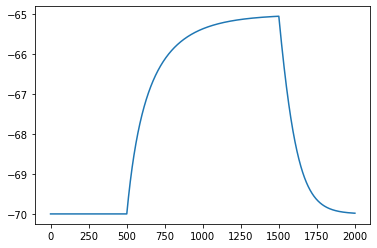

In [ ]:

#ORIG, works with testing


orig_inputs = np.asarray([-70, -14., 0.])
V_res = []
u_res = []
I_res = []
V_main = []
u_main = []
I_main = []

Vs = np.asarray(model1(orig_inputs))
V_res.append(Vs[0])

for k in range(1):
    orig_inputs = np.asarray([-70, -14., 0.])
    V_res = []

    Vs = np.asarray(model1(orig_inputs))
    V_res.append(Vs[0])
    for i in range(2000):
        if i>500 and i<1500:
            I1 = -5+(k/2)
            I1 = 2
        else:
            I1 = 0
        orig_inputs = np.asarray([Vs[0], Vs[1], I1])
        Vs = (model1(orig_inputs))
        V_res.append(Vs[0])
        u_res.append(Vs[1])
        I_res.append(I1)
    for i in range(2000):
        V_main.append(V_res[i])
        u_main.append(u_res[i])
        I_main.append(I_res[i])

    plt.plot(V_res)
    plt.show()

V_main = np.asarray(V_main)
u_main = np.asarray(u_main)
I_main = np.asarray(I_main)

vmi1 = np.vstack((V_main,u_main, I_main))


KeyboardInterrupt: ignored

Exception ignored in: 'zmq.backend.cython.message.Frame.__dealloc__'
Traceback (most recent call last):
  File "zmq/backend/cython/checkrc.pxd", line 13, in zmq.backend.cython.checkrc._check_rc
KeyboardInterrupt


KeyboardInterrupt: ignored

Exception ignored in: 'zmq.backend.cython.message.Frame.__dealloc__'
Traceback (most recent call last):
  File "zmq/backend/cython/checkrc.pxd", line 13, in zmq.backend.cython.checkrc._check_rc
KeyboardInterrupt


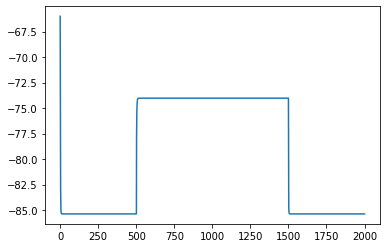

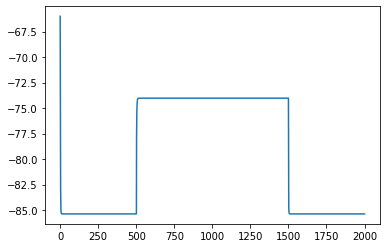

ValueError: ignored

In [ ]:
#ORIG, works with testing


orig_inputs = np.asarray([-65, -14., 0.])
V_res = []
u_res = []
I_res = []
V_main = []
u_main = []
I_main = []

Vs = np.asarray(model1(orig_inputs))
V_res.append(Vs[0])

for k in range(55):
    orig_inputs = np.asarray([-65, -14., 0.])
    V_res = []

    Vs = np.asarray(model1(orig_inputs))
    V_res.append(Vs[0])
    for i in range(1):
        if i>500 and i<1500:
            I1 = -5+(k/2)
            I1 = 15
        else:
            I1 = 0
        orig_inputs = np.asarray([Vs[0], Vs[1], I1])
        Vs = (model1(orig_inputs))
        V_res.append(Vs[0])
        u_res.append(Vs[1])
        I_res.append(I1)
    for i in range(2000):
        V_main.append(V_res[i])
        u_main.append(u_res[i])
        I_main.append(I_res[i])

    plt.plot(V_res)
    plt.show()

V_main = np.asarray(V_main)
u_main = np.asarray(u_main)
I_main = np.asarray(I_main)

vmi1 = np.vstack((V_main,u_main, I_main))


In [ ]:
np.save("/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/Izhikevich_dataset.npy", vmi1)

In [ ]:
vmi1 = np.load("/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/Izhikevich_dataset.npy")
vmi1 = np.transpose(vmi1)

In [ ]:
def build_timeseries(arr):
    dim_0 = arr.shape[0]-1
    dim_1 = arr.shape[1]
    x = np.zeros((dim_0, dim_1))
    y = np.zeros((dim_0,2))
    for i in range(dim_0-1):
        x[i] = arr[i]
        y[i] = arr[i+1][:2]

    return x, y

In [ ]:
batch_size

1

In [ ]:
x_t, y_t = build_timeseries(vmi1[:100000])

x_t = x_t[:x_t.shape[0]-x_t.shape[0]%batch_size]
y_t = y_t[:y_t.shape[0]-y_t.shape[0]%batch_size]


x_val, y_val = build_timeseries(vmi1[100000:])

x_val = x_val[:x_val.shape[0]-x_val.shape[0]%batch_size]
y_val = y_val[:y_val.shape[0]-y_val.shape[0]%batch_size]

In [ ]:
x_t[:64].shape
vmi1 = CustomLayer_for_Vu(y_t[:63])
print(vmi1)

TypeError: ignored

In [ ]:
is_update_model = True
if model is None or is_update_model:
    from keras import backend as K
    print("Building model...")
    model.build()
    model.summary()

    
    history = model.fit(x_t, y_t, epochs=200, verbose=1, batch_size=64,
                        shuffle=True, validation_data=(x_val, y_val))
    
    print("Done with training!")
    model.layers[0].get_weights()

Building model...
Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 custom_layer_for__vu_17 (Cu  (None, 2)                6         
 stomLayer_for_Vu)                                               
                                                                 
Total params: 6
Trainable params: 1
Non-trainable params: 5
_________________________________________________________________
Epoch 1/200
1562/1562 [==============================] - 3s 2ms/step - loss: 6.0669 - val_loss: 8.0630
Epoch 2/200
1562/1562 [==============================] - 3s 2ms/step - loss: 6.0669 - val_loss: 8.0630
Epoch 3/200
1562/1562 [==============================] - 4s 3ms/step - loss: 6.0669 - val_loss: 8.0630
Epoch 4/200
1562/1562 [==============================] - 4s 2ms/step - loss: 6.0669 - val_loss: 8.0630
Epoch 5/200
1562/1562 [==============================] - 3s 2ms/step - loss: 6.0669 - val_l

KeyboardInterrupt: ignored

In [ ]:
h1 = x_t[:64]
h1.shape
h1[:,0].shape

(64,)

In [ ]:
model.layers[0].get_weights()

[-70.01137, -35.0, 0.91798306, 0.9995955, 55.618874, 40.0]

In [ ]:
for layer in model.layers:
    print(layer.get_output_at(0).get_shape().as_list())

[3, 2]


In [ ]:
model.layers[0].get_output_at(0).get_shape()

TensorShape([None, 64])

In [ ]:
loss = tf.cond( tf.logical_or( 
                    (tf.logical_and(tf.greater(y_true, 0.0), tf.greater(y_pred, y_true))), 
                    (tf.logical_and(tf.less(y_true, 0.0), tf.less(y_pred, y_true))) 
                    ),
                   lambda: loss * penalty / 5,
                   lambda: loss * penalty / 10)
  return loss




loss = tf.where(
        condition=tf.logical_or((tf.logical_and(tf.greater(y_true, 0.0), tf.greater(y_pred, y_true))), (tf.logical_and(tf.less(y_true, 0.0), tf.less(y_pred, y_true)))),
        x=loss * penalty / 5,
        y=loss * penalty / 10
    )


In [ ]:
vmi5 = [4]
def go(arg):
    return tf.where(tf.greater(arg,3), 1, 0)

go(vmi5)

<tf.Tensor: shape=(1,), dtype=int32, numpy=array([1], dtype=int32)>

In [ ]:
tf.where(tf.greater(4,5), 4, 6)

<tf.Tensor: shape=(), dtype=int32, numpy=6>

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in double_scalars


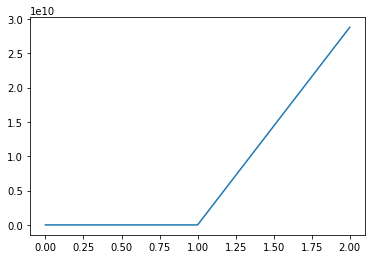

In [ ]:
dt = 0.1
t_end = 500
t_StimStart = 100
t_StimEnd = 400
E_L = -70
V_th = -55
V_reset = -75
V_spike = 20
R_m = 10





In [ ]:
vmi = np.asarray([[1,2,3],[1,2,3]])
vmi01 = tf.convert_to_tensor(vmi)

In [ ]:
int(tf.shape(vmi01)[1])

3

# **Fit Izhikevich model to sponts**

In [ ]:
import pandas as pd
data = pd.read_csv('/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/conds.txt', sep=" ", header=None, dtype='float32')
data.drop([3], axis = 1, inplace=True)
vmi1 = np.asarray(data)


In [ ]:
data.head()

,0,1,2
0,-70.000000,0.0,0.000000
1,-70.039398,0.0,0.000290
2,-70.089600,0.0,0.000695
3,-70.146599,0.0,0.000907
4,-70.206100,0.0,0.000991


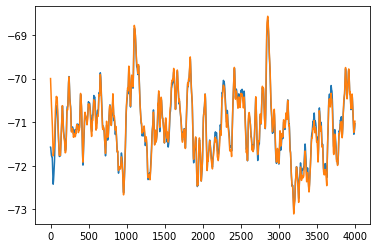

[47.8920515, 56.8618427, -1.32750075, 0.0251875883]


0.018316930296782045

In [ ]:
def go_Izhikevich(arg0):
    threshold_value = 15.
    spike_amp = 40.
    ahp_amp = -65.
    dt = arg0[3]
    a = 0.2
    b = 0.2
    d = 8.0

    Vm = arg0[0]
    u = arg0[1]
    I = arg0[2]
    #print(Vm, u, I)

    if Vm > threshold_value and Vm < 35:
        du = a * (b * Vm - u)
        u1 = u + dt * du
        #print("first")
        return np.asarray([spike_amp,u1])
    elif Vm == spike_amp:      #self.u+ self.d
        du = a * (b * Vm - u)
        u1 = u + dt * du
        #print("second")
        return np.asarray([ahp_amp,u1+d])
    else:
        #print("third")
        dV = (0.04 * Vm + 5) * Vm + 140 - u
        V1 = Vm + (dV + I) * dt

        du = a * (b * Vm - u)
        u1 = u + dt * du
        return np.asarray([V1, u1])


def run_Izhikevich(arg1):
    orig_inputs = np.asarray([-70., -14., 0., arg1[3]])
    V_res = []
    u_res = []
    I_res = []
    V_main = []
    u_main = []
    I_main = []
    g_exc = vmi1[:,1]
    g_inh = vmi1[:,2]

    Vs = np.asarray(go_Izhikevich(orig_inputs))
    V_res.append(Vs[0])

    resting_current = 0.5

    for i in range(500):                                    #baseline
        orig_inputs = np.asarray([Vs[0], Vs[1], arg1[2], arg1[3]])
        Vs = (go_Izhikevich(orig_inputs))
        V_res.append(Vs[0])
        u_res.append(Vs[1])
        I_res.append(0)

    for i in range(4000):
        """
        if i>500 and i<1500:
            I1 = 50+resting_current           #add conductances here, and change them dynamically to I      
        else:
            I1 = 0
        """

        I_exc = g_exc[i] * (Vs[0] - 0) * arg1[0]
        I_inh = g_inh[i] * (Vs[0] + 90) * arg1[1]
        I1 = - (I_exc+I_inh) + arg1[2]


        orig_inputs = np.asarray([Vs[0], Vs[1], I1, arg1[3]])
        #print(orig_inputs)
        Vs = (go_Izhikevich(orig_inputs))
        V_res.append(Vs[0])
        u_res.append(Vs[1])
        I_res.append(I1)

    plt.plot(V_res[500:])
    plt.plot(vmi1[:,0])
    plt.show()
    print(arg1)
    return ((V_res[500:] - vmi1[:,0])**2).mean(axis=0)


final_results = [4.78920515e+01,5.68618427e+01,-1.32750075e+00,2.51875883e-02]
run_Izhikevich(final_results)



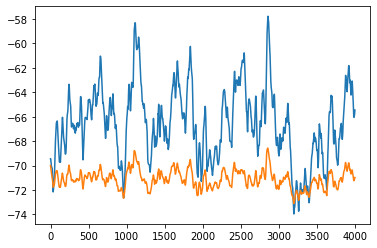

[3.38352973e+02 3.38790636e+02 3.81557859e-01 1.12408009e-02]


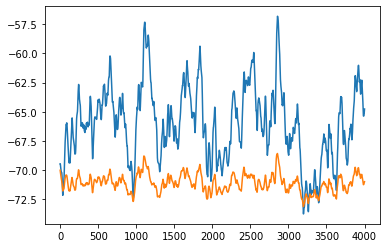

[3.55270622e+02 3.38790636e+02 3.81557859e-01 1.12408009e-02]


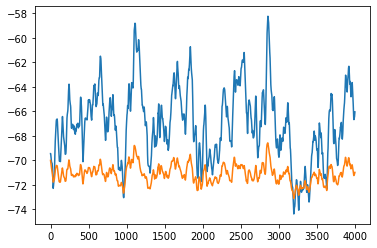

[3.38352973e+02 3.55730168e+02 3.81557859e-01 1.12408009e-02]


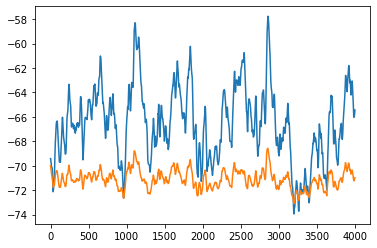

[3.38352973e+02 3.38790636e+02 4.00635752e-01 1.12408009e-02]


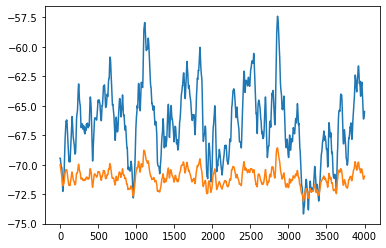

[3.38352973e+02 3.38790636e+02 3.81557859e-01 1.18028409e-02]


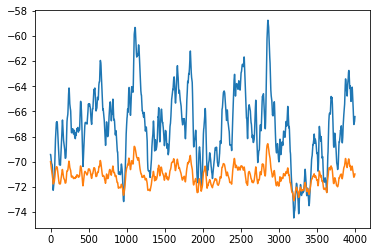

[3.21435324e+02 3.47260402e+02 3.91096805e-01 1.15218209e-02]


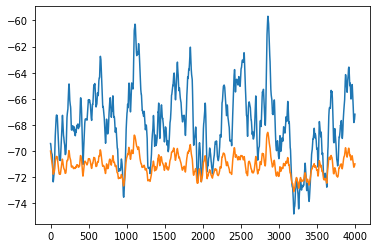

[3.04517676e+02 3.51495285e+02 3.95866279e-01 1.16623309e-02]


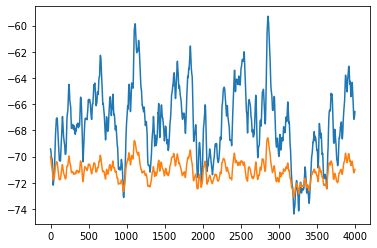

[3.21435324e+02 3.53612726e+02 3.98251015e-01 1.08895259e-02]


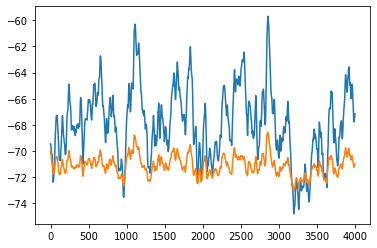

[3.12976500e+02 3.61023771e+02 3.77980754e-01 1.12759284e-02]


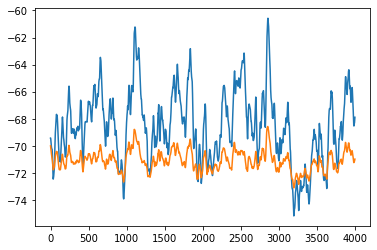

[3.00288264e+02 3.72140339e+02 3.95270095e-01 1.12934922e-02]


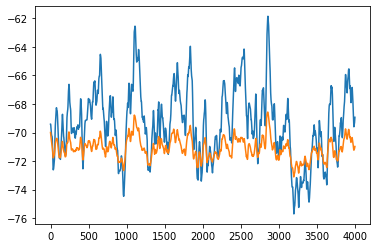

[2.81255909e+02 3.88815191e+02 4.02126212e-01 1.13198378e-02]


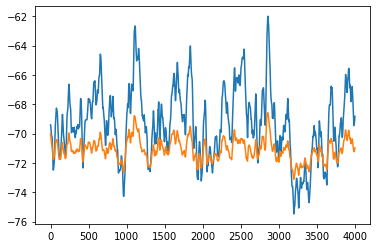

[2.71739731e+02 3.71743319e+02 4.05554271e-01 1.13330106e-02]


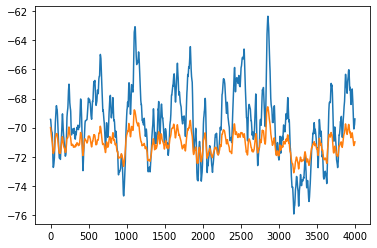

[2.63809584e+02 3.82926057e+02 3.92512743e-01 1.19060280e-02]


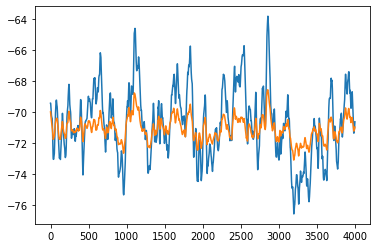

[2.34996713e+02 3.97582722e+02 3.89643607e-01 1.24142790e-02]


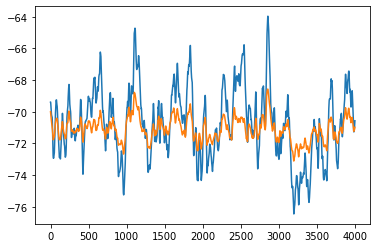

[2.33278515e+02 3.93794487e+02 4.18614430e-01 1.20888008e-02]


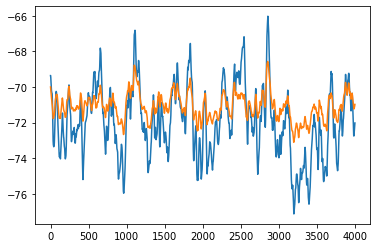

[1.93429522e+02 4.10179844e+02 4.38931269e-01 1.24952370e-02]


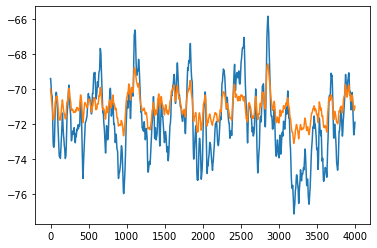

[2.06117758e+02 4.24472574e+02 4.12102982e-01 1.19156332e-02]


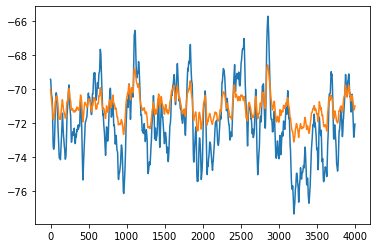

[2.06084716e+02 4.30589168e+02 4.05689344e-01 1.25362648e-02]


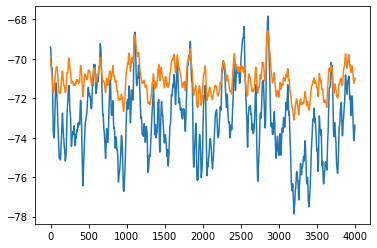

[1.58982942e+02 4.34404285e+02 4.10898969e-01 1.31576511e-02]


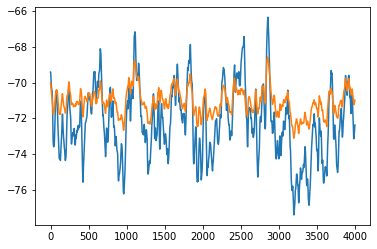

[1.89551184e+02 4.23007011e+02 4.08705780e-01 1.26981978e-02]


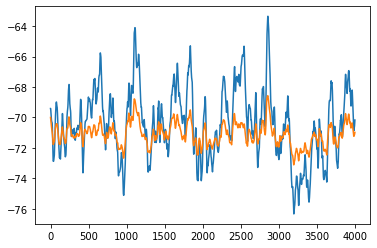

[2.50687667e+02 4.00212464e+02 4.04319402e-01 1.17792911e-02]


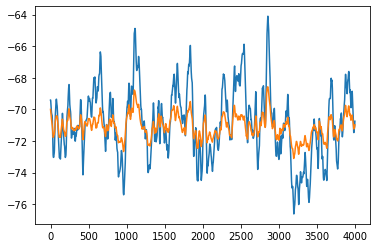

[2.35403546e+02 4.05911101e+02 4.05415996e-01 1.20090178e-02]


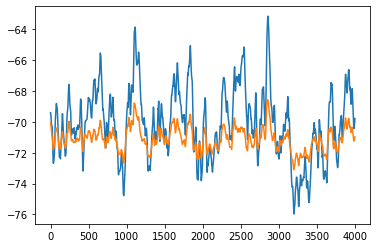

[2.48813550e+02 3.80291274e+02 4.07199163e-01 1.16776006e-02]


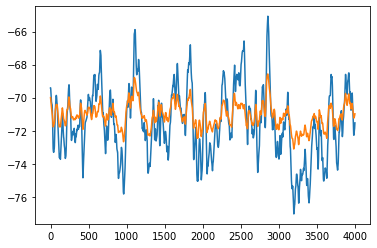

[2.16766925e+02 4.18014695e+02 4.06066799e-01 1.23215987e-02]


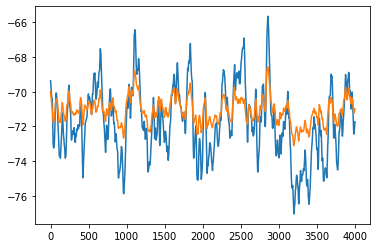

[2.10786659e+02 4.23513706e+02 4.31456497e-01 1.17532462e-02]


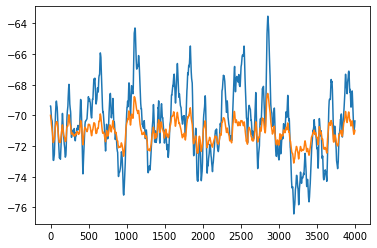

[2.42000064e+02 3.96144420e+02 4.18673880e-01 1.21706986e-02]


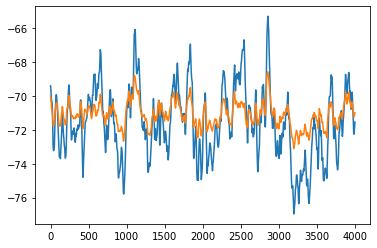

[2.15088335e+02 4.17390536e+02 4.13745706e-01 1.19793995e-02]


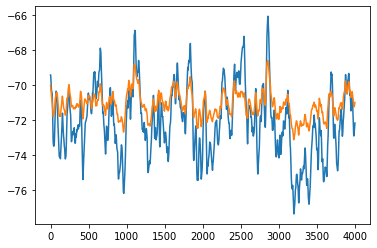

[2.05744218e+02 4.38620532e+02 4.09728069e-01 1.19428303e-02]


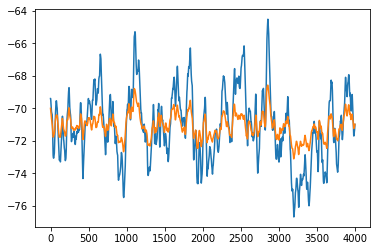

[2.26394940e+02 4.05000998e+02 4.16392840e-01 1.20523082e-02]


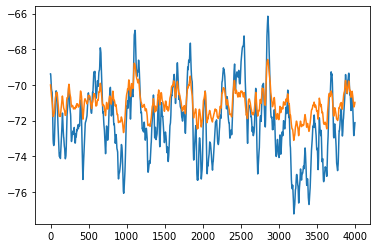

[1.99114883e+02 4.26048866e+02 4.28414925e-01 1.20442585e-02]


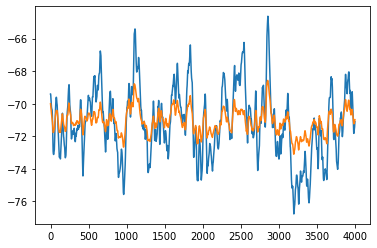

[2.26331380e+02 4.10945542e+02 4.11165728e-01 1.20178280e-02]


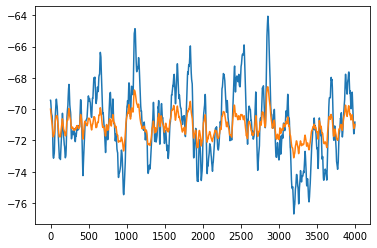

[2.31504131e+02 4.02162179e+02 3.92229040e-01 1.24323210e-02]


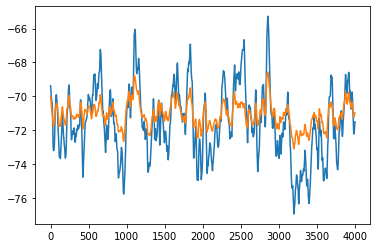

[2.15966027e+02 4.18175825e+02 4.21649633e-01 1.19230149e-02]


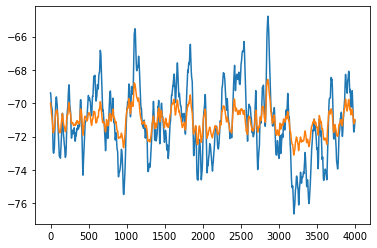

[2.25123417e+02 4.07741756e+02 4.25410154e-01 1.16646765e-02]


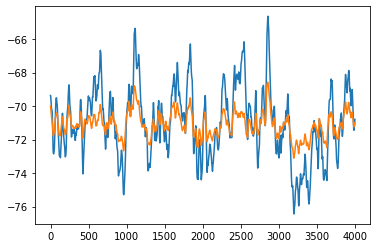

[2.29301663e+02 4.02605287e+02 4.35081832e-01 1.13362154e-02]


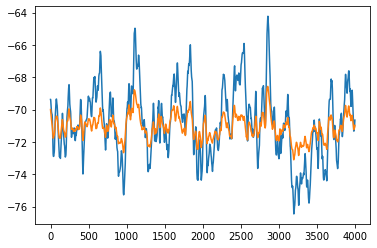

[2.33908670e+02 4.00973290e+02 4.28399310e-01 1.16852837e-02]


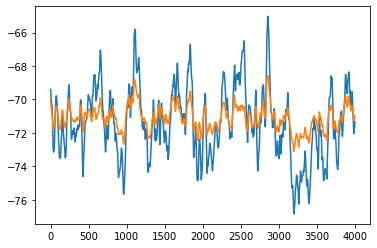

[2.19793419e+02 4.13286224e+02 4.17409107e-01 1.19058706e-02]


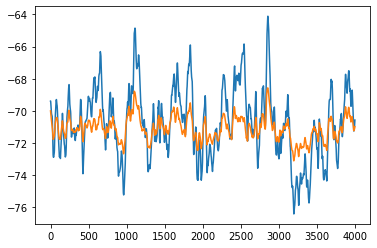

[2.34944674e+02 3.97743201e+02 4.18375121e-01 1.17330962e-02]


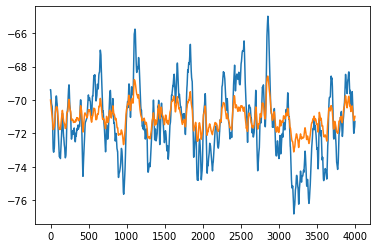

[2.20710689e+02 4.13067669e+02 4.20831005e-01 1.18755352e-02]


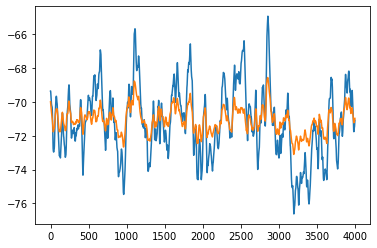

[2.21768975e+02 4.06034547e+02 4.33691664e-01 1.15671367e-02]


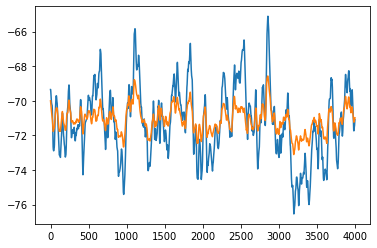

[2.19487772e+02 4.03579049e+02 4.44954632e-01 1.13417911e-02]


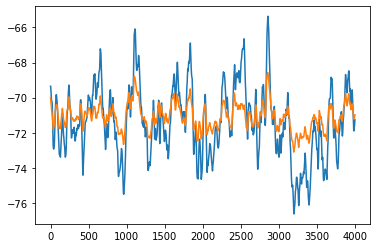

[2.18251830e+02 4.11268116e+02 4.42745448e-01 1.11773980e-02]


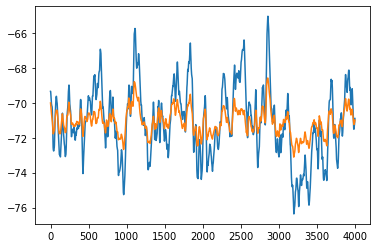

[2.24082558e+02 4.01973836e+02 4.54397351e-01 1.09595993e-02]


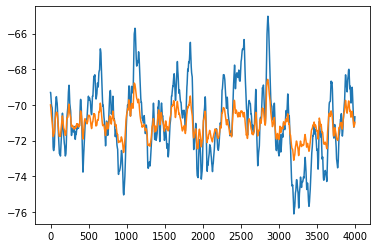

[2.26227128e+02 3.96317641e+02 4.72891473e-01 1.04864637e-02]


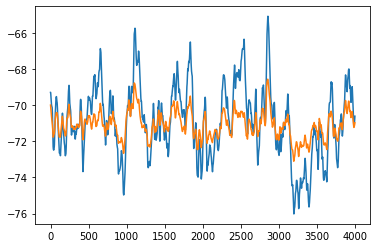

[2.25923508e+02 3.93817378e+02 4.77005688e-01 1.02953989e-02]


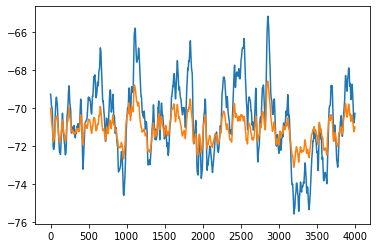

[2.28529917e+02 3.84192232e+02 5.05093029e-01 9.50533070e-03]


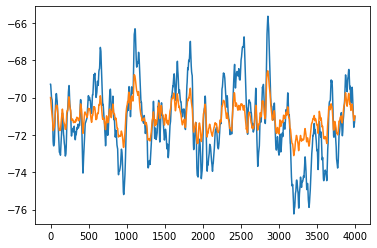

[2.15643456e+02 3.99885805e+02 4.83716788e-01 1.03143104e-02]


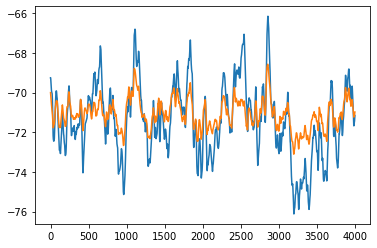

[2.08814353e+02 3.98526064e+02 5.08034266e-01 9.80335785e-03]


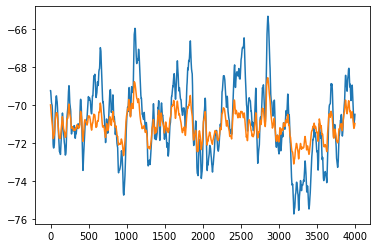

[2.21974550e+02 3.84851950e+02 5.08697581e-01 9.78610775e-03]


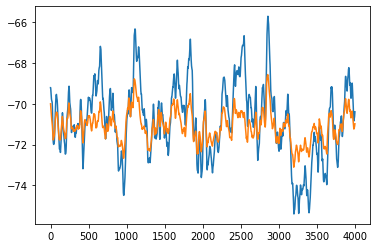

[2.21981997e+02 3.83177468e+02 5.38359872e-01 8.84387297e-03]


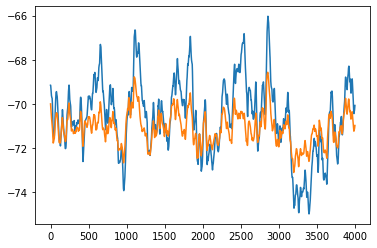

[2.23229110e+02 3.72976677e+02 5.85062492e-01 7.59491390e-03]


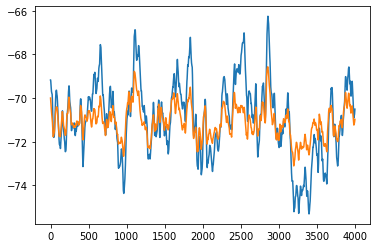

[2.13743632e+02 3.78768393e+02 5.66508540e-01 8.25342553e-03]


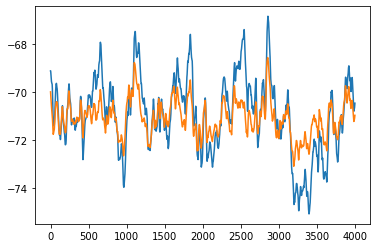

[2.07501885e+02 3.69993769e+02 6.13317074e-01 7.13690647e-03]


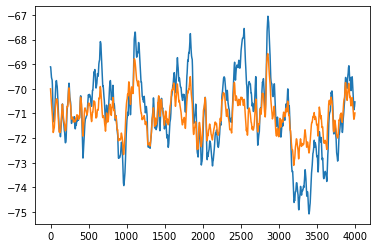

[2.04836441e+02 3.69356853e+02 6.30550019e-01 6.86524412e-03]


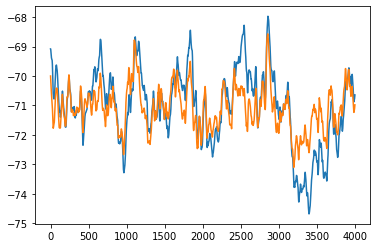

[1.94292908e+02 3.57126591e+02 7.07322184e-01 5.15016674e-03]


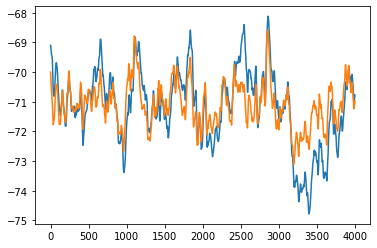

[1.94944578e+02 3.64459601e+02 6.98170427e-01 5.05656473e-03]


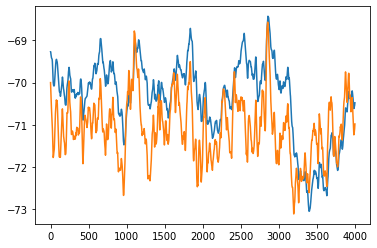

[2.01169887e+02 3.33752255e+02 7.93901823e-01 2.66591808e-03]


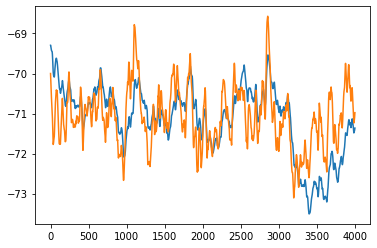

[1.75725519e+02 3.39689430e+02 8.21293262e-01 2.40986411e-03]


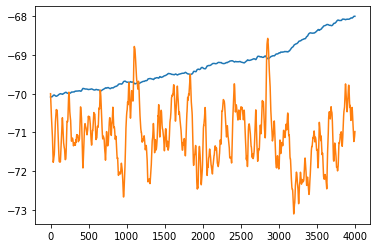

[ 1.51973723e+02  3.23045807e+02  9.39408647e-01 -1.82660791e-04]


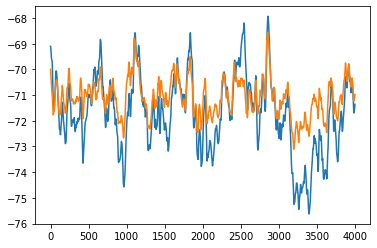

[1.85062557e+02 3.81882441e+02 6.26149650e-01 7.21083295e-03]


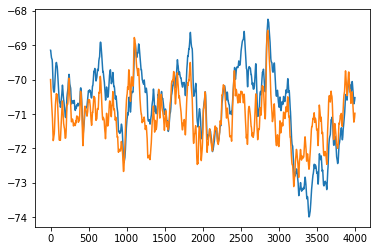

[1.97143055e+02 3.45784801e+02 7.51963780e-01 3.80214679e-03]


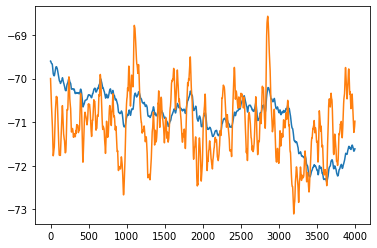

[1.73551145e+02 3.33536442e+02 8.76057753e-01 1.07246472e-03]


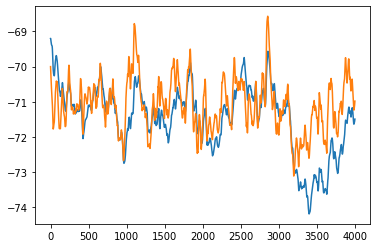

[1.72114020e+02 3.51621231e+02 7.99458033e-01 3.04238336e-03]


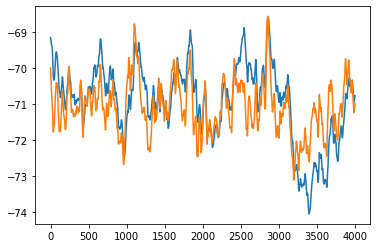

[1.90885796e+02 3.47243909e+02 7.63837343e-01 3.61220594e-03]


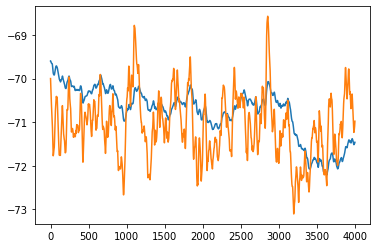

[1.72283106e+02 3.24338585e+02 8.86084844e-01 1.06578602e-03]


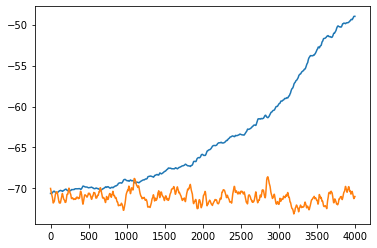

[ 1.61929875e+02  3.15277593e+02  9.66314417e-01 -1.07000635e-03]


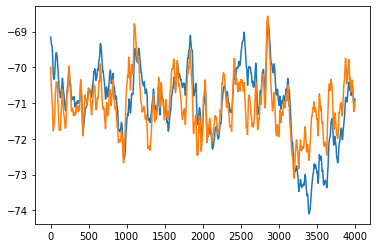

[1.86202150e+02 3.46664341e+02 7.72070242e-01 3.59512347e-03]


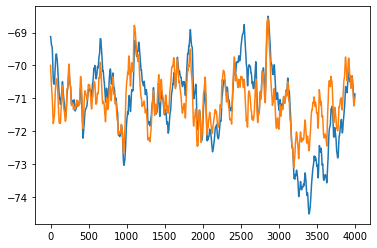

[1.90899199e+02 3.59228476e+02 7.30544456e-01 4.27904309e-03]


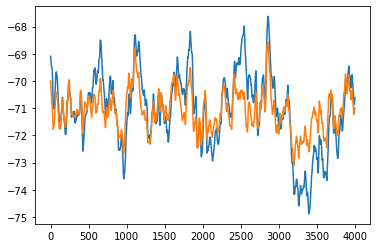

[1.98305187e+02 3.62876636e+02 6.67814899e-01 5.87565358e-03]


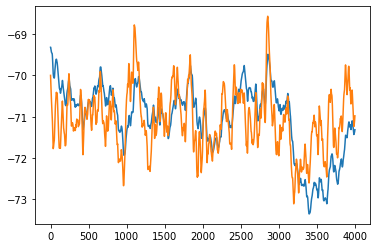

[1.79739656e+02 3.40871491e+02 8.23997039e-01 2.27326194e-03]


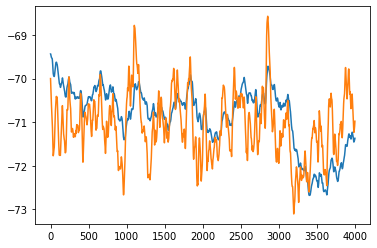

[1.75377361e+02 3.28006109e+02 8.60054487e-01 1.66618463e-03]


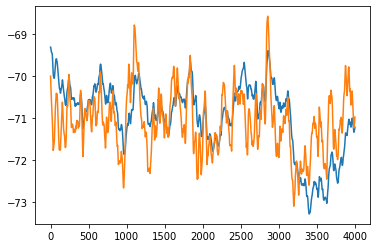

[1.79257821e+02 3.35811701e+02 8.27676979e-01 2.31939925e-03]


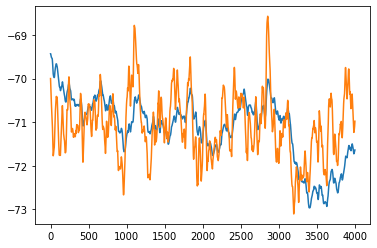

[1.69576776e+02 3.34274573e+02 8.58681418e-01 1.68661844e-03]


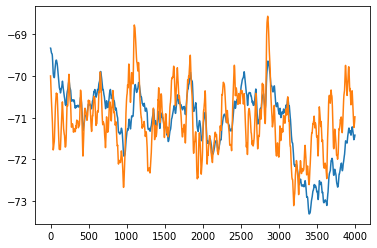

[1.74904031e+02 3.37516907e+02 8.34970399e-01 2.16801532e-03]


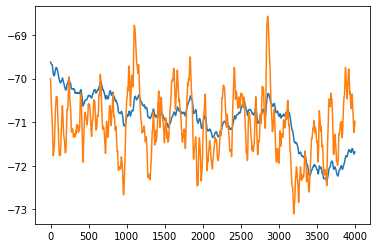

[1.68611364e+02 3.30280423e+02 8.81898598e-01 9.90146833e-04]


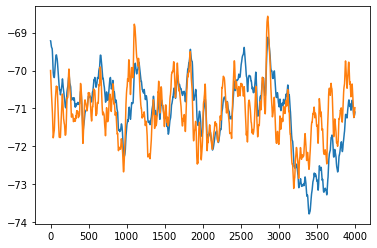

[1.81804453e+02 3.42568362e+02 7.99527331e-01 2.94387931e-03]


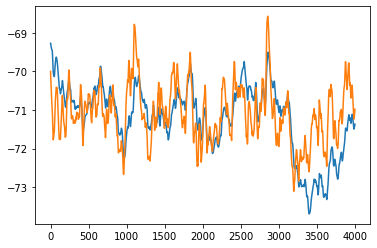

[1.76829009e+02 3.44511394e+02 8.12217036e-01 2.57811109e-03]


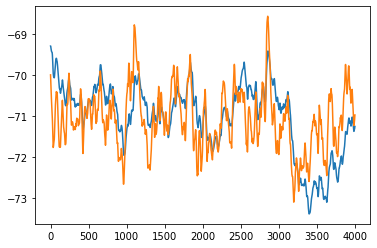

[1.78650618e+02 3.37986624e+02 8.23811994e-01 2.38407721e-03]


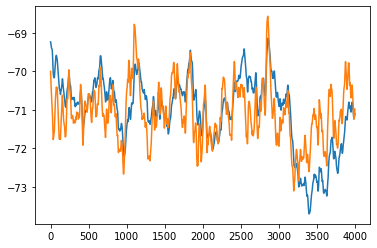

[1.83056091e+02 3.43041047e+02 7.99344414e-01 2.83752596e-03]


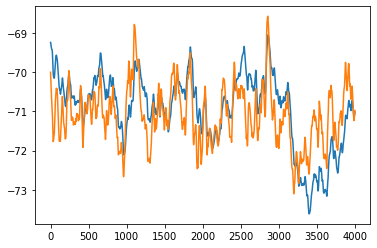

[1.85899890e+02 3.42544331e+02 8.02047127e-01 2.80950810e-03]


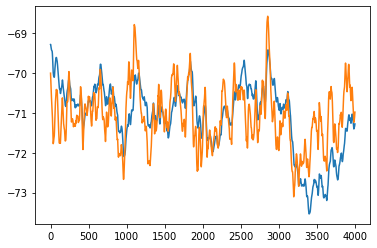

[1.78269112e+02 3.40403156e+02 8.16481728e-01 2.50977511e-03]


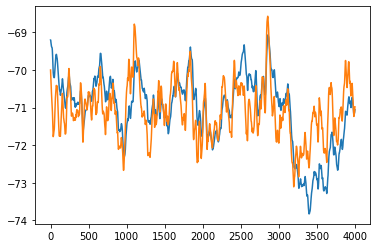

[1.81150481e+02 3.41128103e+02 7.95585694e-01 3.06436686e-03]


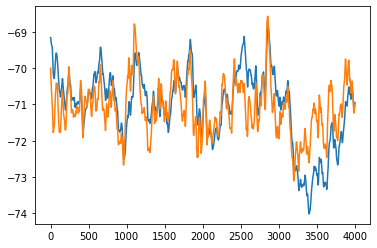

[1.81855894e+02 3.41256410e+02 7.81380021e-01 3.45991932e-03]


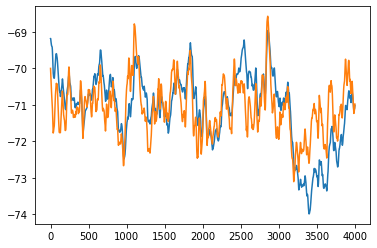

[1.83489451e+02 3.45583709e+02 7.81657590e-01 3.29369641e-03]


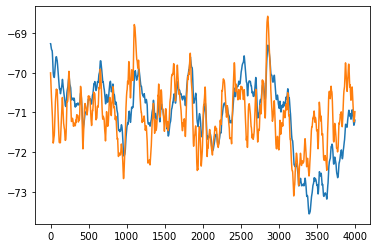

[1.79860326e+02 3.39885896e+02 8.13273393e-01 2.61148201e-03]


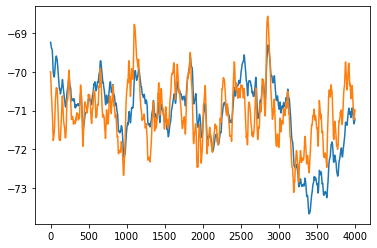

[1.77486095e+02 3.38951711e+02 8.13089659e-01 2.72722568e-03]


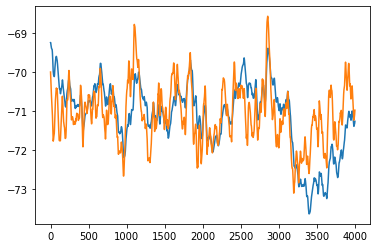

[1.74701096e+02 3.36907044e+02 8.19962282e-01 2.67207553e-03]


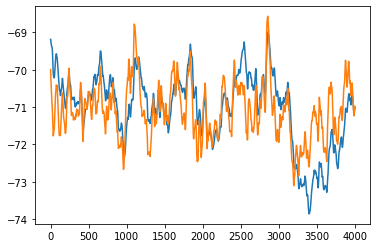

[1.81881566e+02 3.40863880e+02 7.94256311e-01 3.16370182e-03]


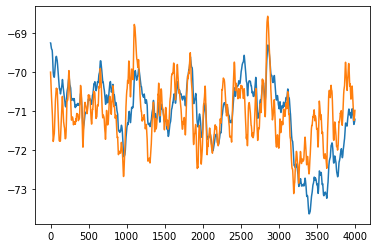

[1.79172225e+02 3.40518337e+02 8.10925374e-01 2.67325678e-03]


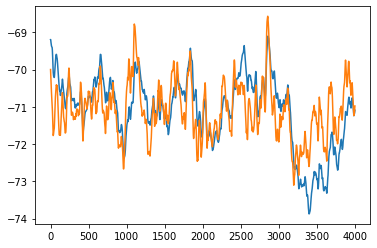

[1.79946301e+02 3.41697361e+02 7.96290636e-01 3.09288231e-03]


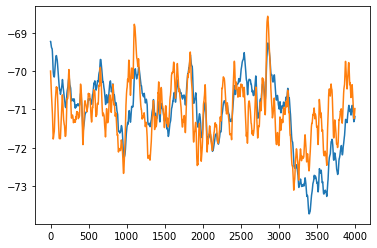

[1.77073098e+02 3.38579395e+02 8.08418351e-01 2.83498650e-03]


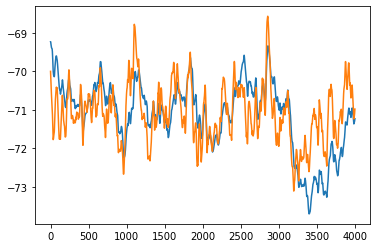

[1.74707421e+02 3.36584911e+02 8.12863860e-01 2.78054010e-03]


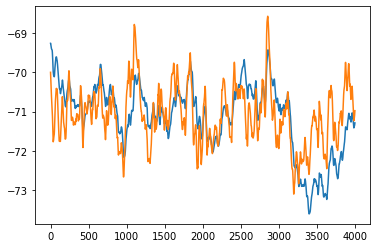

[1.75688378e+02 3.38745299e+02 8.18776316e-01 2.59980878e-03]


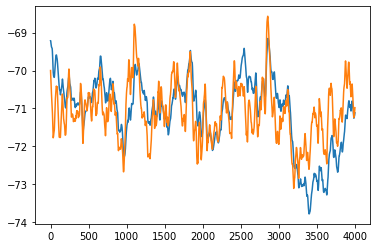

[1.79784956e+02 3.40532402e+02 8.01383350e-01 2.94822734e-03]


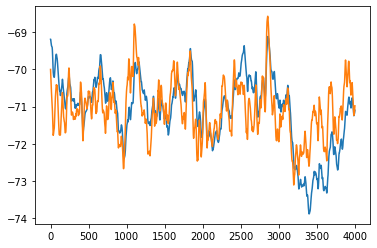

[1.77973000e+02 3.39362098e+02 7.98665624e-01 3.12840413e-03]


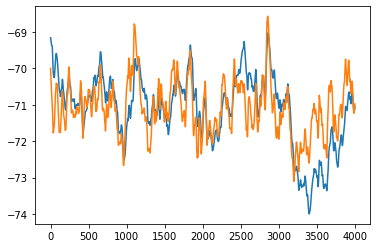

[1.77373387e+02 3.38783978e+02 7.92535750e-01 3.35597780e-03]


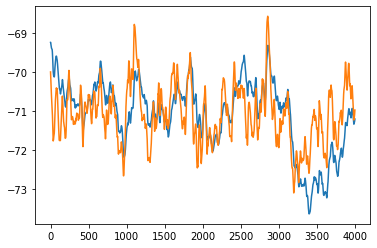

[1.76212273e+02 3.37015442e+02 8.14487855e-01 2.72653952e-03]


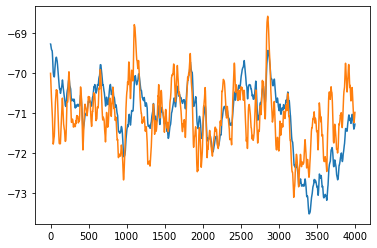

[1.74345259e+02 3.34674482e+02 8.23586465e-01 2.54336812e-03]


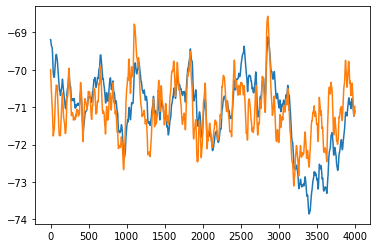

[1.78035568e+02 3.38792957e+02 7.98387931e-01 3.09185306e-03]


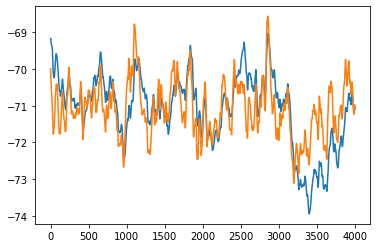

[1.78310305e+02 3.38713580e+02 7.91037066e-01 3.27416676e-03]


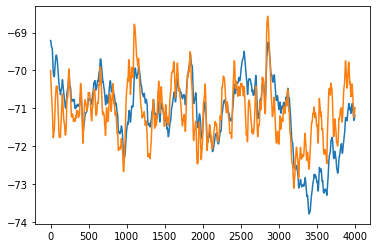

[1.74862014e+02 3.36342544e+02 8.08596531e-01 2.94266427e-03]


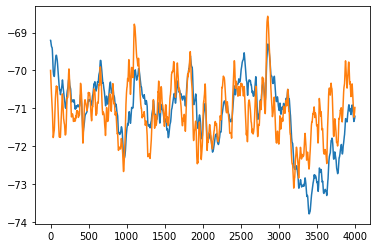

[1.72400543e+02 3.34247614e+02 8.12203122e-01 2.93988273e-03]


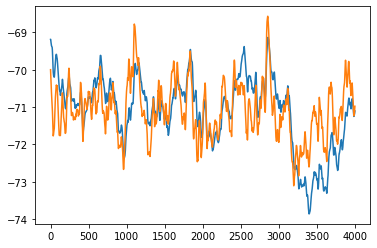

[1.76468329e+02 3.37177125e+02 8.01650620e-01 3.10974398e-03]


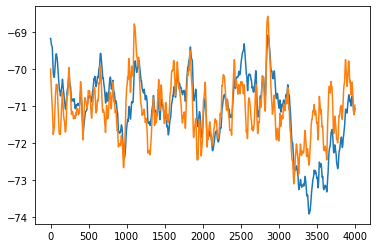

[1.76165945e+02 3.36475991e+02 7.98266755e-01 3.24712273e-03]


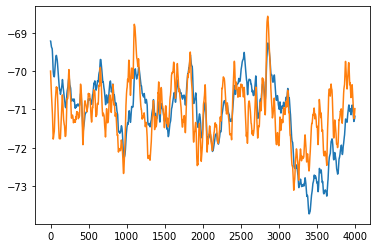

[1.74664900e+02 3.34951369e+02 8.11203912e-01 2.87568566e-03]


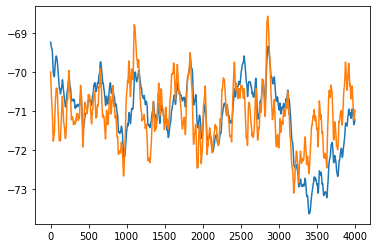

[1.73010850e+02 3.32746004e+02 8.17473055e-01 2.74932642e-03]


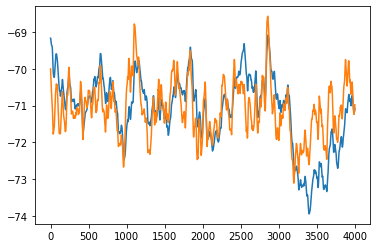

[1.74824916e+02 3.35163306e+02 7.96874280e-01 3.28894373e-03]


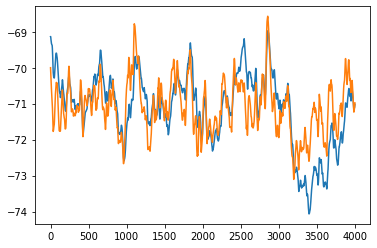

[1.74131237e+02 3.34237238e+02 7.88067492e-01 3.57014583e-03]


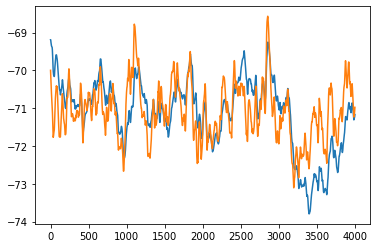

[1.71396294e+02 3.31570965e+02 8.12217380e-01 3.02217551e-03]


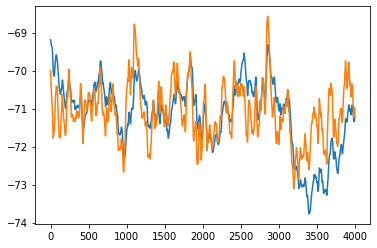

[1.68076657e+02 3.27959969e+02 8.19132105e-01 2.98733673e-03]


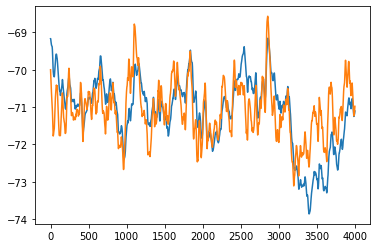

[1.71177170e+02 3.29830092e+02 8.07276566e-01 3.19370054e-03]


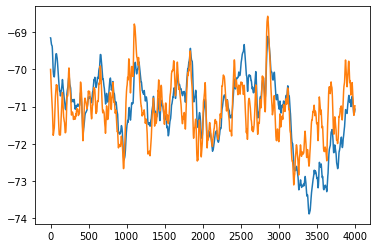

[1.69334748e+02 3.26573866e+02 8.06616584e-01 3.31921867e-03]


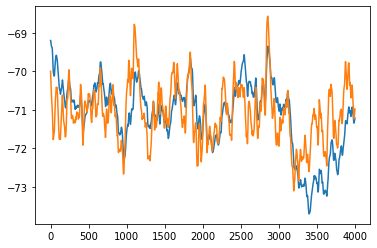

[1.66457641e+02 3.24745582e+02 8.21781257e-01 2.92529005e-03]


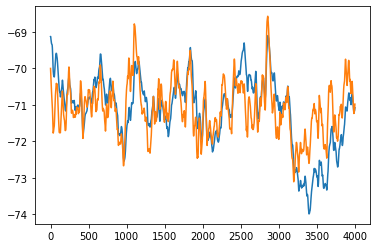

[1.66336130e+02 3.24475357e+02 8.04729058e-01 3.51106816e-03]


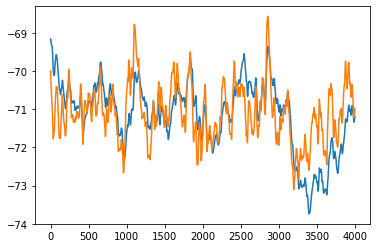

[1.60277672e+02 3.16714081e+02 8.29255222e-01 3.08251308e-03]


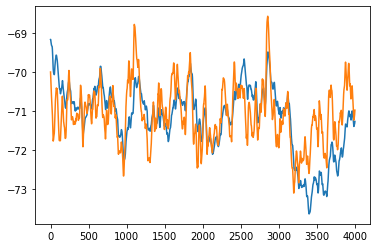

[1.53004051e+02 3.07489469e+02 8.45445693e-01 2.97929775e-03]


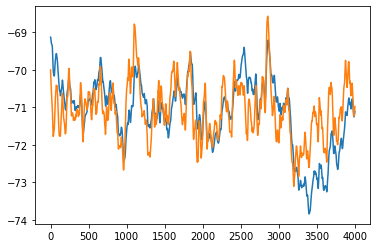

[1.59489628e+02 3.13682167e+02 8.20154191e-01 3.38010059e-03]


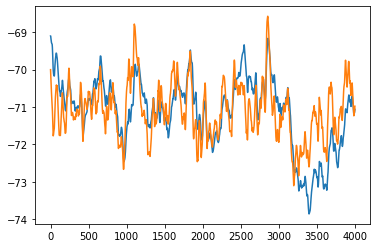

[1.55196114e+02 3.06543266e+02 8.20665235e-01 3.57648252e-03]


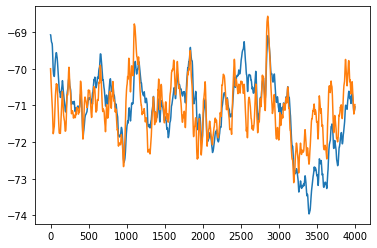

[1.55477881e+02 3.07795397e+02 8.16947027e-01 3.76774350e-03]


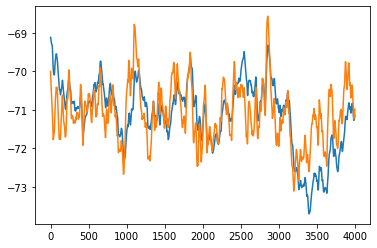

[1.50170266e+02 2.99725642e+02 8.40108212e-01 3.31030306e-03]


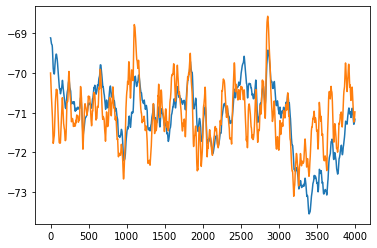

[1.42087335e+02 2.87350784e+02 8.57797788e-01 3.20992051e-03]


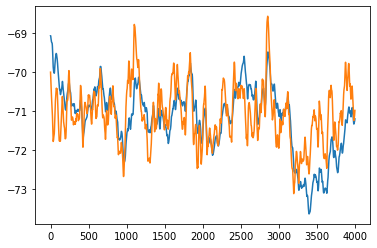

[1.33547942e+02 2.78015593e+02 8.63811288e-01 3.44750347e-03]


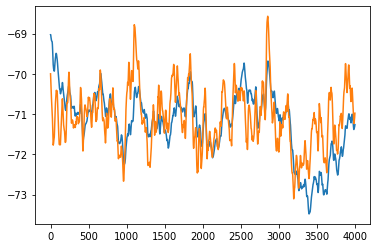

[1.15654539e+02 2.53736456e+02 8.92408639e-01 3.51164588e-03]


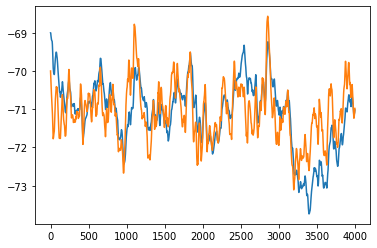

[1.31203883e+02 2.70223483e+02 8.48463652e-01 4.05359845e-03]


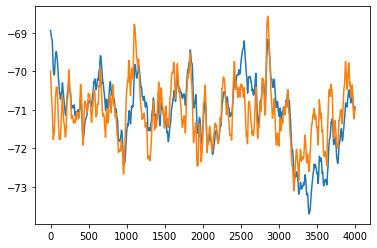

[1.20303800e+02 2.51590490e+02 8.49972632e-01 4.59074879e-03]


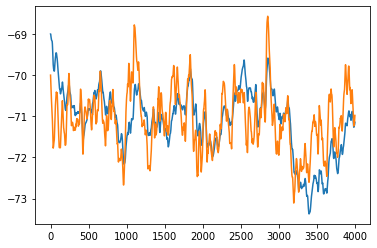

[1.11143013e+02 2.41815101e+02 8.93475120e-01 3.67665535e-03]


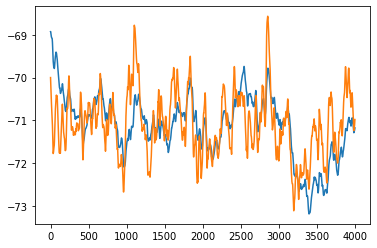

[8.93982288e+01 2.10703149e+02 9.26161855e-01 3.91800275e-03]


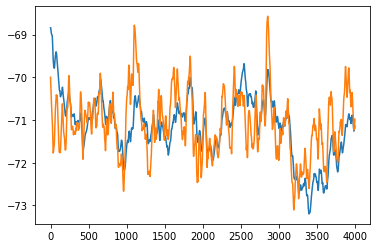

[7.61624556e+01 1.91571814e+02 9.23211334e-01 4.63860587e-03]


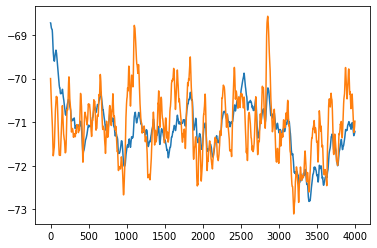

[4.32000161e+01 1.43682329e+02 9.55918108e-01 5.35294855e-03]


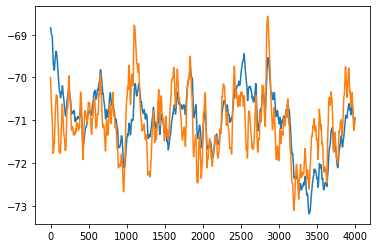

[8.28492097e+01 1.94103821e+02 9.04001831e-01 4.90036050e-03]


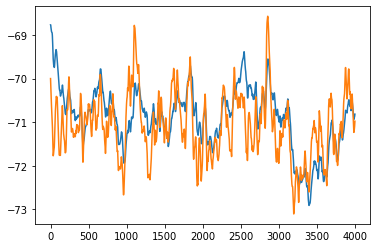

[6.64465452e+01 1.64287504e+02 9.09798427e-01 5.59471782e-03]


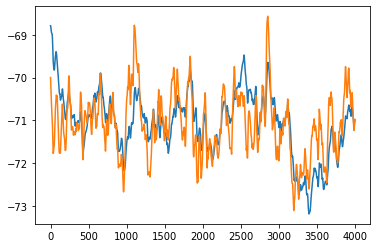

[7.32138340e+01 1.82169536e+02 9.08198706e-01 5.34720361e-03]


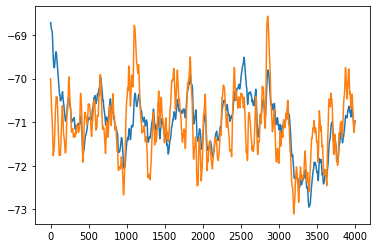

[5.42492445e+01 1.52346754e+02 9.15560500e-01 6.18247775e-03]


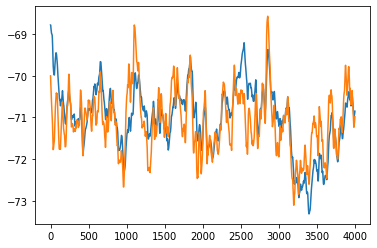

[7.73841260e+01 1.84103290e+02 8.70211294e-01 6.23809371e-03]


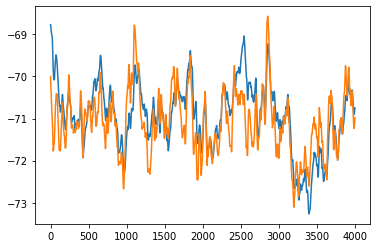

[7.13770746e+01 1.70803360e+02 8.42236013e-01 7.39813919e-03]


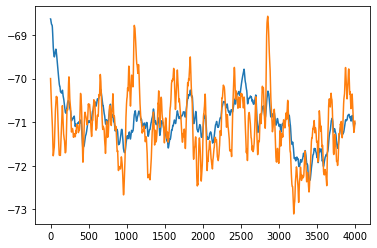

[2.20151925e+01 1.02822385e+02 9.42532208e-01 6.96904286e-03]


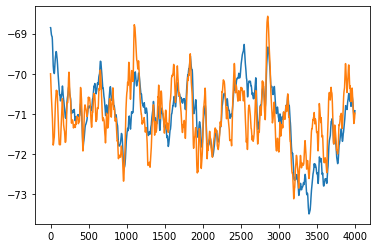

[9.57316479e+01 2.14398464e+02 8.73112526e-01 5.18532231e-03]


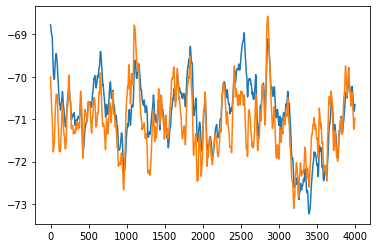

[7.59411328e+01 1.74254385e+02 8.44244101e-01 7.19454401e-03]


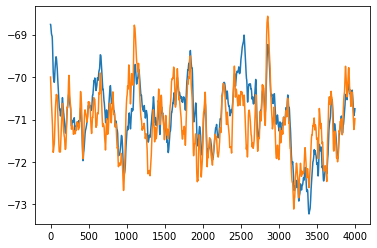

[6.58003402e+01 1.61797661e+02 8.33574739e-01 8.07988112e-03]


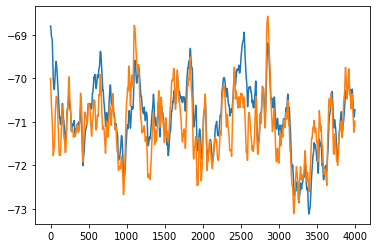

[5.72759054e+01 1.45644580e+02 7.98361193e-01 9.66964143e-03]


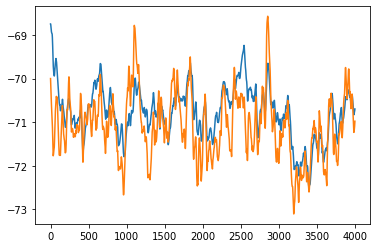

[3.36900307e+01 1.07126076e+02 8.27088377e-01 1.00370789e-02]


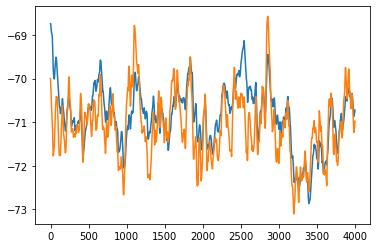

[4.92004350e+01 1.33944173e+02 8.38594415e-01 8.82413974e-03]


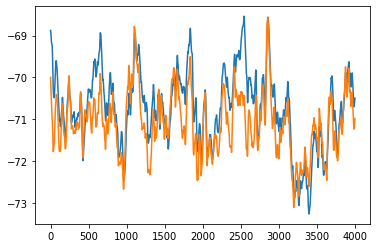

[7.26480293e+01 1.59976496e+02 7.46157361e-01 1.03607544e-02]


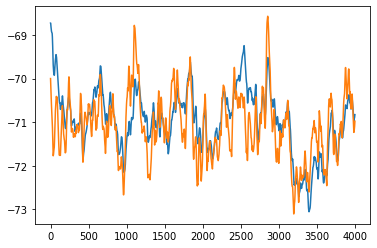

[5.88489407e+01 1.54254189e+02 8.73209715e-01 7.22704692e-03]


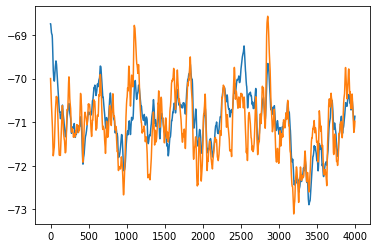

[4.24100451e+01 1.28068766e+02 8.31956567e-01 9.36493964e-03]


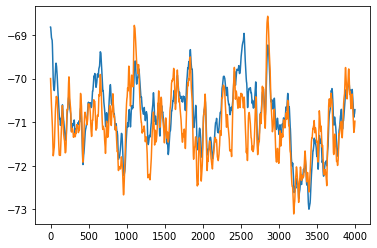

[5.12827893e+01 1.34976251e+02 7.82364379e-01 1.04013831e-02]


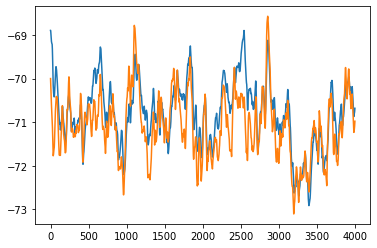

[4.74997135e+01 1.25337281e+02 7.36941711e-01 1.19885512e-02]


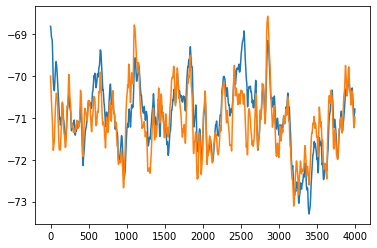

[6.19724721e+01 1.55802305e+02 7.88864661e-01 9.59291194e-03]


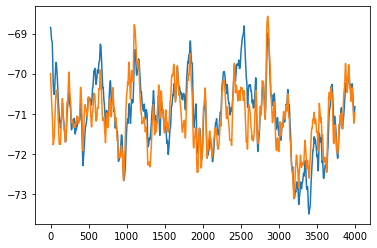

[6.83584907e+01 1.66731372e+02 7.63999785e-01 9.97729804e-03]


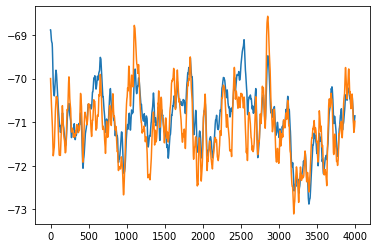

[3.82865406e+01 1.16907124e+02 7.46104948e-01 1.23084919e-02]


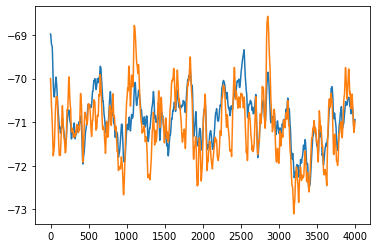

[2.17412736e+01 8.99590058e+01 6.98039416e-01 1.47636683e-02]


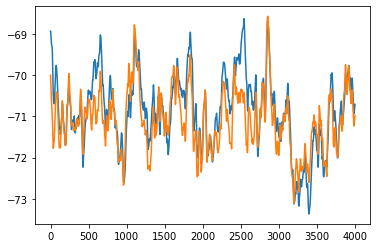

[6.51918179e+01 1.54060897e+02 7.13458585e-01 1.18134676e-02]


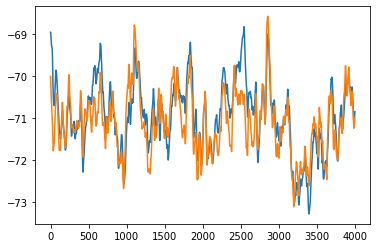

[5.42839139e+01 1.40693241e+02 7.04602656e-01 1.25806789e-02]


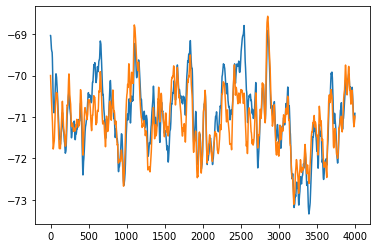

[5.27879181e+01 1.38217572e+02 6.57723388e-01 1.40361976e-02]


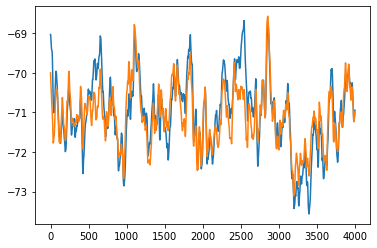

[6.10295944e+01 1.52982232e+02 6.58278974e-01 1.36663445e-02]


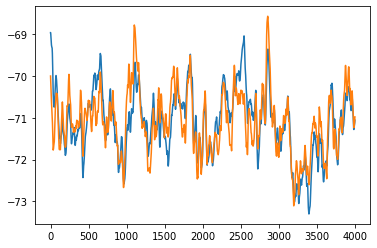

[4.50394540e+01 1.33358252e+02 6.99594963e-01 1.31806984e-02]


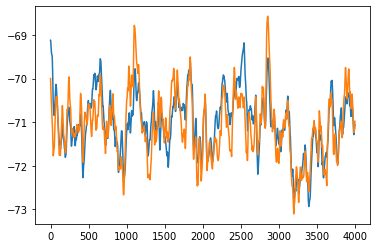

[3.02132629e+01 1.04001218e+02 6.16851352e-01 1.66185681e-02]


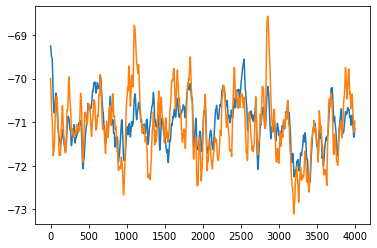

[1.11406490e+01 7.26361416e+01 5.43277135e-01 1.99392032e-02]


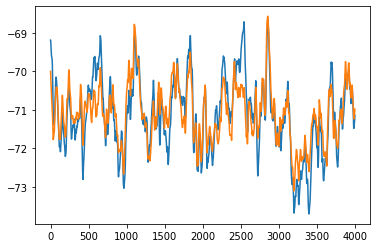

[5.62485740e+01 1.47372513e+02 5.70119390e-01 1.64424124e-02]


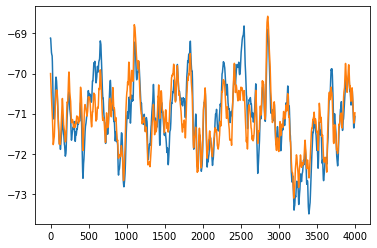

[5.17580657e+01 1.39756166e+02 6.14115779e-01 1.54089323e-02]


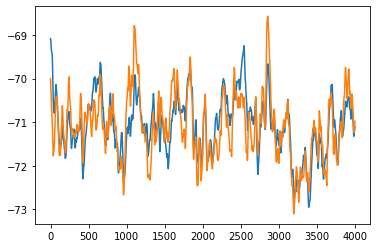

[2.88697559e+01 1.04684372e+02 6.35863766e-01 1.59558537e-02]


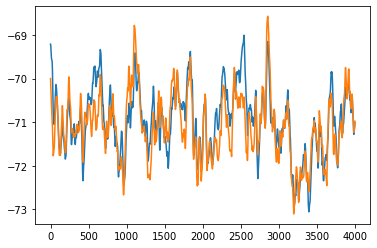

[3.67750473e+01 1.09971412e+02 5.62682180e-01 1.78290775e-02]


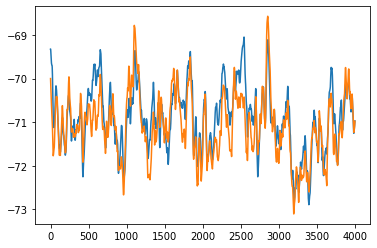

[3.26428440e+01 9.82779915e+01 4.94225789e-01 2.01532670e-02]


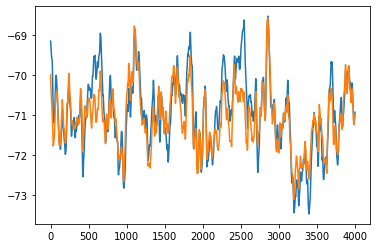

[5.68973910e+01 1.41288811e+02 5.89822583e-01 1.59905340e-02]


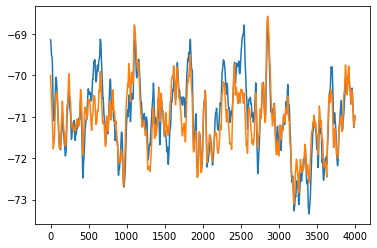

[4.98904823e+01 1.32137702e+02 6.01332879e-01 1.59818639e-02]


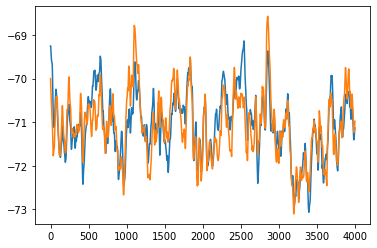

[3.15305110e+01 1.04715677e+02 5.39767707e-01 1.88830233e-02]


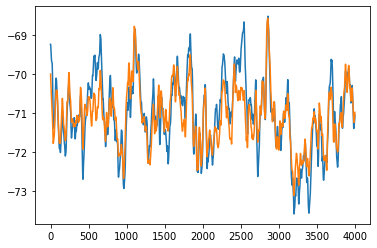

[5.47637903e+01 1.39289260e+02 5.42097921e-01 1.74328804e-02]


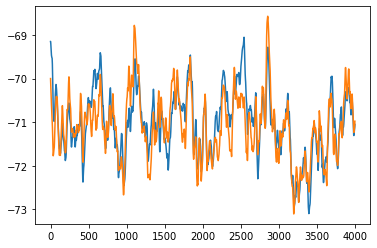

[3.63508947e+01 1.12823229e+02 5.98162994e-01 1.68221462e-02]


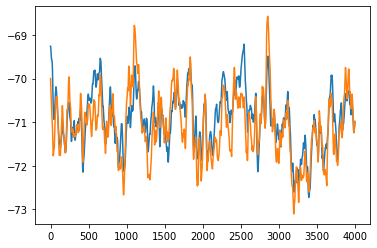

[2.55154020e+01 9.00678438e+01 5.36857101e-01 1.93491232e-02]


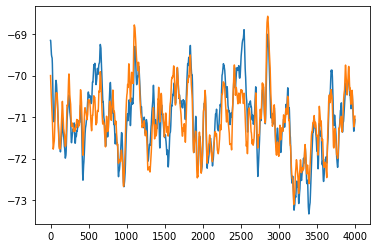

[4.51973997e+01 1.27334085e+02 5.94801110e-01 1.63939800e-02]


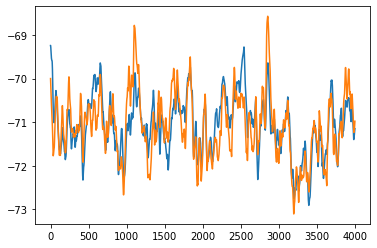

[2.50364441e+01 9.52844997e+01 5.46374116e-01 1.89822496e-02]


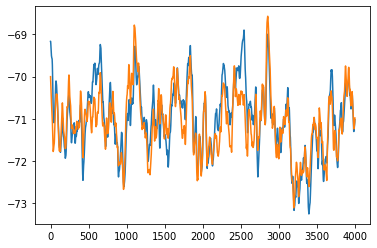

[4.36769727e+01 1.22924401e+02 5.87593188e-01 1.67319603e-02]


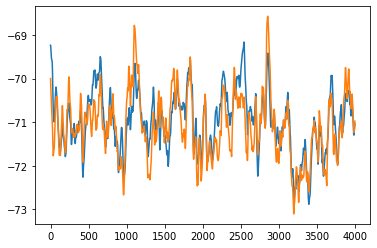

[2.89693131e+01 9.78832740e+01 5.49301925e-01 1.87391237e-02]


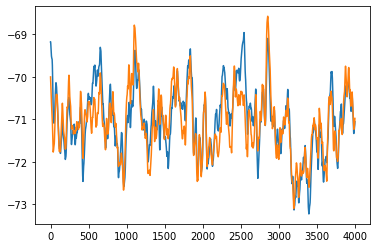

[4.11403781e+01 1.19971382e+02 5.83426313e-01 1.69802659e-02]


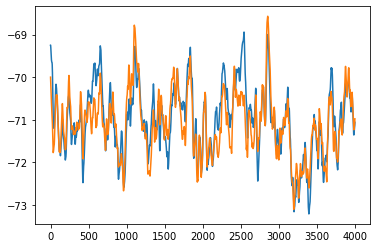

[4.02105598e+01 1.15968208e+02 5.38571700e-01 1.83900173e-02]


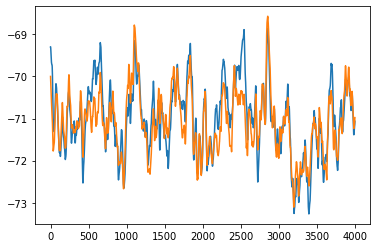

[4.21403924e+01 1.17540697e+02 5.08776054e-01 1.91739529e-02]


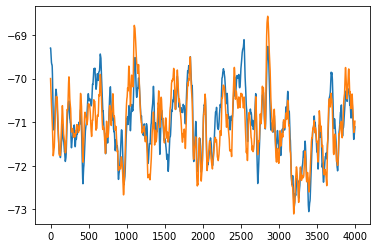

[3.21161917e+01 1.03175183e+02 5.09732939e-01 1.97011995e-02]


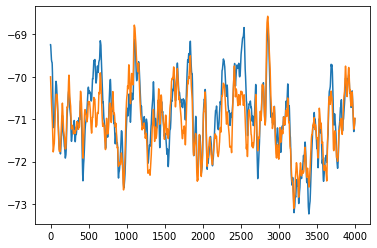

[4.45554938e+01 1.20613660e+02 5.42541036e-01 1.79592245e-02]


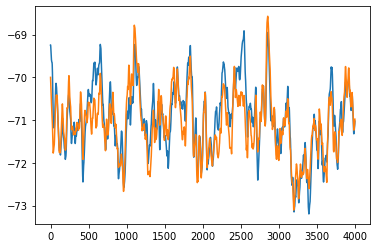

[4.12992481e+01 1.16639164e+02 5.41847704e-01 1.81901742e-02]


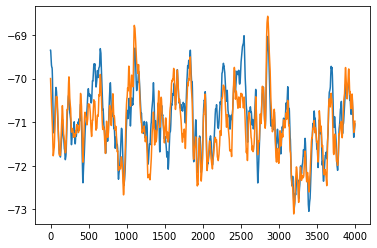

[3.50250616e+01 1.03691846e+02 4.78093125e-01 2.04669361e-02]


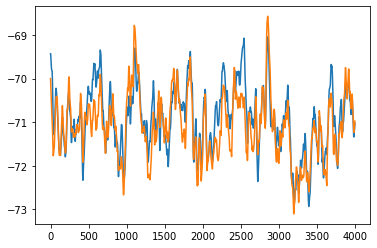

[3.19674034e+01 9.55520771e+01 4.25426530e-01 2.22102712e-02]


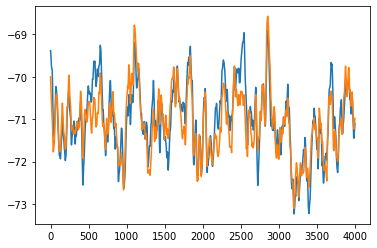

[3.85153996e+01 1.10552033e+02 4.56542731e-01 2.09370539e-02]


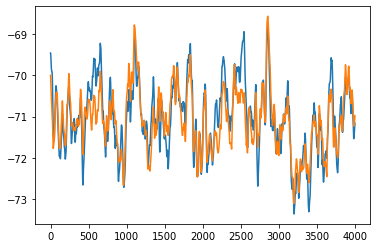

[3.93855757e+01 1.10842344e+02 4.03473006e-01 2.24910421e-02]


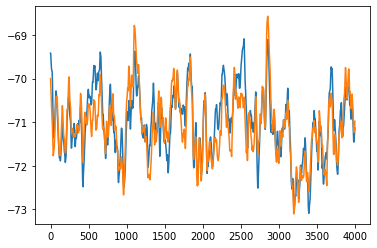

[3.25992746e+01 1.00840715e+02 4.34724720e-01 2.19493969e-02]


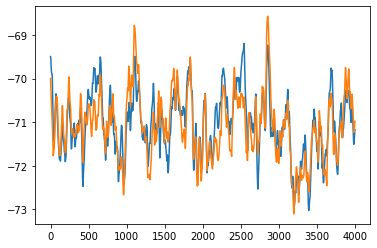

[2.82492878e+01 9.29414903e+01 3.81163228e-01 2.38290083e-02]


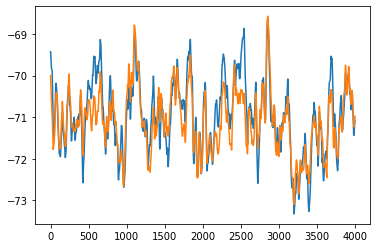

[4.20238724e+01 1.13137462e+02 4.29335376e-01 2.15624705e-02]


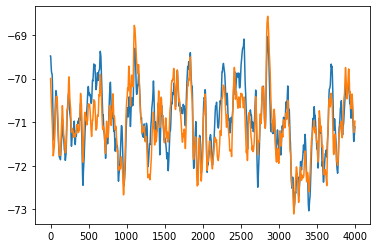

[3.19414117e+01 9.65703310e+01 3.90571922e-01 2.32839758e-02]


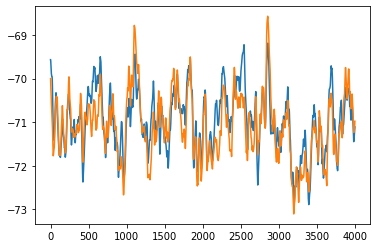

[2.68419213e+01 8.60851480e+01 3.31469856e-01 2.53389873e-02]


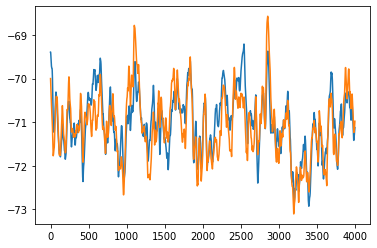

[2.70167013e+01 9.26899999e+01 4.50630873e-01 2.17562109e-02]


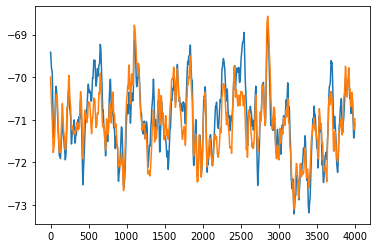

[3.82720796e+01 1.08025597e+02 4.34659250e-01 2.16109056e-02]


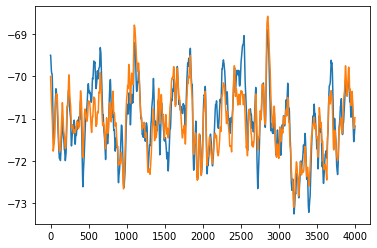

[3.56390211e+01 1.04302492e+02 3.80156187e-01 2.34237300e-02]


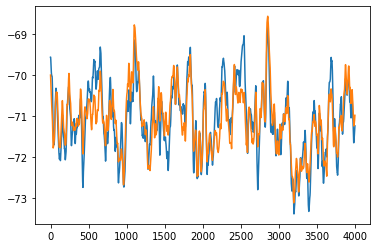

[3.59460008e+01 1.04607816e+02 3.31187718e-01 2.49021269e-02]


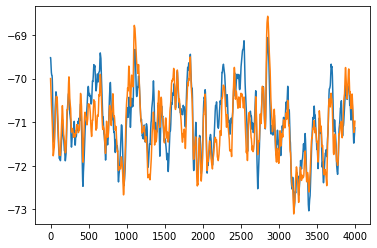

[3.07104939e+01 9.43175344e+01 3.63513309e-01 2.41969503e-02]


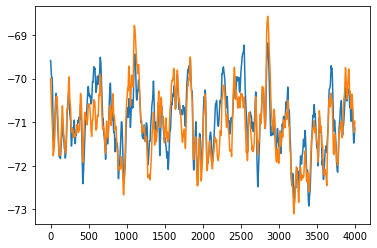

[2.68080411e+01 8.62002851e+01 3.16998598e-01 2.58268985e-02]


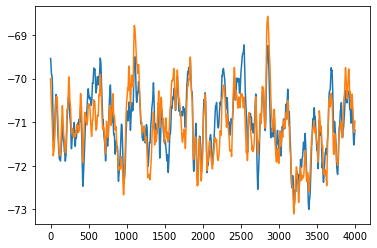

[2.71730210e+01 8.99899396e+01 3.49823819e-01 2.48161209e-02]


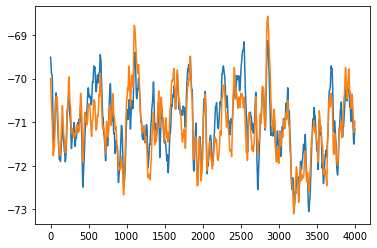

[2.99477857e+01 9.44988539e+01 3.71032676e-01 2.40148171e-02]


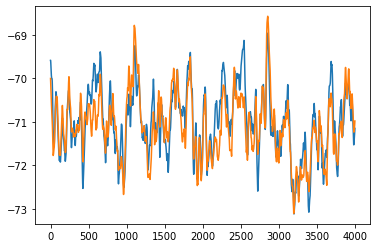

[3.15200816e+01 9.40038909e+01 3.17912327e-01 2.55103396e-02]


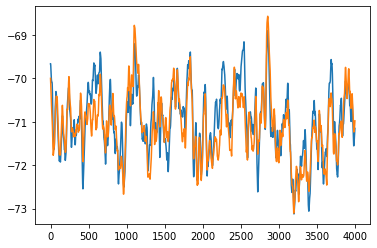

[3.09804852e+01 9.05854788e+01 2.59506130e-01 2.72908110e-02]


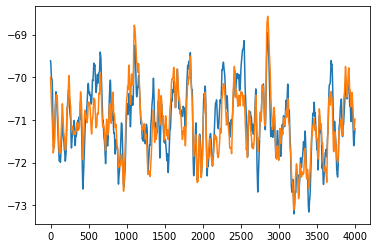

[3.16974812e+01 9.52818487e+01 2.96532229e-01 2.61791784e-02]


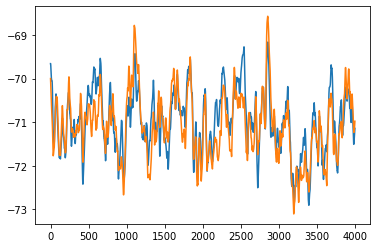

[2.60291019e+01 8.30393656e+01 2.65135985e-01 2.74171484e-02]


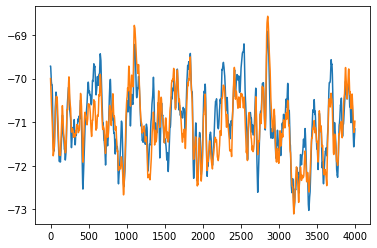

[2.97609955e+01 8.71132599e+01 2.21311150e-01 2.85272269e-02]


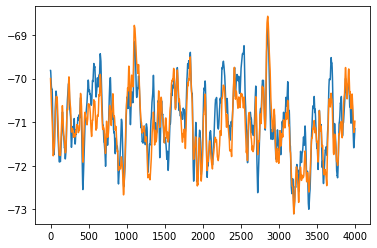

[2.96676004e+01 8.34204629e+01 1.46450387e-01 3.07834318e-02]


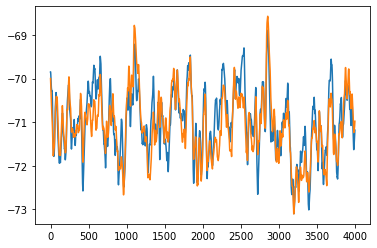

[2.84768404e+01 8.18460437e+01 1.20299057e-01 3.16383345e-02]


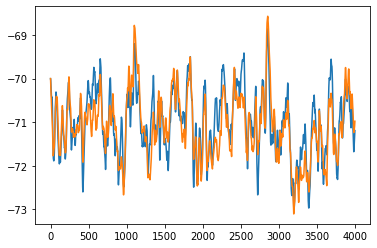

[ 2.73600136e+01  7.56102983e+01 -1.30806921e-03  3.53590266e-02]


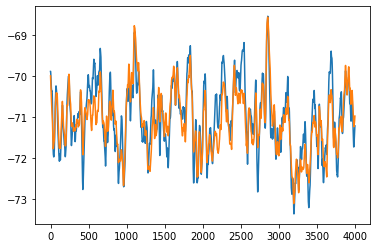

[3.38236883e+01 8.94096788e+01 8.54543527e-02 3.23890755e-02]


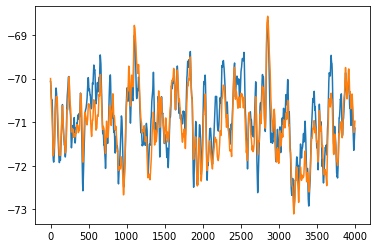

[ 2.92184125e+01  7.42311107e+01 -5.14808290e-02  3.67319941e-02]


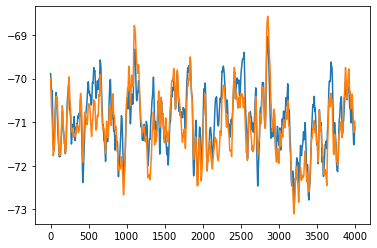

[2.47895675e+01 7.25139966e+01 9.11294564e-02 3.26935562e-02]


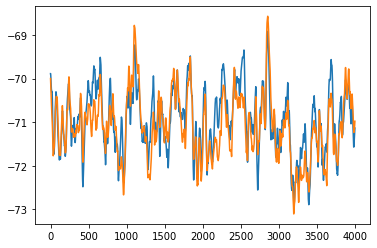

[2.70480977e+01 7.67379171e+01 8.97106805e-02 3.26174360e-02]


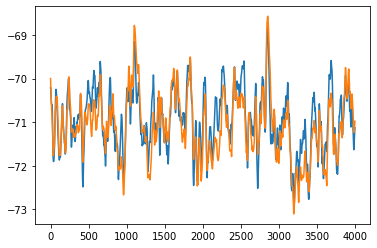

[ 2.56665769e+01  6.44144157e+01 -1.67820045e-01  4.04551332e-02]


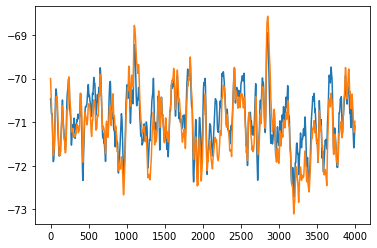

[ 2.30096228e+01  5.13288841e+01 -3.81483133e-01  4.70372944e-02]


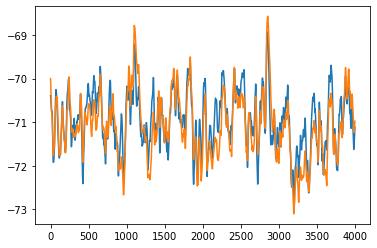

[ 2.36504729e+01  5.55336422e+01 -3.18731062e-01  4.50894437e-02]


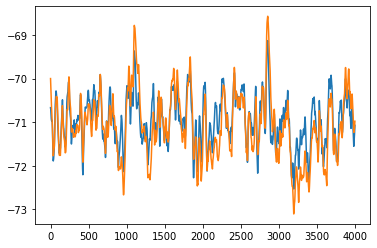

[20.64190923 41.59023176 -0.55132179  0.05224245]


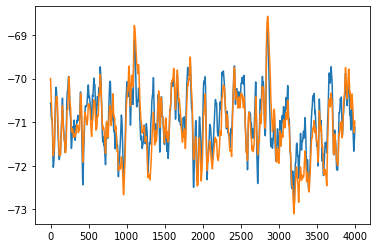

[ 2.45711632e+01  5.16140505e+01 -4.66212227e-01  4.94914434e-02]


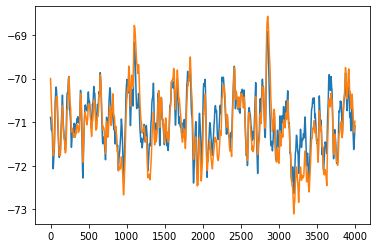

[23.33269594 39.05211715 -0.74417368  0.05792845]


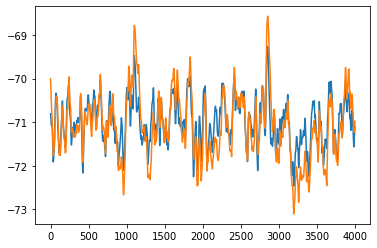

[19.45799017 36.53136017 -0.67136714  0.05597511]


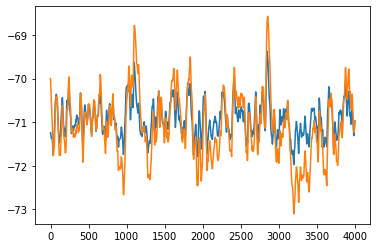

[17.3653773  15.6127035  -1.05656944  0.06765612]


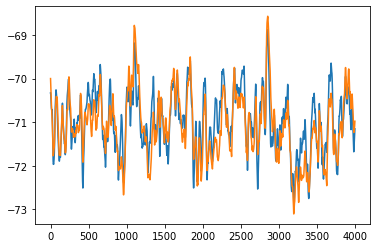

[ 2.48613545e+01  6.06108996e+01 -2.65123412e-01  4.34333004e-02]


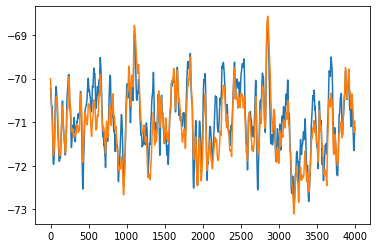

[ 2.79690829e+01  6.67314113e+01 -1.83388500e-01  4.07691310e-02]


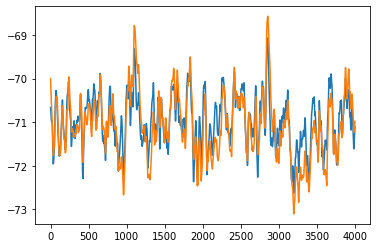

[21.58576336 44.08137296 -0.54937248  0.05217362]


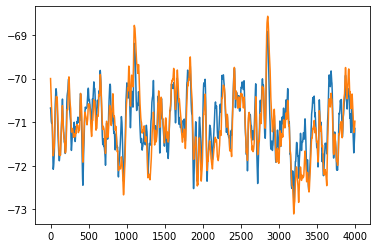

[23.70552061 48.31013182 -0.55721719  0.05227511]


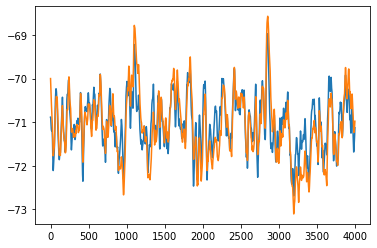

[23.09219428 40.4936186  -0.73921232  0.05781579]


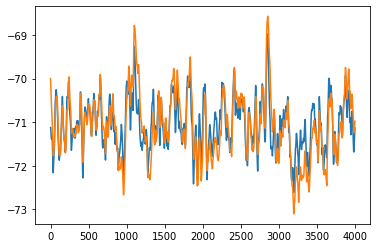

[22.81305495 32.97360683 -0.94945295  0.06417897]


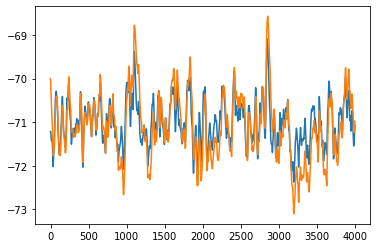

[20.99673256 25.35772068 -1.02986442  0.06666318]


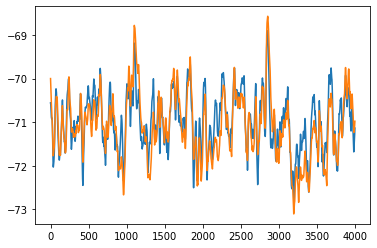

[ 2.38951990e+01  5.17976049e+01 -4.56308664e-01  4.92407710e-02]


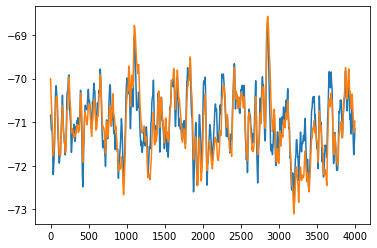

[25.42704158 45.74536326 -0.69908344  0.05645644]


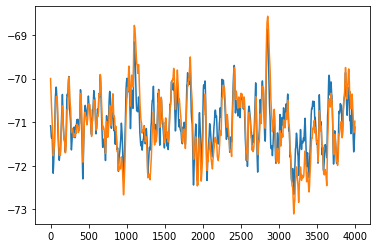

[23.88352716 35.00301056 -0.91353465  0.06299713]


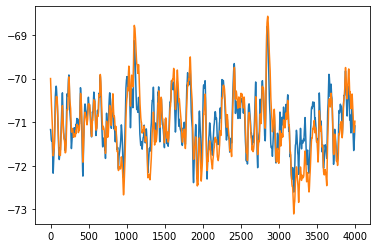

[24.16220887 31.83692296 -0.99078486  0.0653238 ]


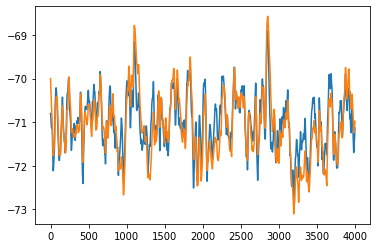

[23.81969267 44.19182961 -0.6656091   0.05553728]


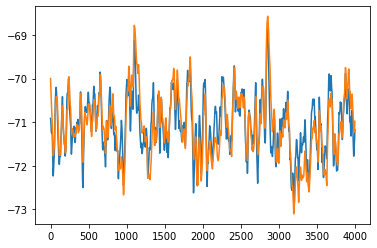

[24.77853191 43.66479387 -0.76454608  0.05847487]


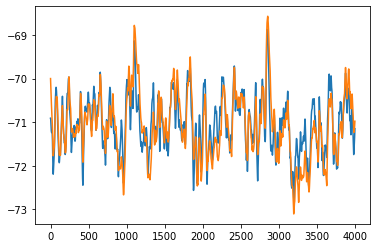

[24.41707291 42.51162469 -0.75945298  0.05833827]


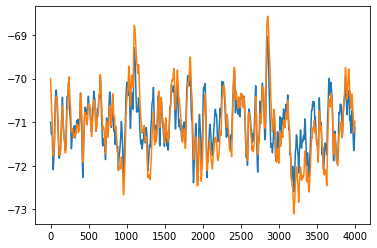

[22.17920194 35.35467847 -0.83982108  0.06088779]


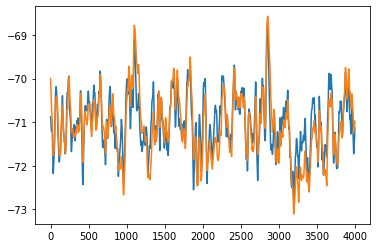

[24.61508167 43.14769206 -0.73426785  0.05756428]


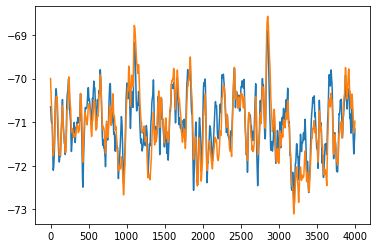

[24.08849361 50.16937192 -0.53573648  0.05163069]


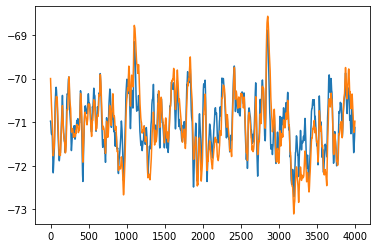

[23.93476877 38.7946009  -0.81908511  0.06015552]


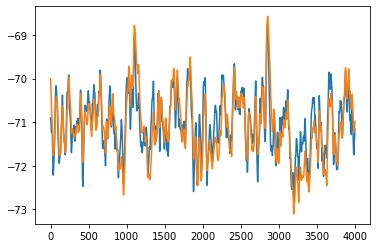

[25.30111373 43.82925502 -0.7499952   0.05798188]


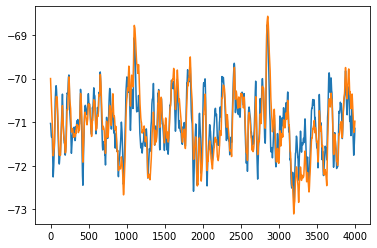

[25.31432587 39.94975673 -0.86579146  0.06148269]


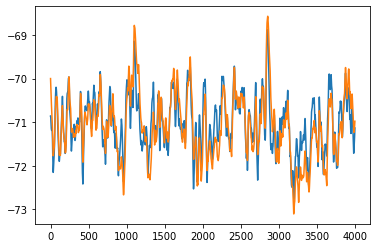

[24.19335097 43.13131139 -0.71565469  0.05702363]


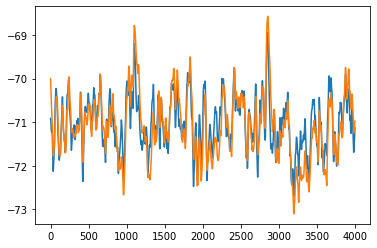

[23.27902343 39.96335949 -0.76423511  0.05855897]


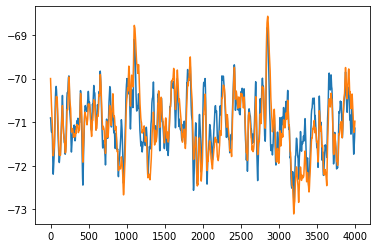

[24.79559116 42.86278114 -0.75355518  0.05812615]


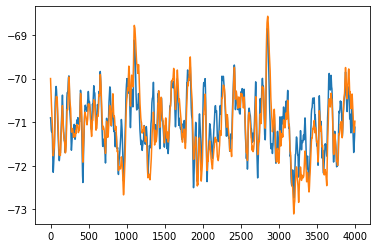

[24.35232337 41.45656806 -0.75182844  0.05809652]


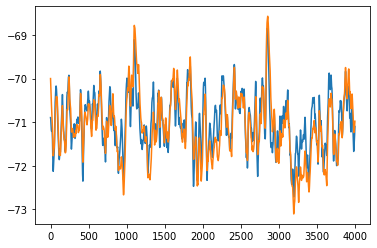

[24.3199486  40.92903974 -0.74801617  0.05797565]


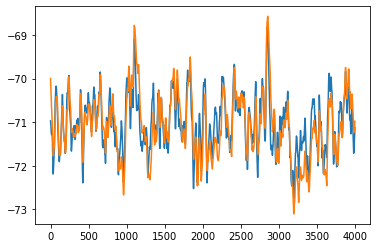

[24.65553151 39.99950969 -0.81371359  0.0599476 ]


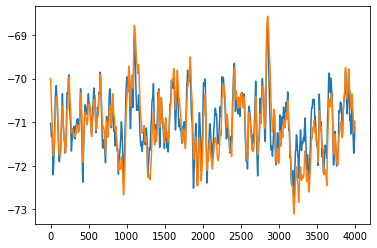

[24.88662178 38.43360884 -0.86274304  0.06140959]


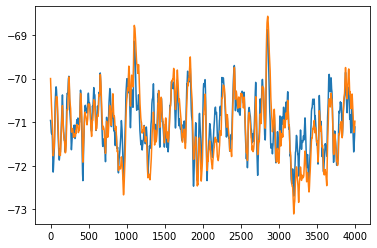

[23.9832615  38.83640421 -0.80589232  0.05975581]


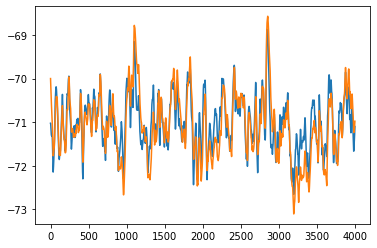

[23.84786091 36.39584937 -0.86099188  0.06141344]


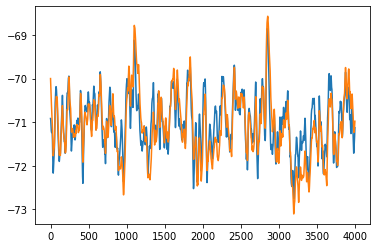

[24.42327648 41.45973139 -0.76594886  0.05852657]


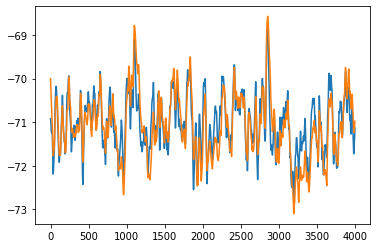

[24.69968856 42.01880081 -0.76939568  0.0586073 ]


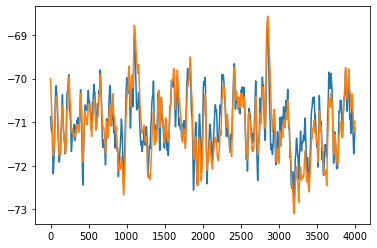

[25.13064119 43.67270407 -0.73135818  0.05743348]


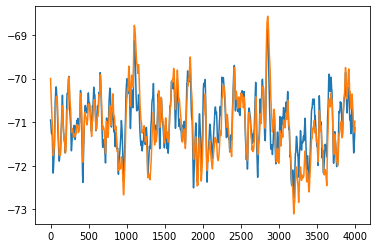

[24.23373688 40.01412669 -0.79715337  0.05947501]


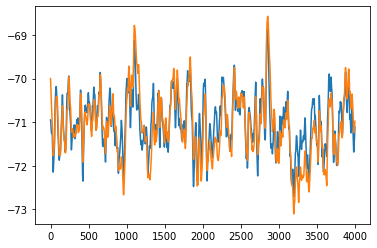

[24.13274555 39.44616711 -0.79492645  0.05941555]


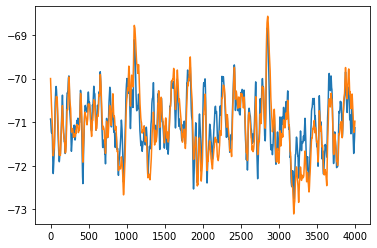

[24.55795281 41.37564238 -0.77577837  0.05880936]


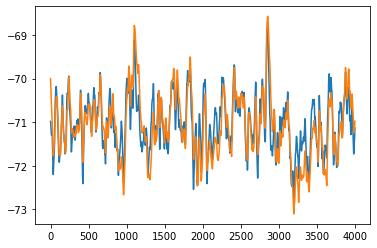

[24.58292547 39.96793702 -0.82446866  0.06028275]


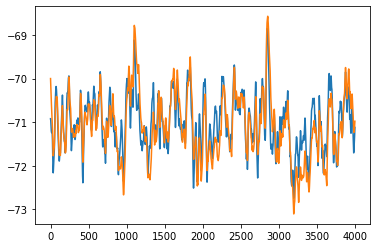

[24.40997389 41.0844103  -0.76998849  0.05864308]


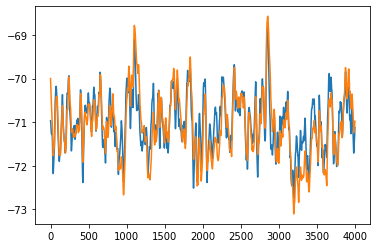

[24.50532107 39.77711314 -0.81236806  0.05991095]


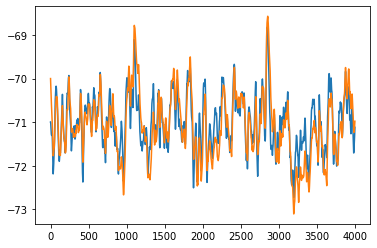

[24.54634336 38.93580402 -0.83557766  0.06060314]


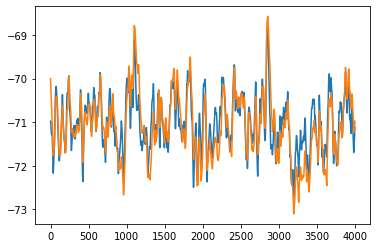

[24.34432886 39.06193753 -0.82083339  0.06017896]


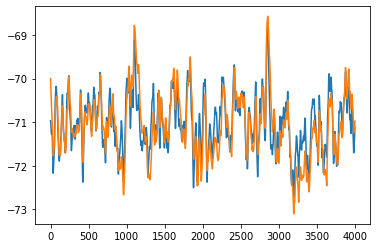

[24.39773485 39.64036374 -0.80956963  0.05983656]


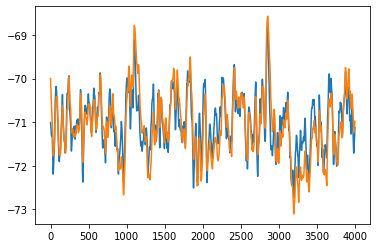

[24.48618826 38.63114634 -0.84641384  0.06094198]


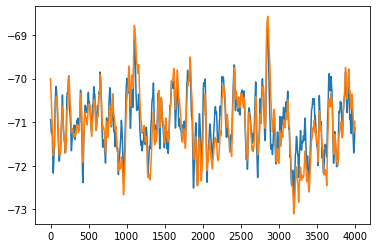

[24.42902748 40.47109431 -0.78909483  0.0592178 ]


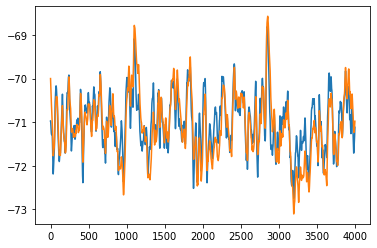

[24.76007058 39.92991375 -0.81521968  0.05998145]


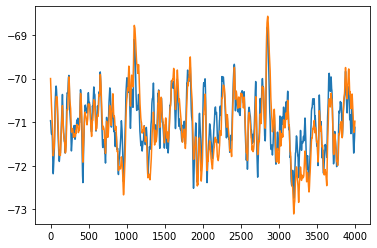

[24.62848715 39.95096699 -0.81070311  0.05985484]


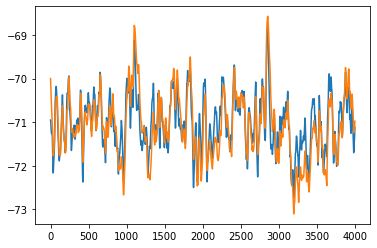

[24.32475377 39.9202594  -0.79715422  0.05946248]


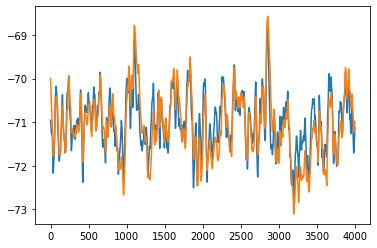

[24.4074482  39.94007197 -0.80129407  0.05958376]


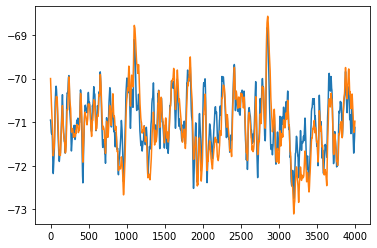

[24.5874071  40.42925946 -0.7971604   0.05944712]


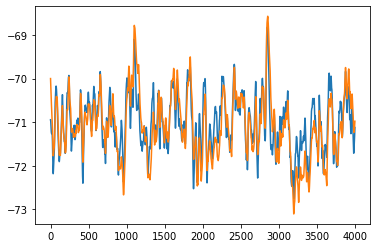

[24.68224323 40.82370732 -0.79095578  0.0592524 ]


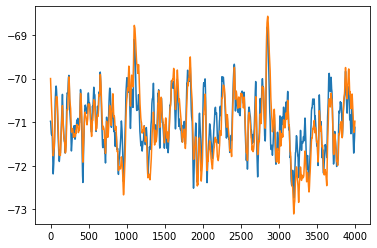

[24.63530428 39.57761147 -0.82166799  0.06018053]


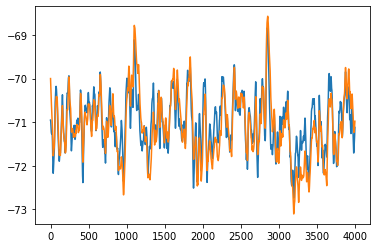

[24.48059668 40.2477236  -0.79723812  0.05945849]


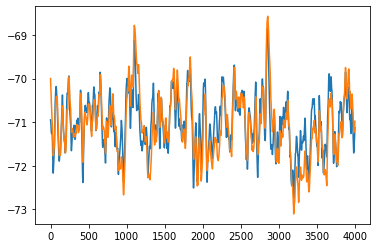

[24.36189937 40.2461171  -0.79332721  0.05934532]


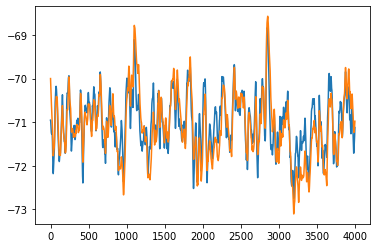

[24.56016391 40.41003468 -0.79875283  0.05949718]


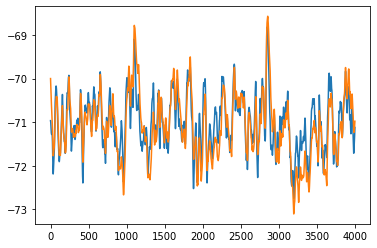

[24.70484501 40.18594834 -0.80943249  0.05981155]


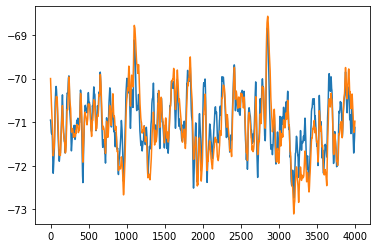

[24.44763578 40.23107491 -0.79735353  0.05946188]


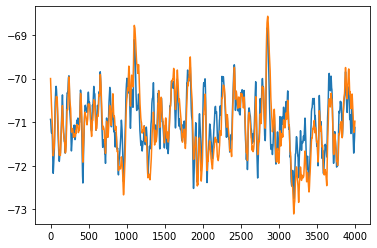

[24.53258067 40.88193318 -0.78288438  0.05902138]


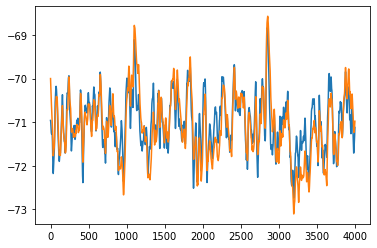

[24.51213597 40.05331815 -0.80499714  0.05968856]


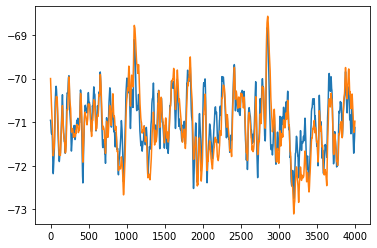

[24.5730747  40.31412    -0.80189383  0.05958888]


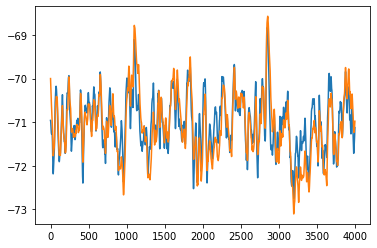

[24.61931371 40.34731821 -0.80422169  0.05965408]


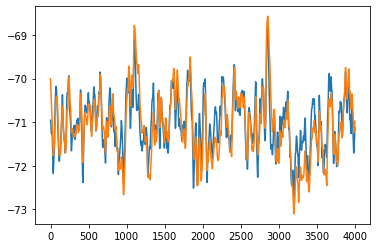

[24.49996287 40.10385158 -0.80194962  0.05959604]


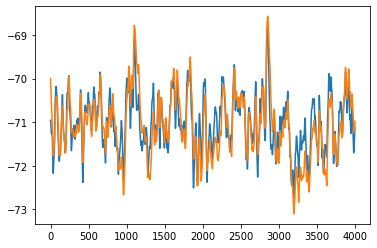

[24.46986234 39.95076004 -0.80354802  0.05964547]


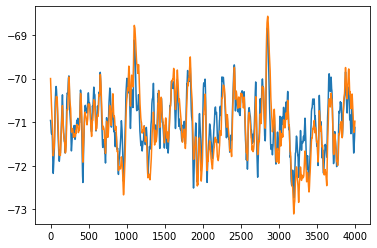

[24.42899755 39.92192287 -0.80593667  0.05972056]


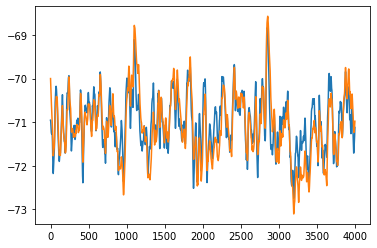

[24.54780472 40.30242531 -0.79935446  0.05951548]


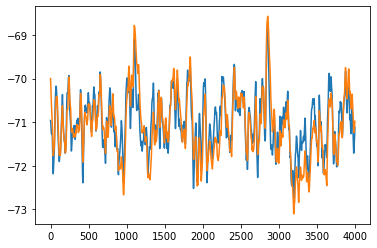

[24.61885334 40.15578262 -0.806744    0.0597326 ]


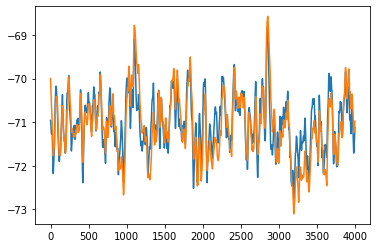

[24.57604895 40.17460569 -0.80439638  0.05966492]


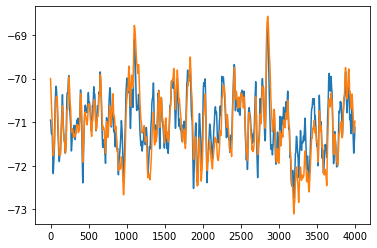

[24.58630965 40.39418314 -0.79880001  0.0594941 ]


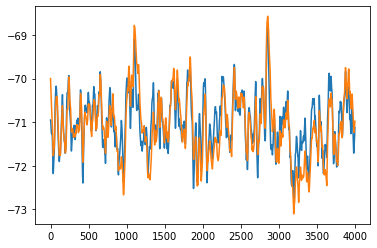

[24.62339649 40.56461564 -0.79570144  0.05939687]


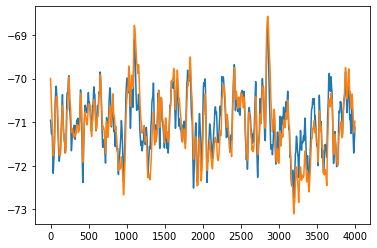

[24.53198839 40.17341286 -0.80035641  0.05954639]


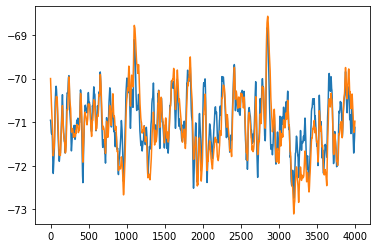

[24.54225997 40.20858965 -0.80074076  0.05955701]


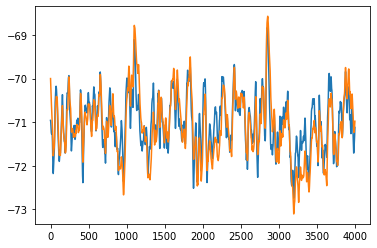

[24.554486   40.13818972 -0.80358892  0.05964056]


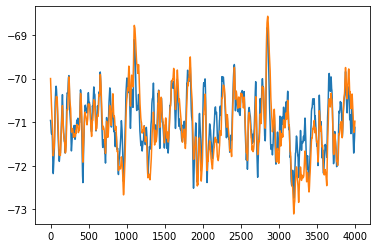

[24.55782665 40.05607192 -0.80570615  0.0597031 ]


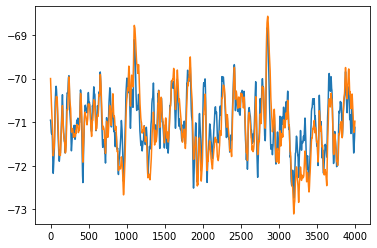

[24.51713061 40.20674246 -0.79920189  0.0595102 ]


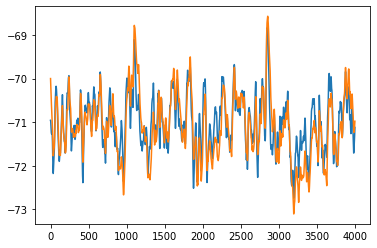

[24.53835492 40.17183491 -0.80208807  0.05959471]


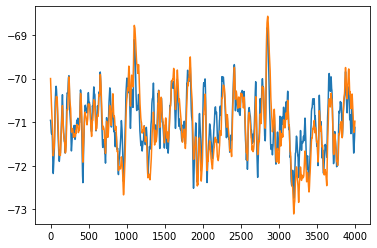

[24.53640239 40.15345754 -0.80276173  0.05961355]


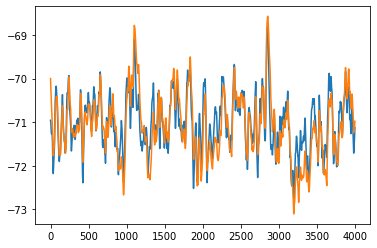

[24.59887178 40.30137594 -0.80128527  0.05956444]


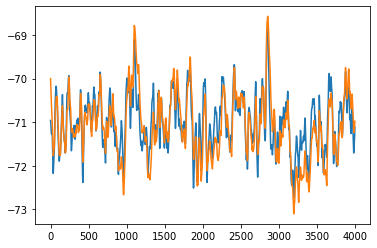

[24.51880607 39.96464079 -0.80567751  0.05970154]


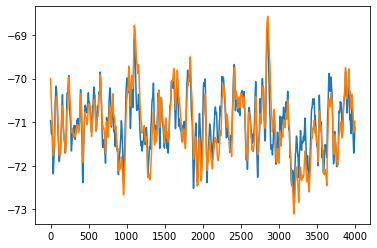

[24.58882283 40.03103064 -0.80851344  0.05978111]


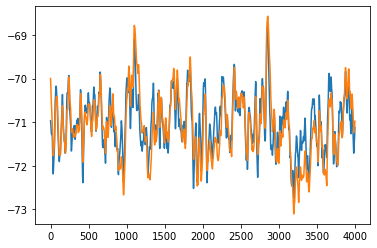

[24.62466894 39.94317473 -0.81316921  0.05991657]


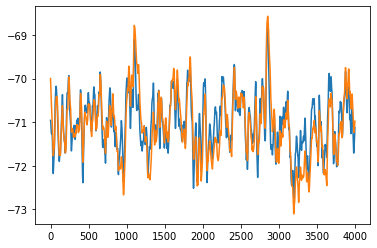

[24.56362489 40.16918053 -0.80341282  0.05962723]


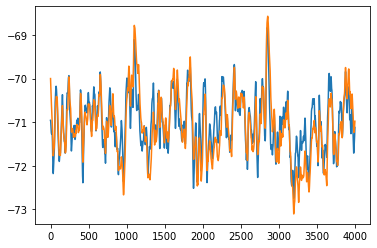

[24.56652401 40.22573484 -0.80226616  0.05958929]


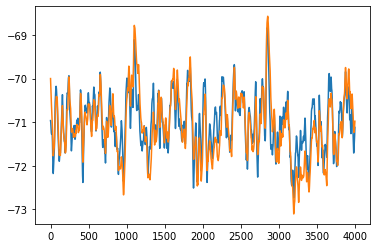

[24.50640587 39.88605596 -0.80832415  0.05977831]


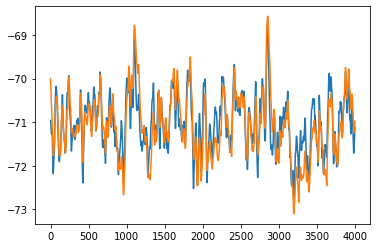

[24.58027149 40.1834987  -0.80525522  0.05967959]


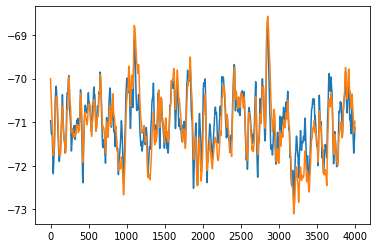

[24.58460971 40.00970253 -0.80941775  0.0598006 ]


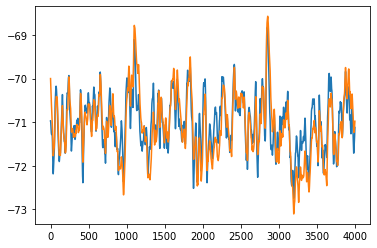

[24.60871337 39.93782502 -0.81274577  0.05989413]


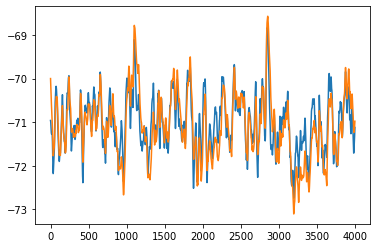

[24.54213454 40.08552662 -0.80578221  0.05968955]


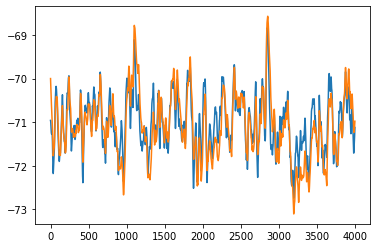

[24.51879039 40.11277461 -0.8044166   0.05964378]


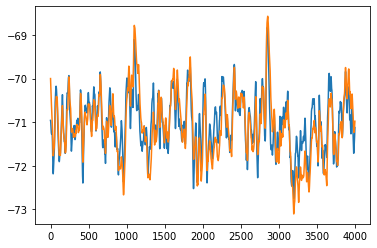

[24.63074376 40.34386062 -0.80401773  0.05962508]


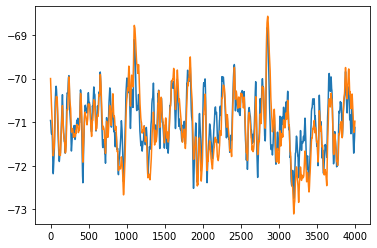

[24.58211428 40.12659885 -0.8064679   0.05969655]


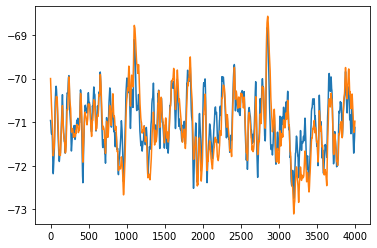

[24.58303567 40.09814892 -0.80707424  0.05970502]


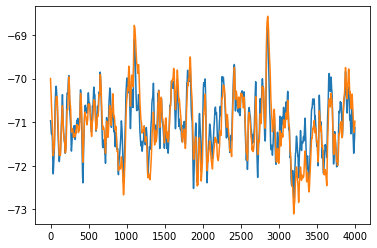

[24.60411758 40.02056975 -0.81186101  0.05984471]


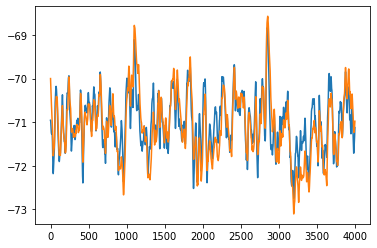

[24.55963033 40.34985193 -0.80093902  0.05951517]


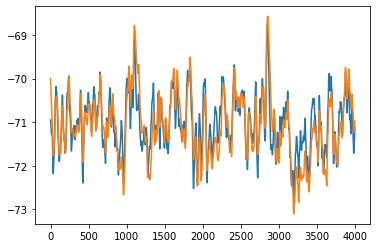

[24.53508882 40.55586539 -0.79503564  0.05932568]


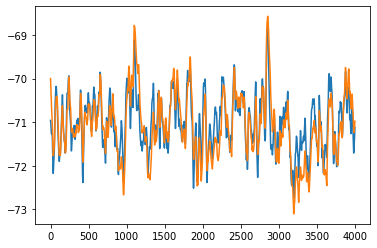

[24.48977247 40.04981871 -0.80517602  0.05963451]


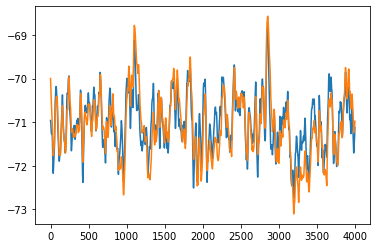

[24.41928683 39.90279775 -0.80575516  0.05963923]


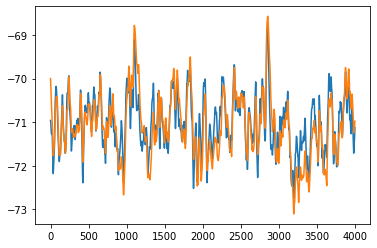

[24.55197406 40.1759163  -0.80544643  0.05961355]


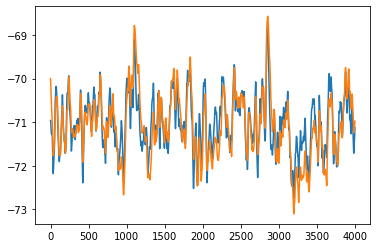

[24.5685659  40.20748715 -0.80596134  0.05959844]


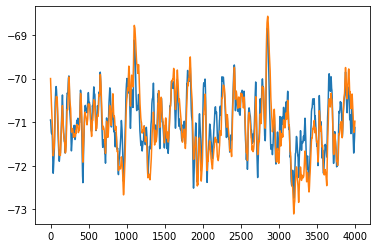

[24.44887103 40.36157986 -0.79505218  0.05928947]


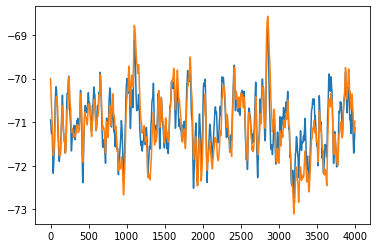

[24.40287061 40.41571615 -0.79382793  0.05922139]


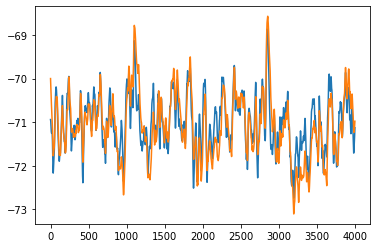

[24.31278808 40.57449976 -0.78720477  0.05897957]


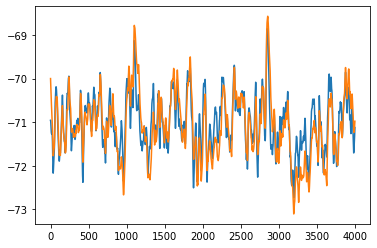

[24.3396671  39.96731687 -0.80195109  0.05942767]


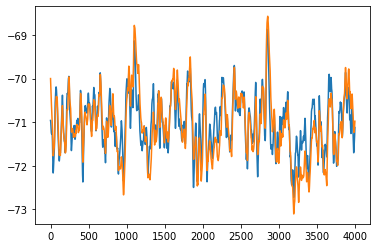

[24.24195625 39.67304261 -0.80540881  0.05947867]


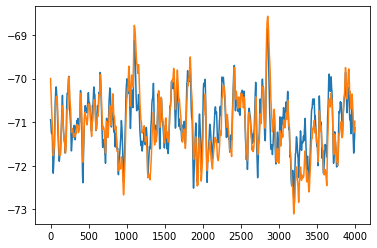

[24.3668038  40.50550694 -0.79105839  0.05903384]


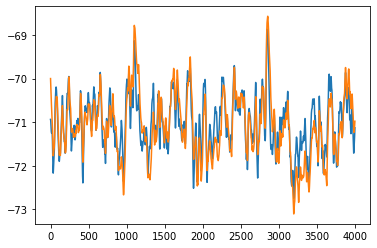

[24.34056229 40.80686153 -0.78371     0.05873115]


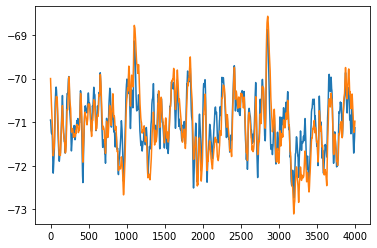

[24.28306523 40.26936567 -0.79609028  0.05910444]


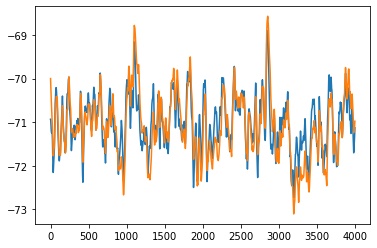

[24.02062002 40.45439764 -0.78024559  0.05854848]


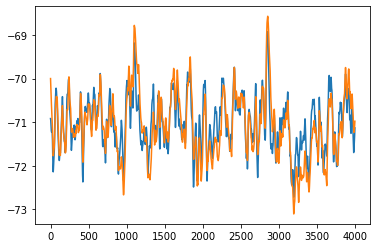

[23.74664708 40.57785288 -0.76738772  0.0580235 ]


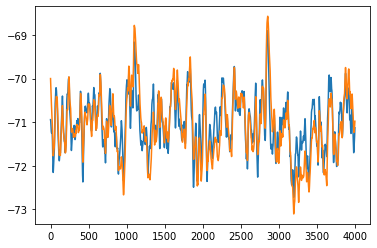

[23.99332734 40.08906159 -0.78909363  0.0586893 ]


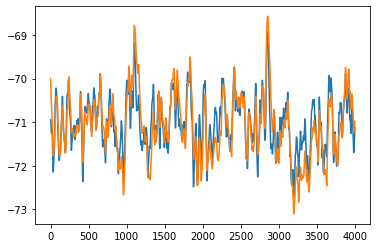

[23.83359696 39.8463425  -0.79003806  0.05854417]


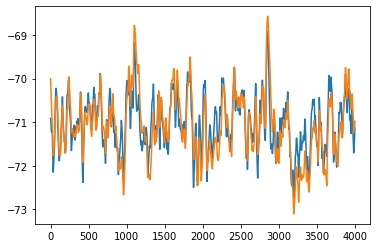

[23.85997954 41.07716868 -0.76320422  0.05772296]


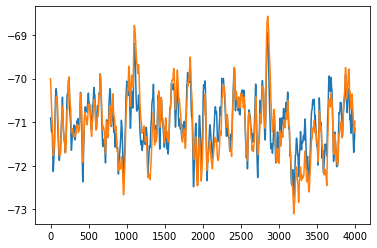

[23.60732771 40.88474712 -0.75607972  0.05740645]


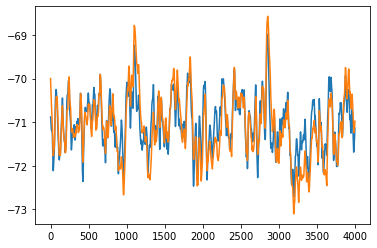

[23.26945895 41.19243785 -0.73607444  0.05655746]


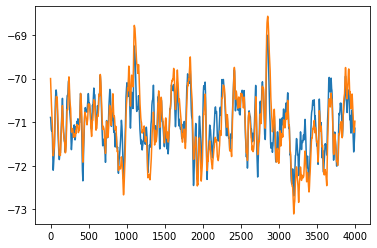

[23.01427898 40.54003943 -0.74464222  0.05669289]


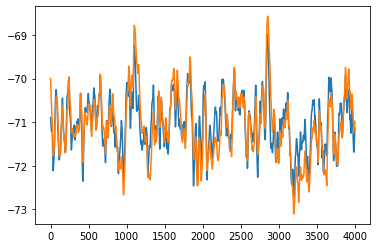

[23.24201013 40.75014135 -0.74959175  0.05673525]


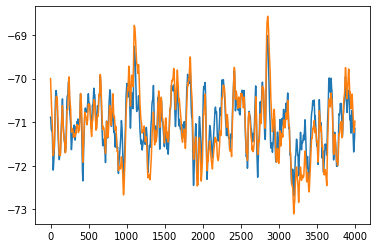

[22.98969165 40.83628558 -0.74069377  0.05609112]


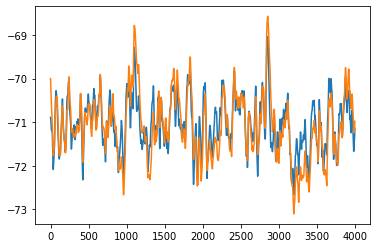

[22.69353374 40.130384   -0.74252003  0.05621986]


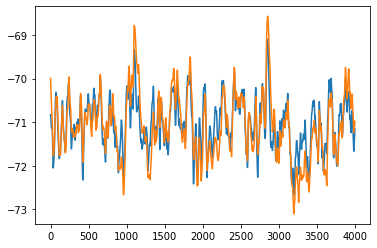

[22.14988469 41.50323093 -0.69192717  0.0542365 ]


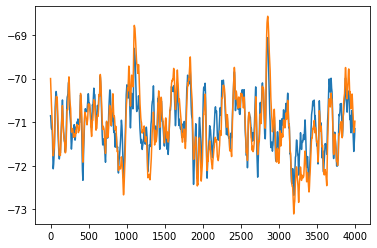

[22.53700554 41.29112976 -0.71096549  0.05485958]


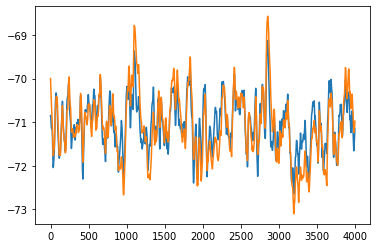

[21.91559886 40.68807728 -0.70697878  0.05414607]


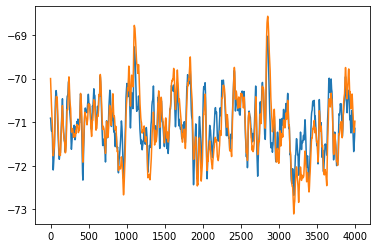

[22.9180302  39.96970738 -0.75865186  0.05642182]


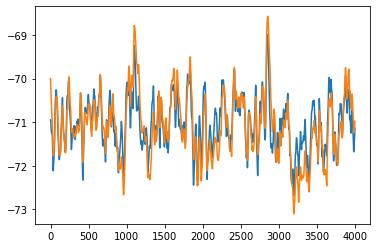

[23.30210295 39.20294561 -0.79201421  0.05751448]


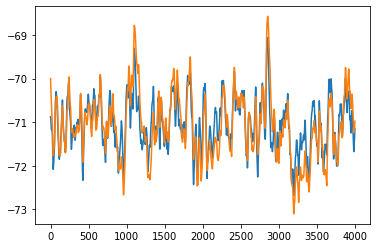

[22.67866576 40.87883511 -0.7328061   0.05508576]


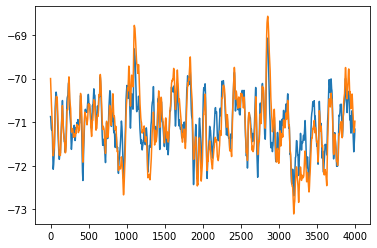

[22.67123178 41.25306066 -0.72794914  0.05451871]


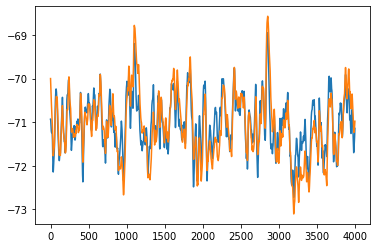

[23.8344171  40.60363352 -0.77883252  0.05734587]


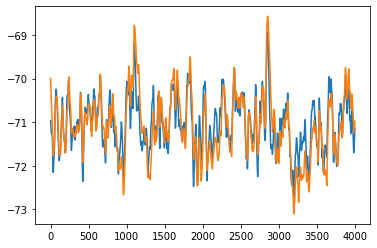

[23.8617162  39.65683293 -0.80877933  0.05787551]


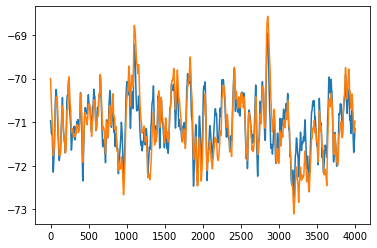

[23.84504236 39.52195078 -0.81309383  0.05753616]


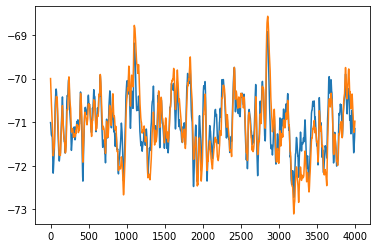

[24.27271772 38.86478339 -0.84929386  0.05825868]


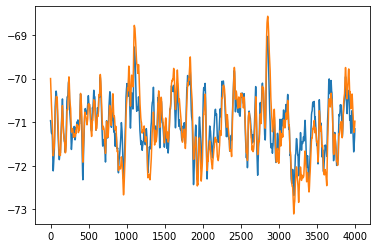

[23.21946723 38.88517777 -0.81018575  0.05673781]


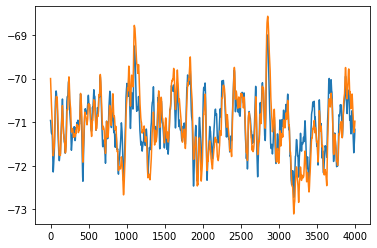

[23.71046351 40.12698177 -0.80608983  0.05618088]


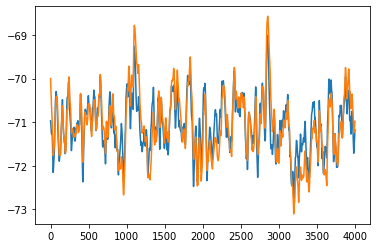

[23.91464379 40.58899985 -0.81312764  0.05551408]


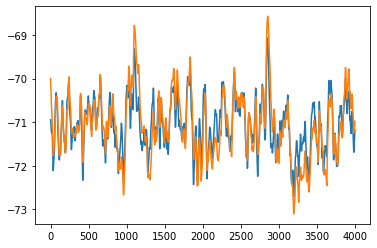

[23.17731406 40.1391779  -0.79149886  0.05463913]


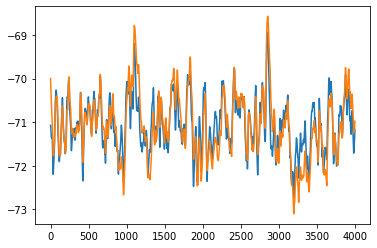

[24.62083962 37.98600879 -0.90410391  0.05805615]


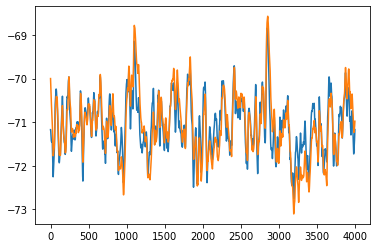

[25.59564354 36.35248286 -0.9921813   0.05982487]


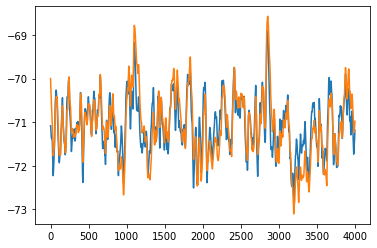

[25.26069233 39.08754422 -0.91286507  0.05738057]


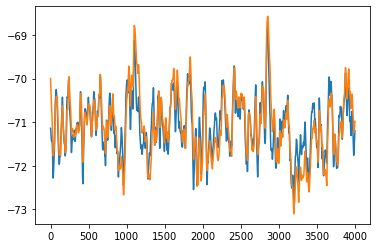

[26.28130488 39.18872745 -0.96420474  0.05770194]


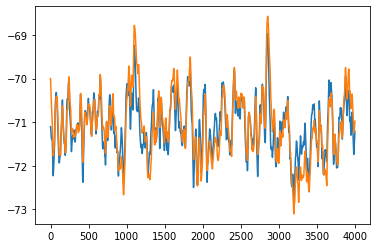

[25.21173542 39.26991064 -0.93121241  0.05558133]


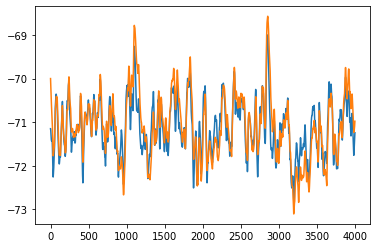

[25.68124426 39.47247427 -0.97217169  0.05424266]


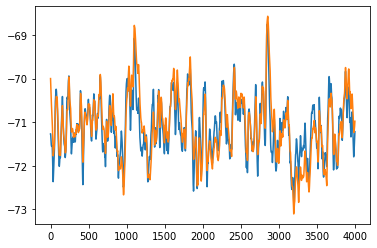

[27.55910418 37.6621643  -1.07934382  0.05900264]


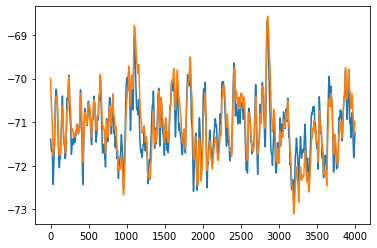

[28.64400464 35.74892459 -1.19082313  0.05987197]


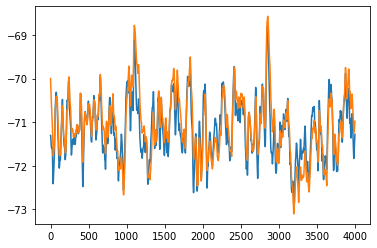

[28.48718544 39.68366245 -1.11109039  0.05558474]


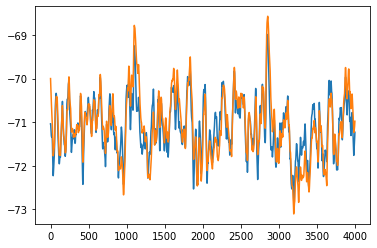

[25.36041474 42.25458964 -0.87258218  0.05339402]


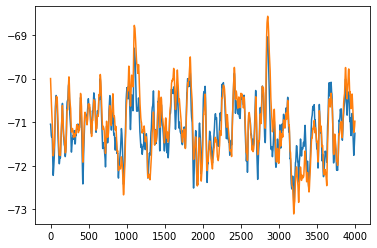

[25.34597048 42.6375626  -0.88068068  0.05145903]


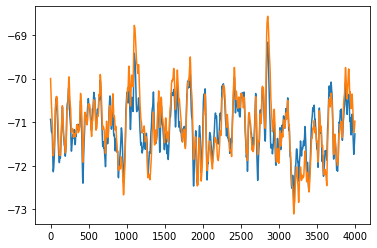

[24.23940363 45.12526174 -0.7813491   0.04768723]


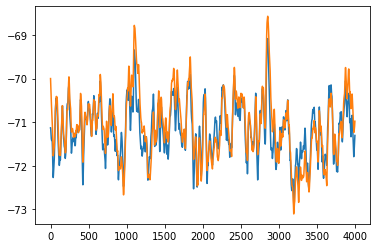

[26.15610259 42.83541703 -0.95405773  0.04963828]


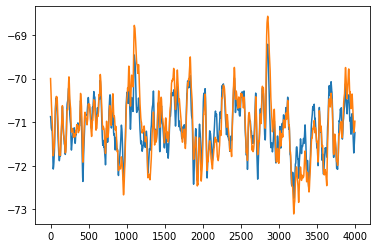

[22.7846806  43.91635932 -0.72865575  0.04878226]


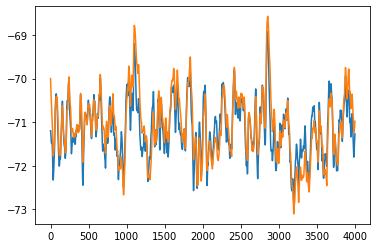

[27.06155923 40.74183667 -1.01548173  0.05388412]


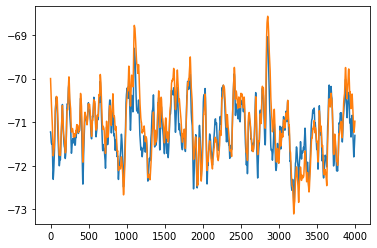

[26.76202354 40.58905564 -1.03861373  0.05121803]


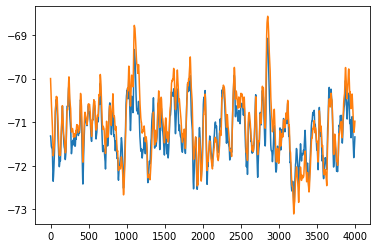

[27.46282793 39.75628864 -1.1216295   0.05013004]


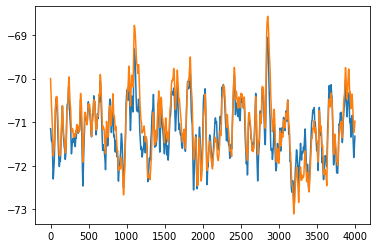

[26.98158365 43.9294617  -0.97224525  0.04885708]


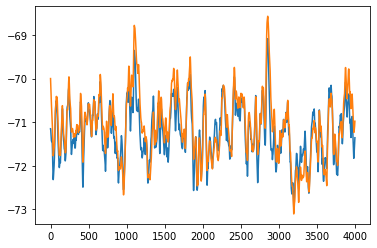

[27.63175335 46.15795542 -0.97228203  0.04616428]


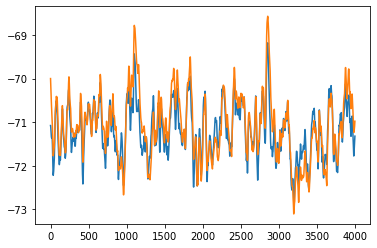

[25.5612809  44.25391182 -0.90731696  0.04670209]


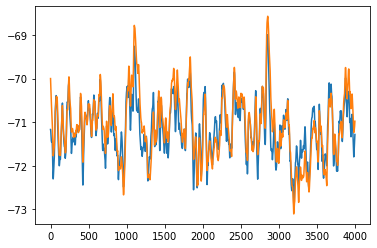

[26.68648965 41.61985545 -0.98844054  0.05208861]


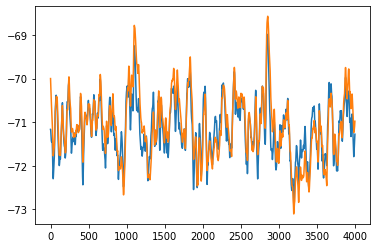

[26.73193107 41.55255066 -0.98593236  0.05217309]


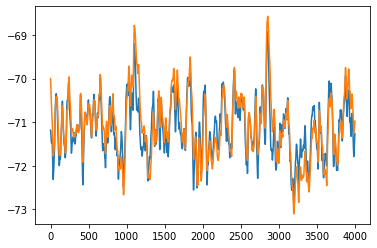

[27.01984531 40.91111748 -1.00186968  0.0534405 ]


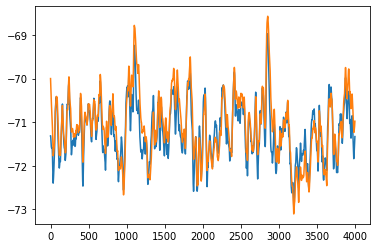

[28.37900059 40.88718254 -1.11990392  0.05134307]


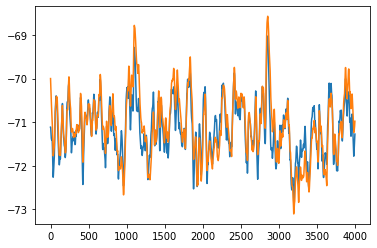

[26.10422801 42.19996758 -0.94048649  0.05143004]


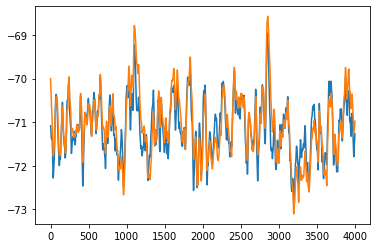

[26.63404977 43.74114547 -0.91290725  0.05169008]


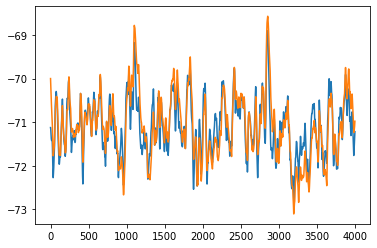

[26.24072272 40.30658129 -0.94960673  0.05546754]


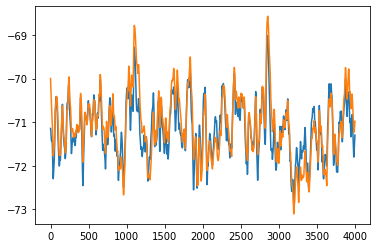

[26.79636842 43.0237416  -0.96658562  0.05050969]


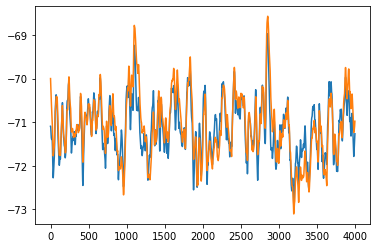

[26.59075611 43.31813061 -0.92248398  0.05144655]


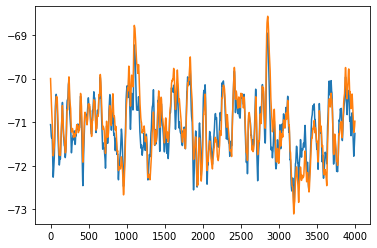

[26.54288934 44.16726819 -0.8895057   0.05112551]


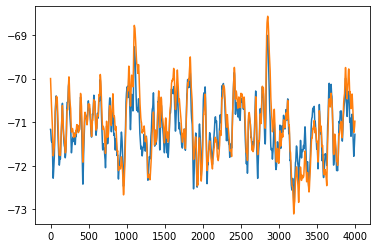

[26.59761577 41.40990195 -0.98631649  0.05156279]


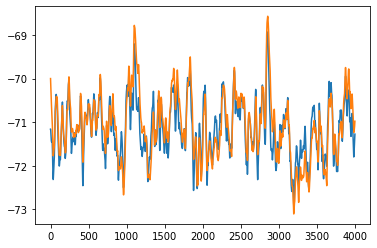

[27.37413141 42.55604703 -0.98165226  0.0518892 ]


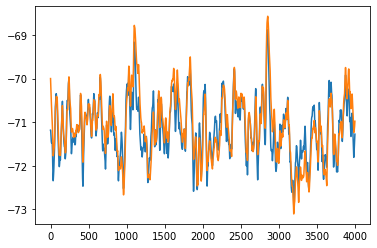

[28.00908311 42.73408675 -1.00223514  0.05211878]


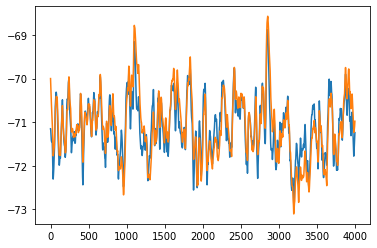

[27.28834835 41.58744558 -0.97337789  0.0536141 ]


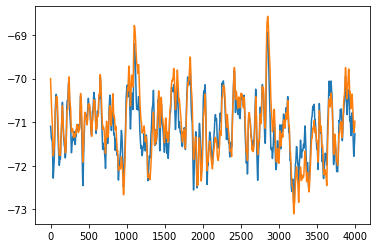

[27.19912297 44.03823376 -0.92384793  0.05077009]


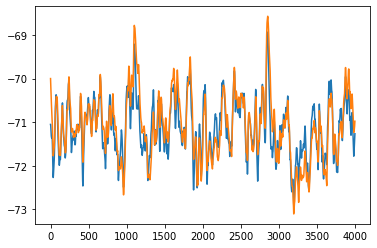

[27.28876181 45.6017919  -0.88483706  0.04943489]


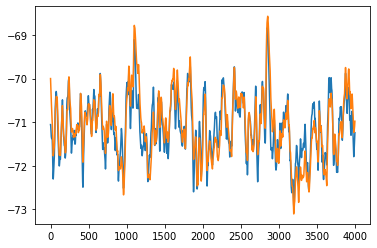

[27.96692554 45.63539425 -0.8886614   0.05158385]


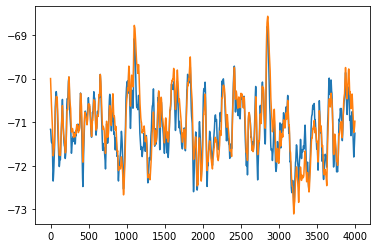

[28.73367006 43.61209106 -0.98505004  0.0522503 ]


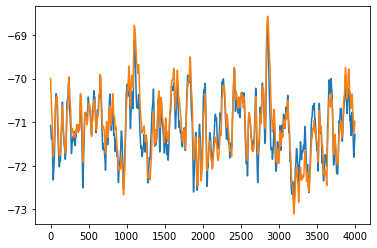

[28.71087191 47.20423639 -0.90701393  0.04907982]


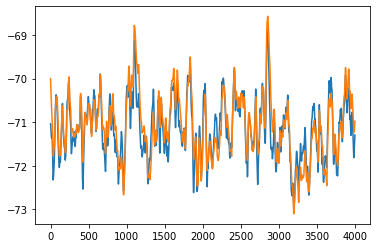

[ 2.94221337e+01  5.00126318e+01 -8.73831954e-01  4.68126741e-02]


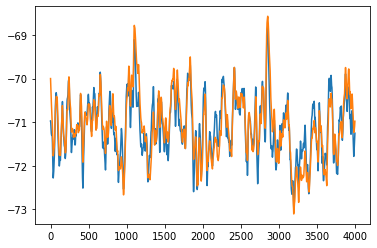

[ 2.86966624e+01  4.96968678e+01 -8.13955085e-01  4.79220785e-02]


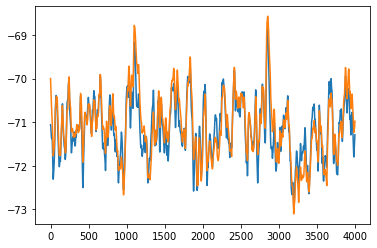

[ 2.91036885e+01  4.88262970e+01 -8.90175671e-01  4.66261187e-02]


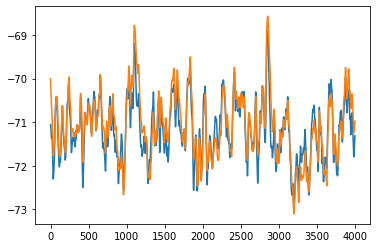

[ 2.96720699e+01  5.04217484e+01 -8.90932808e-01  4.41472512e-02]


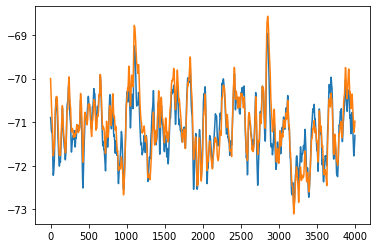

[ 2.88061439e+01  5.42544289e+01 -7.46728407e-01  4.19081491e-02]


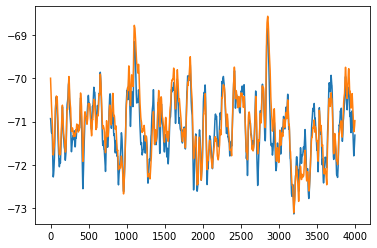

[ 3.10097431e+01  5.65910465e+01 -7.77887072e-01  4.09601835e-02]


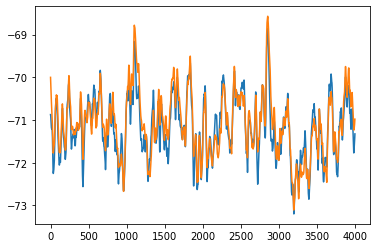

[ 3.28702338e+01  6.20856738e+01 -7.24412080e-01  3.67228288e-02]


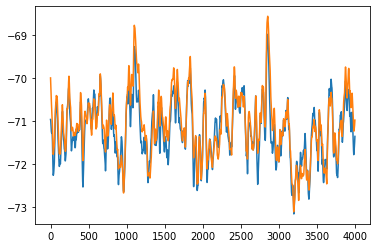

[ 3.16886282e+01  5.86903736e+01 -8.03997539e-01  3.68733731e-02]


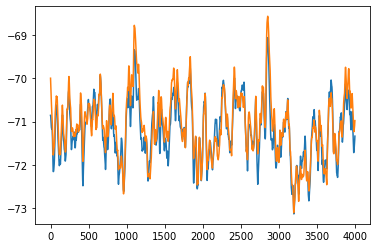

[ 3.20964042e+01  6.27134805e+01 -7.09203463e-01  3.30131270e-02]


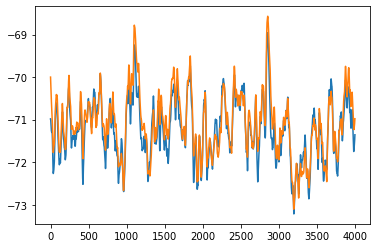

[ 3.43575242e+01  6.27012093e+01 -8.17544538e-01  3.34701409e-02]


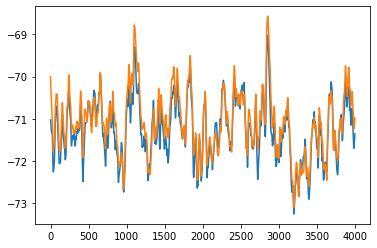

[ 3.71332144e+01  6.69245995e+01 -8.52952603e-01  2.92511369e-02]


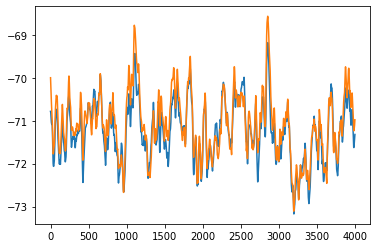

[ 3.58343253e+01  7.26736203e+01 -6.36646002e-01  2.58924837e-02]


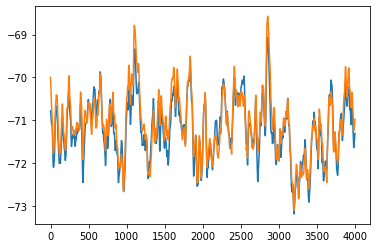

[ 3.58906156e+01  7.13966183e+01 -6.39905502e-01  2.76759172e-02]


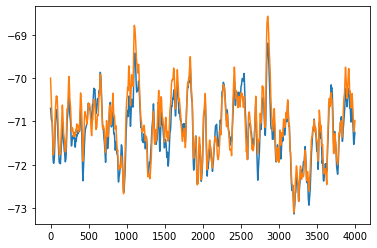

[ 3.79916092e+01  7.77497406e+01 -5.57859484e-01  2.30771892e-02]


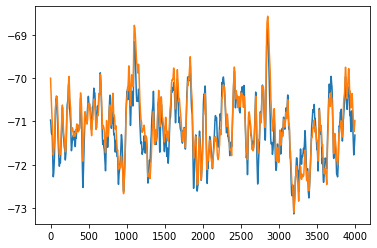

[ 3.17730636e+01  5.67748707e+01 -8.08886790e-01  3.95485232e-02]


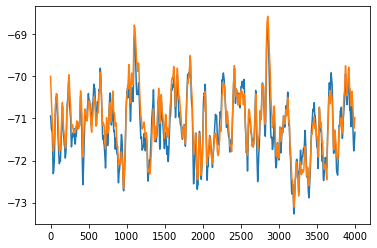

[ 3.53493144e+01  6.37657055e+01 -7.86170991e-01  3.56955781e-02]


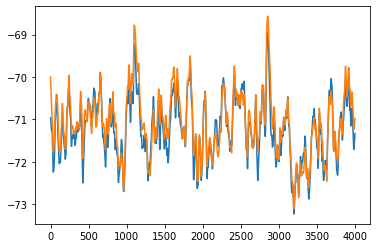

[ 3.58150251e+01  6.52335281e+01 -8.01841831e-01  3.14722509e-02]


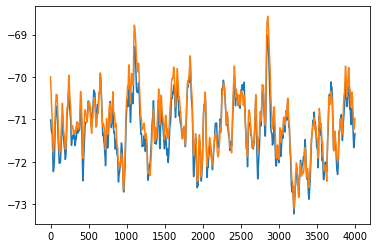

[ 3.72874207e+01  6.68074553e+01 -8.40556706e-01  2.88469620e-02]


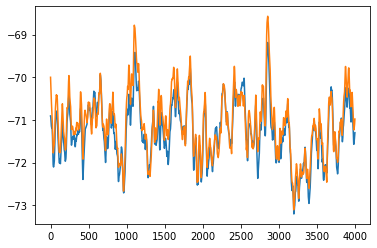

[ 3.96693738e+01  7.55606235e+01 -7.33202079e-01  2.32957759e-02]


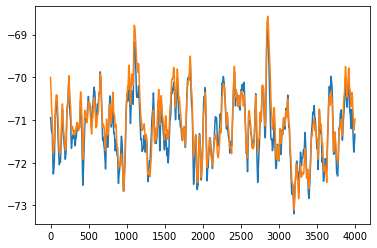

[ 3.37471412e+01  6.14713089e+01 -7.89965612e-01  3.54853364e-02]


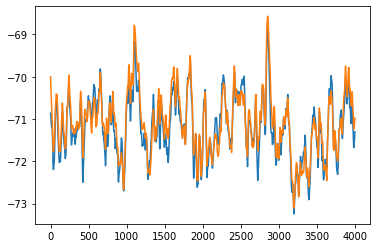

[ 3.67797217e+01  6.90193347e+01 -7.10754868e-01  3.03817559e-02]


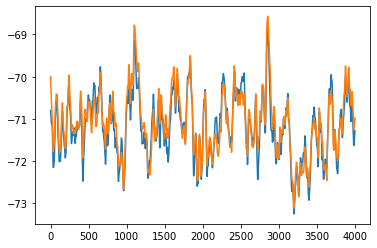

[ 3.79908204e+01  7.21783974e+01 -6.57360033e-01  2.88375633e-02]


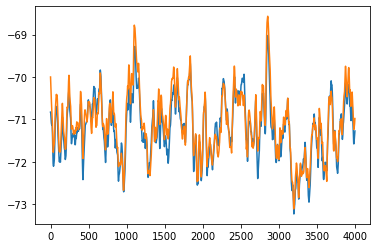

[ 3.95119444e+01  7.56027794e+01 -6.72031005e-01  2.50426739e-02]


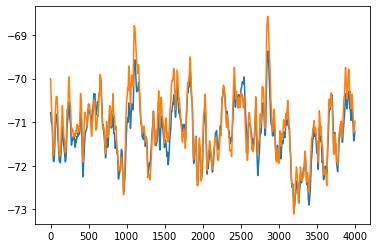

[ 3.99910861e+01  7.92269197e+01 -6.18755632e-01  1.95059801e-02]


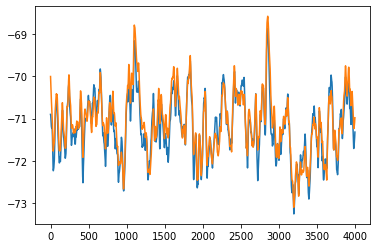

[ 3.65097573e+01  6.76310091e+01 -7.44317151e-01  3.16481786e-02]


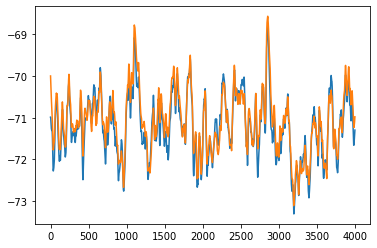

[ 3.97593558e+01  6.97132023e+01 -8.17226946e-01  2.95117717e-02]


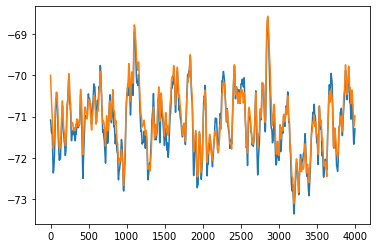

[ 4.16937260e+01  6.88714942e+01 -9.05887668e-01  3.04296990e-02]


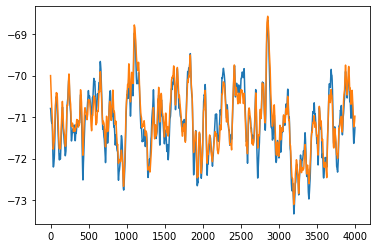

[ 4.05657034e+01  7.53343847e+01 -6.49241222e-01  2.91320954e-02]


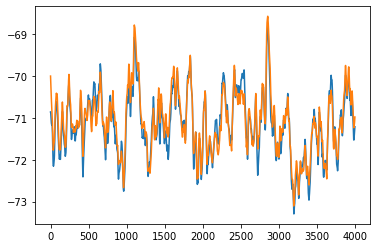

[ 4.33713397e+01  7.83625188e+01 -6.97942812e-01  2.50728372e-02]


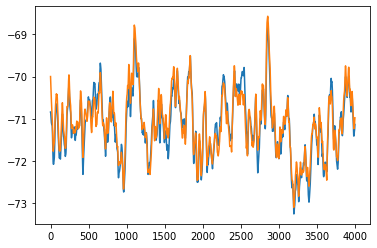

[ 4.68021309e+01  8.37282737e+01 -6.74755643e-01  2.17851666e-02]


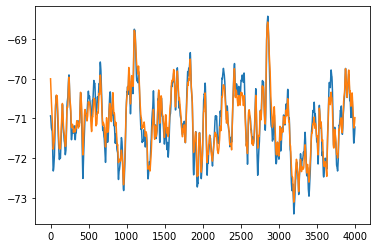

[ 4.40142460e+01  7.44534956e+01 -7.71591278e-01  3.00495883e-02]


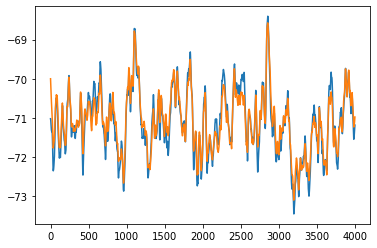

[ 4.85470827e+01  7.90154267e+01 -8.43377872e-01  2.68607113e-02]


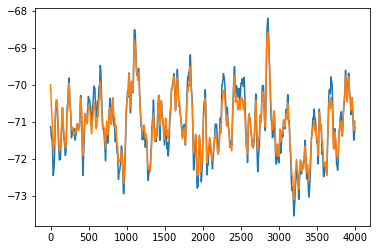

[ 5.38252138e+01  8.24339414e+01 -9.36386791e-01  2.58722853e-02]


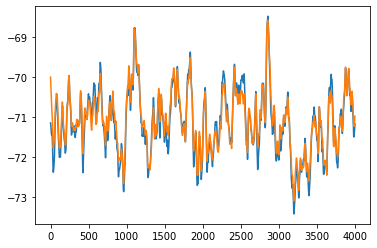

[ 4.99628894e+01  7.76999604e+01 -9.48565008e-01  2.54304871e-02]


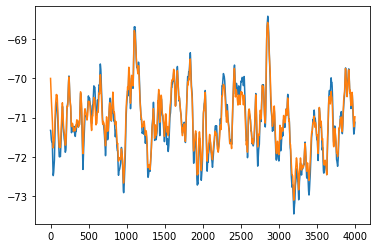

[ 5.46614825e+01  7.88827482e+01 -1.09822690e+00  2.35796830e-02]


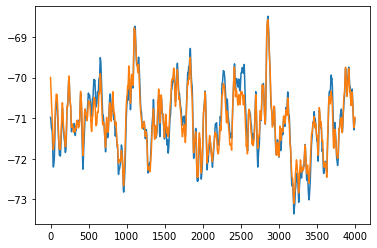

[ 5.53187451e+01  8.91684779e+01 -7.88088180e-01  2.07078756e-02]


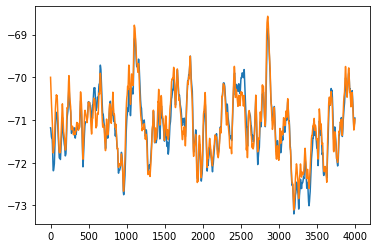

[ 5.86504746e+01  9.09439676e+01 -9.30633020e-01  1.64171299e-02]


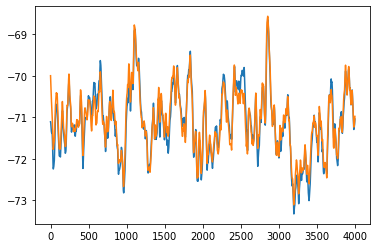

[ 5.49914175e+01  8.68213496e+01 -8.90872585e-01  1.98252445e-02]


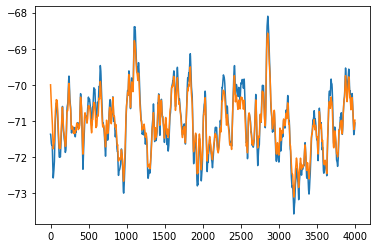

[ 5.99572329e+01  8.32157276e+01 -1.13552713e+00  2.37015906e-02]


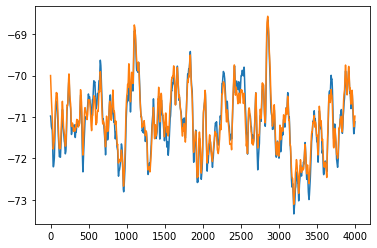

[ 5.00909064e+01  8.36001371e+01 -7.89948514e-01  2.22642726e-02]


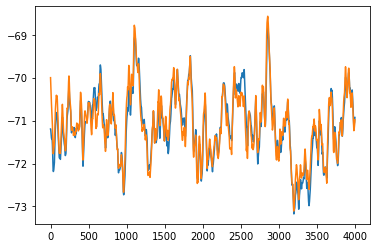

[ 5.89841930e+01  9.02209297e+01 -9.40190218e-01  1.63278265e-02]


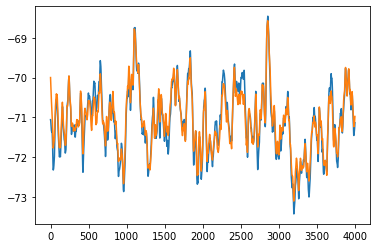

[ 5.11563603e+01  8.18168025e+01 -8.67580959e-01  2.42274901e-02]


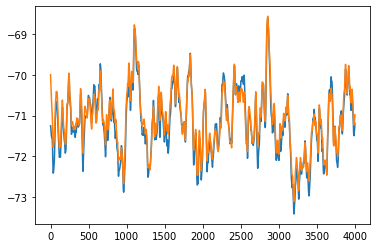

[ 5.01313383e+01  7.63920408e+01 -1.03522630e+00  2.42404695e-02]


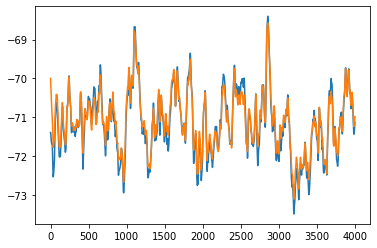

[ 5.53793928e+01  7.83563335e+01 -1.15600486e+00  2.36721710e-02]


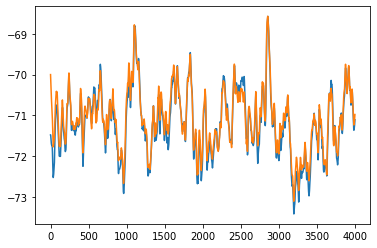

[ 5.64254552e+01  7.84094336e+01 -1.22258436e+00  2.14312939e-02]


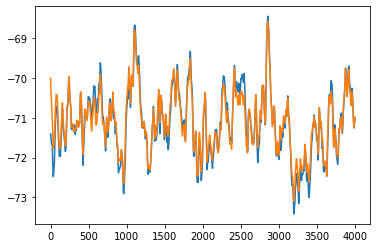

[ 6.05975357e+01  8.48428916e+01 -1.14861805e+00  2.00137266e-02]


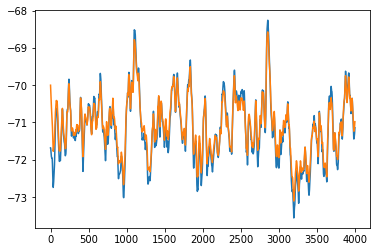

[ 5.85405156e+01  7.34243539e+01 -1.42184450e+00  2.45231927e-02]


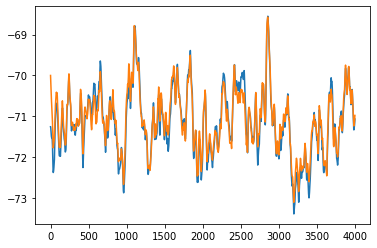

[ 5.58786920e+01  8.34721007e+01 -1.02361556e+00  2.09997316e-02]


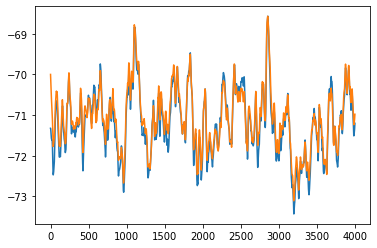

[ 5.05749755e+01  7.47174164e+01 -1.10159779e+00  2.48277130e-02]


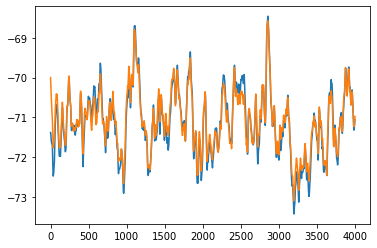

[ 5.80918957e+01  8.23115228e+01 -1.13686299e+00  2.12172232e-02]


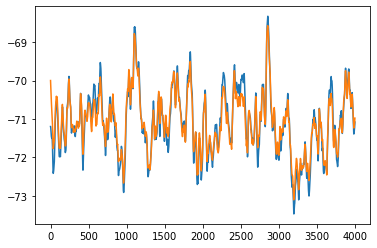

[ 5.55802763e+01  8.31019190e+01 -9.84770793e-01  2.33031105e-02]


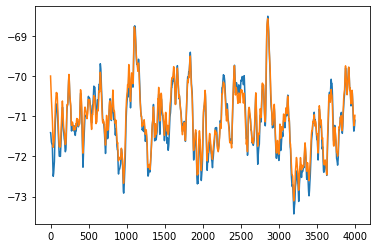

[ 5.62141605e+01  7.95825550e+01 -1.16313097e+00  2.18992480e-02]


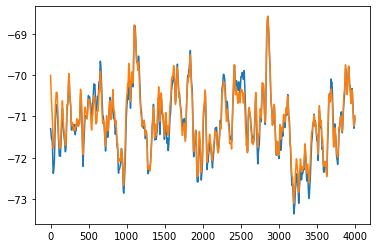

[ 5.70437225e+01  8.37681299e+01 -1.05491335e+00  2.01757719e-02]


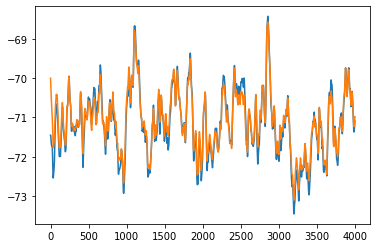

[ 5.71269386e+01  7.88003773e+01 -1.20295154e+00  2.24362315e-02]


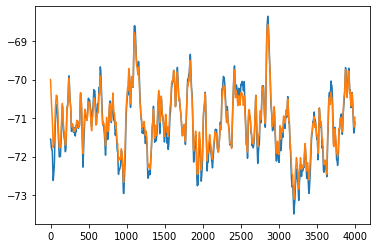

[ 5.77510618e+01  7.64645156e+01 -1.29261953e+00  2.31544815e-02]


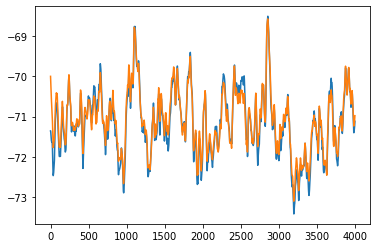

[ 5.44312563e+01  7.82053824e+01 -1.12274840e+00  2.28282440e-02]


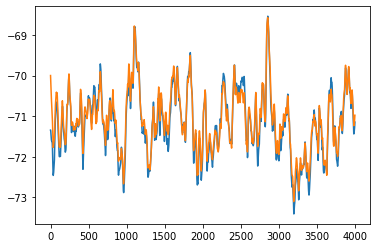

[ 5.26009367e+01  7.61523122e+01 -1.11569110e+00  2.36337543e-02]


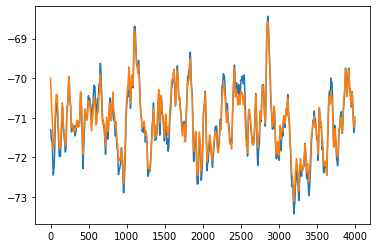

[ 5.54175395e+01  8.02457639e+01 -1.07628913e+00  2.26107172e-02]


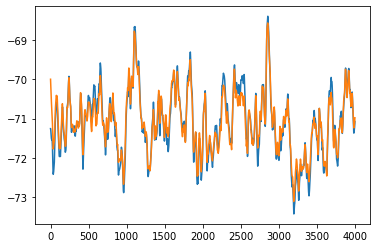

[ 5.50192290e+01  8.05773684e+01 -1.03286821e+00  2.29664517e-02]


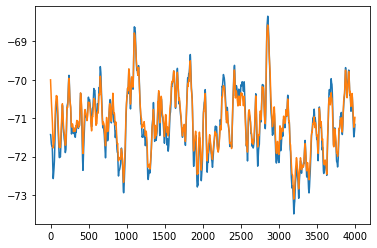

[ 5.37748859e+01  7.42990060e+01 -1.19519463e+00  2.55516659e-02]


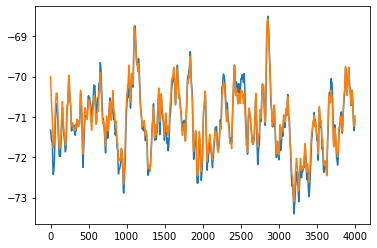

[ 5.62265134e+01  8.14008489e+01 -1.08998367e+00  2.15197454e-02]


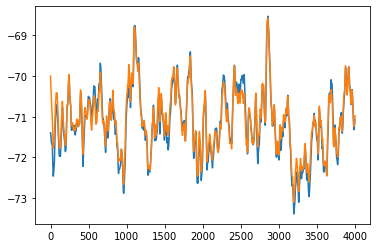

[ 5.69396414e+01  8.04434380e+01 -1.14775947e+00  2.11177861e-02]


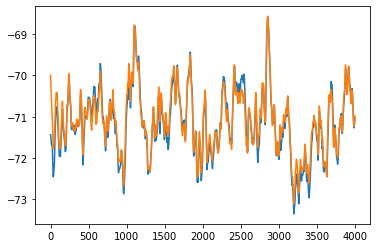

[ 5.80787209e+01  8.12237829e+01 -1.17252575e+00  1.98868376e-02]


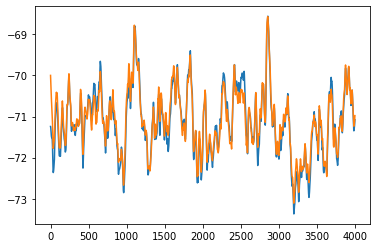

[ 5.43805367e+01  8.13473394e+01 -1.01543879e+00  2.16020148e-02]


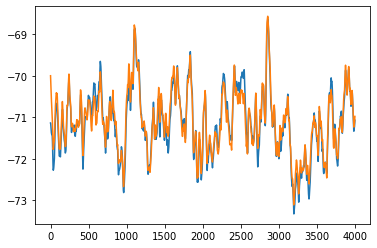

[ 5.30073358e+01  8.26208204e+01 -9.21682413e-01  2.11849064e-02]


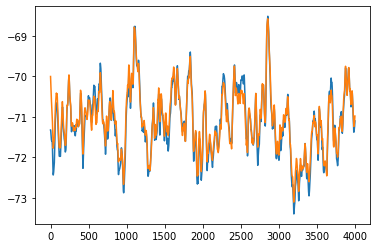

[ 5.43579736e+01  7.87201129e+01 -1.09113422e+00  2.25596356e-02]


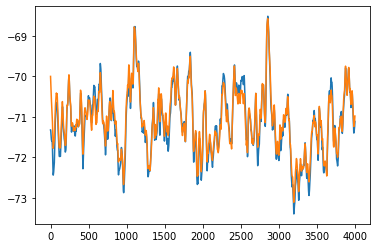

[ 5.34237037e+01  7.73797449e+01 -1.09170949e+00  2.30795807e-02]


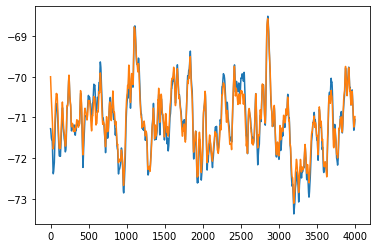

[ 5.56494543e+01  8.15027607e+01 -1.04285004e+00  2.13768054e-02]


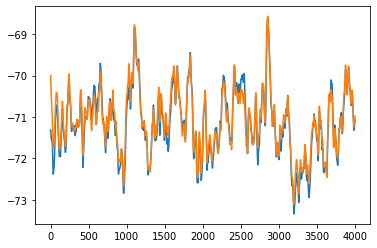

[ 5.47791286e+01  8.00908776e+01 -1.07258977e+00  2.09773763e-02]


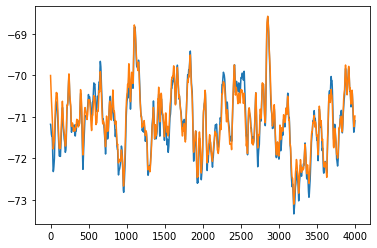

[ 5.21767703e+01  7.97169233e+01 -9.63534575e-01  2.24001025e-02]


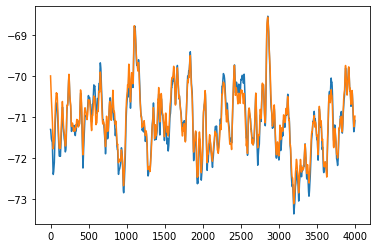

[ 5.36339917e+01  7.79978139e+01 -1.06990315e+00  2.23149176e-02]


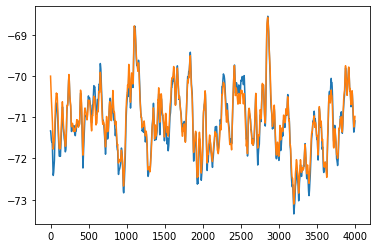

[ 5.32607192e+01  7.63230511e+01 -1.09713533e+00  2.26713690e-02]


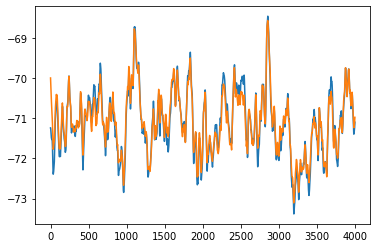

[ 5.24761952e+01  7.73703624e+01 -1.02502495e+00  2.37865525e-02]


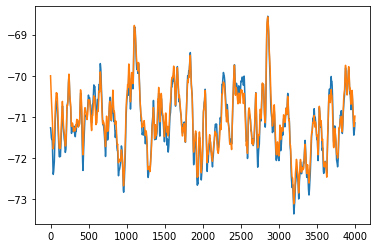

[ 5.00192399e+01  7.38922801e+01 -1.04585213e+00  2.45919970e-02]


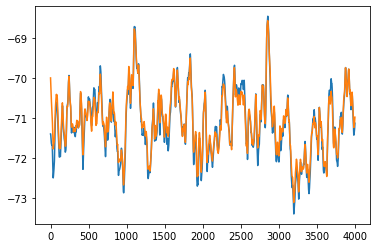

[ 5.24131587e+01  7.27657961e+01 -1.16632637e+00  2.46646471e-02]


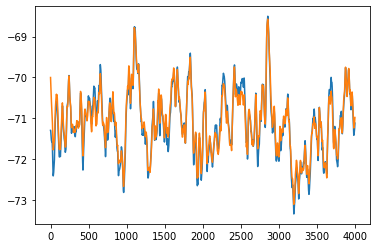

[ 5.06609528e+01  7.27960000e+01 -1.07545990e+00  2.47777021e-02]


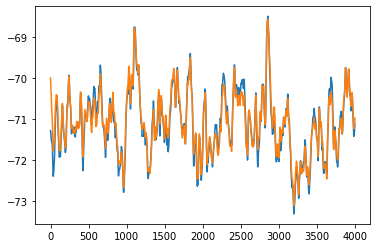

[ 4.92795774e+01  7.05041275e+01 -1.06733510e+00  2.56267629e-02]


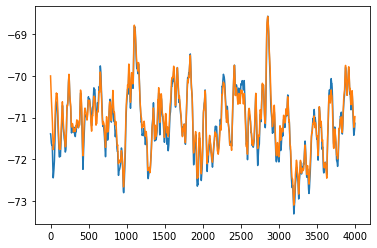

[ 5.00101524e+01  6.93722650e+01 -1.16329951e+00  2.49908355e-02]


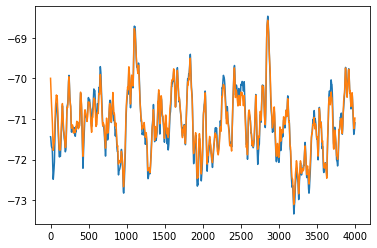

[ 5.24625640e+01  7.05903397e+01 -1.20119603e+00  2.43848103e-02]


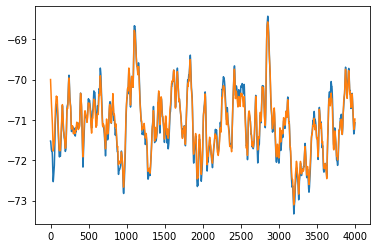

[ 5.36842260e+01  6.89393695e+01 -1.27886798e+00  2.42812169e-02]


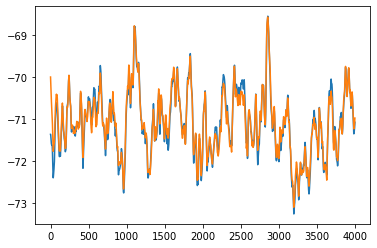

[ 5.07041788e+01  6.98036105e+01 -1.13699259e+00  2.41204451e-02]


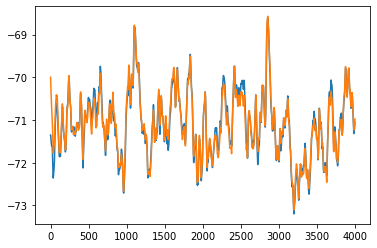

[ 4.98496888e+01  6.83225177e+01 -1.12232570e+00  2.38483441e-02]


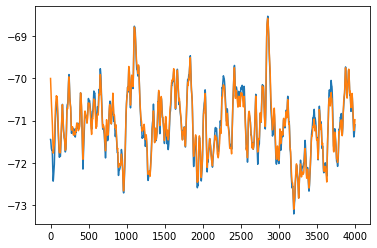

[ 4.81511031e+01  6.22460887e+01 -1.21877882e+00  2.67022106e-02]


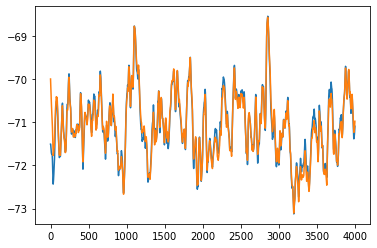

[ 4.55962950e+01  5.52076075e+01 -1.27960056e+00  2.87176314e-02]


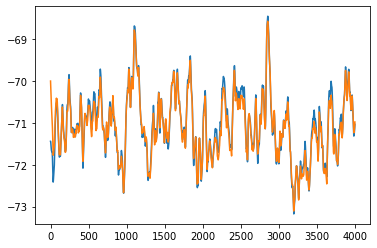

[ 4.91947412e+01  6.21145461e+01 -1.21076515e+00  2.62461421e-02]


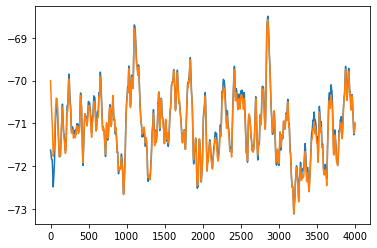

[ 4.98828982e+01  5.67878929e+01 -1.37844459e+00  2.59199044e-02]


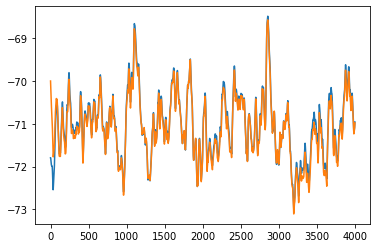

[ 5.01845586e+01  4.99297756e+01 -1.53399934e+00  2.60664752e-02]


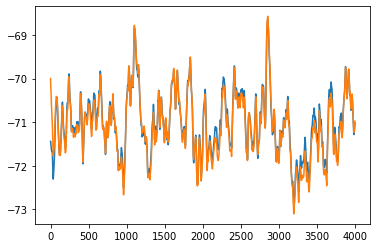

[ 4.35775856e+01  5.22769127e+01 -1.21670003e+00  2.80847941e-02]


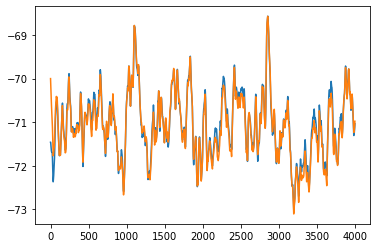

[ 4.61042457e+01  5.64425269e+01 -1.23224202e+00  2.71338998e-02]


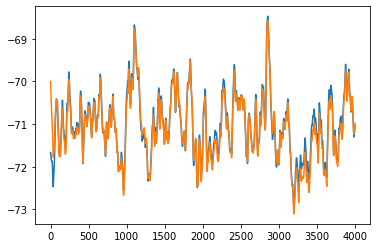

[ 4.55394012e+01  4.69537690e+01 -1.42820047e+00  3.01604448e-02]


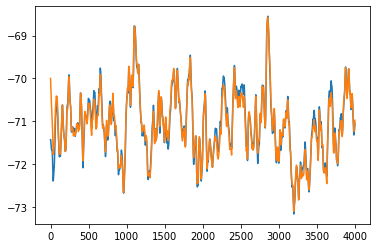

[ 4.87721169e+01  6.29803305e+01 -1.19879439e+00  2.54263693e-02]


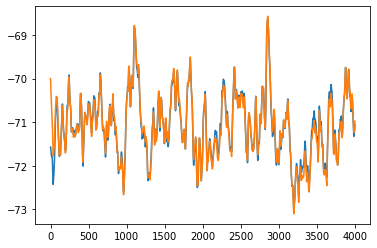

[ 4.59830367e+01  5.35946328e+01 -1.33377563e+00  2.73527603e-02]


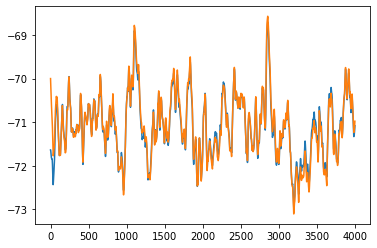

[ 4.43771845e+01  4.93346761e+01 -1.39528086e+00  2.79060694e-02]


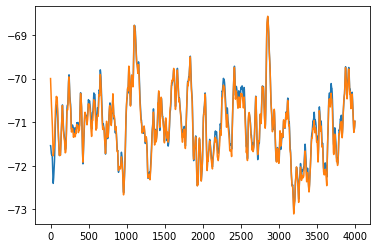

[ 4.97748537e+01  5.96950840e+01 -1.29202775e+00  2.41988354e-02]


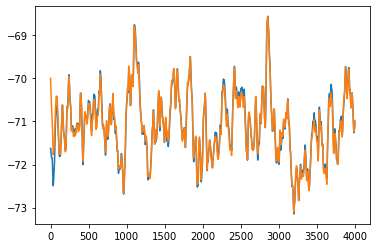

[ 5.11022071e+01  6.00864432e+01 -1.36927916e+00  2.43150349e-02]


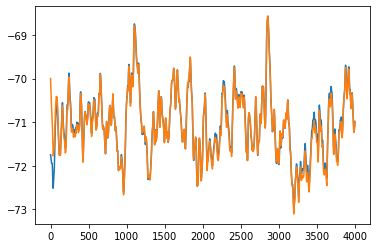

[ 4.95993809e+01  5.21016959e+01 -1.48796918e+00  2.54668983e-02]


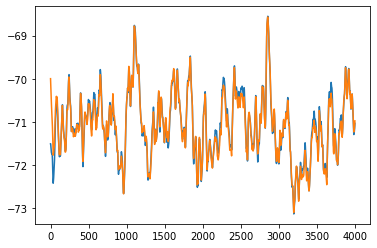

[ 4.89789329e+01  6.02606719e+01 -1.27108809e+00  2.54365015e-02]


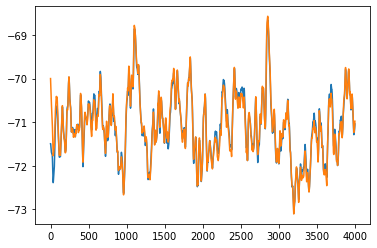

[ 4.80366171e+01  6.00305231e+01 -1.25464072e+00  2.47316617e-02]


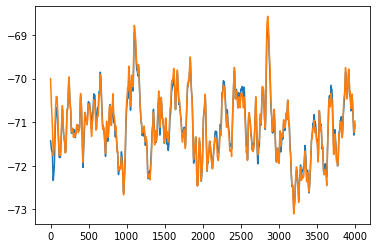

[ 4.71134765e+01  6.16518381e+01 -1.19273878e+00  2.41375403e-02]


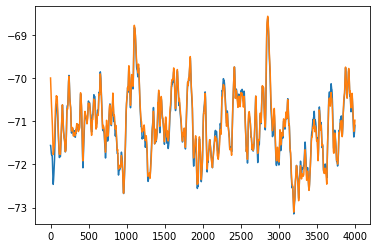

[ 4.72755432e+01  5.72910514e+01 -1.32236405e+00  2.67191437e-02]


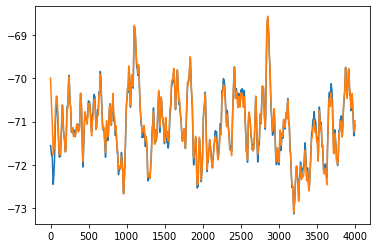

[ 4.79003708e+01  5.78920596e+01 -1.31477997e+00  2.60890667e-02]


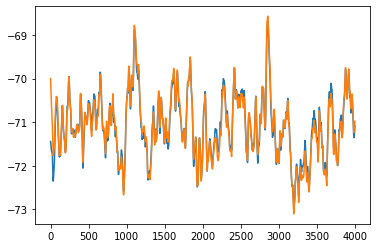

[ 4.43472717e+01  5.58025004e+01 -1.21786304e+00  2.74899602e-02]


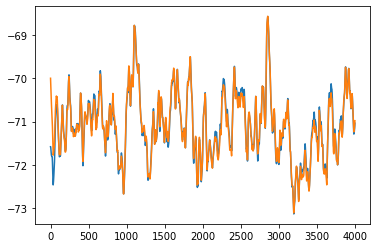

[ 4.94134732e+01  5.90154575e+01 -1.33142513e+00  2.51087662e-02]


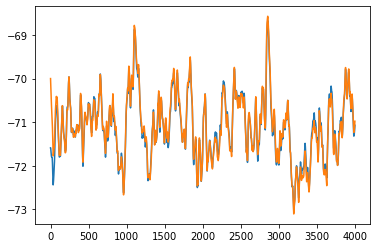

[ 4.66878160e+01  5.50056646e+01 -1.34622264e+00  2.62046259e-02]


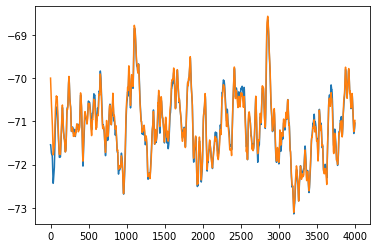

[ 5.00361018e+01  6.23772196e+01 -1.28975861e+00  2.37142999e-02]


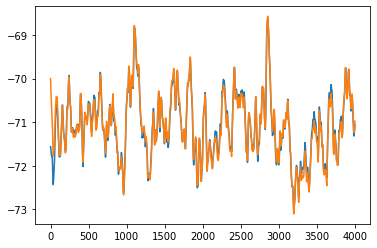

[ 4.69963030e+01  5.57902795e+01 -1.32277137e+00  2.64431452e-02]


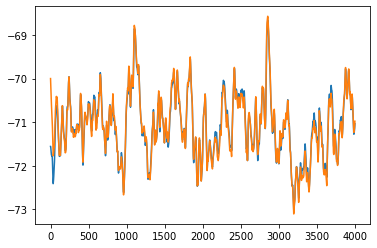

[ 4.76667338e+01  5.70289027e+01 -1.31274996e+00  2.51550328e-02]


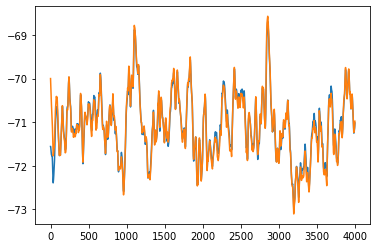

[ 4.75499153e+01  5.65973243e+01 -1.31173495e+00  2.46880159e-02]


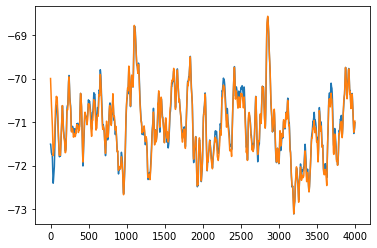

[ 4.93687476e+01  6.09269168e+01 -1.26457095e+00  2.45146771e-02]


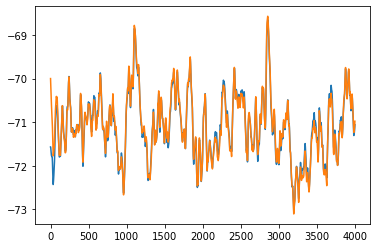

[ 4.73580489e+01  5.64859776e+01 -1.32580972e+00  2.57821387e-02]


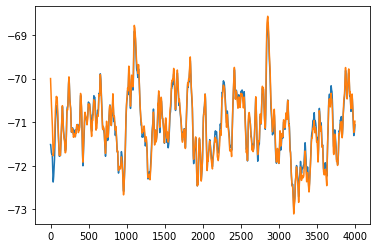

[ 4.56153781e+01  5.56523839e+01 -1.27656075e+00  2.59472230e-02]


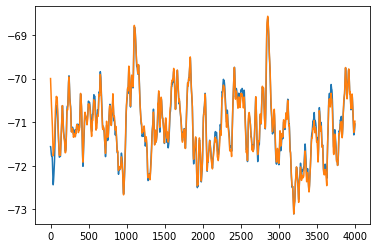

[ 4.84639495e+01  5.81746891e+01 -1.31770904e+00  2.53183804e-02]


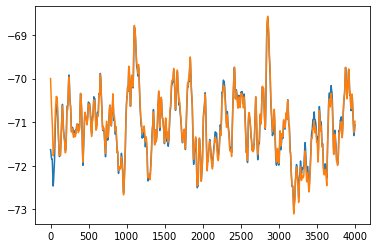

[ 4.72059005e+01  5.37094014e+01 -1.38487932e+00  2.66176869e-02]


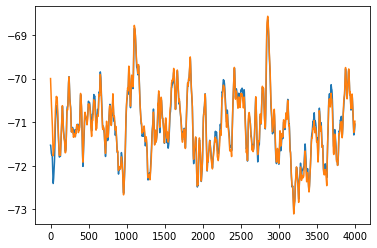

[ 4.78289379e+01  5.84502426e+01 -1.28720037e+00  2.52031680e-02]


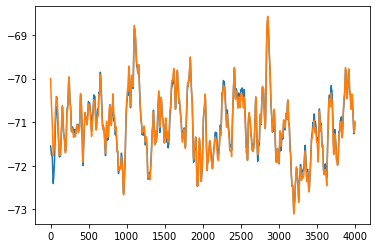

[ 4.86625321e+01  5.92796266e+01 -1.29896317e+00  2.42862148e-02]


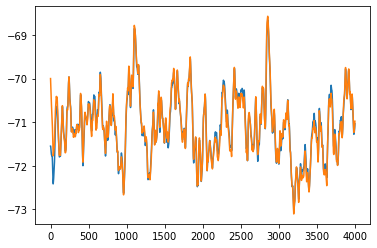

[ 4.82459748e+01  5.84072898e+01 -1.30491522e+00  2.48254474e-02]


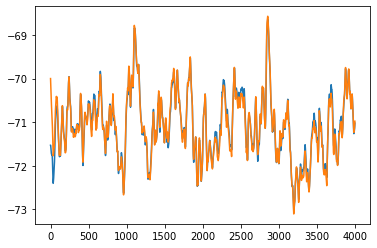

[ 4.87447491e+01  5.95445845e+01 -1.28547757e+00  2.44688756e-02]


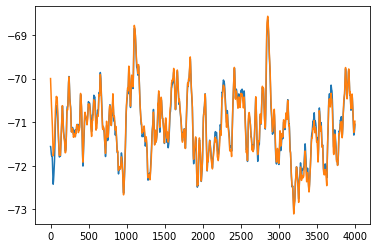

[ 4.77047239e+01  5.72506294e+01 -1.31572668e+00  2.54538229e-02]


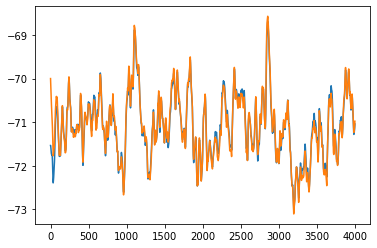

[ 4.72592358e+01  5.73938431e+01 -1.29258708e+00  2.50003552e-02]


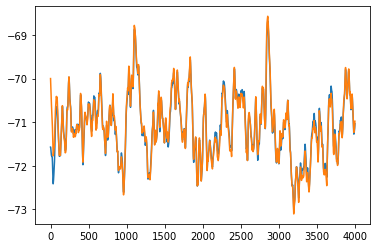

[ 4.76093962e+01  5.65900899e+01 -1.32578910e+00  2.50141612e-02]


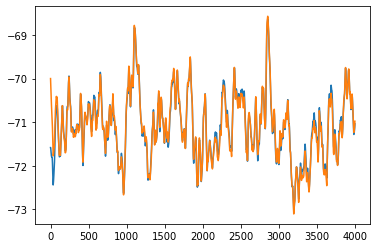

[ 4.83541786e+01  5.72446127e+01 -1.33700340e+00  2.52238770e-02]


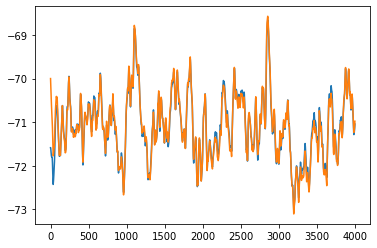

[ 4.74215415e+01  5.56498275e+01 -1.34071935e+00  2.55979996e-02]


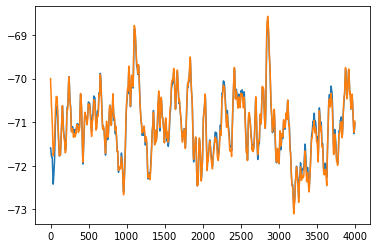

[ 4.78212012e+01  5.60060871e+01 -1.34240422e+00  2.50417124e-02]


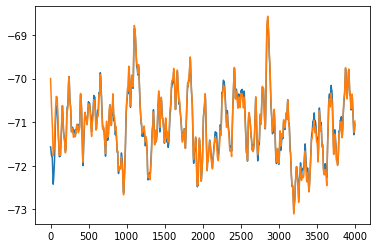

[ 4.77338432e+01  5.69394938e+01 -1.32239607e+00  2.53507953e-02]


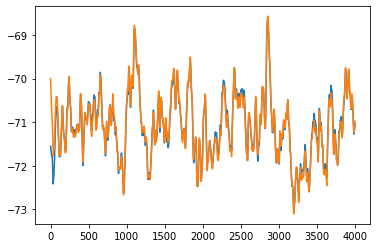

[ 4.82605344e+01  5.82517220e+01 -1.30824991e+00  2.47739336e-02]


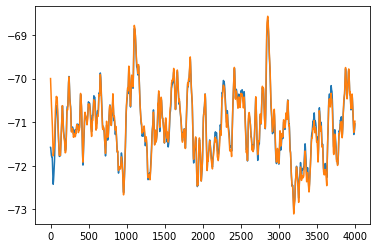

[ 4.76312898e+01  5.63003012e+01 -1.33260199e+00  2.53919831e-02]


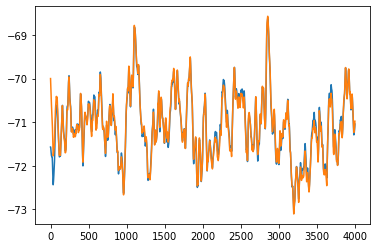

[ 4.80836265e+01  5.71665653e+01 -1.32658661e+00  2.55466830e-02]


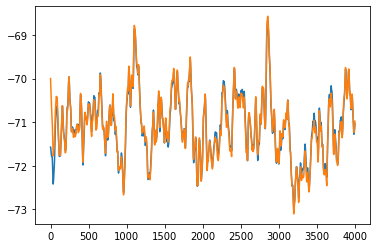

[ 4.77279538e+01  5.67342087e+01 -1.32598848e+00  2.51472916e-02]


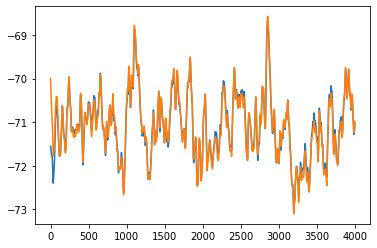

[ 4.70257317e+01  5.62568405e+01 -1.30986484e+00  2.52986744e-02]


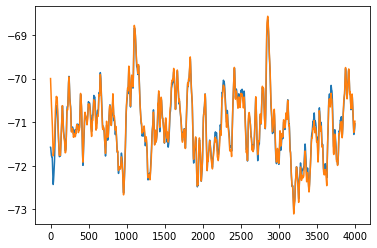

[ 4.80220669e+01  5.69976697e+01 -1.33021876e+00  2.52425764e-02]


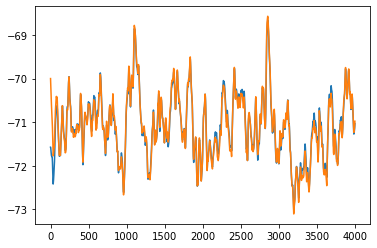

[ 4.77901789e+01  5.65910474e+01 -1.32838353e+00  2.51176467e-02]


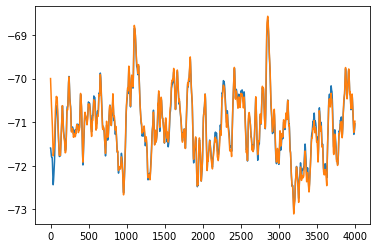

[ 4.79190108e+01  5.62827107e+01 -1.34584642e+00  2.52947160e-02]


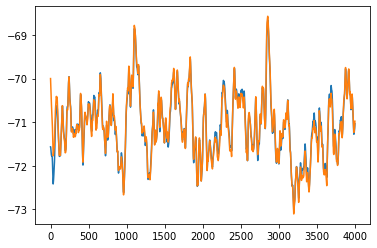

[ 4.77298031e+01  5.68423547e+01 -1.32102407e+00  2.51899536e-02]


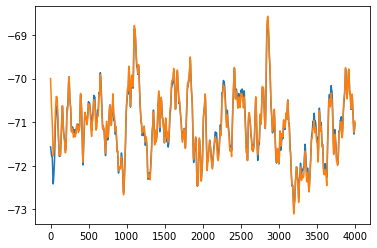

[ 4.80037116e+01  5.72823391e+01 -1.32020543e+00  2.49567510e-02]


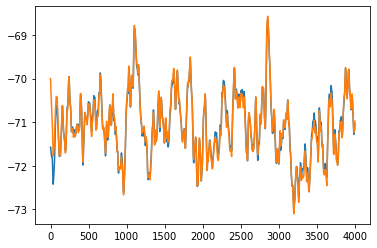

[ 4.77243952e+01  5.65458106e+01 -1.32950285e+00  2.52831751e-02]


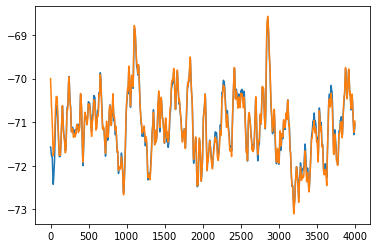

[ 4.78119306e+01  5.69689745e+01 -1.32498355e+00  2.53138517e-02]


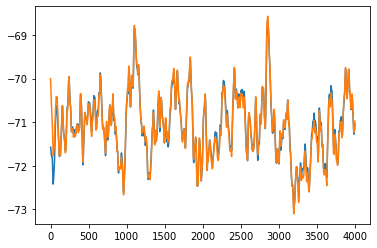

[ 4.77956168e+01  5.66855292e+01 -1.32753353e+00  2.51666979e-02]


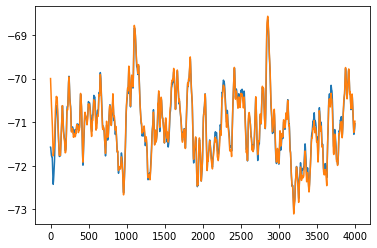

[ 4.79079872e+01  5.68014734e+01 -1.32815113e+00  2.52939099e-02]


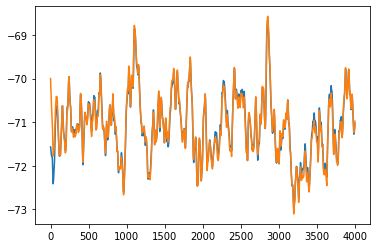

[ 4.75568343e+01  5.64399143e+01 -1.32288703e+00  2.52242919e-02]


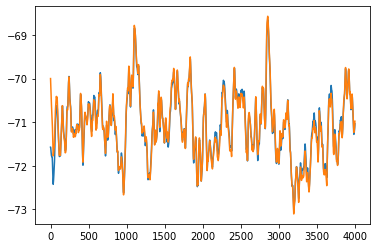

[ 4.79057587e+01  5.68582308e+01 -1.32838583e+00  2.52380052e-02]


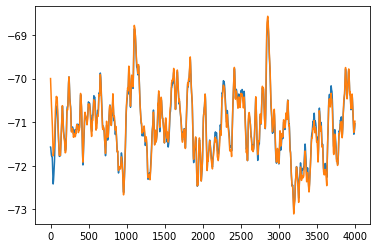

[ 4.76697997e+01  5.66644893e+01 -1.32507201e+00  2.51450061e-02]


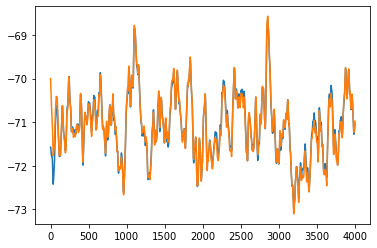

[ 4.78484403e+01  5.67672274e+01 -1.32738135e+00  2.52566839e-02]


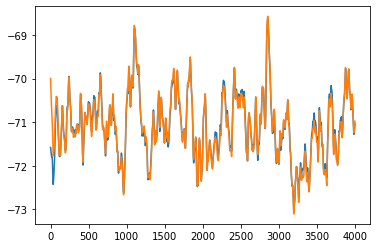

[ 4.79073025e+01  5.65860443e+01 -1.33537771e+00  2.52823274e-02]


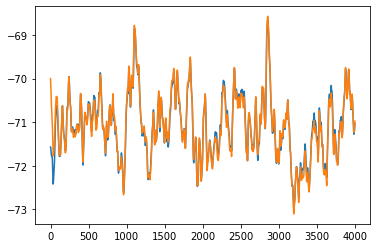

[ 4.77741779e+01  5.67782771e+01 -1.32461248e+00  2.52130471e-02]


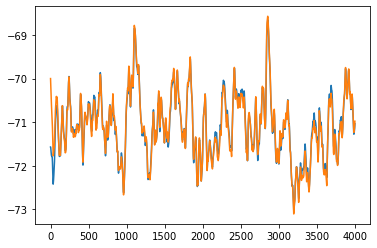

[ 4.79376017e+01  5.69988216e+01 -1.32445375e+00  2.51540420e-02]


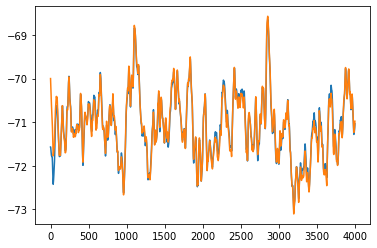

[ 4.79373725e+01  5.70157493e+01 -1.32488317e+00  2.52641912e-02]


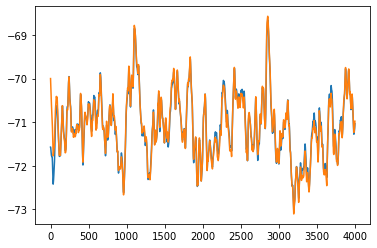

[ 4.78310557e+01  5.67680842e+01 -1.32687094e+00  2.51910712e-02]


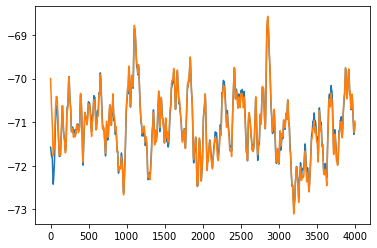

[ 4.77421147e+01  5.65870882e+01 -1.32917156e+00  2.52953617e-02]


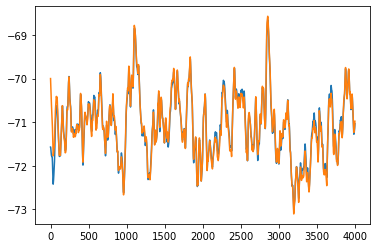

[ 4.78887299e+01  5.68958882e+01 -1.32563320e+00  2.51893719e-02]


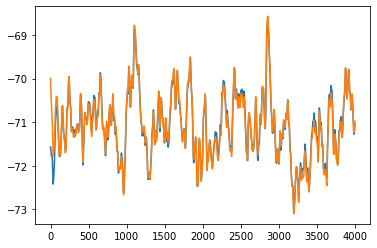

[ 4.78514208e+01  5.68830128e+01 -1.32536988e+00  2.51590638e-02]


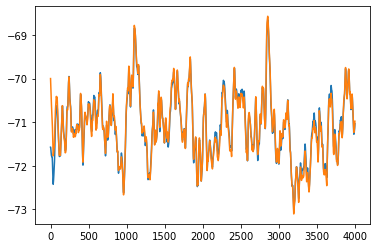

[ 4.79643047e+01  5.69243309e+01 -1.32851744e+00  2.51757090e-02]


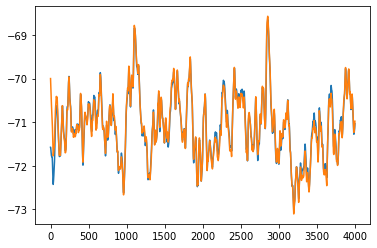

[ 4.80593681e+01  5.69973578e+01 -1.33046992e+00  2.51570400e-02]


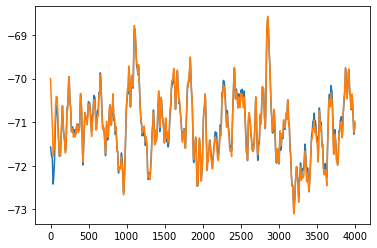

[ 4.78619969e+01  5.68774272e+01 -1.32480990e+00  2.51196028e-02]


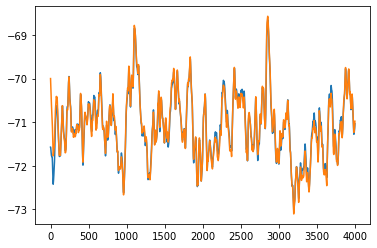

[ 4.78948183e+01  5.68630299e+01 -1.32749185e+00  2.52084046e-02]


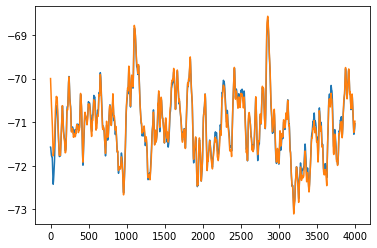

[ 4.79685811e+01  5.70150468e+01 -1.32663524e+00  2.51752035e-02]


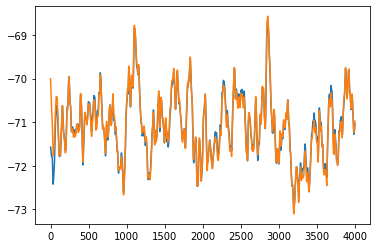

[ 4.78654371e+01  5.68298248e+01 -1.32681202e+00  2.51871043e-02]


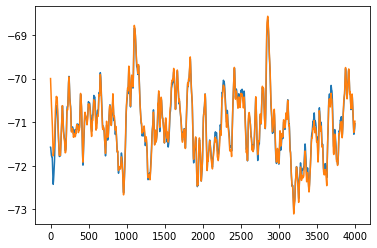

[ 4.79552242e+01  5.68735241e+01 -1.32885738e+00  2.52212311e-02]


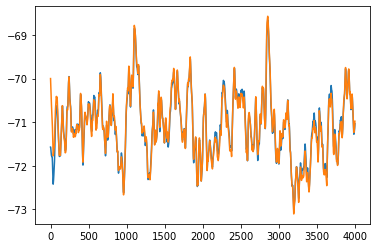

[ 4.78773717e+01  5.68806406e+01 -1.32624175e+00  2.51746057e-02]


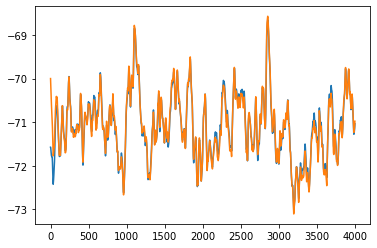

[ 4.79122359e+01  5.68530249e+01 -1.32889833e+00  2.51835399e-02]


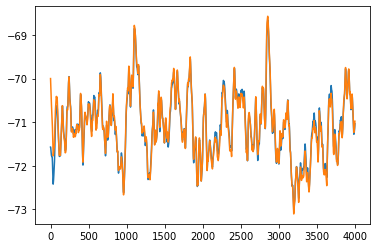

[ 4.78106268e+01  5.67889293e+01 -1.32620453e+00  2.52011182e-02]


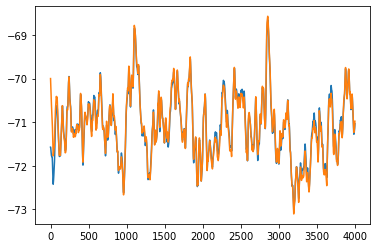

[ 4.79258852e+01  5.68904805e+01 -1.32793921e+00  2.51820613e-02]


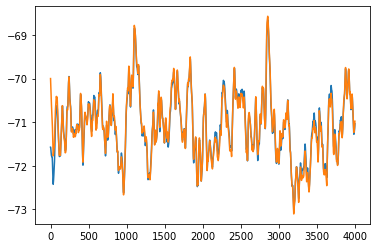

[ 4.79397185e+01  5.69137632e+01 -1.32847355e+00  2.51872014e-02]


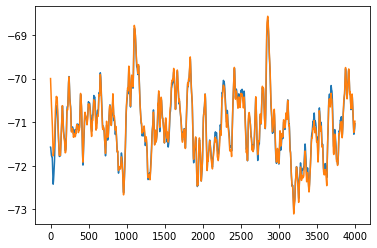

[ 4.78840074e+01  5.68508094e+01 -1.32722740e+00  2.51871286e-02]


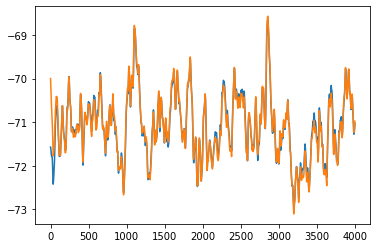

[ 4.78788054e+01  5.68894553e+01 -1.32555178e+00  2.51925602e-02]


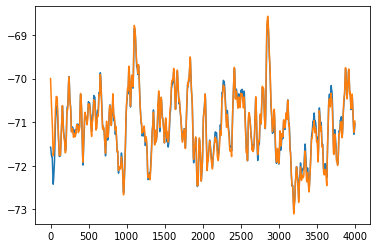

[ 4.79038783e+01  5.68621325e+01 -1.32806169e+00  2.51857950e-02]


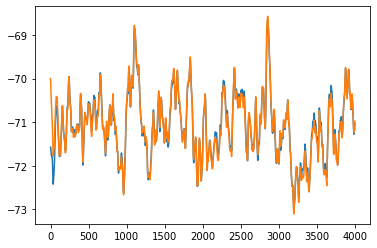

[ 4.79007530e+01  5.68790016e+01 -1.32724318e+00  2.51563906e-02]


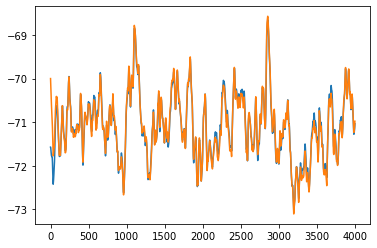

[ 4.78963020e+01  5.68670229e+01 -1.32742968e+00  2.51954011e-02]


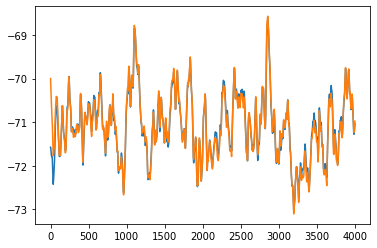

[ 4.79276648e+01  5.68545820e+01 -1.32908724e+00  2.52005873e-02]


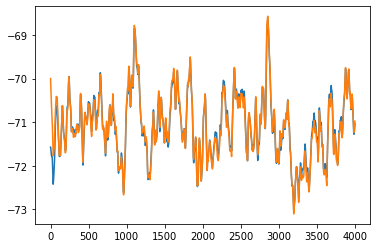

[ 4.78899449e+01  5.68741260e+01 -1.32695312e+00  2.51811011e-02]


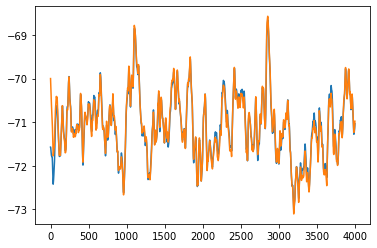

[ 4.78611811e+01  5.68365649e+01 -1.32689673e+00  2.51926516e-02]


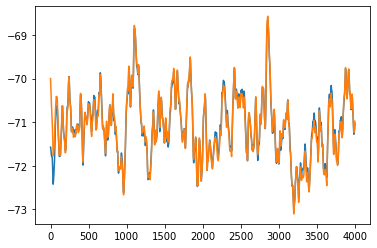

[ 4.78773571e+01  5.68500438e+01 -1.32715735e+00  2.51900040e-02]


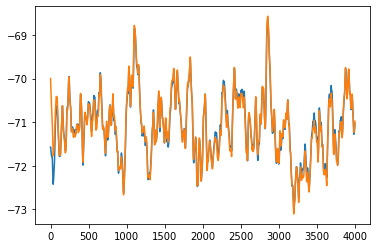

[ 4.78997337e+01  5.68758532e+01 -1.32757352e+00  2.51890220e-02]


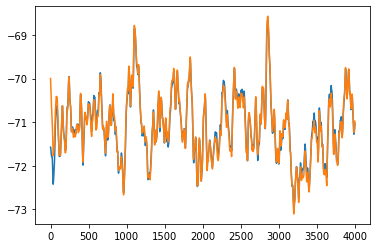

[ 4.78891551e+01  5.68640549e+01 -1.32744317e+00  2.51775599e-02]


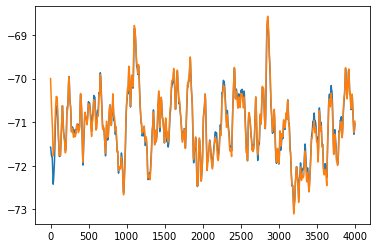

[ 4.78945152e+01  5.68662809e+01 -1.32743305e+00  2.51909408e-02]


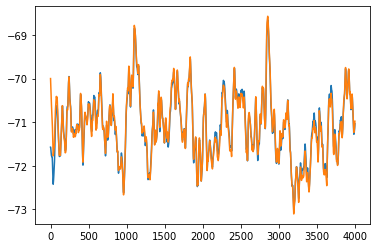

[ 4.78977972e+01  5.68530292e+01 -1.32815969e+00  2.51967798e-02]


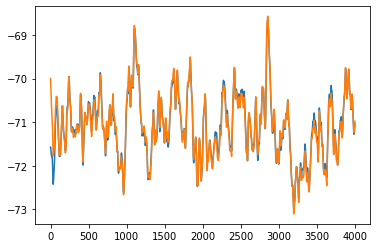

[ 4.78919080e+01  5.68688518e+01 -1.32725477e+00  2.51850208e-02]


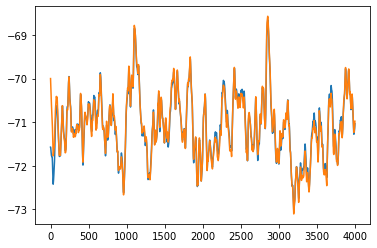

[ 4.78840956e+01  5.68478013e+01 -1.32737991e+00  2.51868583e-02]


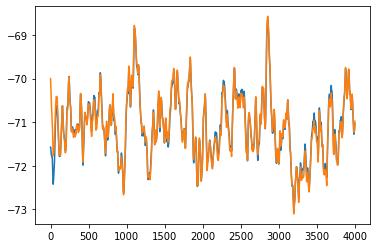

[ 4.78958242e+01  5.68688402e+01 -1.32752512e+00  2.51884811e-02]


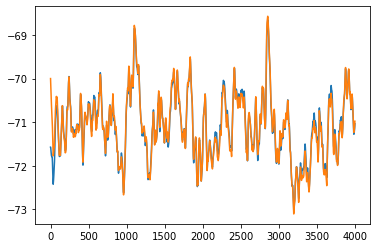

[ 4.79157057e+01  5.68830089e+01 -1.32797996e+00  2.51851148e-02]


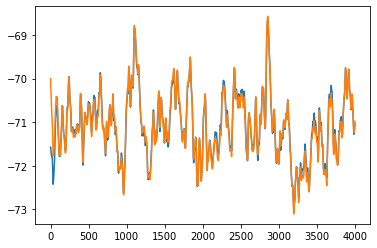

[ 4.78869443e+01  5.68582851e+01 -1.32736301e+00  2.51887817e-02]


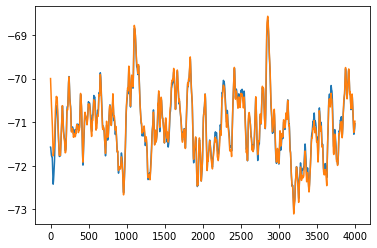

[ 4.78807176e+01  5.68689964e+01 -1.32672628e+00  2.51908172e-02]


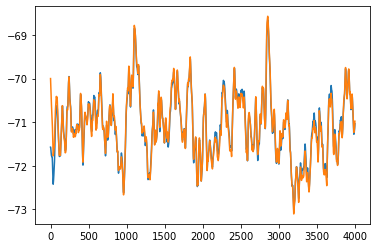

[ 4.78980881e+01  5.68638485e+01 -1.32772784e+00  2.51870505e-02]


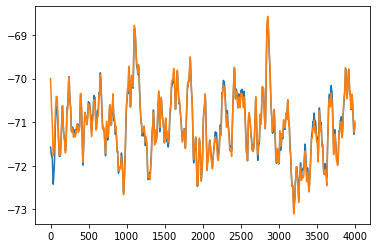

[ 4.78918671e+01  5.68636319e+01 -1.32750231e+00  2.51837262e-02]


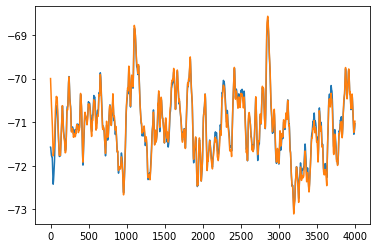

[ 4.78925291e+01  5.68642942e+01 -1.32748500e+00  2.51855299e-02]


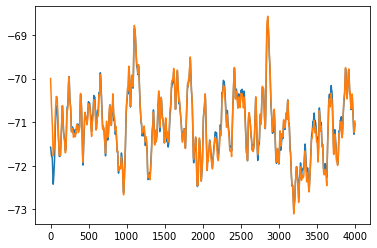

[ 4.78889106e+01  5.68587996e+01 -1.32739018e+00  2.51847104e-02]


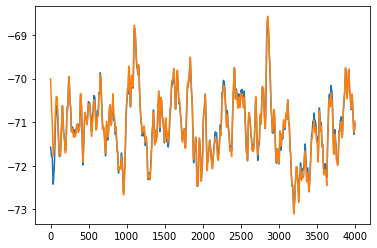

[ 4.78940958e+01  5.68663300e+01 -1.32749139e+00  2.51875384e-02]


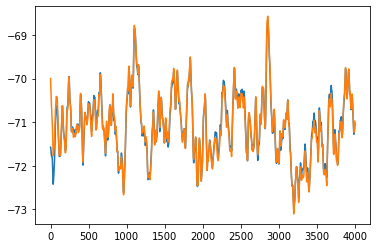

[ 4.78939206e+01  5.68575271e+01 -1.32777885e+00  2.51894295e-02]


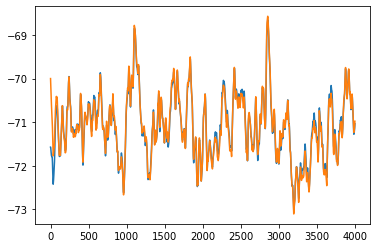

[ 4.78924112e+01  5.68660206e+01 -1.32738579e+00  2.51861229e-02]


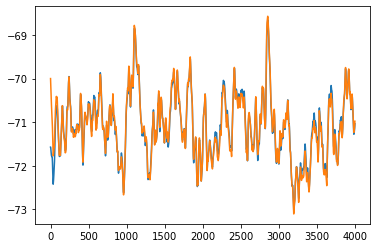

[ 4.78849021e+01  5.68636164e+01 -1.32713475e+00  2.51869359e-02]


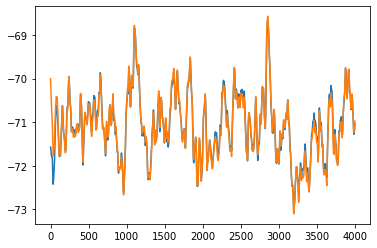

[ 4.78947916e+01  5.68637905e+01 -1.32757957e+00  2.51870219e-02]


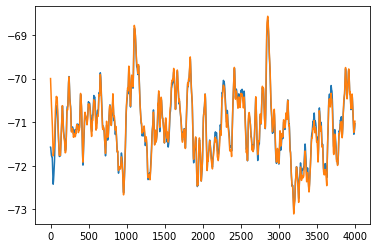

[ 4.78999696e+01  5.68719326e+01 -1.32760786e+00  2.51843248e-02]


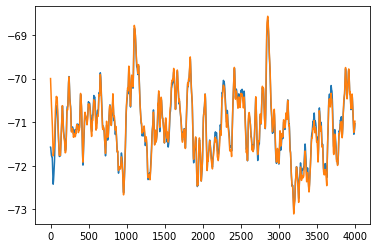

[ 4.78902006e+01  5.68616969e+01 -1.32742422e+00  2.51876675e-02]


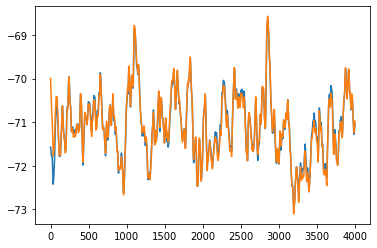

[ 4.78932205e+01  5.68646249e+01 -1.32745548e+00  2.51886455e-02]


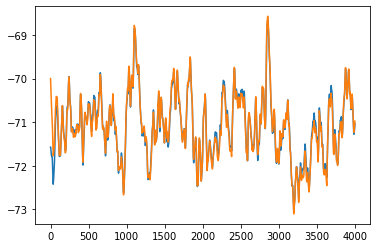

[ 4.78927019e+01  5.68643768e+01 -1.32747762e+00  2.51863088e-02]


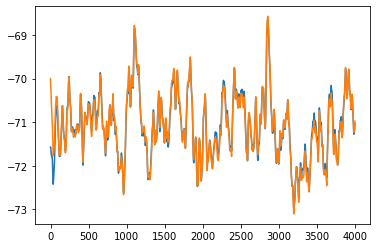

[ 4.78909569e+01  5.68616124e+01 -1.32744221e+00  2.51860221e-02]


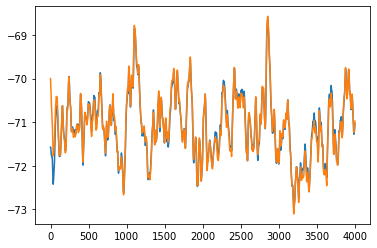

[ 4.78933111e+01  5.68651506e+01 -1.32747909e+00  2.51871593e-02]


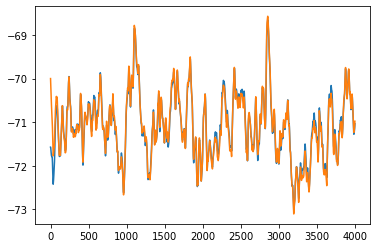

[ 4.78930914e+01  5.68614868e+01 -1.32759446e+00  2.51879558e-02]


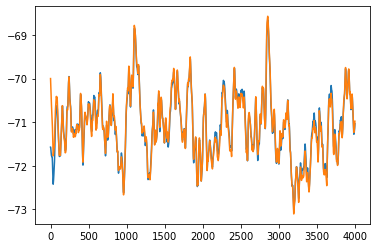

[ 4.78925812e+01  5.68648872e+01 -1.32743796e+00  2.51865812e-02]


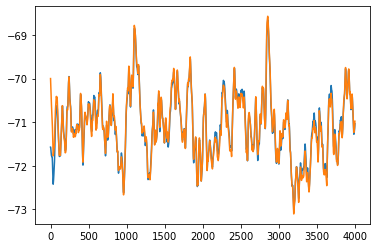

[ 4.78896058e+01  5.68642653e+01 -1.32732988e+00  2.51868365e-02]


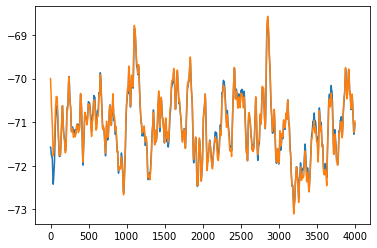

[ 4.78934952e+01  5.68639092e+01 -1.32751714e+00  2.51869755e-02]


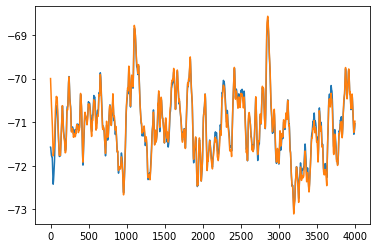

[ 4.78920921e+01  5.68634451e+01 -1.32745159e+00  2.51878830e-02]


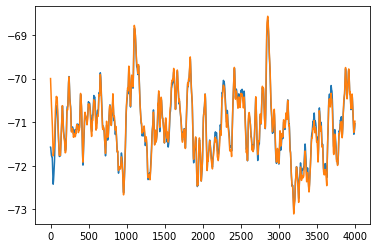

[ 4.78917871e+01  5.68629793e+01 -1.32743857e+00  2.51886701e-02]


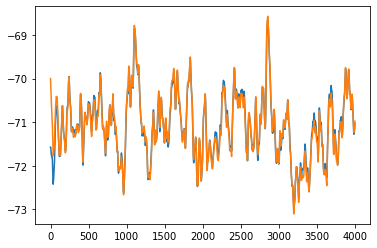

[ 4.78908735e+01  5.68618186e+01 -1.32743636e+00  2.51873942e-02]


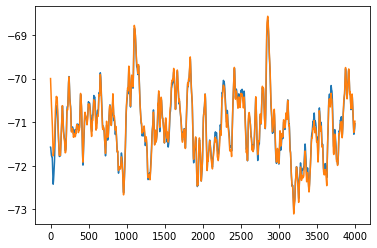

[ 4.78927017e+01  5.68643176e+01 -1.32746841e+00  2.51872181e-02]


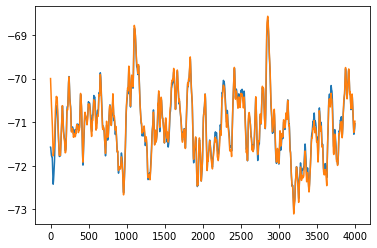

[ 4.78952345e+01  5.68665826e+01 -1.32751333e+00  2.51866614e-02]


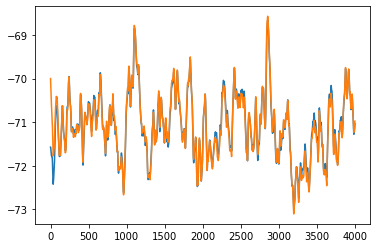

[ 4.78914591e+01  5.68629184e+01 -1.32744650e+00  2.51874160e-02]


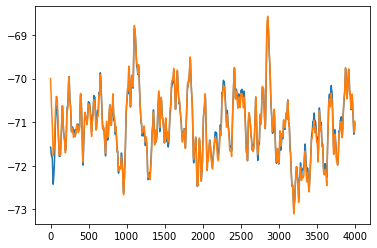

[ 4.78922927e+01  5.68624080e+01 -1.32750386e+00  2.51881651e-02]


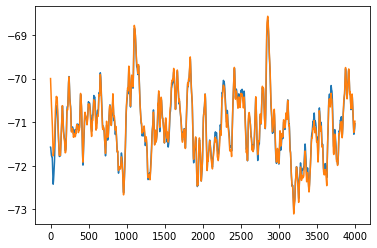

[ 4.78907776e+01  5.68626354e+01 -1.32741803e+00  2.51883655e-02]


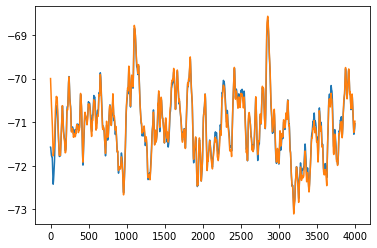

[ 4.78928158e+01  5.68635907e+01 -1.32749237e+00  2.51873230e-02]


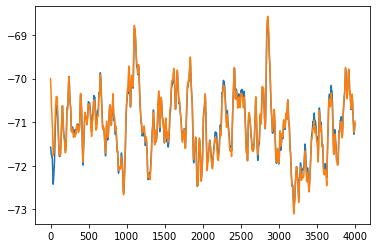

[ 4.78925425e+01  5.68631722e+01 -1.32750398e+00  2.51871781e-02]


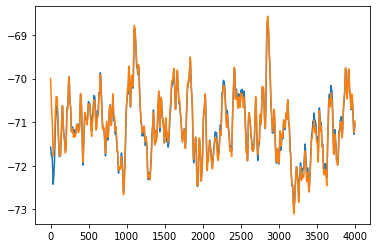

[ 4.78922047e+01  5.68633769e+01 -1.32746469e+00  2.51877068e-02]


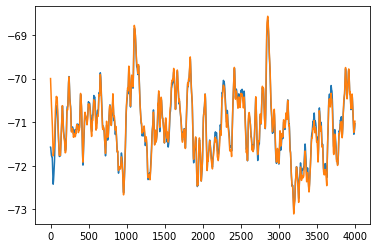

[ 4.78922979e+01  5.68646938e+01 -1.32743212e+00  2.51866668e-02]


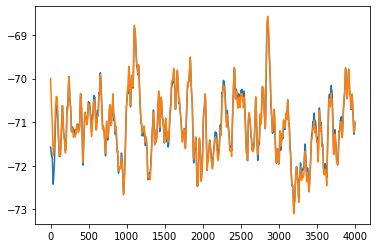

[ 4.78922940e+01  5.68629794e+01 -1.32748593e+00  2.51877905e-02]


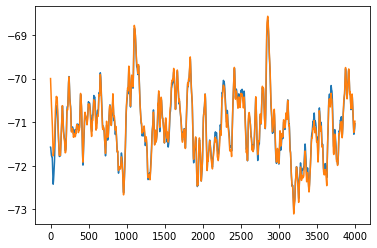

[ 4.78916851e+01  5.68621151e+01 -1.32747633e+00  2.51879001e-02]


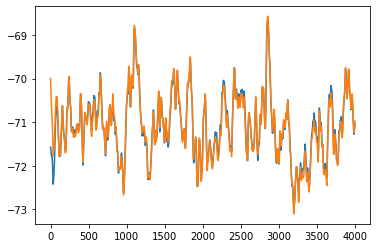

[ 4.78911768e+01  5.68610138e+01 -1.32748029e+00  2.51882411e-02]


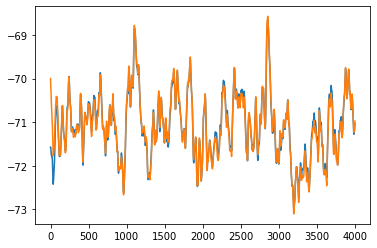

[ 4.78930407e+01  5.68631127e+01 -1.32751316e+00  2.51879442e-02]


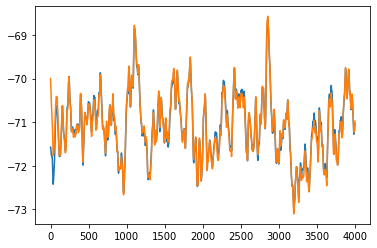

[ 4.78918545e+01  5.68629670e+01 -1.32746316e+00  2.51875480e-02]


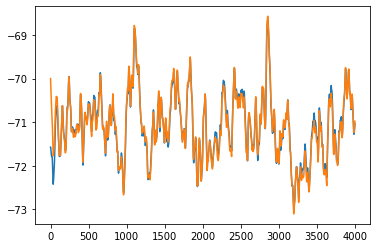

[ 4.78921200e+01  5.68624492e+01 -1.32749421e+00  2.51875741e-02]


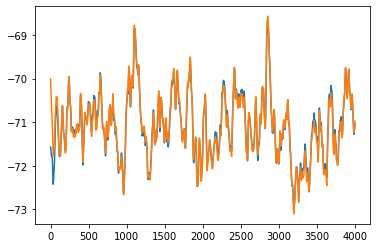

[ 4.78920777e+01  5.68619854e+01 -1.32750897e+00  2.51875077e-02]


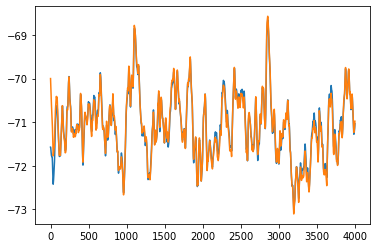

[ 4.78911610e+01  5.68616646e+01 -1.32746744e+00  2.51880833e-02]


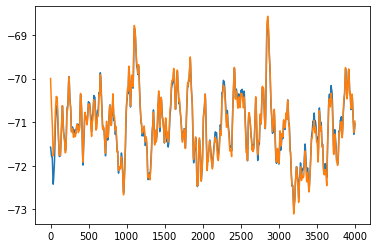

[ 4.78911163e+01  5.68616185e+01 -1.32746464e+00  2.51877622e-02]


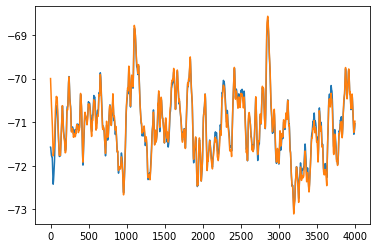

[ 4.78914107e+01  5.68619587e+01 -1.32746996e+00  2.51877693e-02]


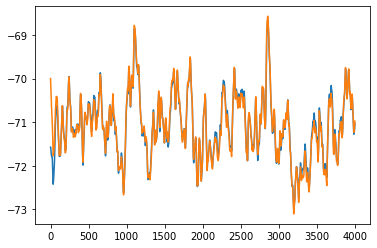

[ 4.78923741e+01  5.68630804e+01 -1.32748439e+00  2.51873124e-02]


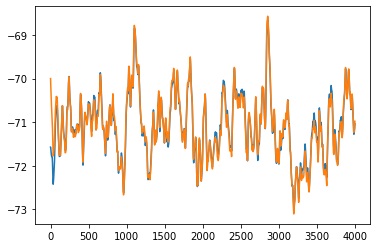

[ 4.78919405e+01  5.68618348e+01 -1.32749928e+00  2.51877299e-02]


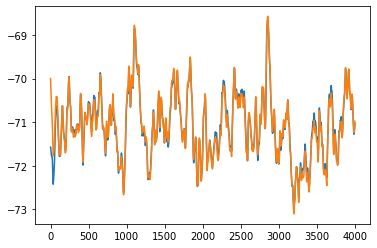

[ 4.78919835e+01  5.68612687e+01 -1.32751734e+00  2.51878208e-02]


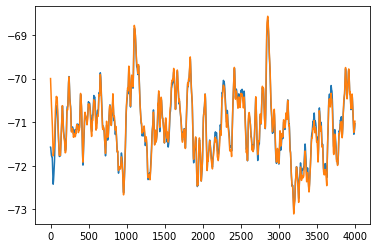

[ 4.78926491e+01  5.68627810e+01 -1.32750714e+00  2.51874889e-02]


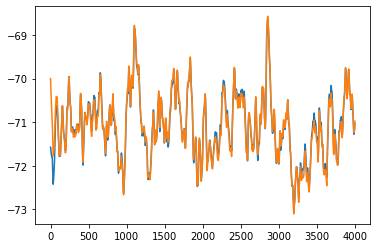

[ 4.78917203e+01  5.68621643e+01 -1.32747926e+00  2.51876992e-02]


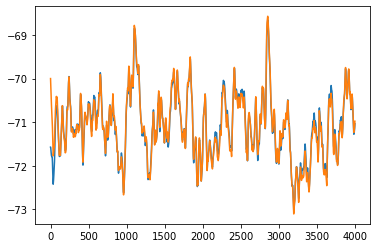

[ 4.78923924e+01  5.68626492e+01 -1.32750224e+00  2.51872577e-02]


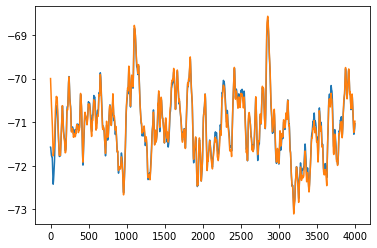

[ 4.78918619e+01  5.68622486e+01 -1.32748281e+00  2.51877395e-02]


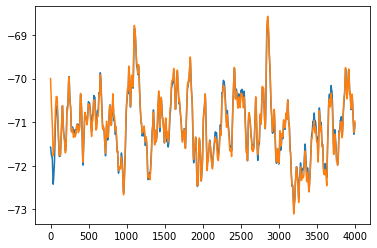

[ 4.78914473e+01  5.68612681e+01 -1.32749339e+00  2.51880589e-02]


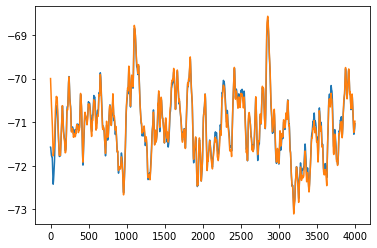

[ 4.78921424e+01  5.68626273e+01 -1.32748664e+00  2.51874990e-02]


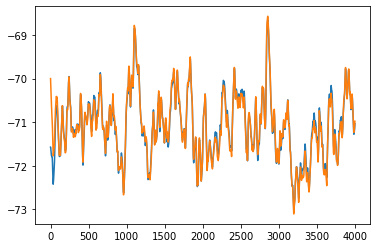

[ 4.78917126e+01  5.68619883e+01 -1.32747978e+00  2.51877597e-02]


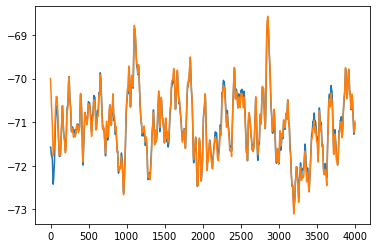

[ 4.78918144e+01  5.68621035e+01 -1.32748339e+00  2.51877133e-02]


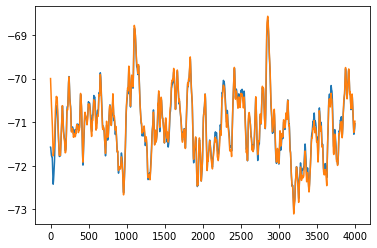

[ 4.78921593e+01  5.68622428e+01 -1.32749680e+00  2.51876417e-02]


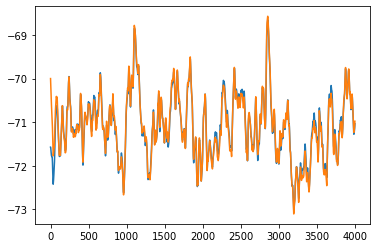

[ 4.78917457e+01  5.68615876e+01 -1.32749450e+00  2.51879132e-02]


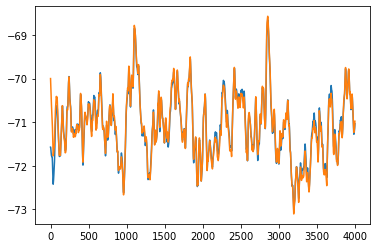

[ 4.78919680e+01  5.68616357e+01 -1.32750418e+00  2.51877595e-02]


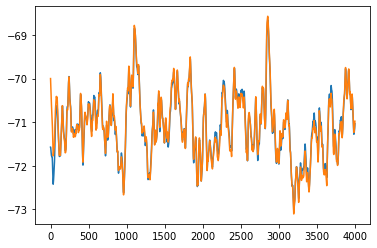

[ 4.78920211e+01  5.68613292e+01 -1.32751487e+00  2.51877696e-02]


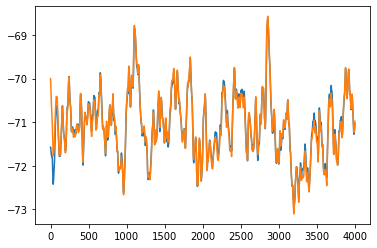

[ 4.78921955e+01  5.68623208e+01 -1.32749732e+00  2.51875091e-02]


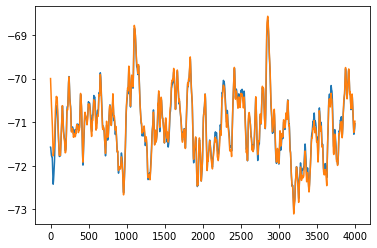

[ 4.78923172e+01  5.68619135e+01 -1.32751540e+00  2.51876068e-02]


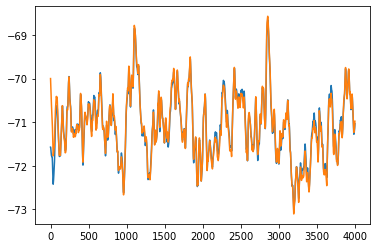

[ 4.78919401e+01  5.68620560e+01 -1.32749139e+00  2.51876867e-02]


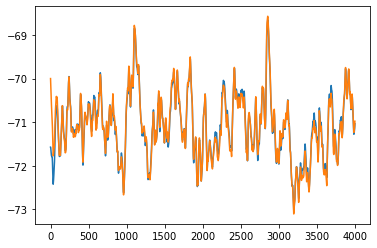

[ 4.78918085e+01  5.68615638e+01 -1.32749850e+00  2.51878998e-02]


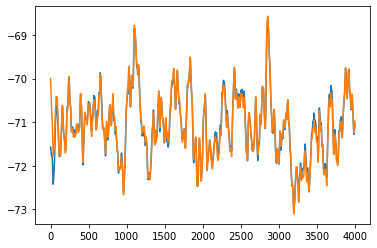

[ 4.78920987e+01  5.68621316e+01 -1.32749762e+00  2.51876068e-02]


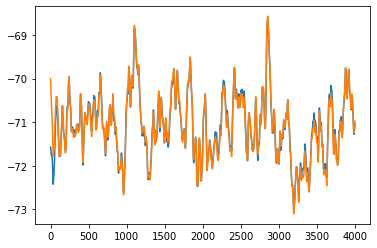

[ 4.78918144e+01  5.68615862e+01 -1.32749944e+00  2.51877498e-02]


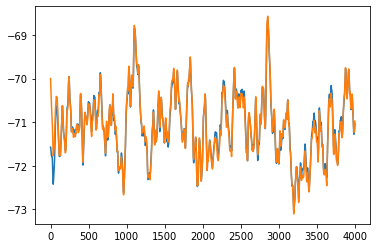

[ 4.78916419e+01  5.68612579e+01 -1.32750076e+00  2.51878038e-02]


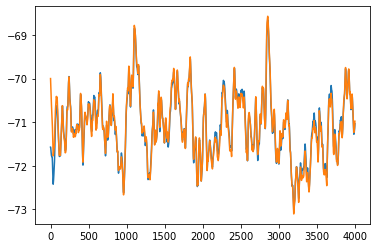

[ 4.78919701e+01  5.68618700e+01 -1.32749703e+00  2.51876715e-02]


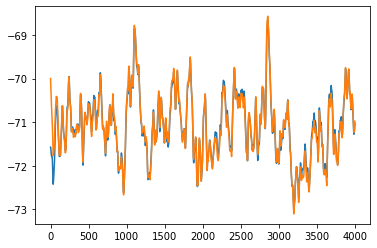

[ 4.78919850e+01  5.68618876e+01 -1.32749591e+00  2.51876423e-02]


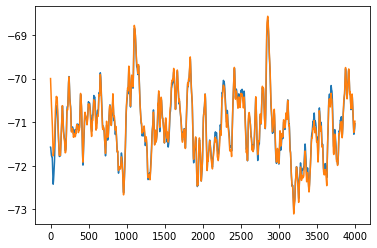

[ 4.78917476e+01  5.68614424e+01 -1.32749840e+00  2.51878270e-02]


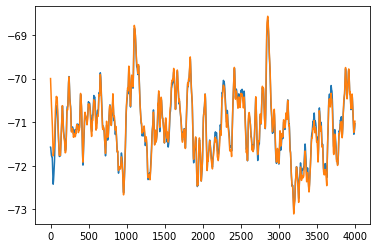

[ 4.78920109e+01  5.68619593e+01 -1.32749781e+00  2.51876618e-02]


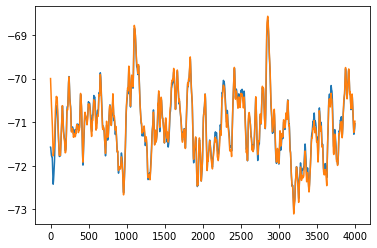

[ 4.78919416e+01  5.68614696e+01 -1.32750784e+00  2.51877346e-02]


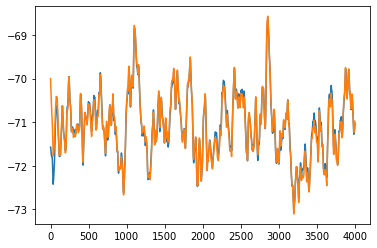

[ 4.78919405e+01  5.68619094e+01 -1.32749550e+00  2.51876987e-02]


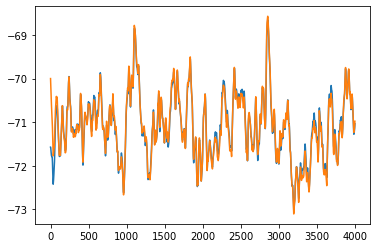

[ 4.78919000e+01  5.68620268e+01 -1.32749071e+00  2.51876313e-02]


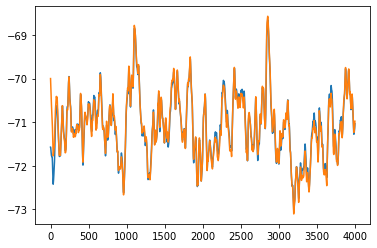

[ 4.78920964e+01  5.68622965e+01 -1.32749110e+00  2.51875819e-02]


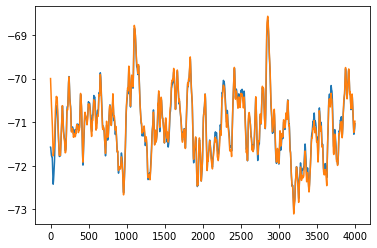

[ 4.78918849e+01  5.68617638e+01 -1.32749735e+00  2.51877078e-02]


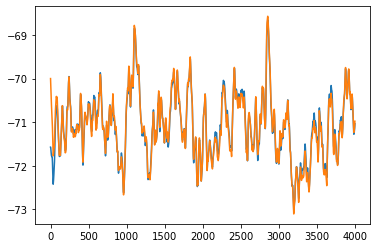

[ 4.78920033e+01  5.68617245e+01 -1.32750314e+00  2.51877386e-02]


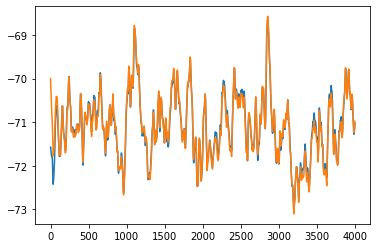

[ 4.78919258e+01  5.68619512e+01 -1.32749382e+00  2.51876581e-02]


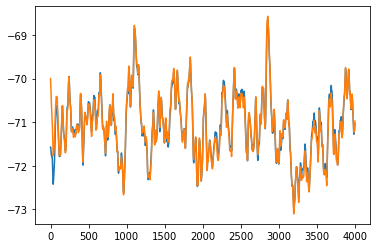

[ 4.78919554e+01  5.68618627e+01 -1.32749751e+00  2.51876509e-02]


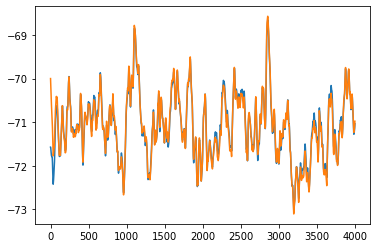

[ 4.78918571e+01  5.68617646e+01 -1.32749504e+00  2.51876824e-02]


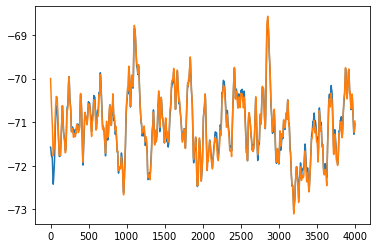

[ 4.78919693e+01  5.68619604e+01 -1.32749435e+00  2.51876237e-02]


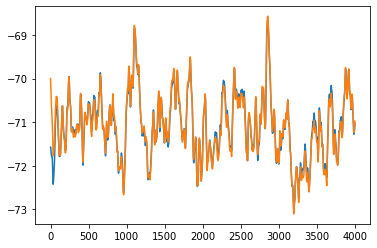

[ 4.78920116e+01  5.68620588e+01 -1.32749285e+00  2.51875816e-02]


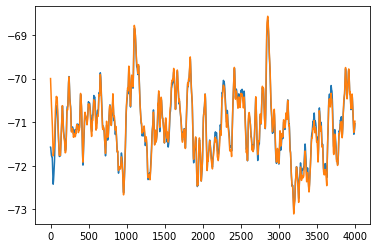

[ 4.78919502e+01  5.68617777e+01 -1.32749814e+00  2.51876561e-02]


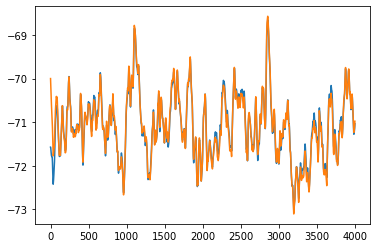

[ 4.78919624e+01  5.68616909e+01 -1.32750030e+00  2.51876551e-02]


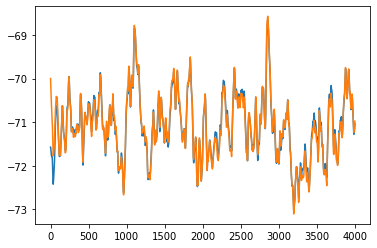

[ 4.78920654e+01  5.68619708e+01 -1.32749847e+00  2.51876187e-02]


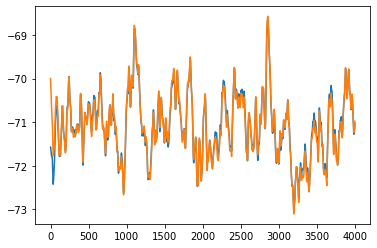

[ 4.78920222e+01  5.68619268e+01 -1.32749649e+00  2.51876340e-02]


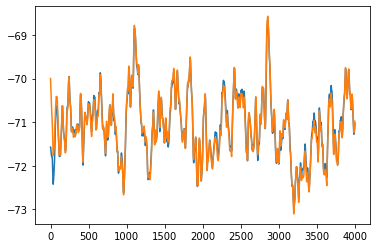

[ 4.78920055e+01  5.68619107e+01 -1.32749675e+00  2.51876383e-02]


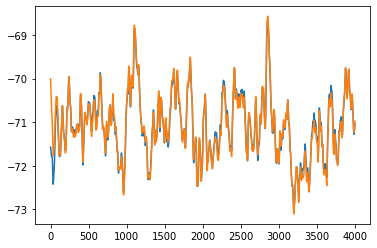

[ 4.78920251e+01  5.68619399e+01 -1.32749682e+00  2.51875969e-02]


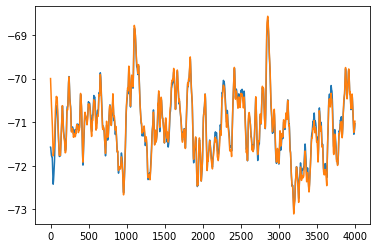

[ 4.78920525e+01  5.68619748e+01 -1.32749672e+00  2.51875596e-02]


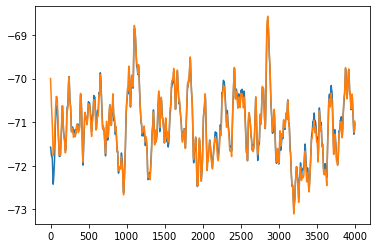

[ 4.78920537e+01  5.68618391e+01 -1.32750074e+00  2.51876313e-02]


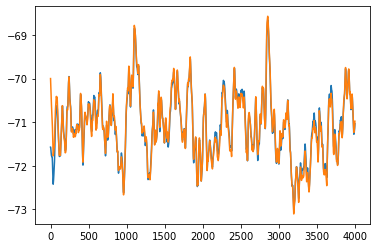

[ 4.78920959e+01  5.68617785e+01 -1.32750394e+00  2.51876351e-02]


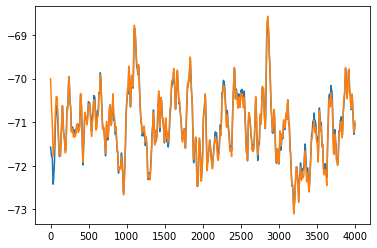

[ 4.78920417e+01  5.68618530e+01 -1.32750035e+00  2.51876132e-02]


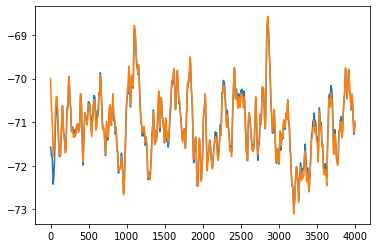

[ 4.78920599e+01  5.68618241e+01 -1.32750215e+00  2.51876007e-02]


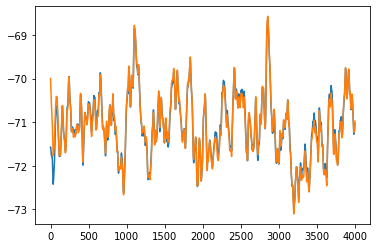

[ 4.78919700e+01  5.68617340e+01 -1.32749955e+00  2.51876300e-02]


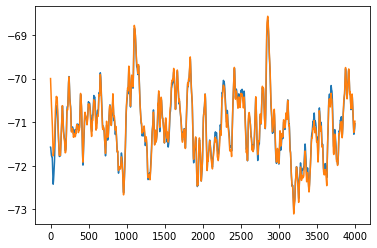

[ 4.78920950e+01  5.68619053e+01 -1.32750059e+00  2.51875797e-02]


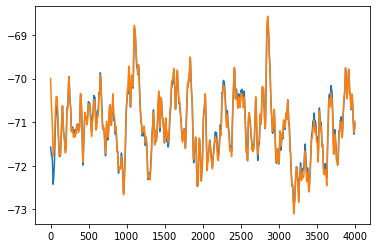

[ 4.78921378e+01  5.68620347e+01 -1.32749970e+00  2.51875805e-02]


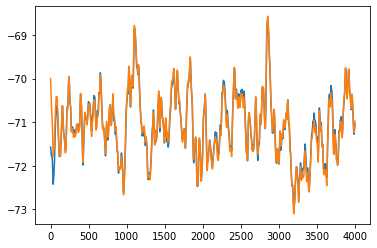

[ 4.78920119e+01  5.68618091e+01 -1.32749959e+00  2.51876177e-02]


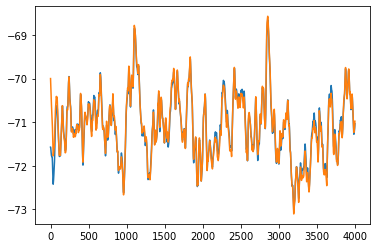

[ 4.78920761e+01  5.68617634e+01 -1.32750381e+00  2.51876241e-02]


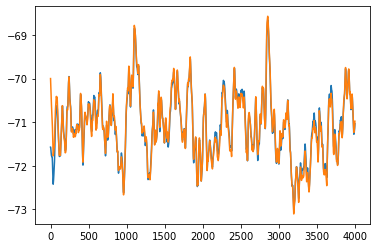

[ 4.78920634e+01  5.68618075e+01 -1.32750207e+00  2.51876173e-02]


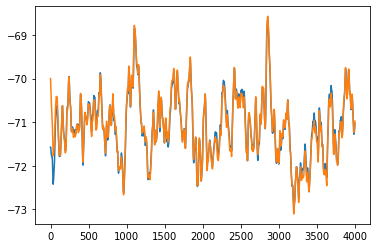

[ 4.78920523e+01  5.68618484e+01 -1.32750055e+00  2.51875826e-02]


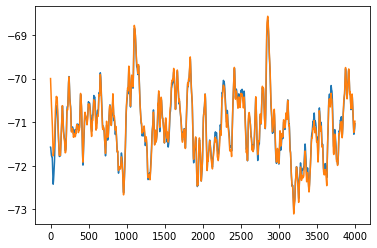

[ 4.78920516e+01  5.68618530e+01 -1.32750045e+00  2.51875582e-02]


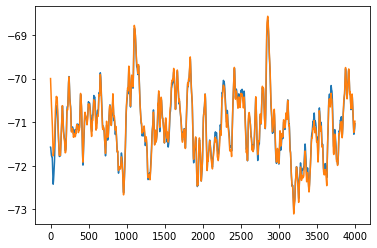

[ 4.78921143e+01  5.68618980e+01 -1.32750219e+00  2.51875787e-02]


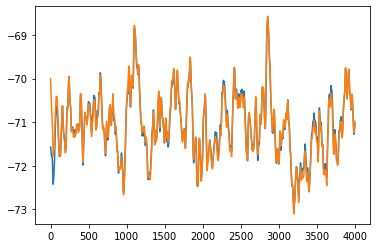

[ 4.78920375e+01  5.68618313e+01 -1.32750024e+00  2.51876079e-02]


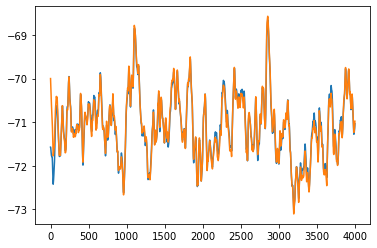

[ 4.78920499e+01  5.68619115e+01 -1.32749880e+00  2.51875745e-02]


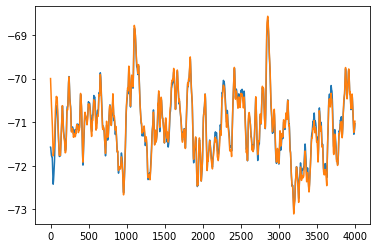

[ 4.78919957e+01  5.68618168e+01 -1.32749938e+00  2.51876095e-02]


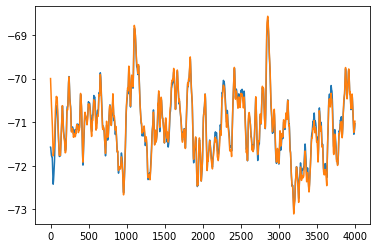

[ 4.78920205e+01  5.68618389e+01 -1.32749968e+00  2.51876020e-02]


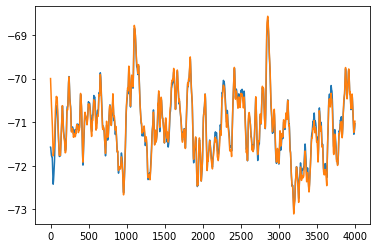

[ 4.78920384e+01  5.68618621e+01 -1.32749929e+00  2.51875702e-02]


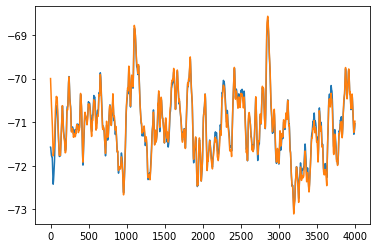

[ 4.78920409e+01  5.68618553e+01 -1.32750008e+00  2.51876025e-02]


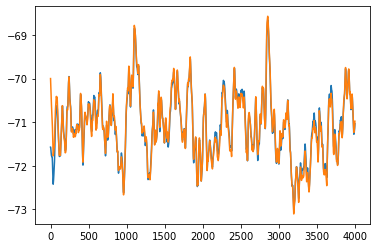

[ 4.78920257e+01  5.68617755e+01 -1.32750148e+00  2.51876231e-02]


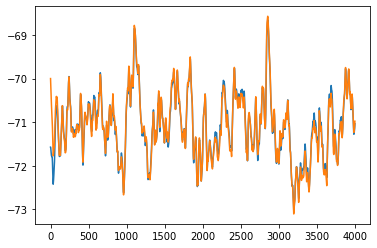

[ 4.78920439e+01  5.68618775e+01 -1.32749947e+00  2.51875866e-02]


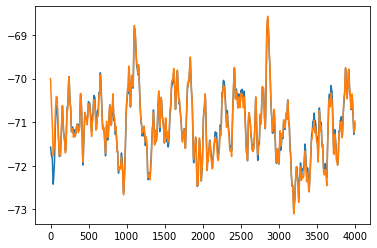

[ 4.78920413e+01  5.68618787e+01 -1.32749965e+00  2.51875789e-02]


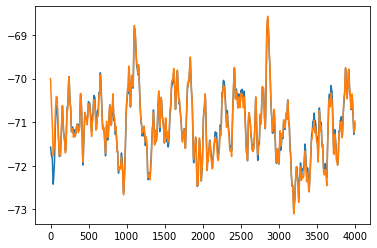

[ 4.78920403e+01  5.68618668e+01 -1.32749980e+00  2.51875862e-02]


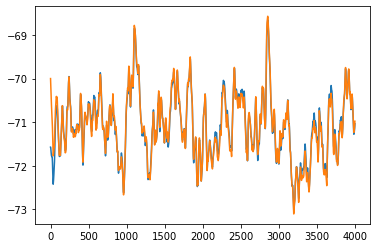

[ 4.78920682e+01  5.68618851e+01 -1.32750027e+00  2.51875769e-02]


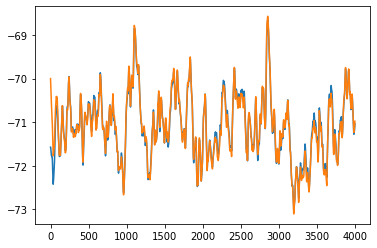

[ 4.78920615e+01  5.68618836e+01 -1.32749996e+00  2.51875637e-02]


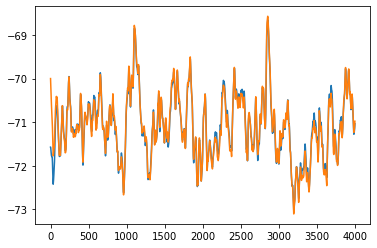

[ 4.78920460e+01  5.68618623e+01 -1.32750005e+00  2.51875928e-02]


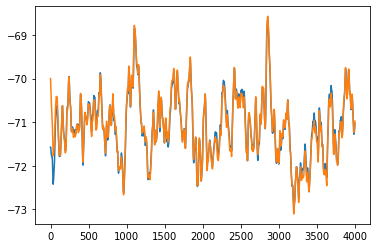

[ 4.78920596e+01  5.68618538e+01 -1.32750087e+00  2.51875826e-02]


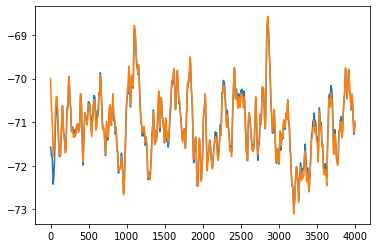

[ 4.78920674e+01  5.68618420e+01 -1.32750157e+00  2.51875807e-02]


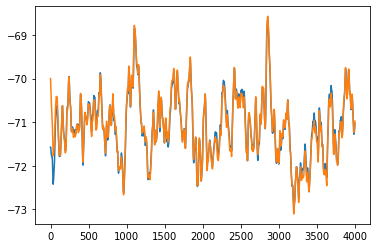

[ 4.78920727e+01  5.68618580e+01 -1.32750107e+00  2.51875813e-02]


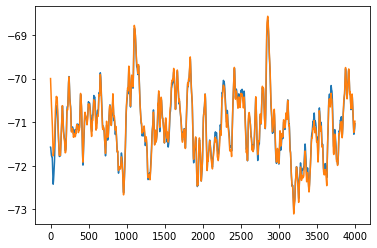

[ 4.78920471e+01  5.68618262e+01 -1.32750100e+00  2.51875927e-02]


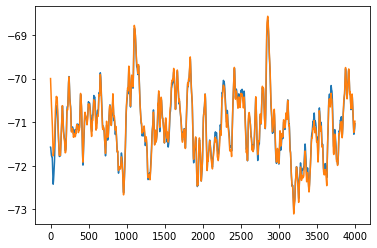

[ 4.78920366e+01  5.68617968e+01 -1.32750137e+00  2.51876006e-02]


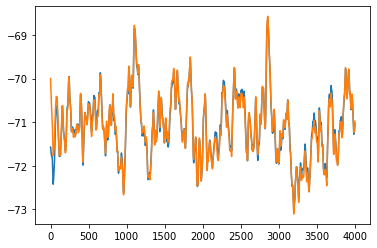

[ 4.78920298e+01  5.68618374e+01 -1.32750016e+00  2.51875941e-02]


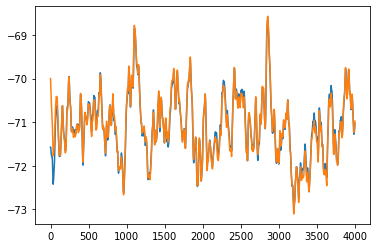

[ 4.78920620e+01  5.68618528e+01 -1.32750084e+00  2.51875845e-02]


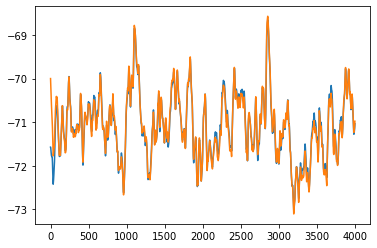

[ 4.78920645e+01  5.68618283e+01 -1.32750158e+00  2.51875785e-02]


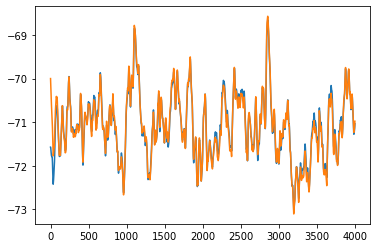

[ 4.78920506e+01  5.68618538e+01 -1.32750043e+00  2.51875892e-02]


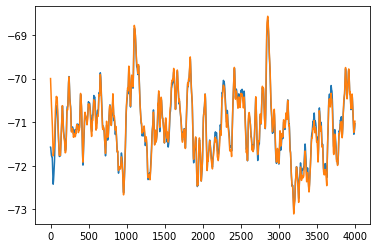

[ 4.78920573e+01  5.68618450e+01 -1.32750102e+00  2.51875919e-02]


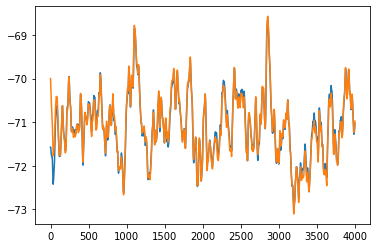

[ 4.78920536e+01  5.68618475e+01 -1.32750067e+00  2.51875849e-02]


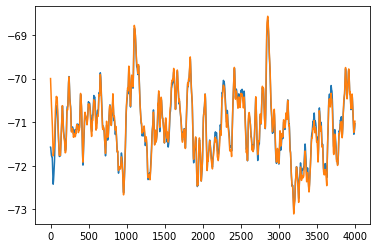

[ 4.78920435e+01  5.68618379e+01 -1.32750064e+00  2.51875903e-02]


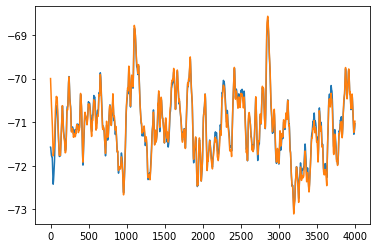

[ 4.78920378e+01  5.68618289e+01 -1.32750051e+00  2.51875959e-02]


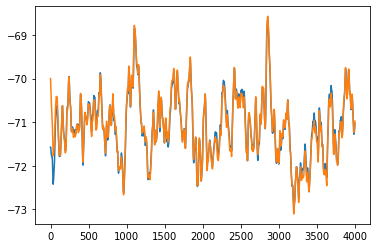

[ 4.78920541e+01  5.68618476e+01 -1.32750078e+00  2.51875860e-02]


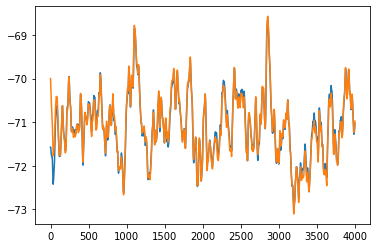

[ 4.78920593e+01  5.68618497e+01 -1.32750080e+00  2.51875862e-02]


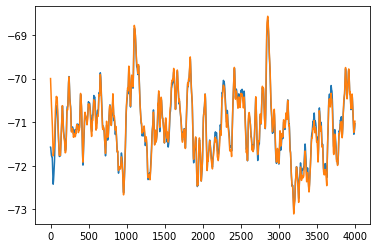

[ 4.78920474e+01  5.68618408e+01 -1.32750068e+00  2.51875892e-02]


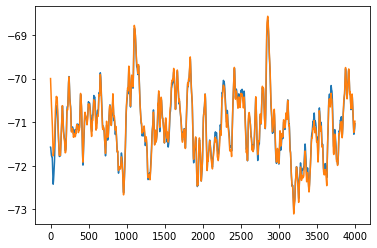

[ 4.78920505e+01  5.68618272e+01 -1.32750113e+00  2.51875872e-02]


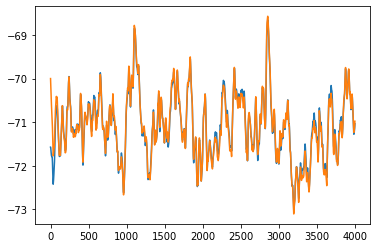

[ 4.78920506e+01  5.68618472e+01 -1.32750061e+00  2.51875887e-02]


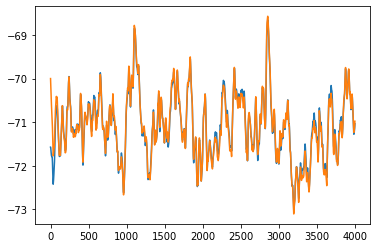

[ 4.78920557e+01  5.68618654e+01 -1.32750037e+00  2.51875817e-02]


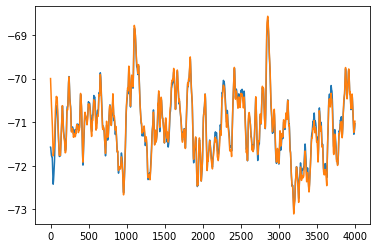

[ 4.78920493e+01  5.68618360e+01 -1.32750084e+00  2.51875900e-02]


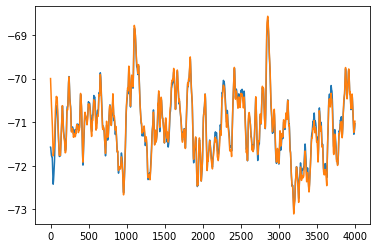

[ 4.78920472e+01  5.68618383e+01 -1.32750078e+00  2.51875920e-02]


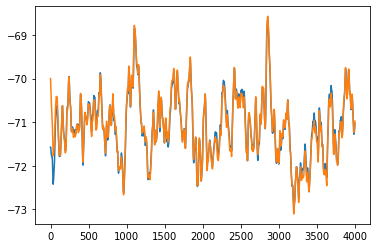

[ 4.78920520e+01  5.68618452e+01 -1.32750070e+00  2.51875867e-02]


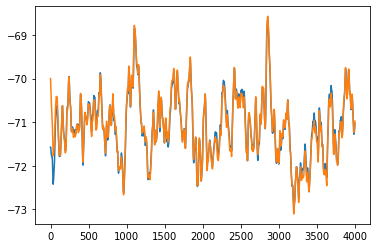

[ 4.78920556e+01  5.68618472e+01 -1.32750078e+00  2.51875864e-02]


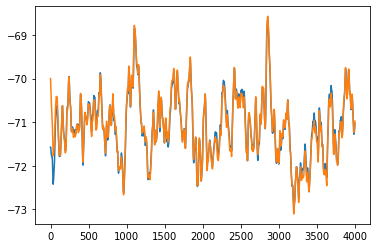

[ 4.78920596e+01  5.68618503e+01 -1.32750083e+00  2.51875850e-02]


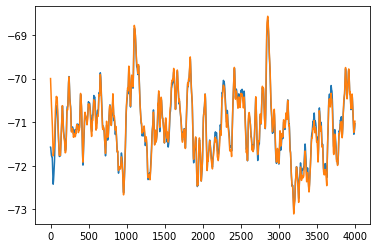

[ 4.78920549e+01  5.68618408e+01 -1.32750094e+00  2.51875858e-02]


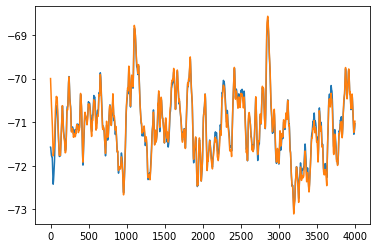

[ 4.78920517e+01  5.68618370e+01 -1.32750086e+00  2.51875885e-02]


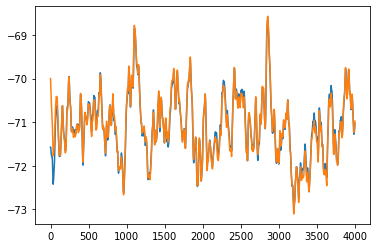

[ 4.78920535e+01  5.68618449e+01 -1.32750080e+00  2.51875866e-02]


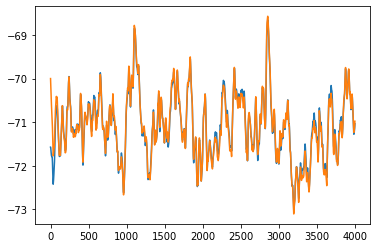

[ 4.78920503e+01  5.68618459e+01 -1.32750062e+00  2.51875890e-02]


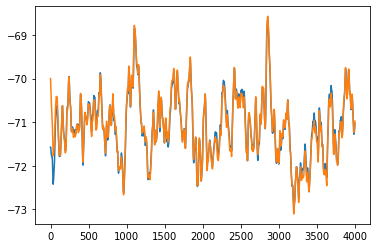

[ 4.78920514e+01  5.68618446e+01 -1.32750070e+00  2.51875882e-02]


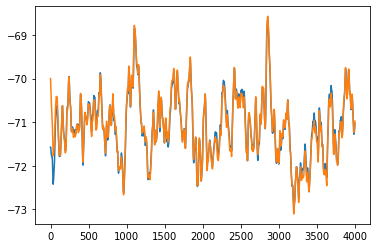

[ 4.78920570e+01  5.68618550e+01 -1.32750065e+00  2.51875840e-02]


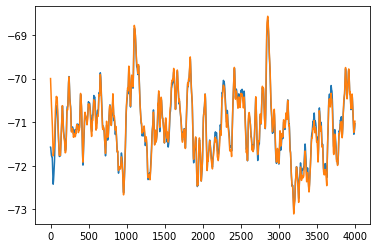

[ 4.78920512e+01  5.68618407e+01 -1.32750079e+00  2.51875885e-02]


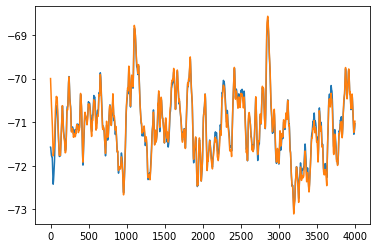

[ 4.78920539e+01  5.68618435e+01 -1.32750084e+00  2.51875882e-02]


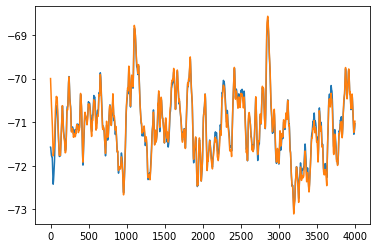

[ 4.78920495e+01  5.68618397e+01 -1.32750078e+00  2.51875893e-02]


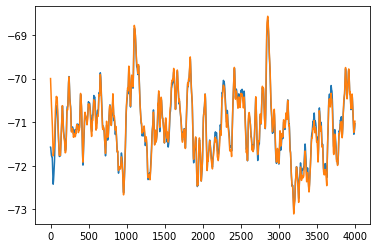

[ 4.78920495e+01  5.68618393e+01 -1.32750076e+00  2.51875905e-02]


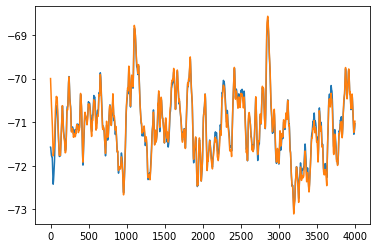

[ 4.78920525e+01  5.68618435e+01 -1.32750079e+00  2.51875876e-02]


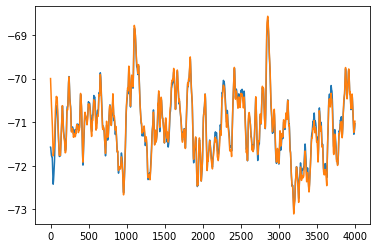

[ 4.78920526e+01  5.68618421e+01 -1.32750082e+00  2.51875883e-02]


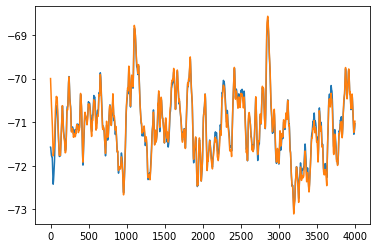

[ 4.78920513e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


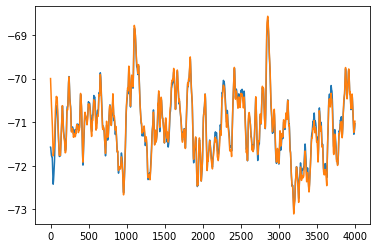

[ 4.78920503e+01  5.68618402e+01 -1.32750079e+00  2.51875889e-02]


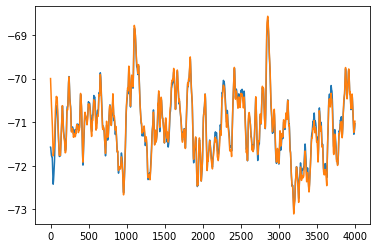

[ 4.78920524e+01  5.68618428e+01 -1.32750079e+00  2.51875875e-02]


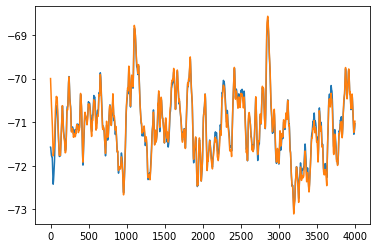

[ 4.78920503e+01  5.68618400e+01 -1.32750078e+00  2.51875895e-02]


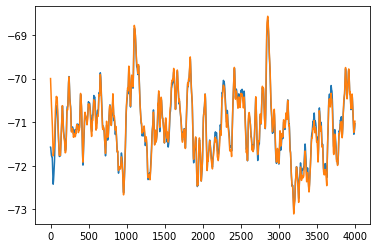

[ 4.78920509e+01  5.68618407e+01 -1.32750078e+00  2.51875890e-02]


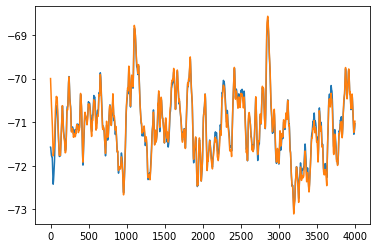

[ 4.78920513e+01  5.68618421e+01 -1.32750077e+00  2.51875888e-02]


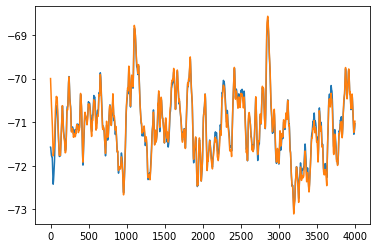

[ 4.78920527e+01  5.68618436e+01 -1.32750077e+00  2.51875884e-02]


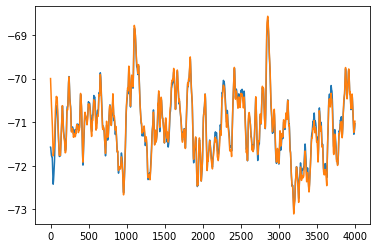

[ 4.78920505e+01  5.68618424e+01 -1.32750072e+00  2.51875889e-02]


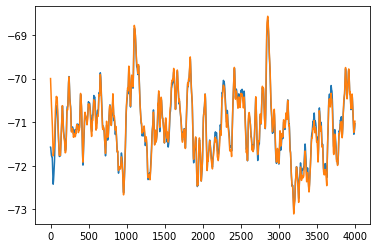

[ 4.78920521e+01  5.68618422e+01 -1.32750079e+00  2.51875885e-02]


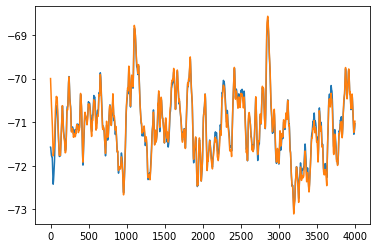

[ 4.78920521e+01  5.68618425e+01 -1.32750077e+00  2.51875883e-02]


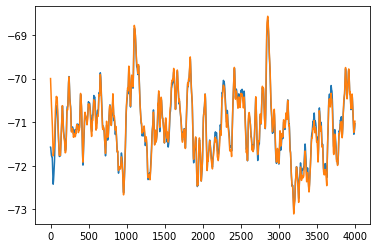

[ 4.78920505e+01  5.68618404e+01 -1.32750078e+00  2.51875887e-02]


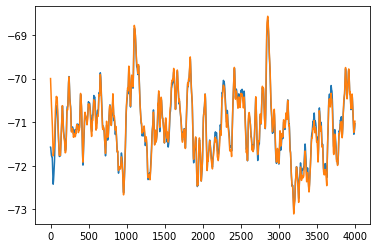

[ 4.78920521e+01  5.68618428e+01 -1.32750077e+00  2.51875884e-02]


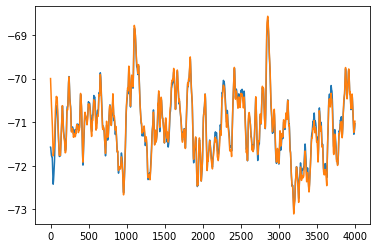

[ 4.78920511e+01  5.68618417e+01 -1.32750076e+00  2.51875887e-02]


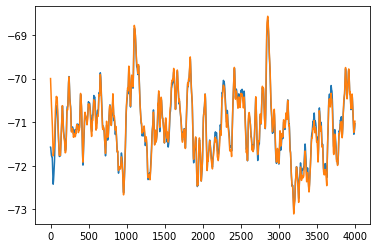

[ 4.78920517e+01  5.68618426e+01 -1.32750076e+00  2.51875883e-02]


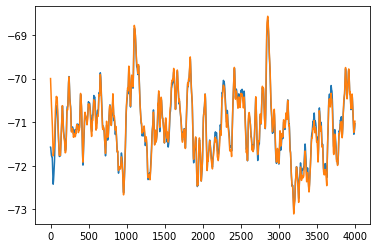

[ 4.78920517e+01  5.68618424e+01 -1.32750077e+00  2.51875884e-02]


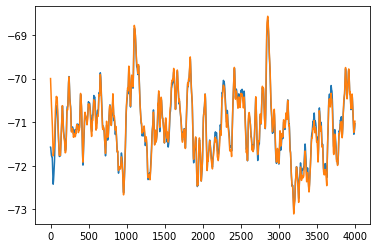

[ 4.78920520e+01  5.68618431e+01 -1.32750076e+00  2.51875884e-02]


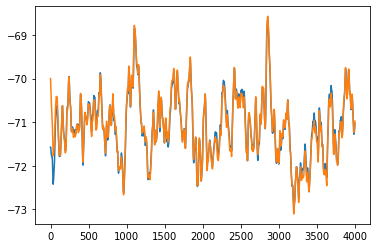

[ 4.78920523e+01  5.68618437e+01 -1.32750075e+00  2.51875880e-02]


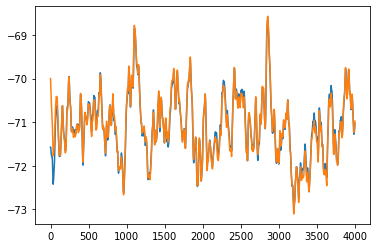

[ 4.78920520e+01  5.68618436e+01 -1.32750074e+00  2.51875881e-02]


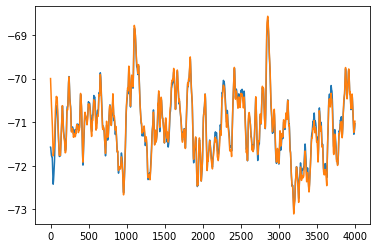

[ 4.78920518e+01  5.68618427e+01 -1.32750076e+00  2.51875883e-02]


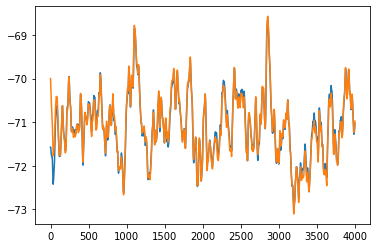

[ 4.78920518e+01  5.68618432e+01 -1.32750075e+00  2.51875882e-02]


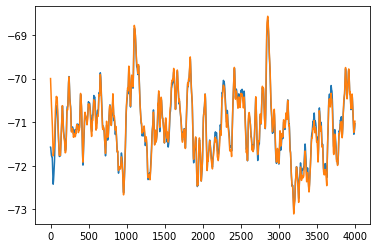

[ 4.78920515e+01  5.68618426e+01 -1.32750075e+00  2.51875883e-02]


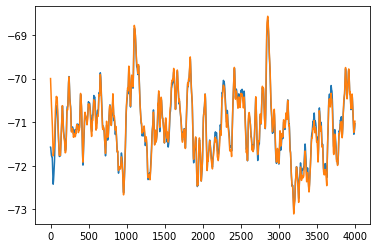

[ 4.78920517e+01  5.68618429e+01 -1.32750075e+00  2.51875884e-02]


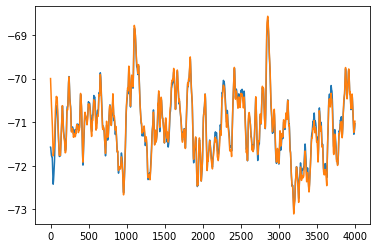

[ 4.78920515e+01  5.68618425e+01 -1.32750076e+00  2.51875884e-02]


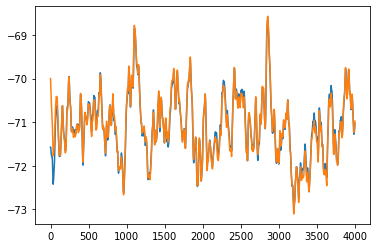

[ 4.78920517e+01  5.68618431e+01 -1.32750074e+00  2.51875882e-02]


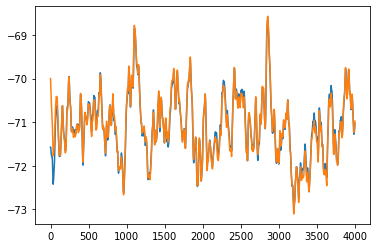

[ 4.78920516e+01  5.68618430e+01 -1.32750075e+00  2.51875883e-02]


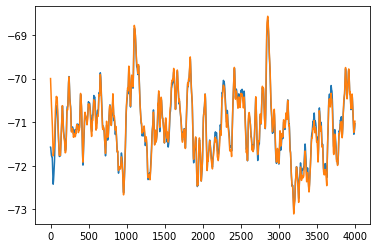

[ 4.78920515e+01  5.68618428e+01 -1.32750075e+00  2.51875884e-02]


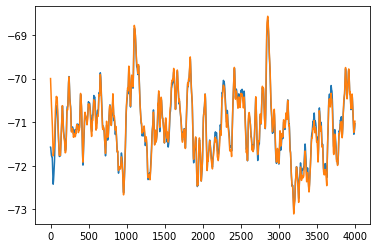

[ 4.78920514e+01  5.68618426e+01 -1.32750075e+00  2.51875883e-02]


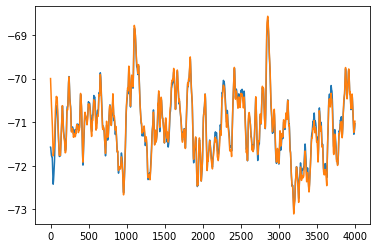

[ 4.78920516e+01  5.68618429e+01 -1.32750075e+00  2.51875883e-02]


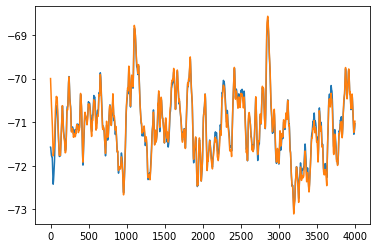

[ 4.78920514e+01  5.68618426e+01 -1.32750075e+00  2.51875884e-02]


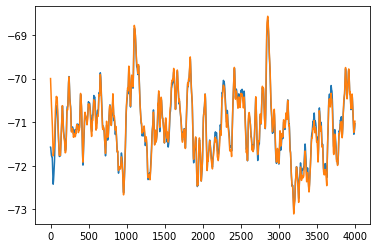

[ 4.78920514e+01  5.68618426e+01 -1.32750075e+00  2.51875883e-02]


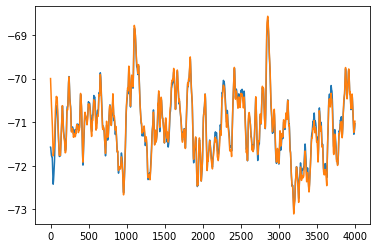

[ 4.78920512e+01  5.68618423e+01 -1.32750075e+00  2.51875884e-02]


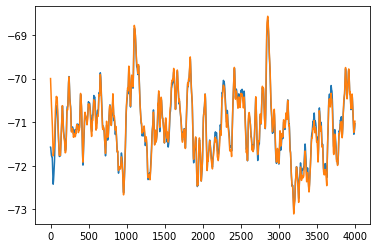

[ 4.78920512e+01  5.68618425e+01 -1.32750075e+00  2.51875884e-02]


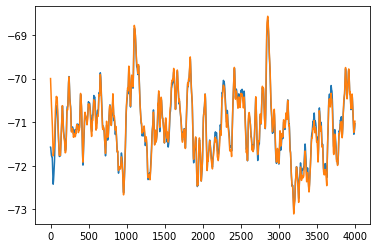

[ 4.78920514e+01  5.68618426e+01 -1.32750075e+00  2.51875884e-02]


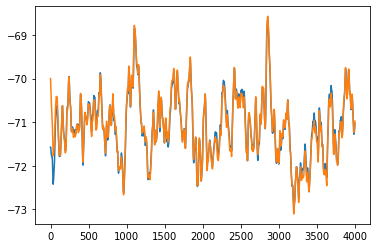

[ 4.78920515e+01  5.68618429e+01 -1.32750075e+00  2.51875883e-02]


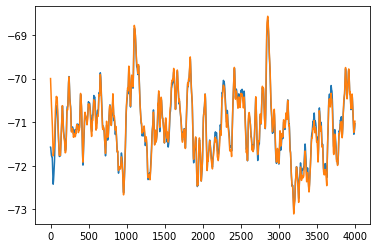

[ 4.78920515e+01  5.68618428e+01 -1.32750075e+00  2.51875884e-02]


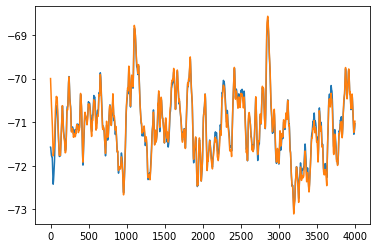

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


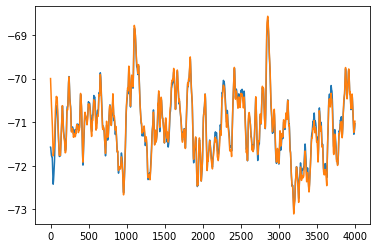

[ 4.78920514e+01  5.68618426e+01 -1.32750075e+00  2.51875884e-02]


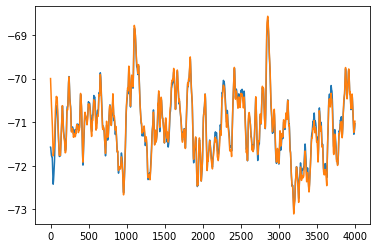

[ 4.78920514e+01  5.68618426e+01 -1.32750075e+00  2.51875884e-02]


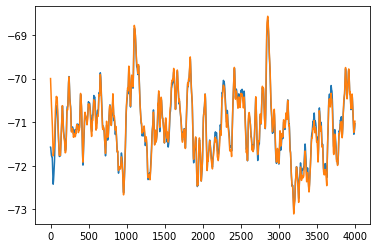

[ 4.78920515e+01  5.68618428e+01 -1.32750075e+00  2.51875883e-02]


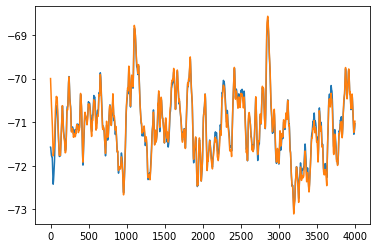

[ 4.78920514e+01  5.68618426e+01 -1.32750075e+00  2.51875883e-02]


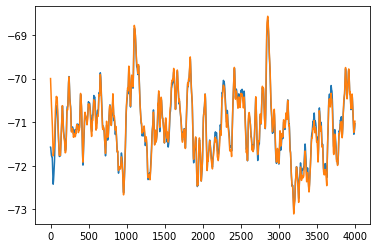

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


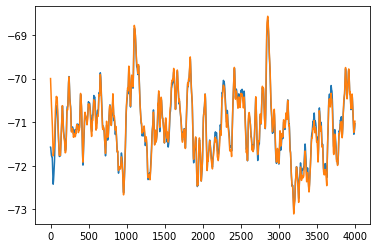

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


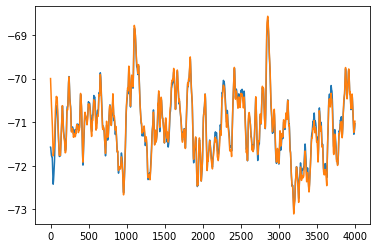

[ 4.78920515e+01  5.68618428e+01 -1.32750075e+00  2.51875883e-02]


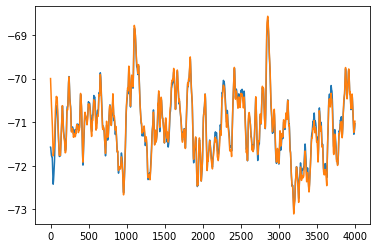

[ 4.78920515e+01  5.68618428e+01 -1.32750075e+00  2.51875883e-02]


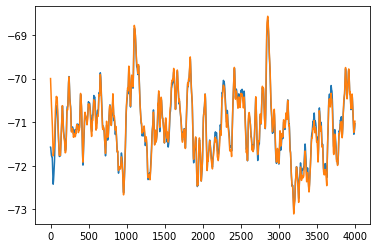

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


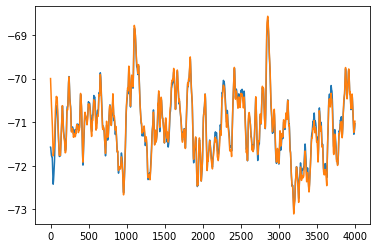

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


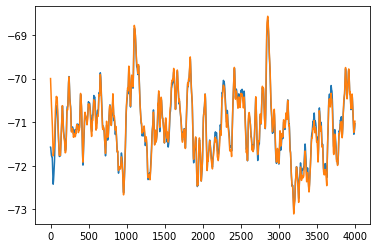

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


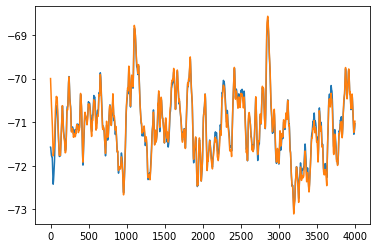

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


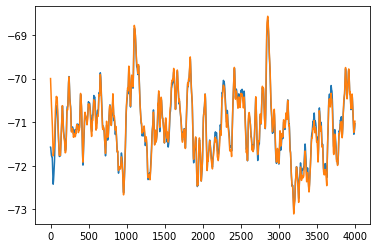

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


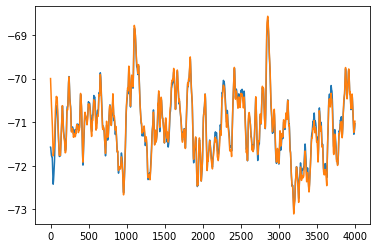

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


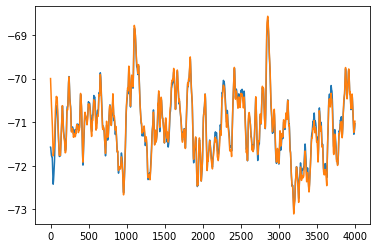

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


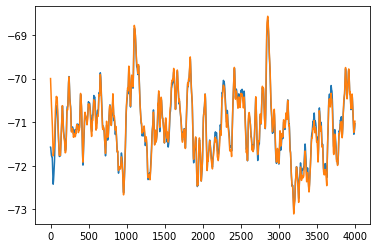

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


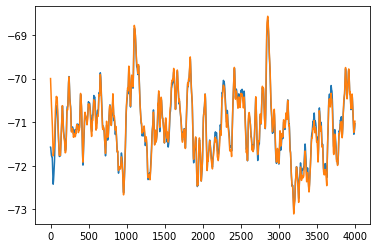

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


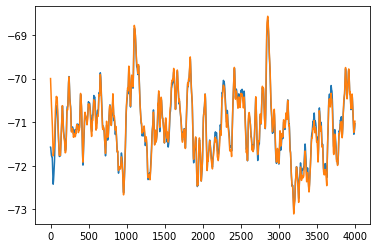

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


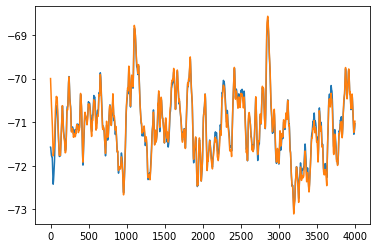

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


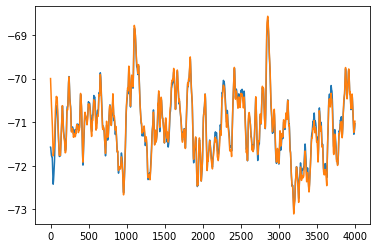

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


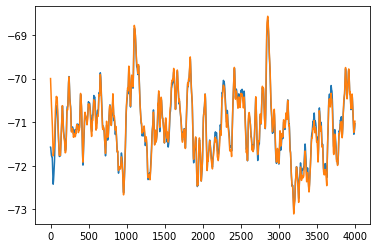

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


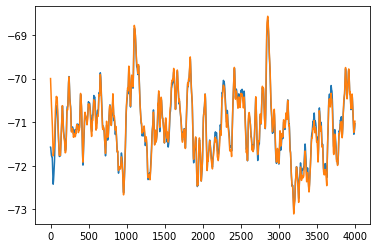

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


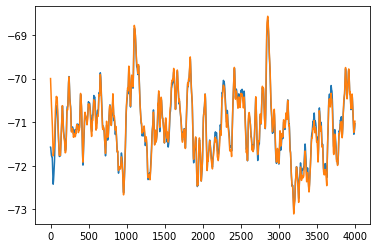

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


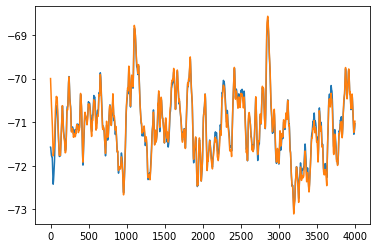

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


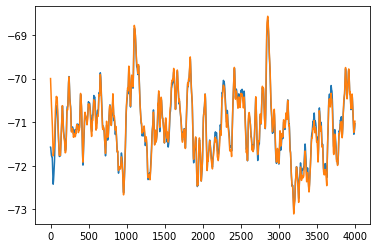

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


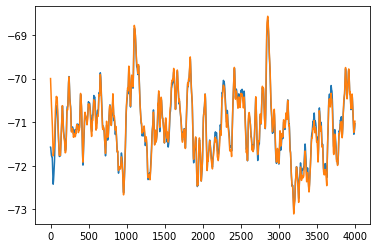

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


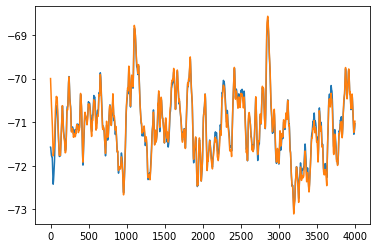

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


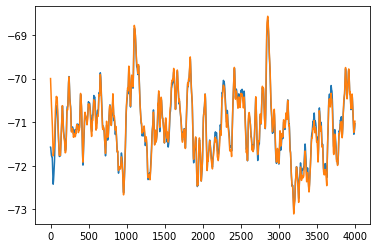

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


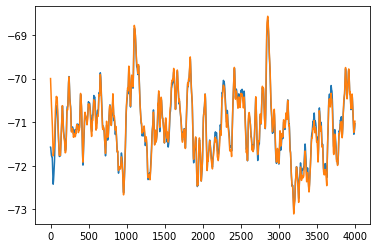

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]


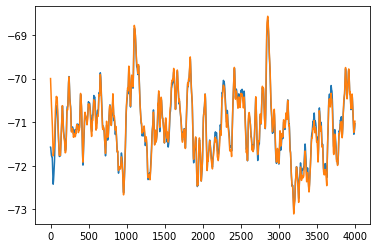

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


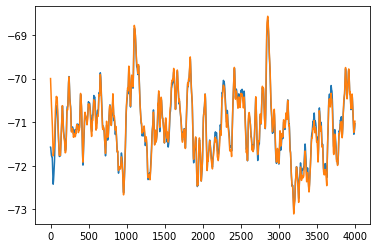

[ 4.78920514e+01  5.68618427e+01 -1.32750075e+00  2.51875884e-02]


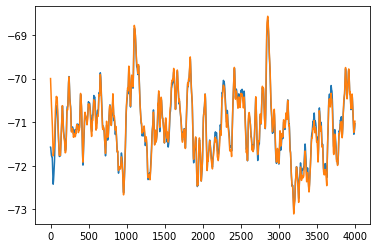

[ 4.78920515e+01  5.68618427e+01 -1.32750075e+00  2.51875883e-02]
Optimization terminated successfully.
         Current function value: 0.018317
         Iterations: 445
         Function evaluations: 781


In [ ]:
from scipy.optimize import minimize
from scipy.optimize import Bounds

x0 = np.array([3.38352973e+02,3.38790636e+02,3.81557859e-01,1.12408009e-02])
res = minimize(run_Izhikevich, x0, method='nelder-mead', options={'xatol': 1e-8, 'disp': True})

In [ ]:
final_results = [4.78920515e+01,5.68618427e+01,-1.32750075e+00,2.51875883e-02]

In [ ]:
data1 = pd.read_csv('/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/firing_freq.txt', sep="\t", header=None, dtype='float32')
#data.drop([3], axis = 1, inplace=True)
vmi2 = np.asarray(data1)[:,1][0::10]


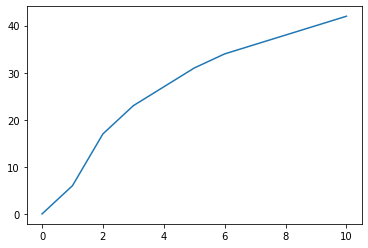

In [ ]:
plt.plot(vmi2)

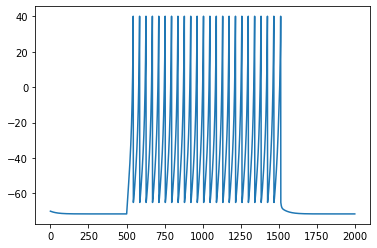

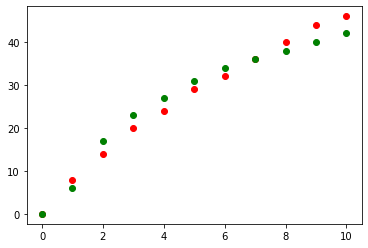

[23.37979826, -65.0708839, 9.23623535, 0.2, 8.04666882, 13.87852183] 25.0


1.28564869306645

In [ ]:
def go_Izhikevich(arg0, arg2):
    threshold_value = arg2[0]   #-35.
    spike_amp = 40.
    ahp_amp = arg2[1]   #-75.
    dt = arg0[3]
    a = arg2[2]    #0.2
    b = arg2[3]    #0.2
    d = arg2[4]     #8.0

    Vm = arg0[0]
    u = arg0[1]
    I = arg0[2]
    #print(Vm, u, I)

    if Vm > threshold_value and Vm < 35:
        du = a * (b * Vm - u)
        u1 = u + dt * du
        #print("first")
        return np.asarray([spike_amp,u1])
    elif Vm == spike_amp:      #self.u+ self.d
        du = a * (b * Vm - u)
        u1 = u + dt * du
        #print("second")
        return np.asarray([ahp_amp,u1+d])
    else:
        #print("third")
        dV = (0.04 * Vm + 5) * Vm + 140 - u
        V1 = Vm + (dV + I) * dt

        du = a * (b * Vm - u)
        u1 = u + dt * du
        return np.asarray([V1, u1])


def run_Izhikevich(arg2):
    final_results = [4.78920515e+01,5.68618427e+01,-1.32750075e+00,2.51875883e-02]
    spikes = []
    for trace in range(11):
        orig_inputs = np.asarray([-70., -14., 0., final_results[3]])
        V_res = []
        u_res = []
        I_res = []
        V_main = []
        u_main = []
        I_main = []
        g_exc = vmi1[:,1]
        g_inh = vmi1[:,2]

        Vs = np.asarray(go_Izhikevich(orig_inputs, arg2))
        V_res.append(Vs[0])

        resting_current = 0.5


        for i in range(2000):
            
            if i>500 and i<1500:
                I1 = trace*arg2[5]-1.32750075e+00
            else:
                I1 = -1.32750075e+00
            


            orig_inputs = np.asarray([Vs[0], Vs[1], I1, final_results[3]])
            #print(orig_inputs)
            Vs = (go_Izhikevich(orig_inputs, arg2))
            V_res.append(Vs[0])
            u_res.append(Vs[1])
            I_res.append(I1)

        V_res = np.asarray(V_res)
        spike_count = (V_res == 40).sum()
        spikes.append(spike_count)
        if (trace ==4):
            plt.plot(V_res)
            plt.show()
    plt.plot(np.asarray(spikes), "ro")
    plt.plot(vmi2, "go")
    plt.show()
    print(arg2, np.sum(np.abs((np.asarray(spikes) - vmi2))))
    return np.std(np.abs((np.asarray(spikes) - vmi2)),axis=0)


final_firing_results = [23.37979826,-65.0708839,9.23623535,0.2,8.04666882, 13.87852183]
run_Izhikevich(final_firing_results)



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: OptimizeWarning: Unknown solver options: xatol
  """


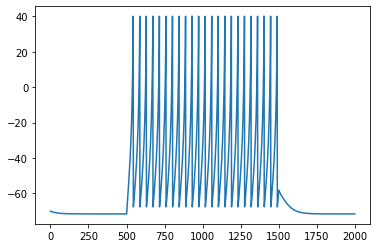

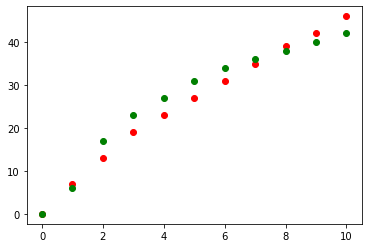

[ 23.37599884 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


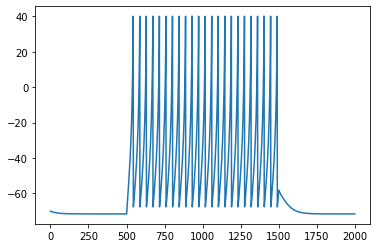

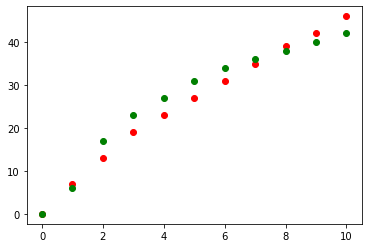

[ 23.37599884 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


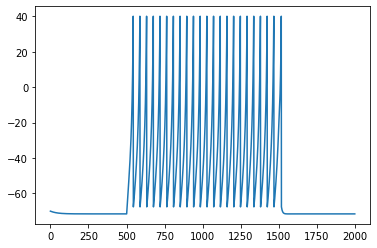

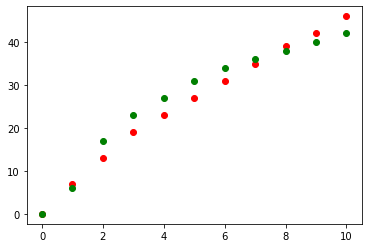

[ 24.37599884 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


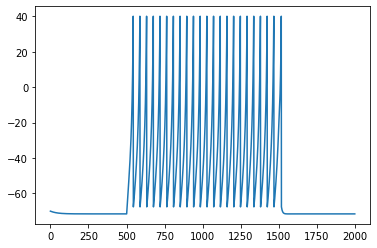

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: overflow encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in double_scalars


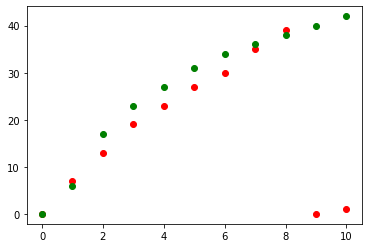

[ 25.99403284 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 104.0


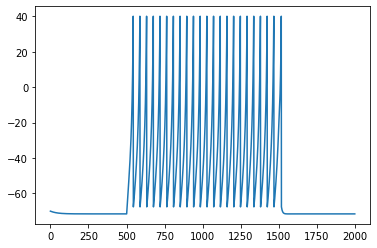

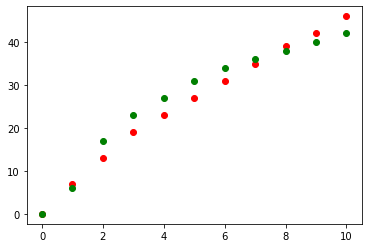

[ 24.37599884 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


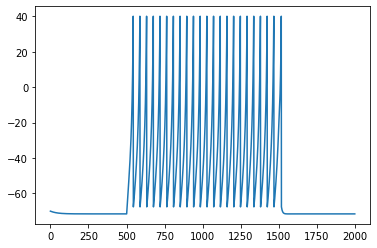

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: overflow encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in double_scalars


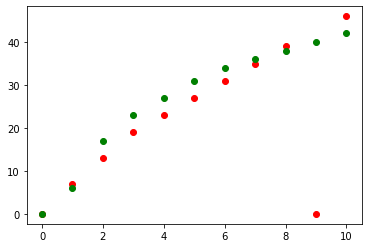

[ 24.99403281 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 66.0


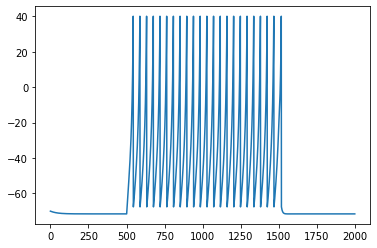

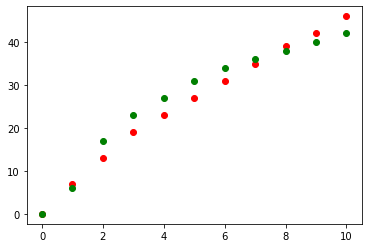

[ 23.99403284 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


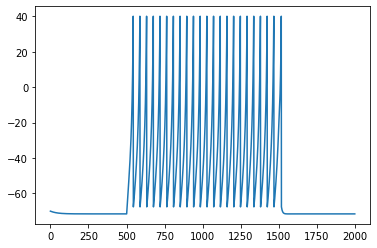

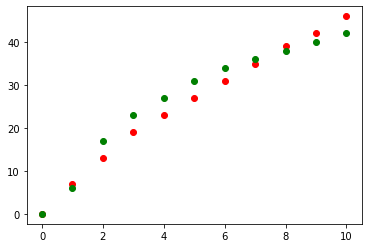

[ 24.18501584 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


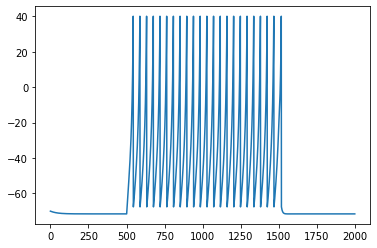

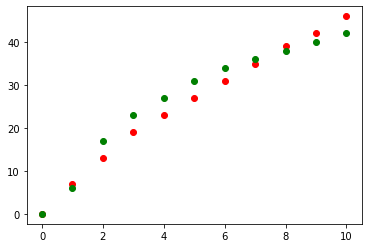

[ 24.11206683 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


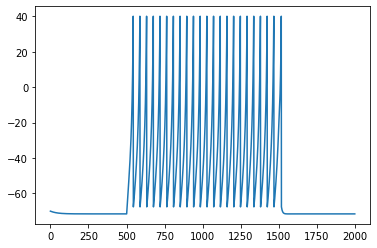

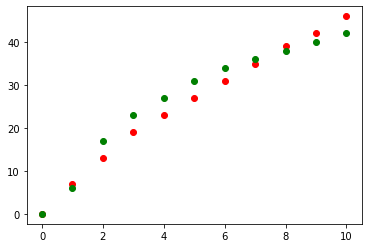

[ 24.06698186 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


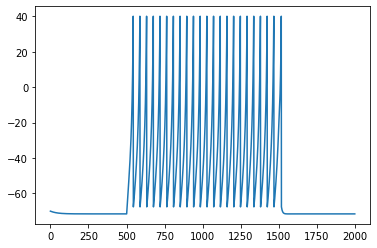

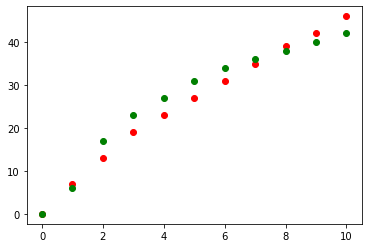

[ 24.03911781 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


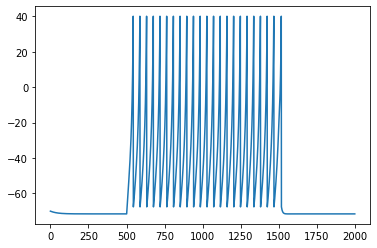

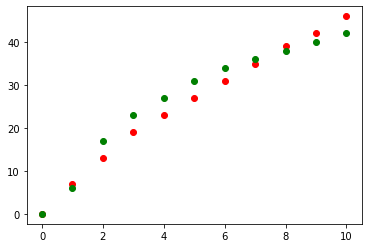

[ 24.02189689 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


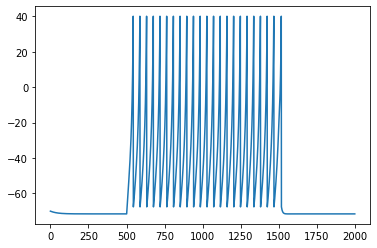

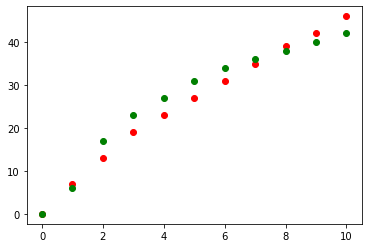

[ 24.01125377 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


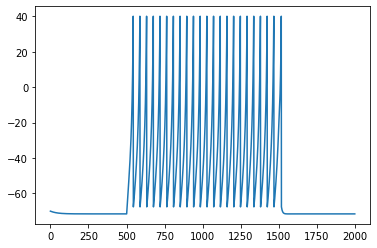

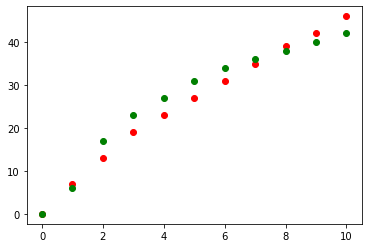

[ 24.00467596 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


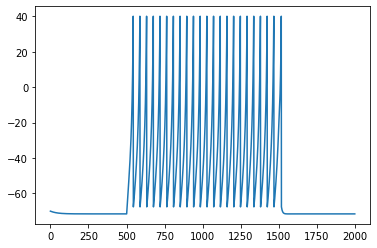

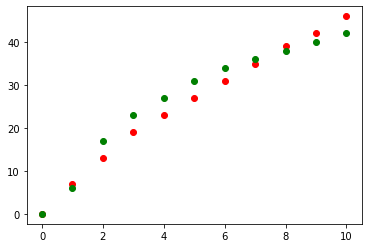

[ 24.00467596 -67.58236192   5.63108546   0.2          2.8708109
  13.87852183] 28.0


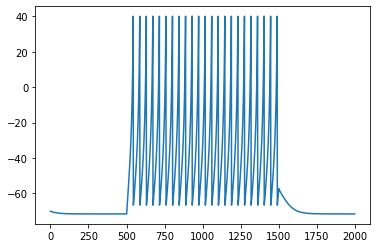

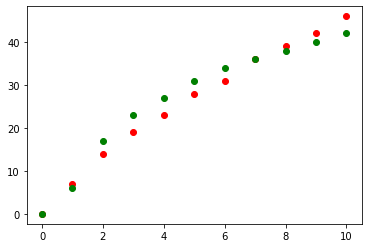

[ 24.00467596 -66.58236192   5.63108546   0.2          2.8708109
  13.87852183] 25.0


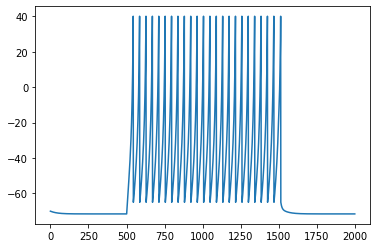

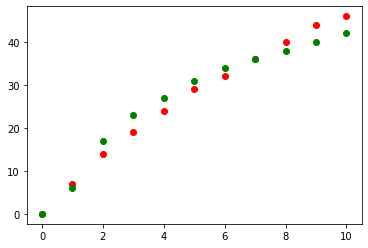

[ 24.00467596 -64.96432792   5.63108546   0.2          2.8708109
  13.87852183] 25.0


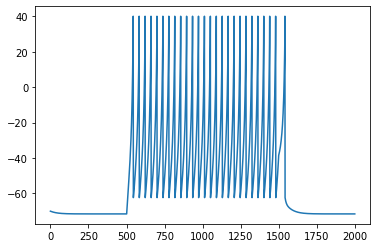

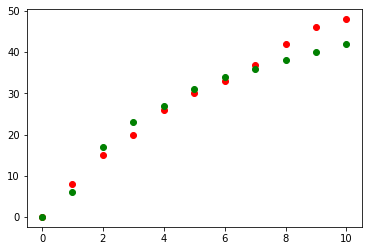

[ 24.00467596 -62.34629389   5.63108546   0.2          2.8708109
  13.87852183] 27.0


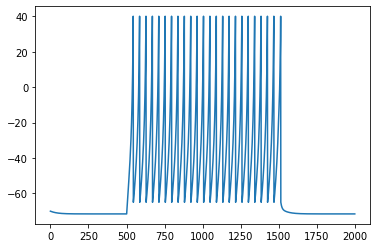

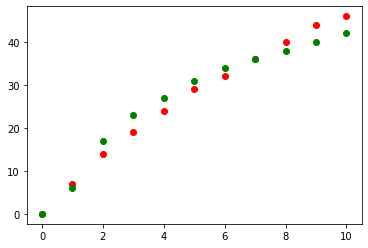

[ 24.00467596 -64.96432792   5.63108546   0.2          2.8708109
  13.87852183] 25.0


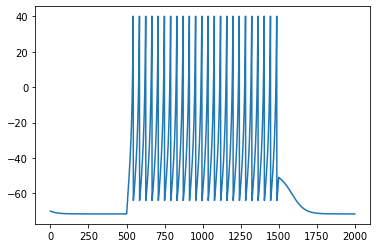

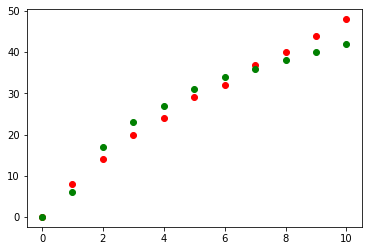

[ 24.00467596 -63.96432794   5.63108546   0.2          2.8708109
  13.87852183] 28.0


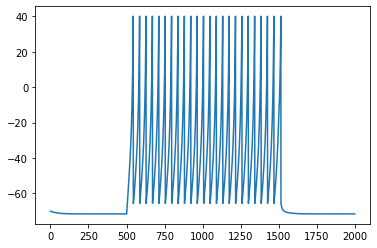

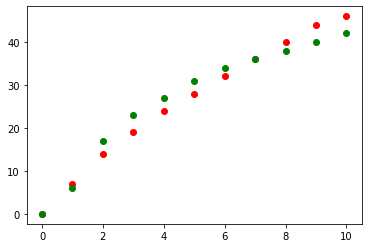

[ 24.00467596 -65.58236189   5.63108546   0.2          2.8708109
  13.87852183] 26.0


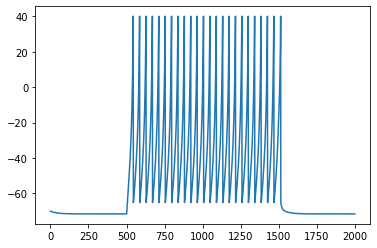

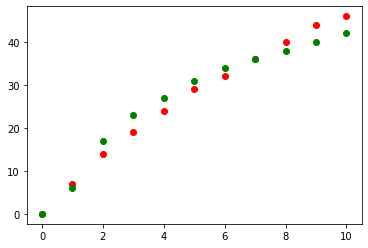

[ 24.00467596 -65.11853732   5.63108546   0.2          2.8708109
  13.87852183] 25.0


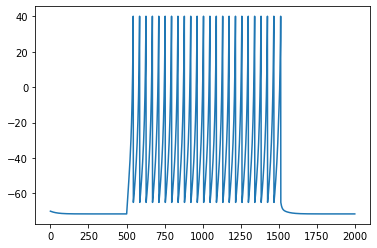

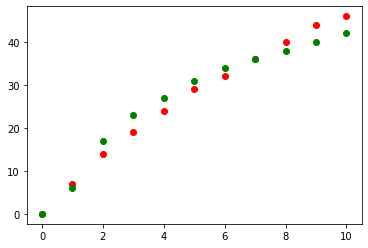

[ 24.00467596 -65.04143262   5.63108546   0.2          2.8708109
  13.87852183] 25.0


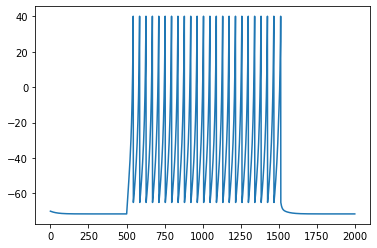

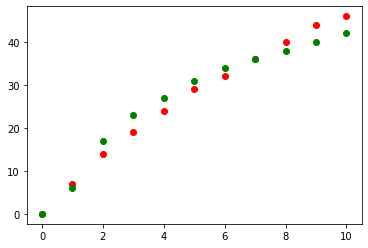

[ 24.00467596 -65.07088399   5.63108546   0.2          2.8708109
  13.87852183] 25.0


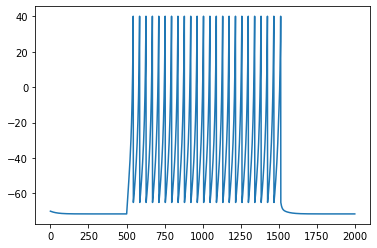

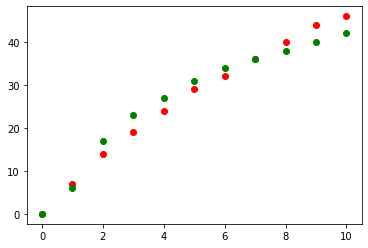

[ 24.00467596 -65.07088399   5.63108546   0.2          2.8708109
  13.87852183] 25.0


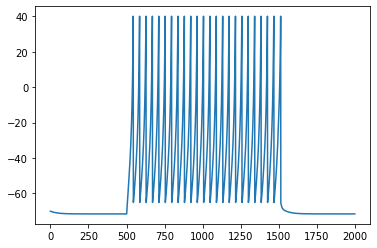

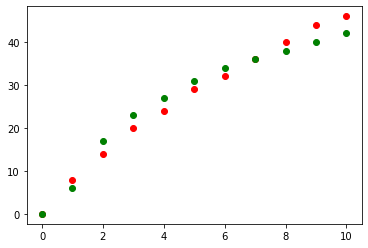

[ 24.00467596 -65.07088399   6.63108546   0.2          2.8708109
  13.87852183] 25.0


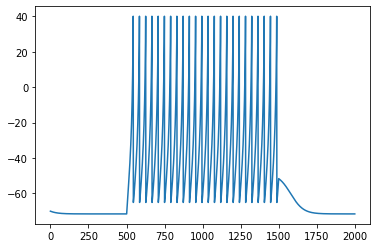

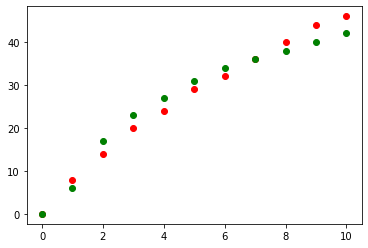

[ 24.00467596 -65.07088399   8.24911946   0.2          2.8708109
  13.87852183] 25.0


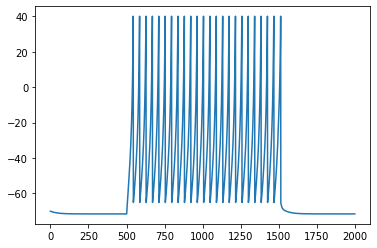

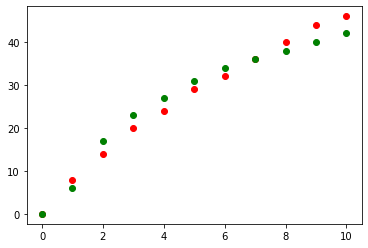

[ 24.00467596 -65.07088399   6.63108546   0.2          2.8708109
  13.87852183] 25.0


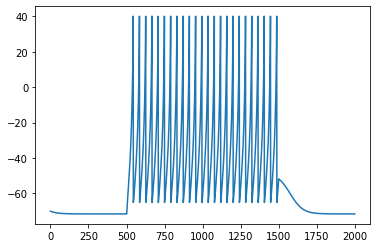

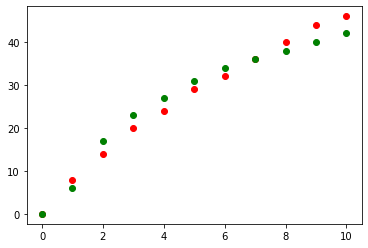

[ 24.00467596 -65.07088399   7.24911943   0.2          2.8708109
  13.87852183] 25.0


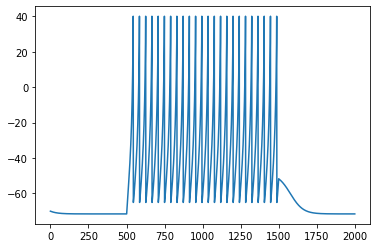

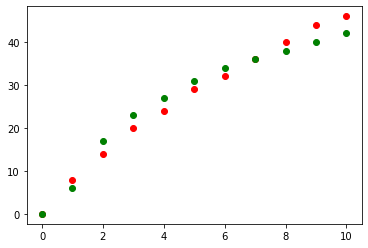

[ 24.00467596 -65.07088399   7.63108544   0.2          2.8708109
  13.87852183] 25.0


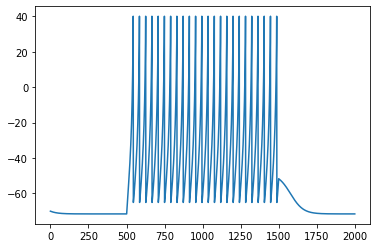

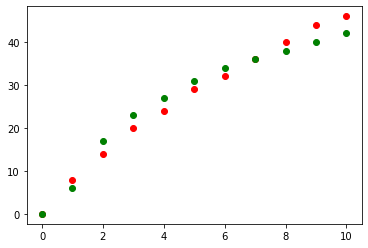

[ 24.00467596 -65.07088399   7.86715343   0.2          2.8708109
  13.87852183] 25.0


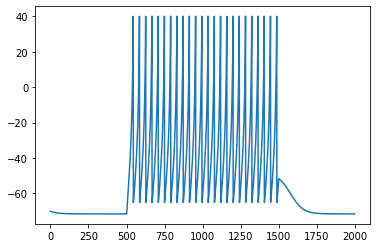

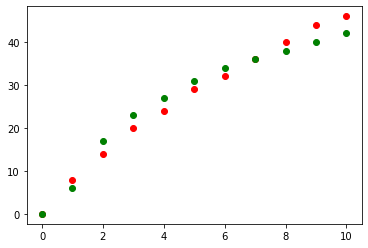

[ 24.00467596 -65.07088399   8.01305146   0.2          2.8708109
  13.87852183] 25.0


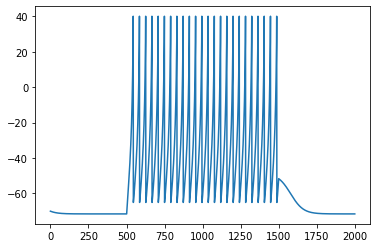

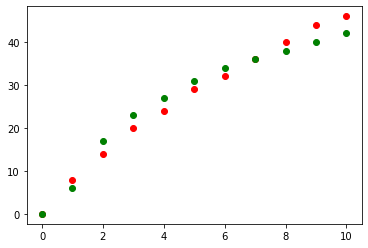

[ 24.00467596 -65.07088399   8.10322141   0.2          2.8708109
  13.87852183] 25.0


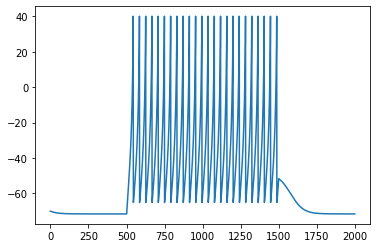

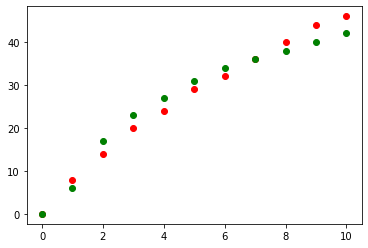

[ 24.00467596 -65.07088399   8.15894951   0.2          2.8708109
  13.87852183] 25.0


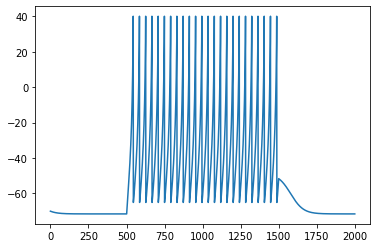

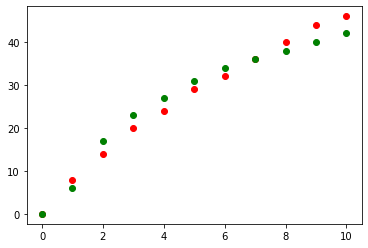

[ 24.00467596 -65.07088399   8.19339136   0.2          2.8708109
  13.87852183] 25.0


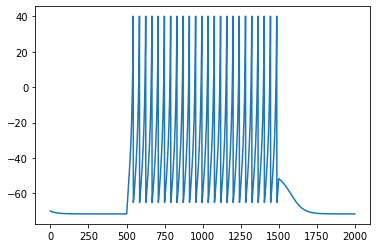

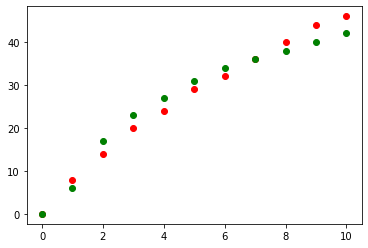

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


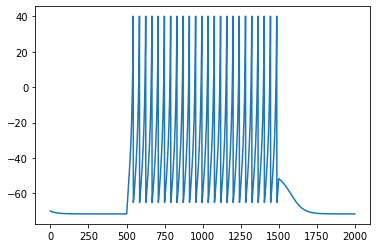

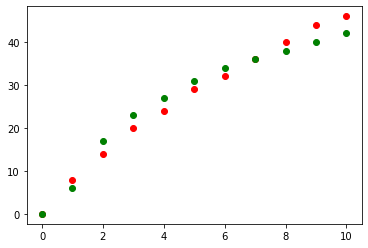

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


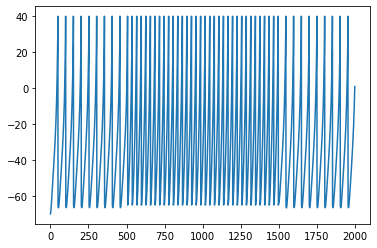

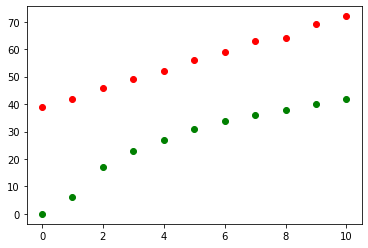

[ 24.00467596 -65.07088399   8.21901442   1.2          2.8708109
  13.87852183] 317.0


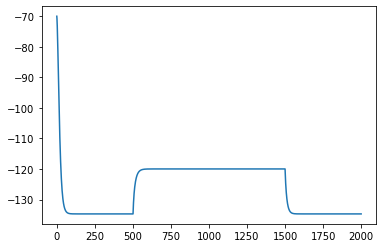

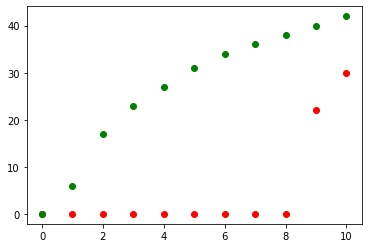

[ 24.00467596 -65.07088399   8.21901442  -1.418034     2.8708109
  13.87852183] 242.0


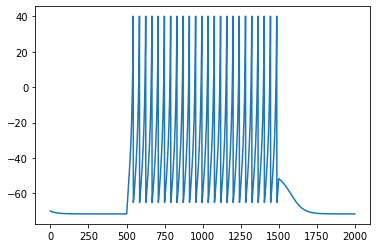

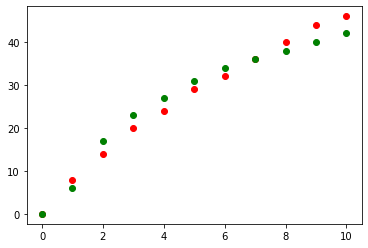

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


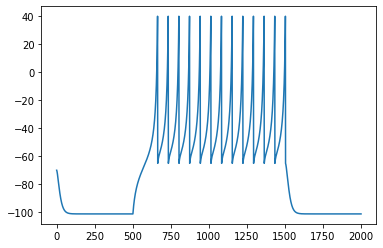

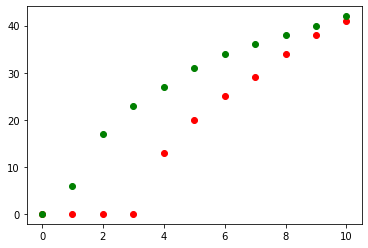

[ 24.00467596 -65.07088399   8.21901442  -0.41803397   2.8708109
  13.87852183] 94.0


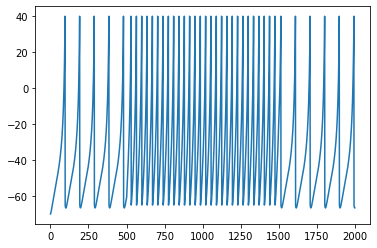

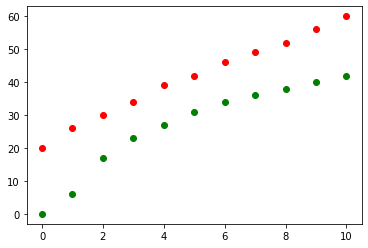

[ 24.00467596 -65.07088399   8.21901442   0.581966     2.8708109
  13.87852183] 160.0


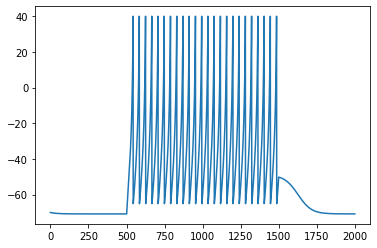

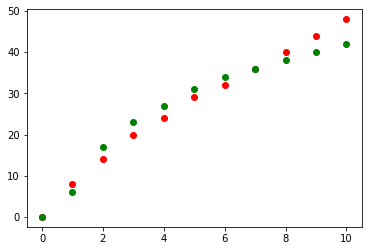

[ 24.00467596 -65.07088399   8.21901442   0.2091217    2.8708109
  13.87852183] 27.0


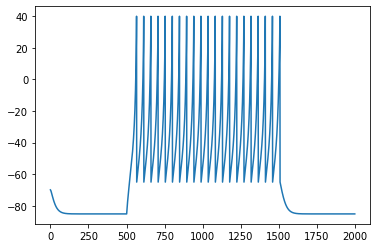

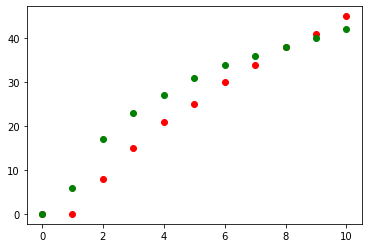

[ 2.40046760e+01 -6.50708840e+01  8.21901442e+00 -3.60679652e-02
  2.87081090e+00  1.38785218e+01] 45.0


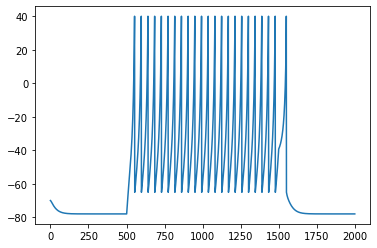

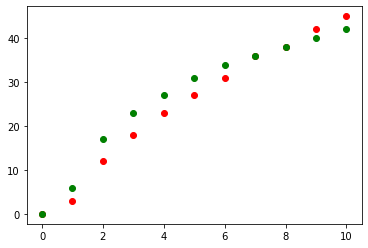

[ 24.00467596 -65.07088399   8.21901442   0.1024274    2.8708109
  13.87852183] 29.0


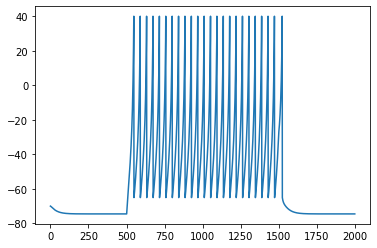

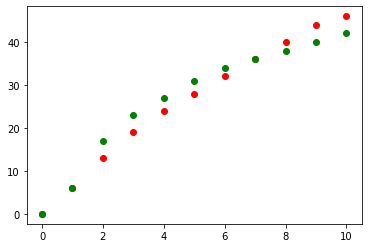

[ 24.00467596 -65.07088399   8.21901442   0.15825137   2.8708109
  13.87852183] 26.0


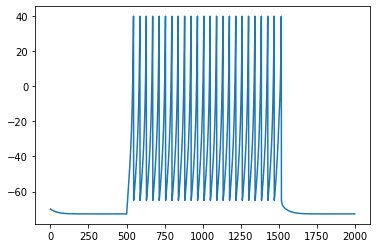

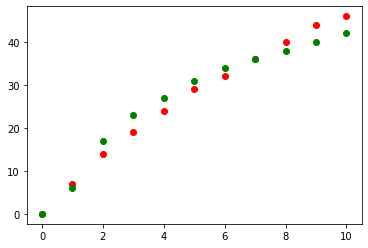

[ 24.00467596 -65.07088399   8.21901442   0.18362834   2.8708109
  13.87852183] 25.0


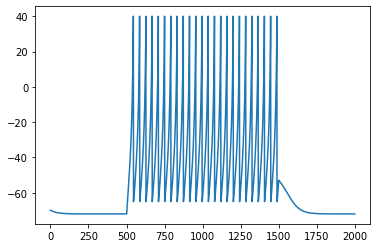

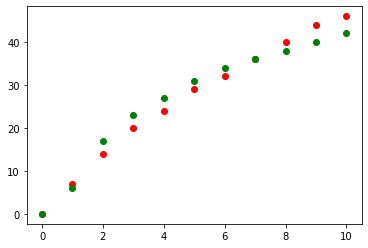

[ 24.00467596 -65.07088399   8.21901442   0.19374658   2.8708109
  13.87852183] 24.0


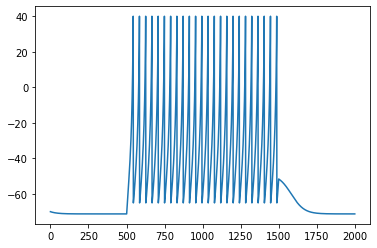

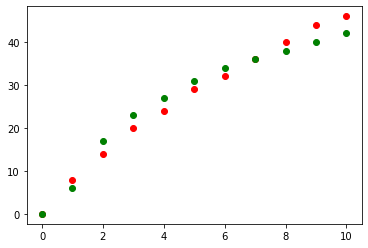

[ 24.00467596 -65.07088399   8.21901442   0.20348418   2.8708109
  13.87852183] 25.0


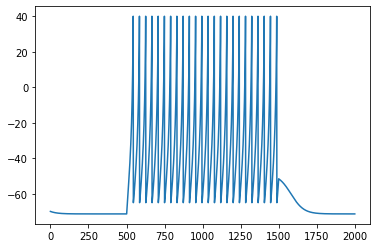

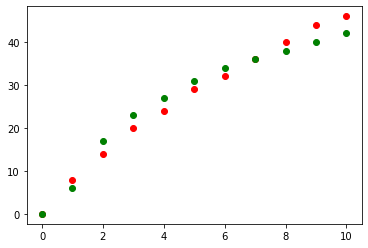

[ 24.00467596 -65.07088399   8.21901442   0.20174209   2.8708109
  13.87852183] 25.0


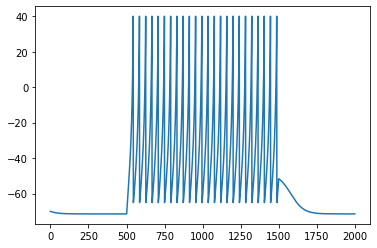

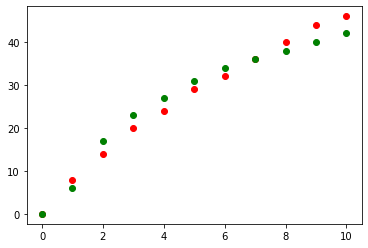

[ 24.00467596 -65.07088399   8.21901442   0.20107667   2.8708109
  13.87852183] 25.0


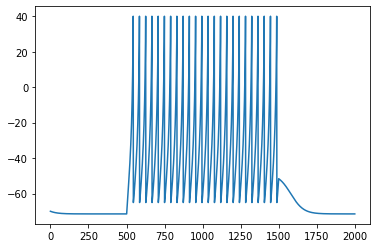

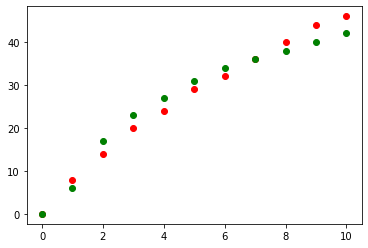

[ 24.00467596 -65.07088399   8.21901442   0.20066542   2.8708109
  13.87852183] 25.0


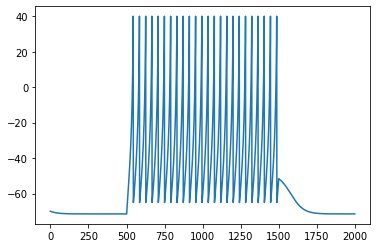

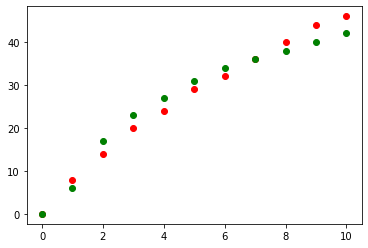

[ 24.00467596 -65.07088399   8.21901442   0.20041125   2.8708109
  13.87852183] 25.0


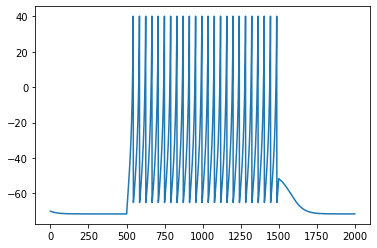

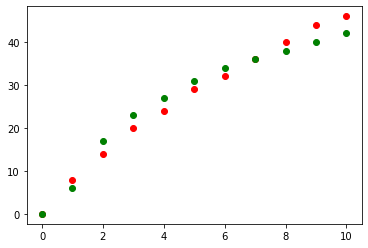

[ 24.00467596 -65.07088399   8.21901442   0.20025417   2.8708109
  13.87852183] 25.0


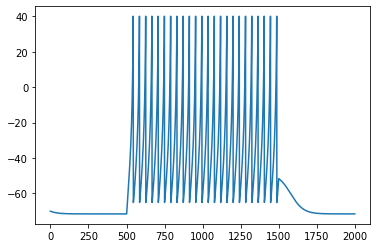

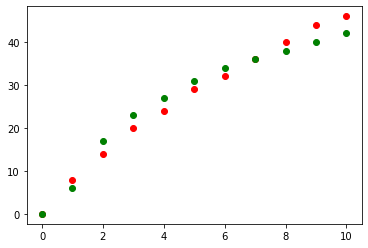

[ 24.00467596 -65.07088399   8.21901442   0.20015708   2.8708109
  13.87852183] 25.0


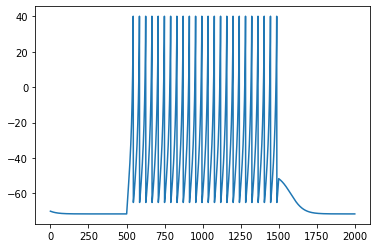

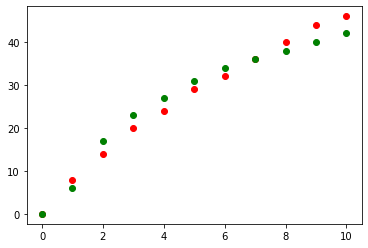

[ 24.00467596 -65.07088399   8.21901442   0.20009708   2.8708109
  13.87852183] 25.0


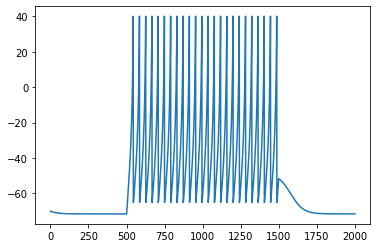

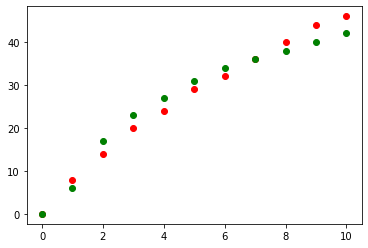

[ 24.00467596 -65.07088399   8.21901442   0.20006      2.8708109
  13.87852183] 25.0


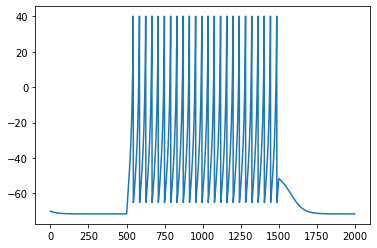

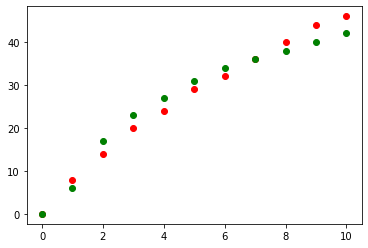

[ 24.00467596 -65.07088399   8.21901442   0.20003708   2.8708109
  13.87852183] 25.0


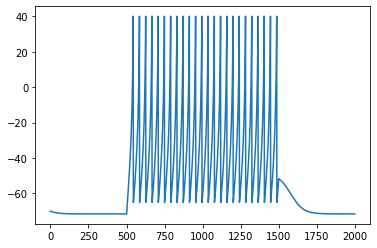

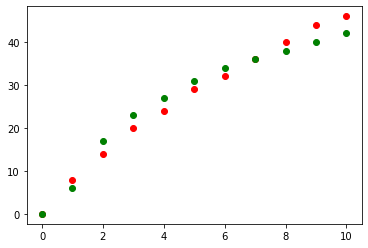

[ 24.00467596 -65.07088399   8.21901442   0.20002292   2.8708109
  13.87852183] 25.0


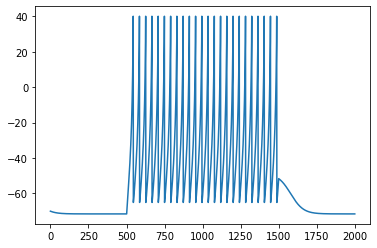

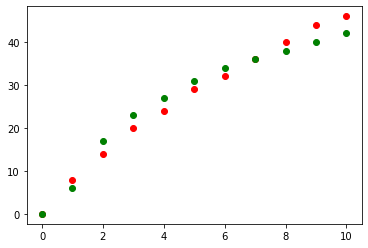

[ 24.00467596 -65.07088399   8.21901442   0.20001416   2.8708109
  13.87852183] 25.0


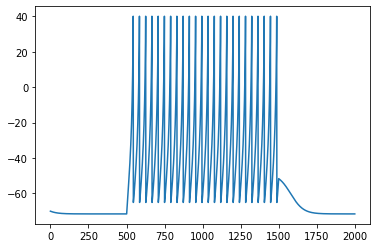

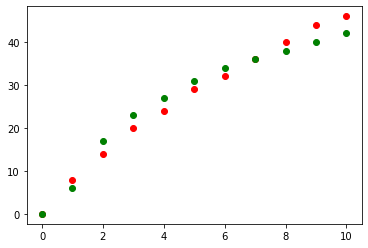

[ 24.00467596 -65.07088399   8.21901442   0.20000875   2.8708109
  13.87852183] 25.0


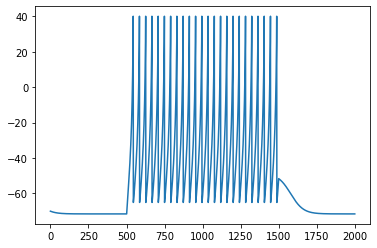

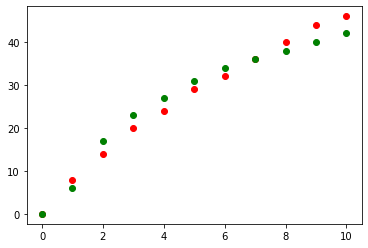

[ 24.00467596 -65.07088399   8.21901442   0.20000541   2.8708109
  13.87852183] 25.0


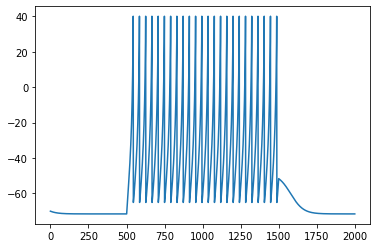

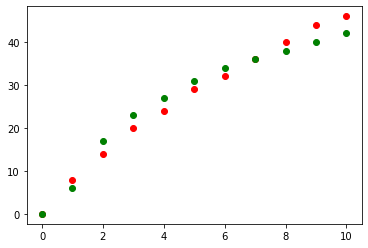

[ 24.00467596 -65.07088399   8.21901442   0.20000334   2.8708109
  13.87852183] 25.0


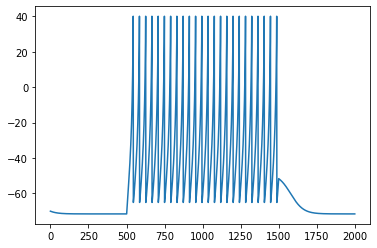

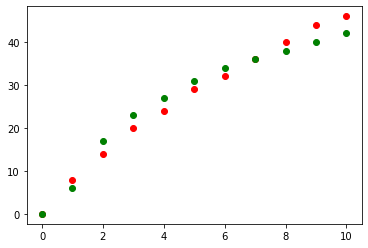

[ 24.00467596 -65.07088399   8.21901442   0.20000207   2.8708109
  13.87852183] 25.0


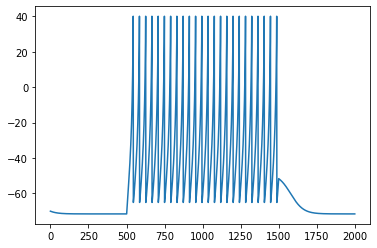

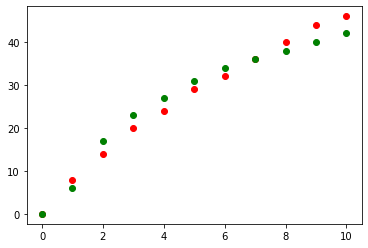

[ 24.00467596 -65.07088399   8.21901442   0.20000128   2.8708109
  13.87852183] 25.0


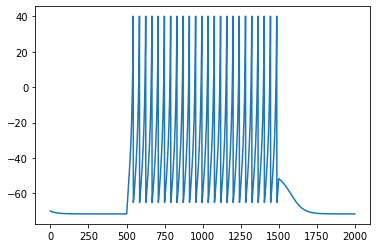

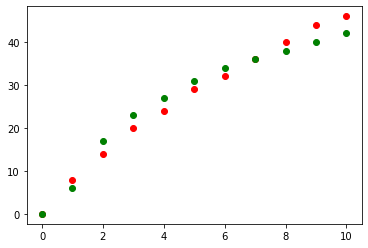

[ 24.00467596 -65.07088399   8.21901442   0.20000079   2.8708109
  13.87852183] 25.0


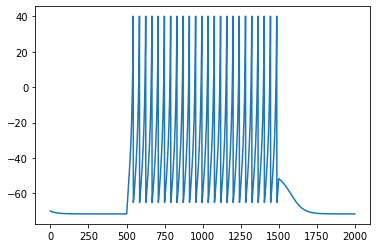

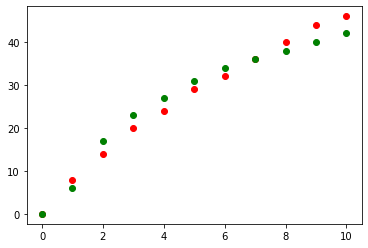

[ 24.00467596 -65.07088399   8.21901442   0.20000049   2.8708109
  13.87852183] 25.0


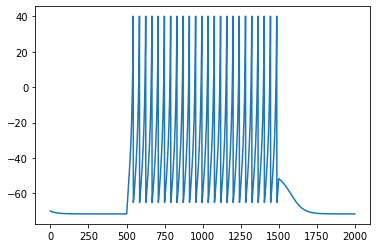

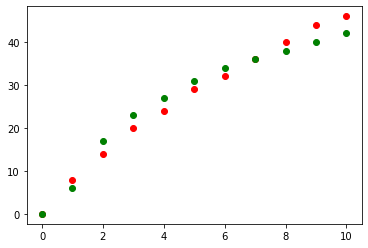

[ 24.00467596 -65.07088399   8.21901442   0.2000003    2.8708109
  13.87852183] 25.0


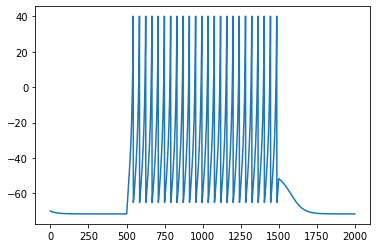

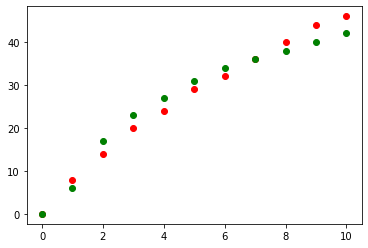

[ 24.00467596 -65.07088399   8.21901442   0.20000019   2.8708109
  13.87852183] 25.0


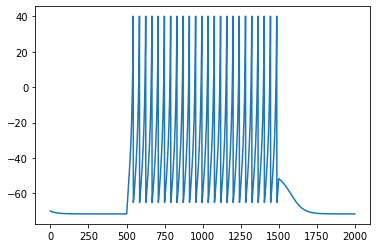

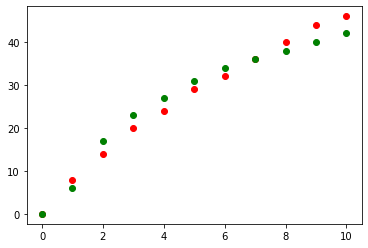

[ 24.00467596 -65.07088399   8.21901442   0.20000012   2.8708109
  13.87852183] 25.0


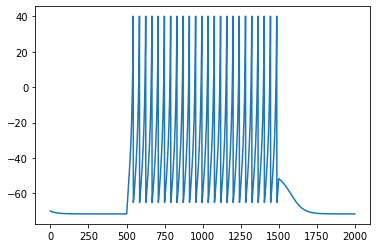

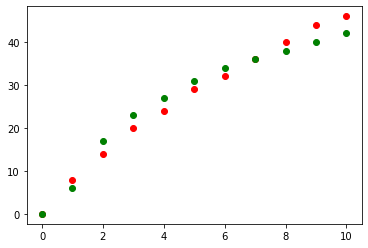

[ 24.00467596 -65.07088399   8.21901442   0.20000007   2.8708109
  13.87852183] 25.0


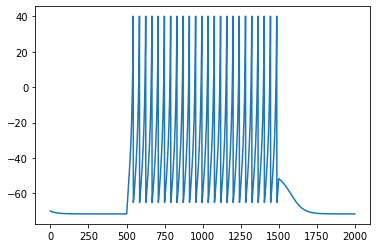

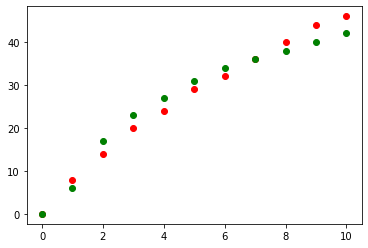

[ 24.00467596 -65.07088399   8.21901442   0.20000004   2.8708109
  13.87852183] 25.0


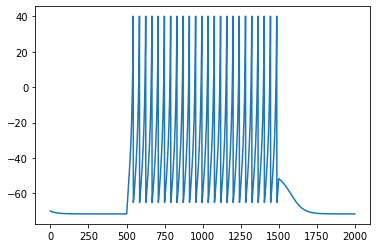

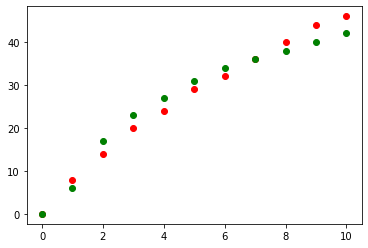

[ 24.00467596 -65.07088399   8.21901442   0.20000003   2.8708109
  13.87852183] 25.0


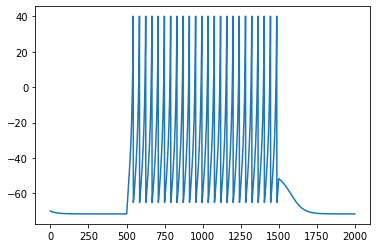

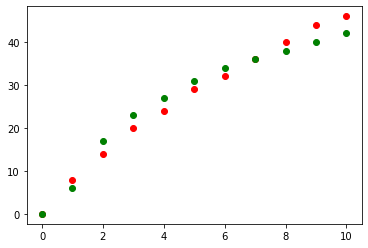

[ 24.00467596 -65.07088399   8.21901442   0.20000002   2.8708109
  13.87852183] 25.0


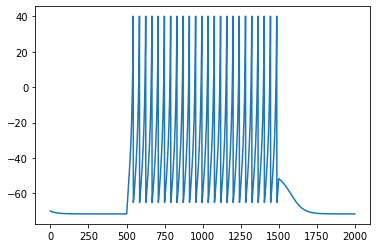

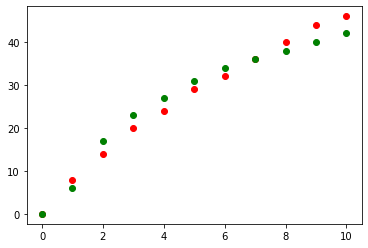

[ 24.00467596 -65.07088399   8.21901442   0.20000001   2.8708109
  13.87852183] 25.0


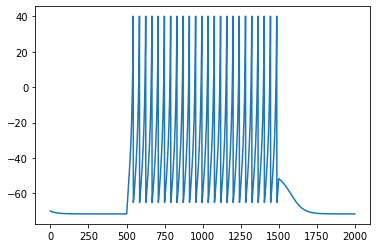

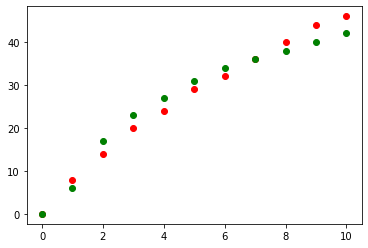

[ 24.00467596 -65.07088399   8.21901442   0.20000001   2.8708109
  13.87852183] 25.0


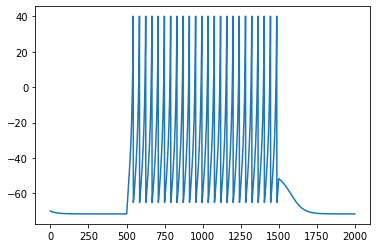

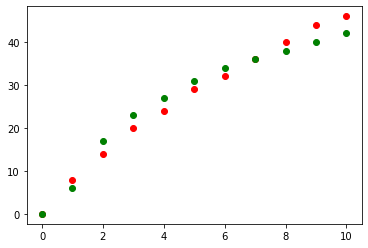

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


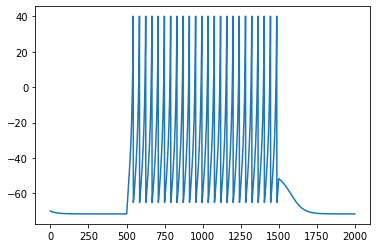

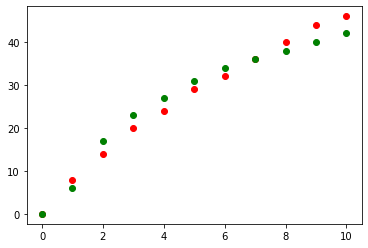

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


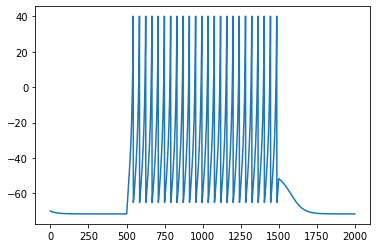

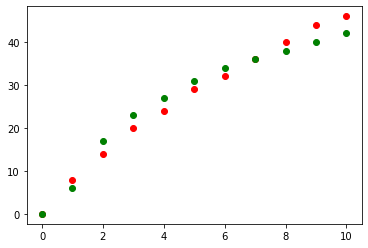

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


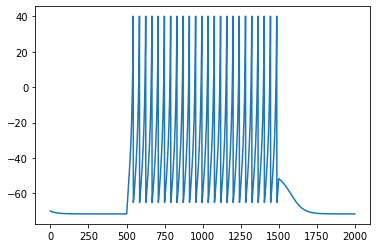

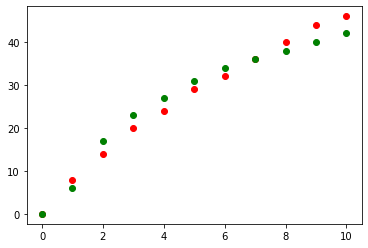

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


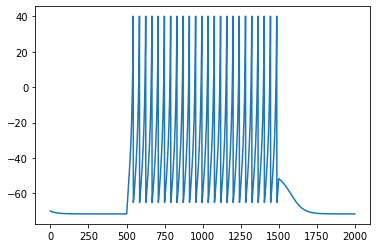

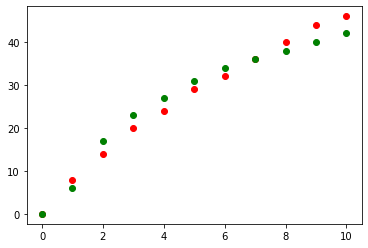

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


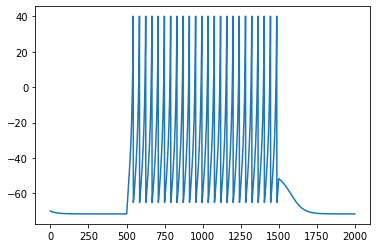

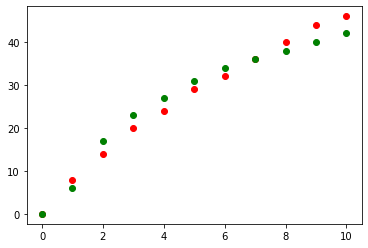

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


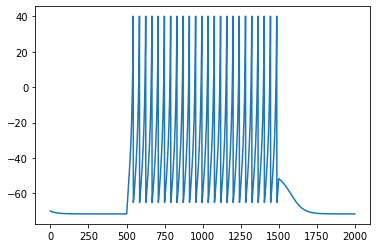

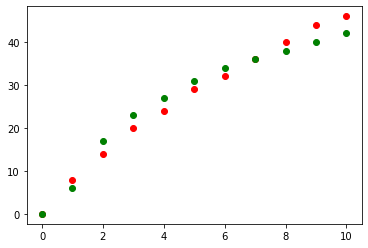

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


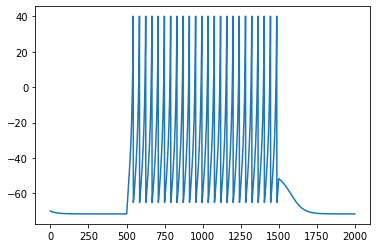

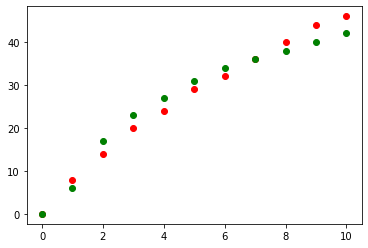

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


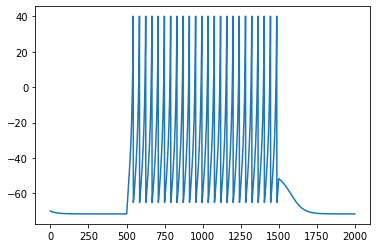

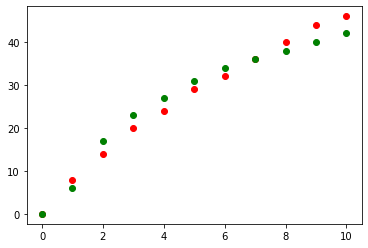

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


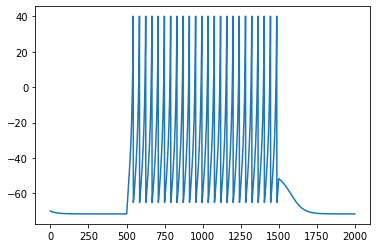

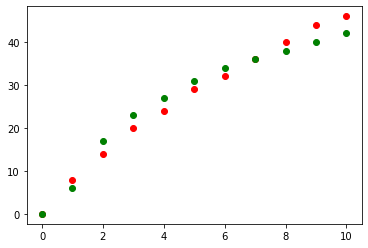

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


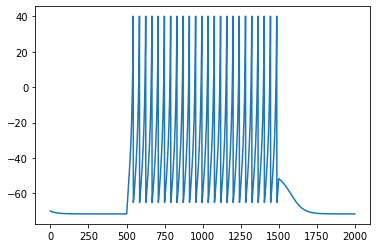

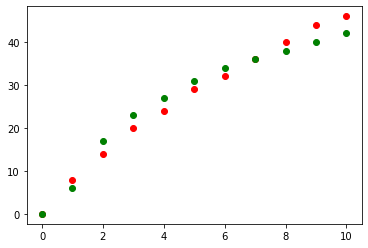

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


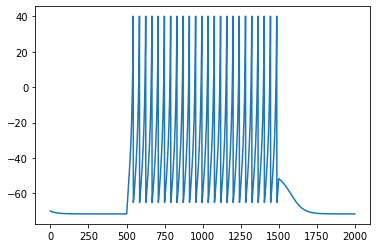

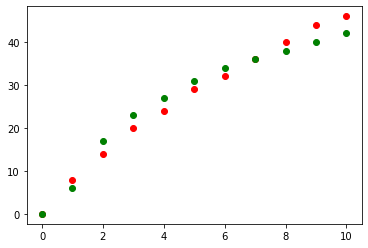

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


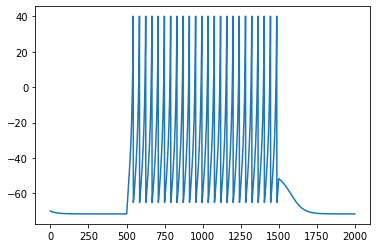

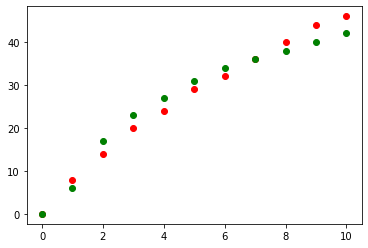

[ 24.00467596 -65.07088399   8.21901442   0.2          2.8708109
  13.87852183] 25.0


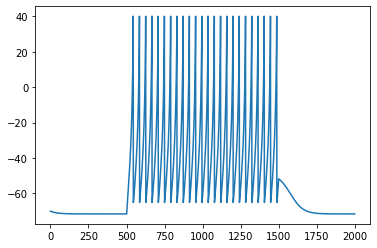

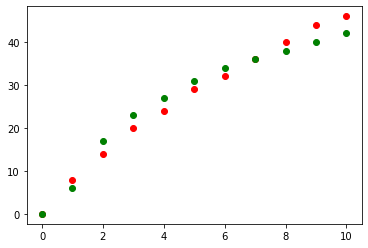

[ 24.00467596 -65.07088399   8.21901442   0.2          3.8708109
  13.87852183] 25.0


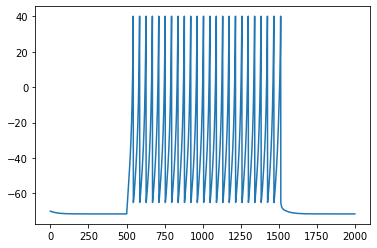

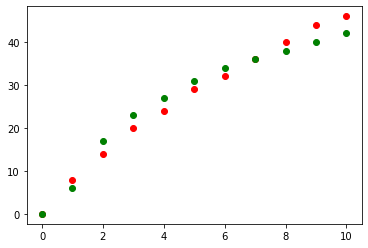

[ 24.00467596 -65.07088399   8.21901442   0.2          5.4888449
  13.87852183] 25.0


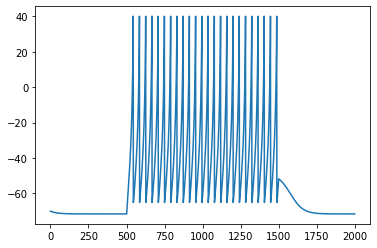

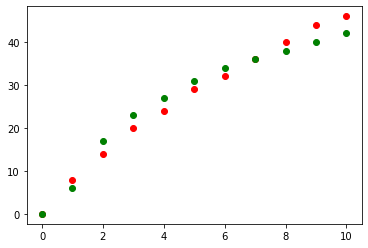

[ 24.00467596 -65.07088399   8.21901442   0.2          3.8708109
  13.87852183] 25.0


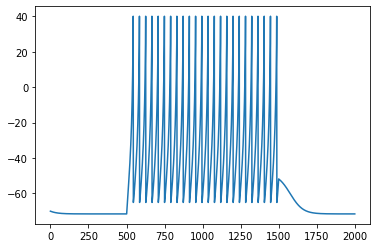

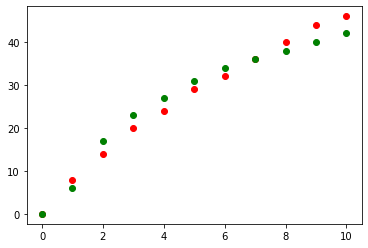

[ 24.00467596 -65.07088399   8.21901442   0.2          4.48884487
  13.87852183] 25.0


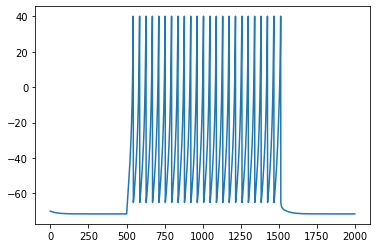

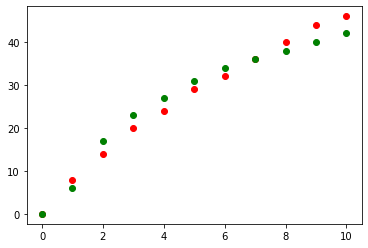

[ 24.00467596 -65.07088399   8.21901442   0.2          4.87081088
  13.87852183] 25.0


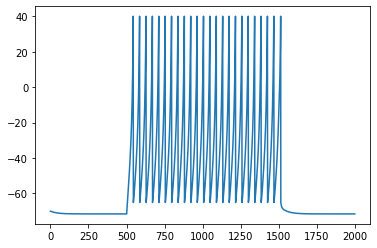

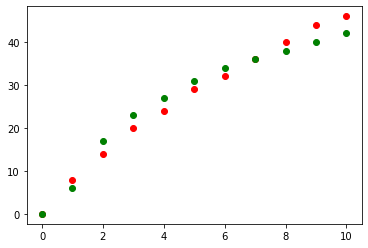

[ 24.00467596 -65.07088399   8.21901442   0.2          5.10687887
  13.87852183] 25.0


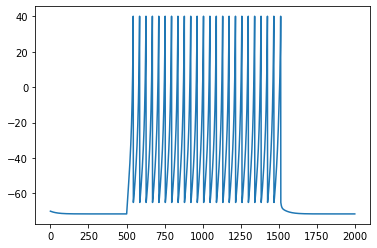

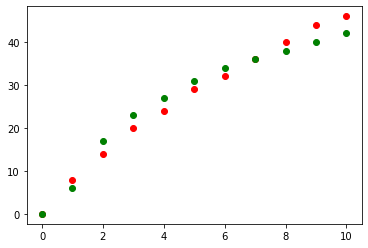

[ 24.00467596 -65.07088399   8.21901442   0.2          5.2527769
  13.87852183] 25.0


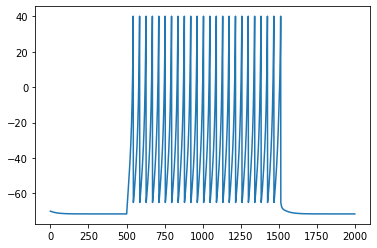

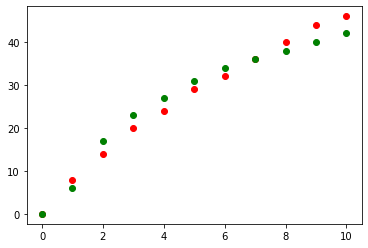

[ 24.00467596 -65.07088399   8.21901442   0.2          5.34294685
  13.87852183] 25.0


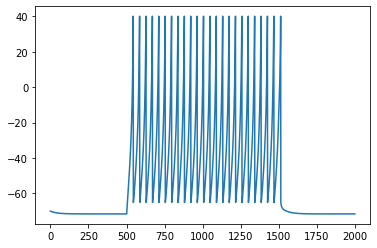

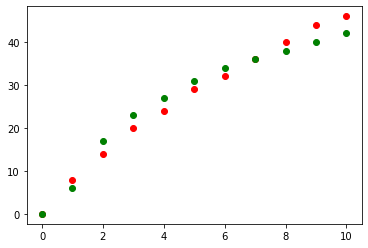

[ 24.00467596 -65.07088399   8.21901442   0.2          5.39867495
  13.87852183] 25.0


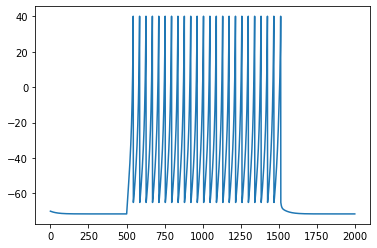

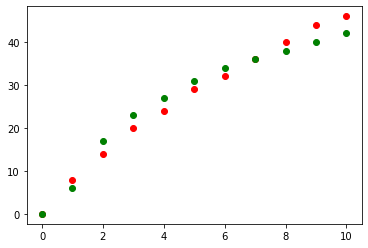

[ 24.00467596 -65.07088399   8.21901442   0.2          5.4331168
  13.87852183] 25.0


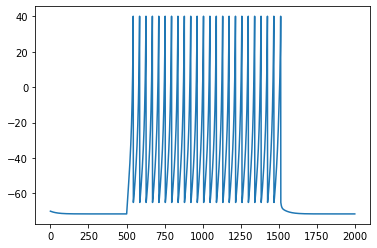

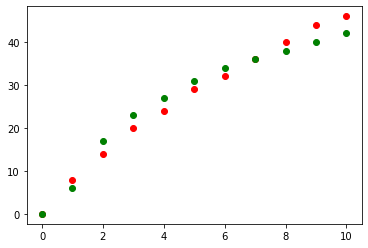

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


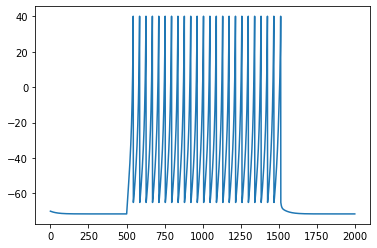

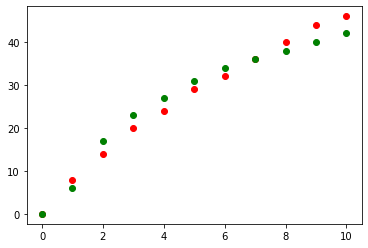

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


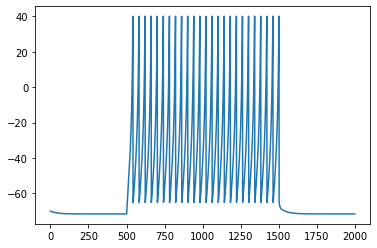

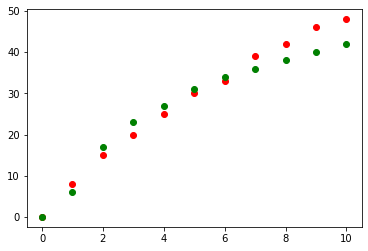

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  14.87852183] 30.0


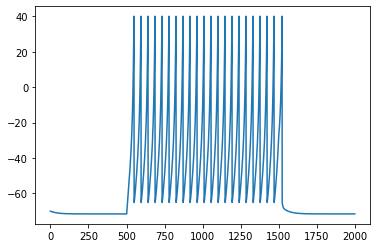

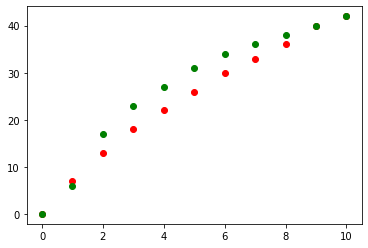

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  12.26048783] 29.0


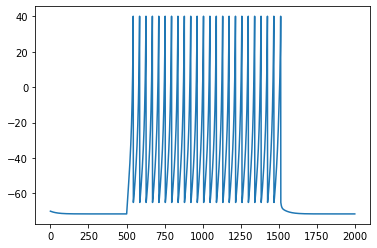

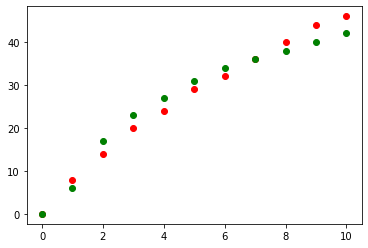

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


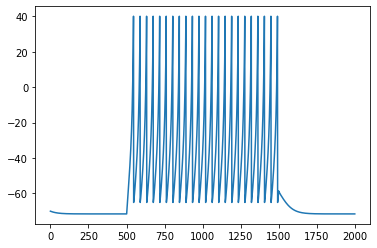

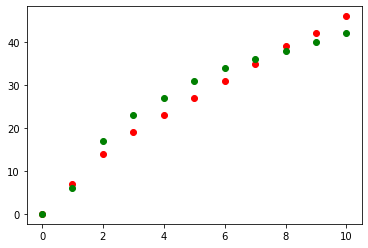

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.26048785] 27.0


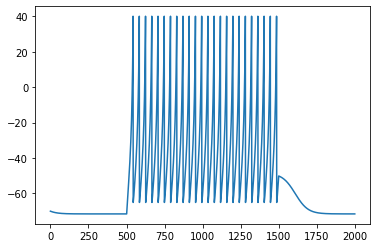

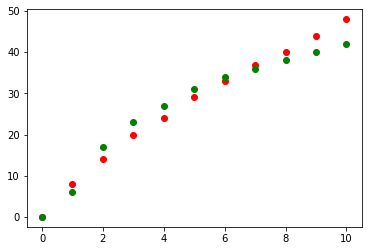

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  14.26048783] 27.0


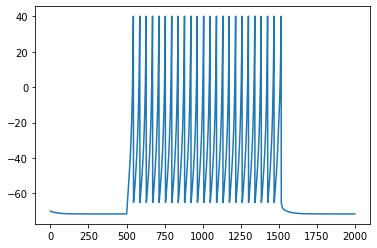

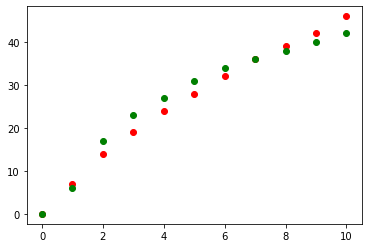

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.6973131 ] 23.0


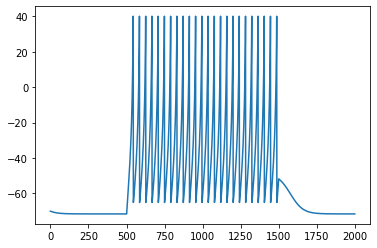

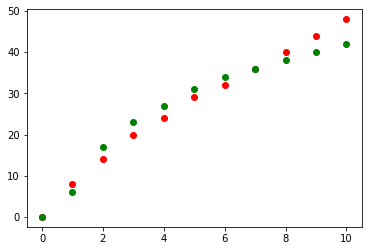

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  14.02441985] 27.0


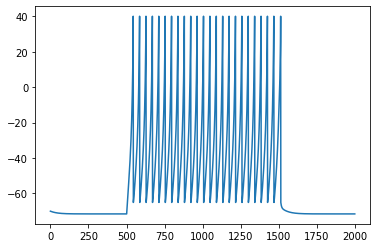

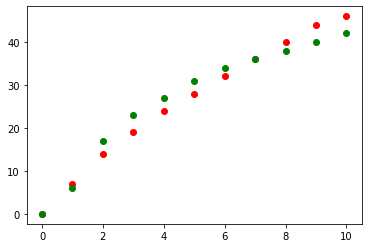

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.80930626] 26.0


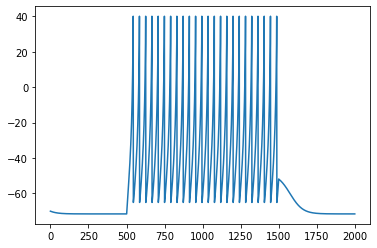

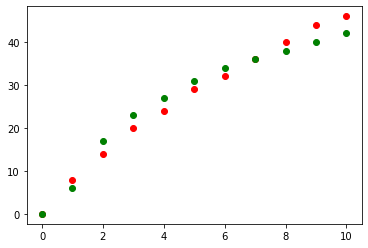

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.93424991] 25.0


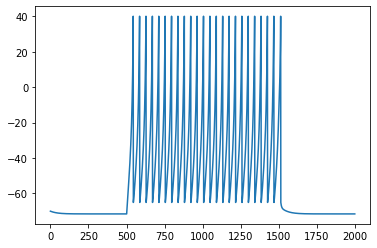

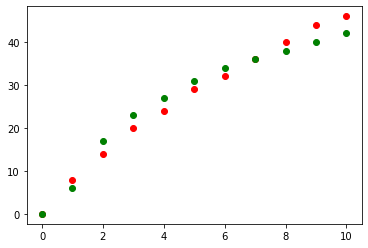

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.90638587] 25.0


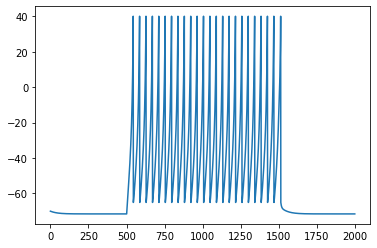

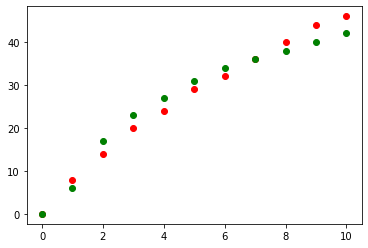

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.89574275] 25.0


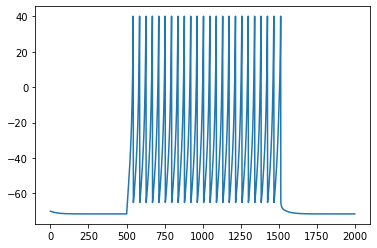

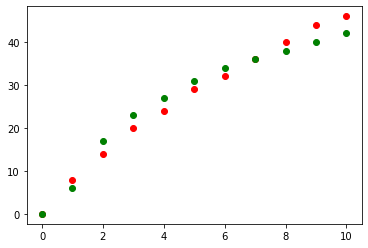

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.88916495] 25.0


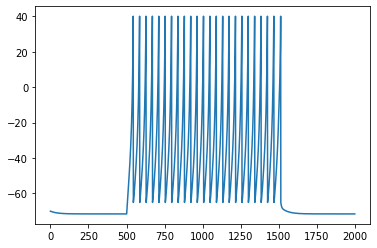

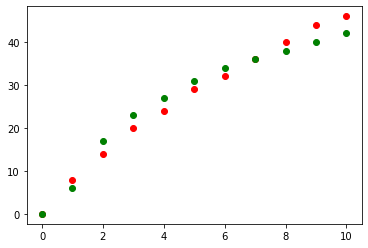

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.88509964] 25.0


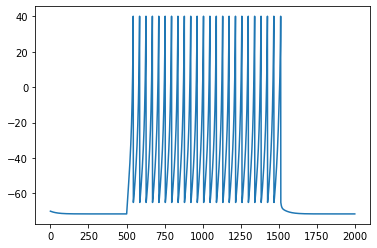

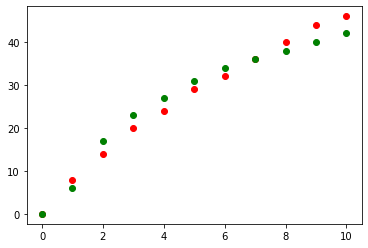

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.88258714] 25.0


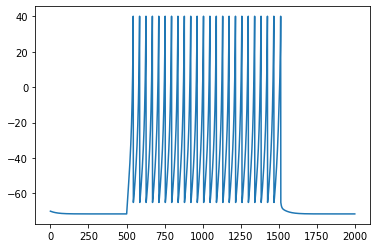

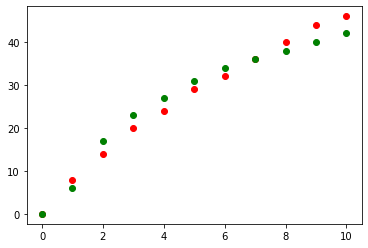

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.88103433] 25.0


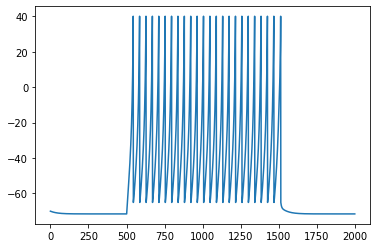

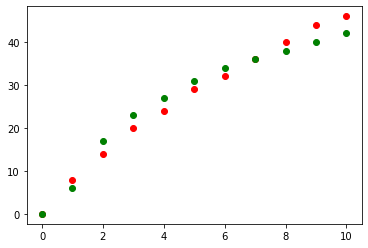

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.88007464] 25.0


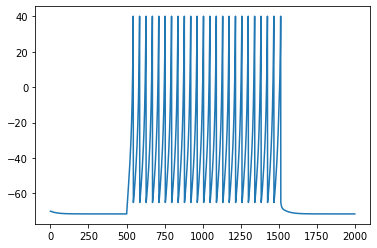

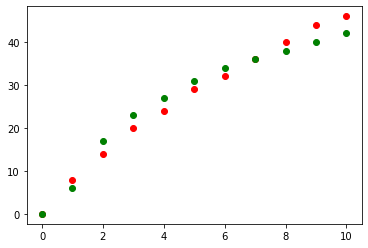

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87948152] 25.0


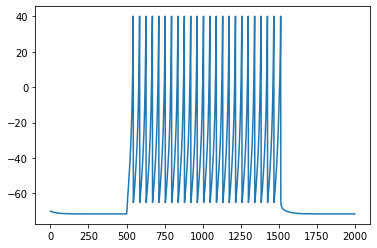

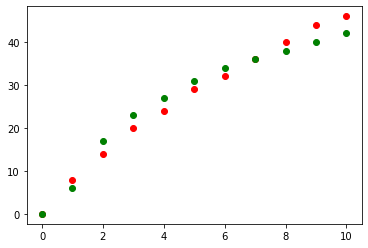

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87911495] 25.0


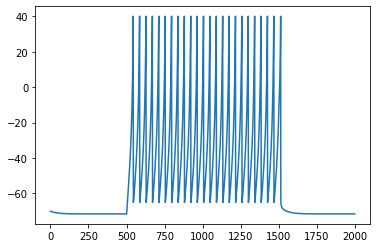

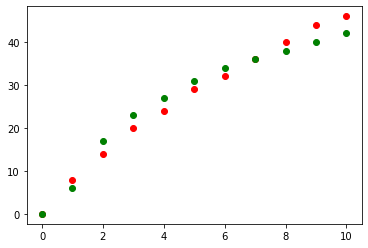

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.8788884 ] 25.0


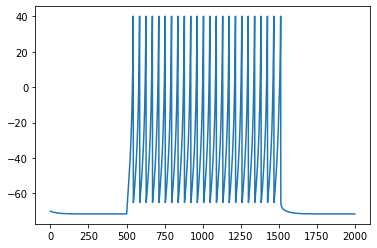

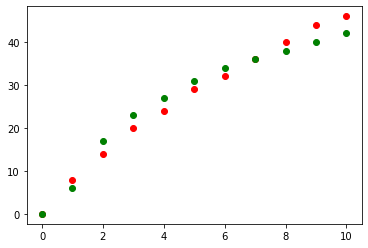

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87874838] 25.0


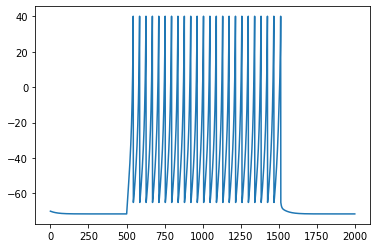

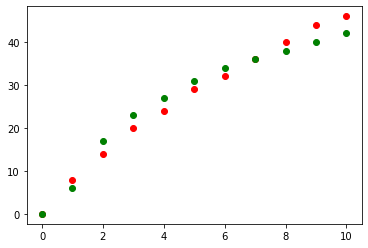

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87866185] 25.0


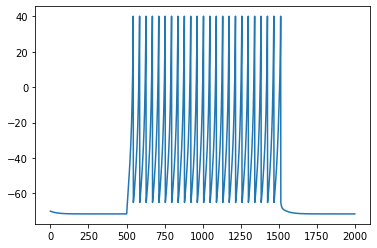

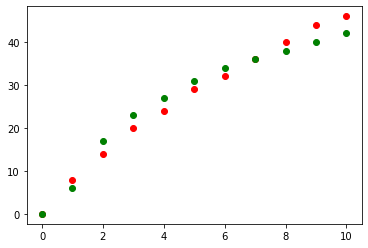

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87860836] 25.0


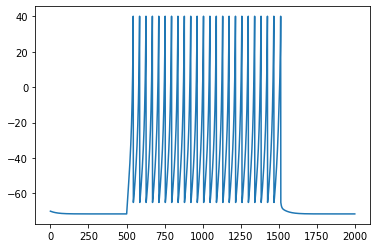

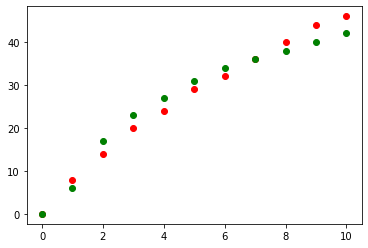

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87857531] 25.0


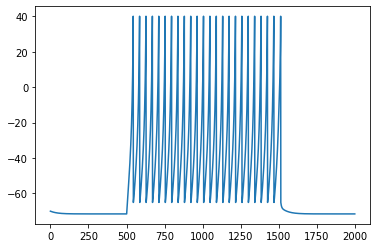

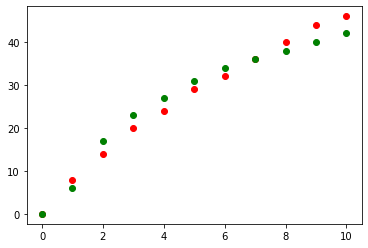

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87855488] 25.0


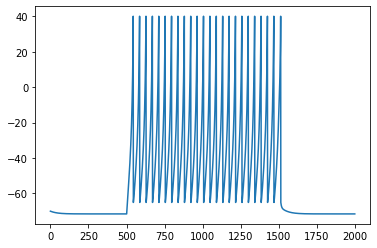

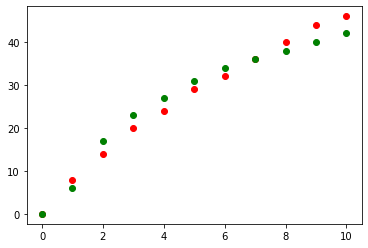

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87854226] 25.0


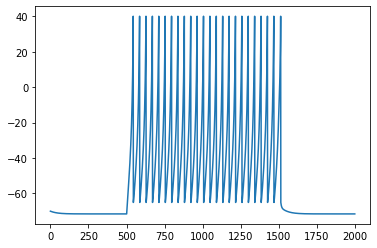

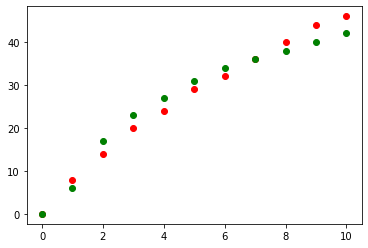

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87853445] 25.0


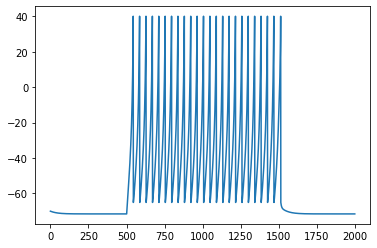

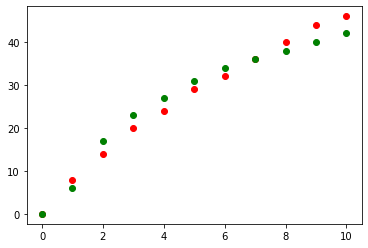

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852963] 25.0


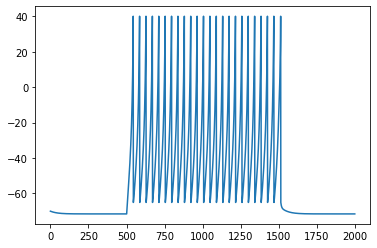

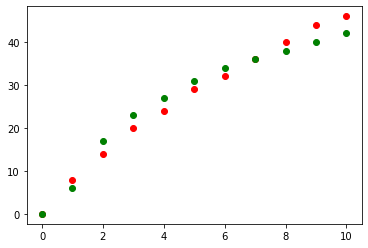

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852665] 25.0


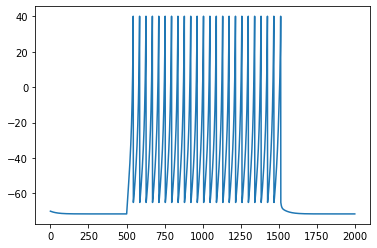

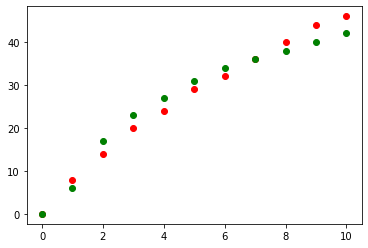

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852481] 25.0


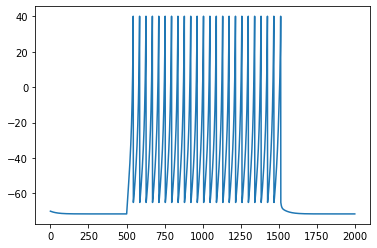

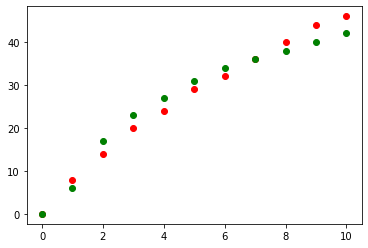

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852367] 25.0


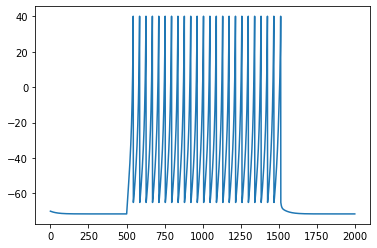

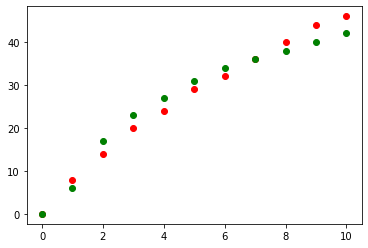

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852297] 25.0


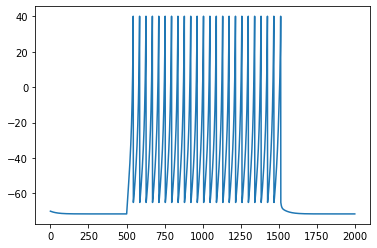

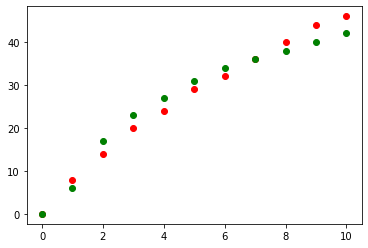

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852253] 25.0


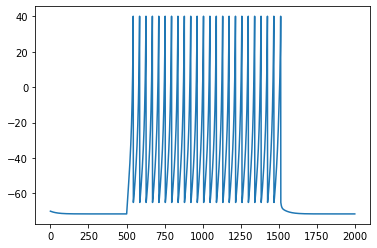

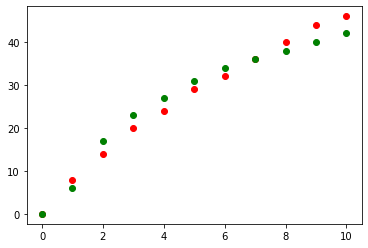

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852226] 25.0


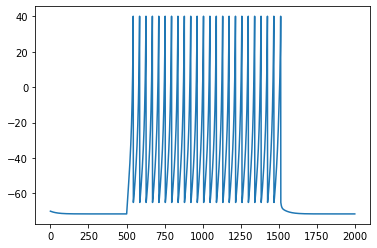

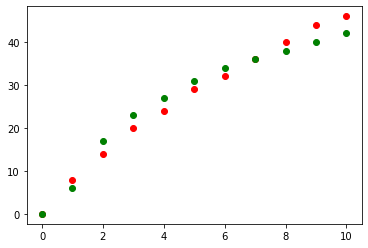

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.8785221 ] 25.0


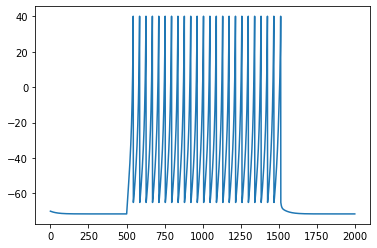

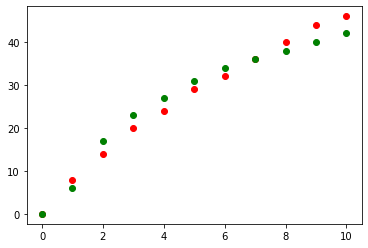

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.878522  ] 25.0


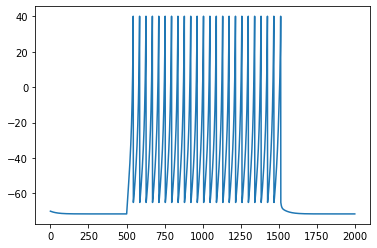

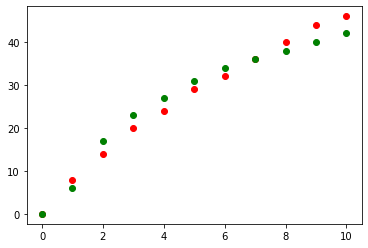

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852193] 25.0


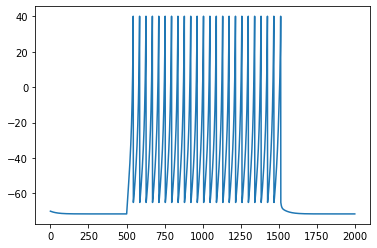

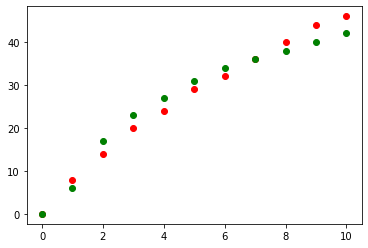

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852189] 25.0


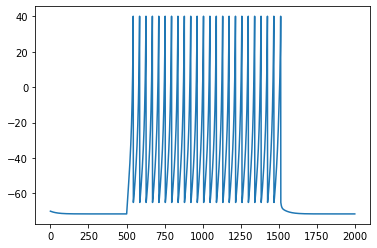

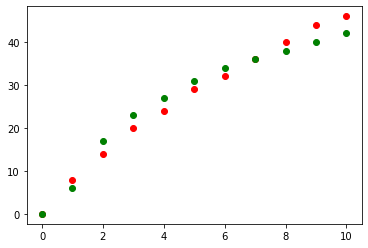

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852187] 25.0


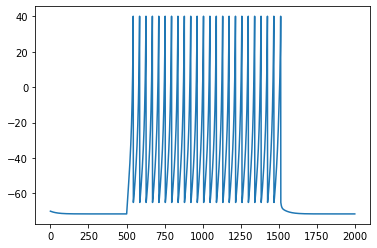

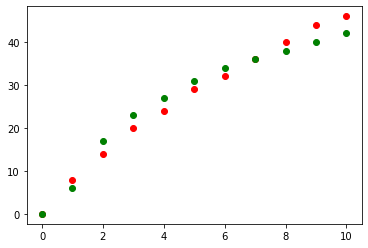

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852185] 25.0


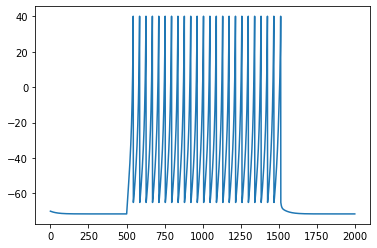

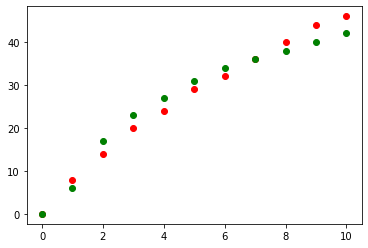

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852184] 25.0


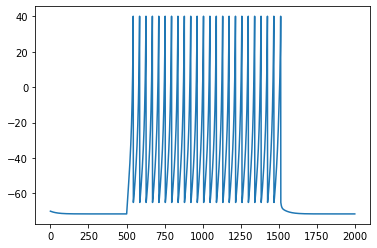

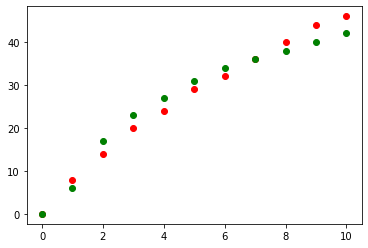

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852184] 25.0


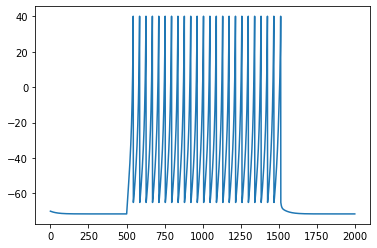

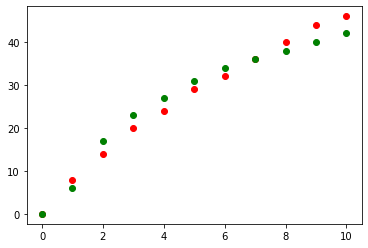

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


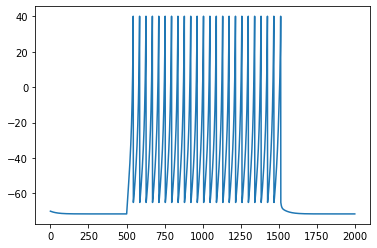

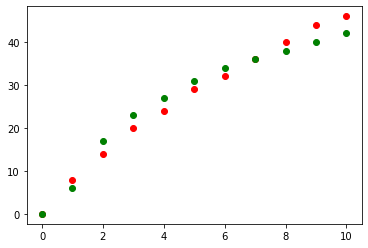

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


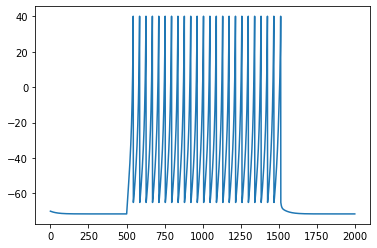

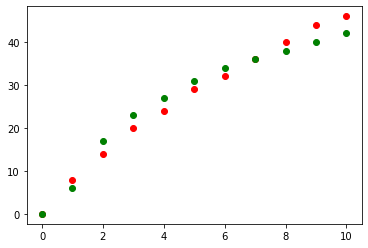

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


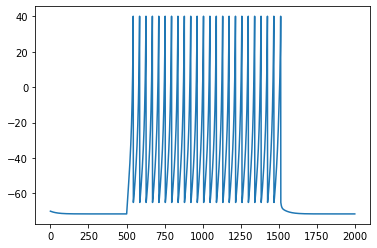

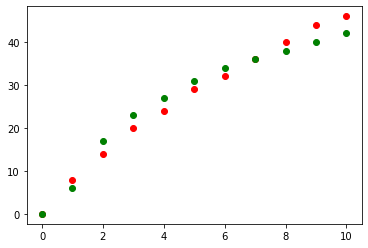

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


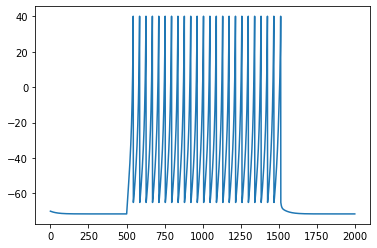

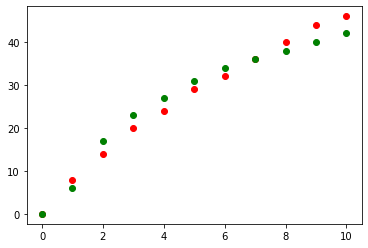

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


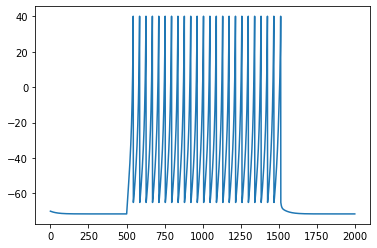

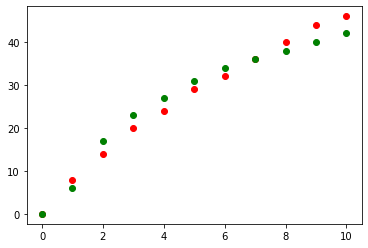

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


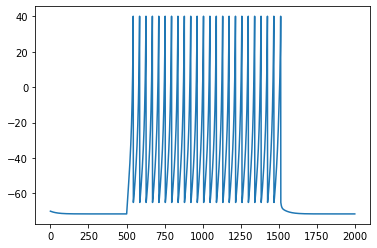

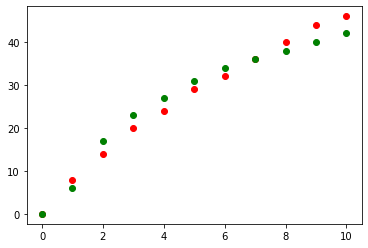

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


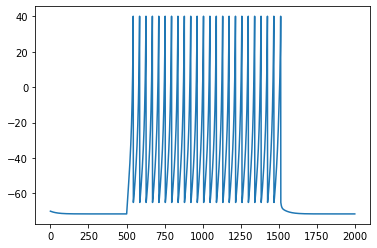

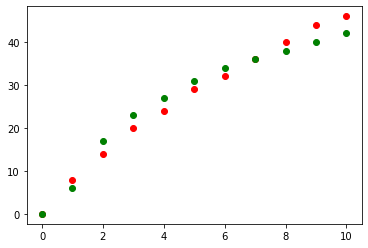

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


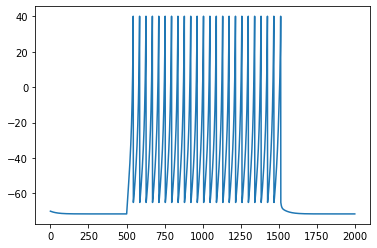

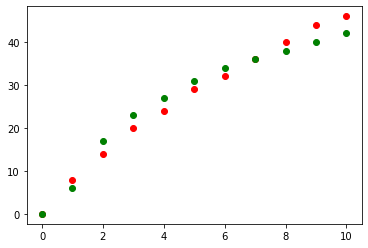

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


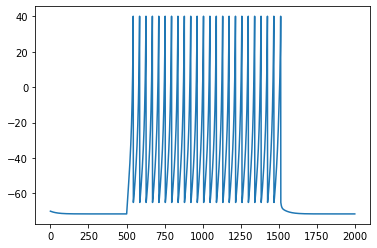

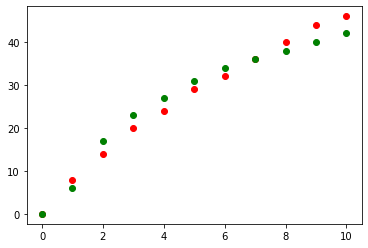

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


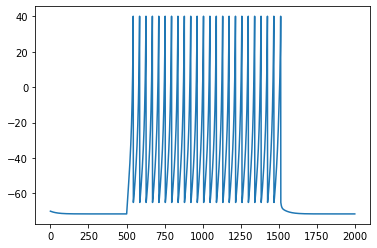

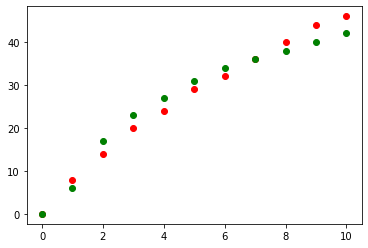

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


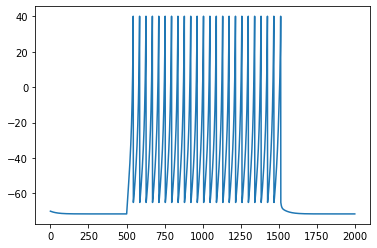

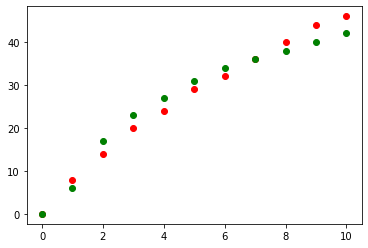

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


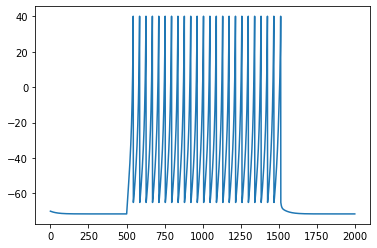

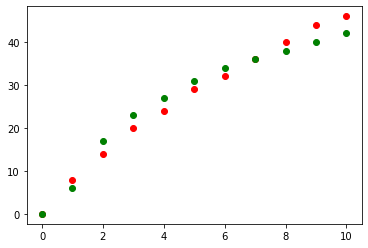

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


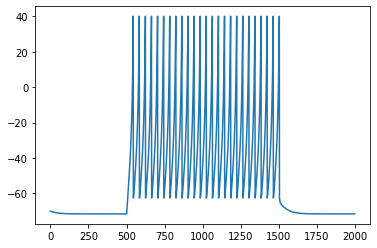

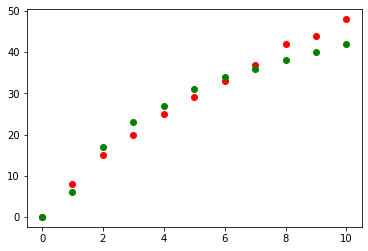

[ 24.63335308 -62.55940607  10.80694338   0.2          8.04666882
  13.87852183] 27.0


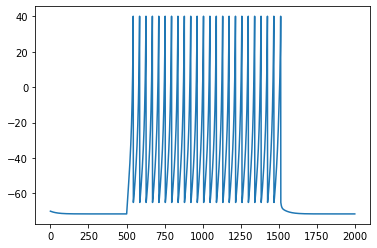

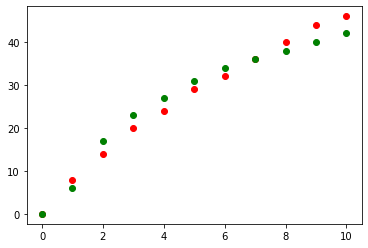

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


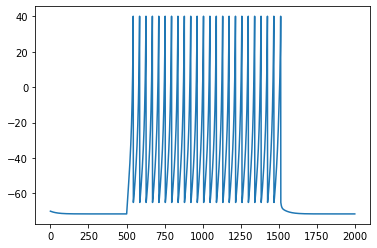

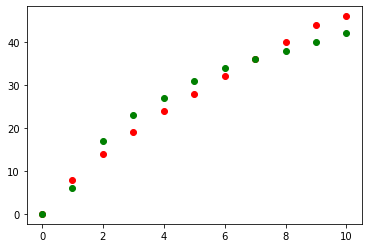

[ 25.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 27.0


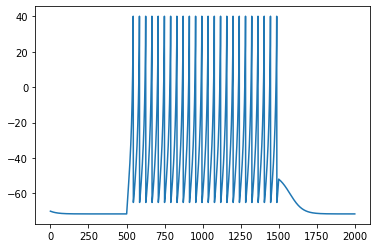

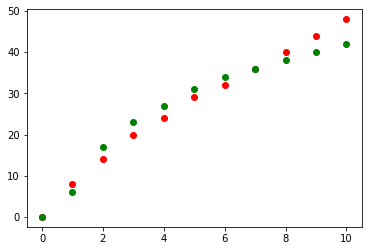

[ 22.38664196 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 27.0


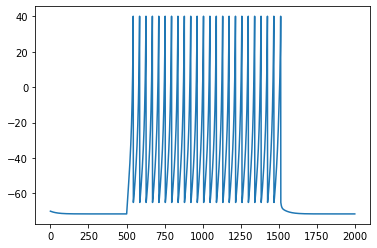

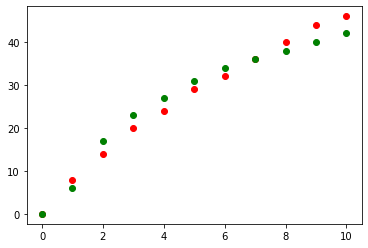

[ 24.00467596 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


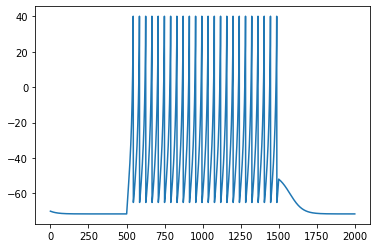

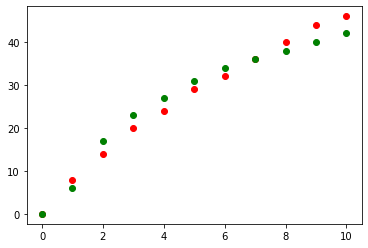

[ 23.38664198 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


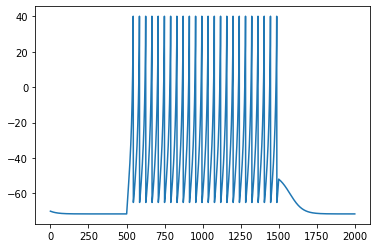

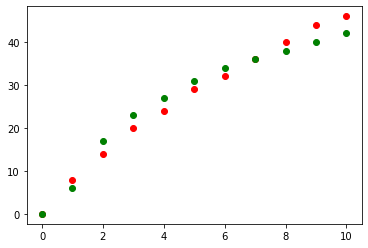

[ 23.00467597 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


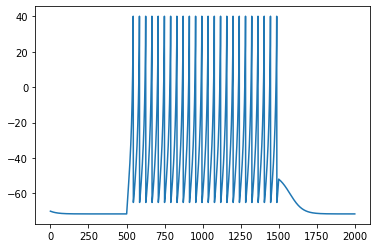

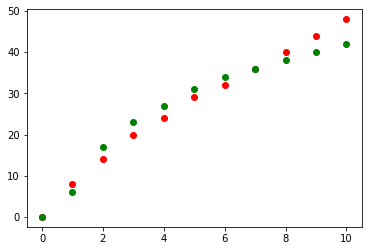

[ 22.76860799 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 27.0


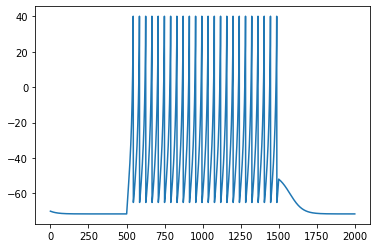

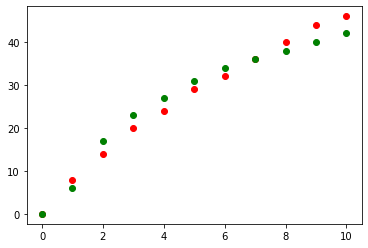

[ 23.150574   -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


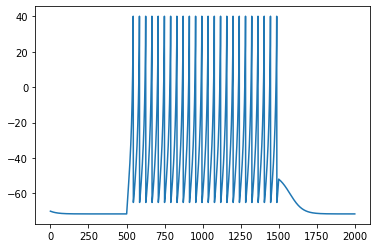

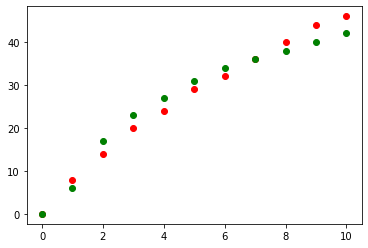

[ 23.24074395 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


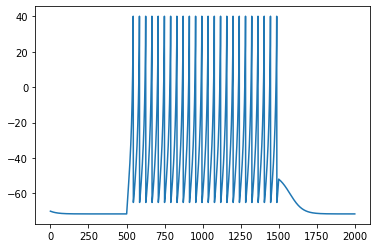

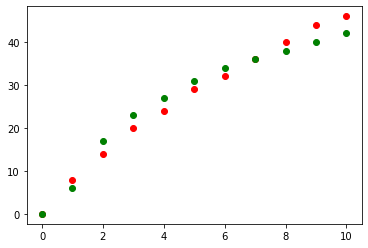

[ 23.29647204 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


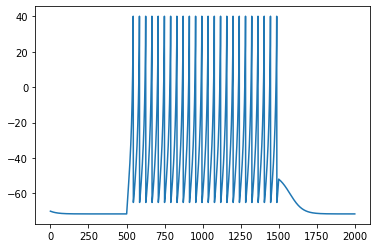

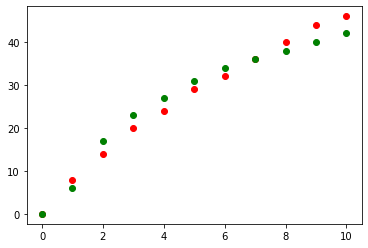

[ 23.33091389 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


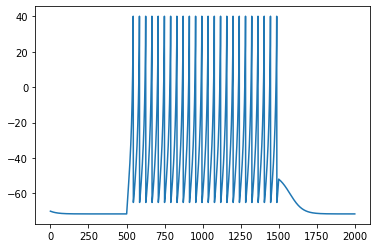

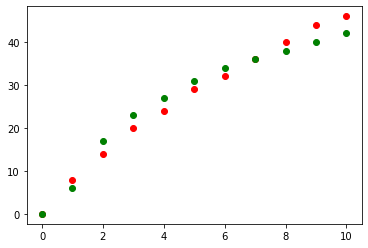

[ 23.35220013 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


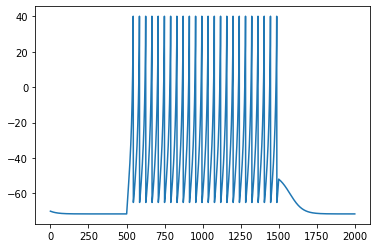

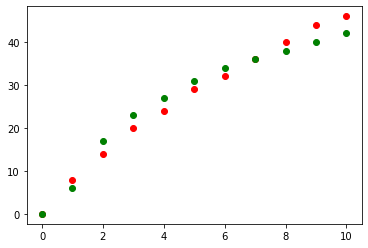

[ 23.36535575 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


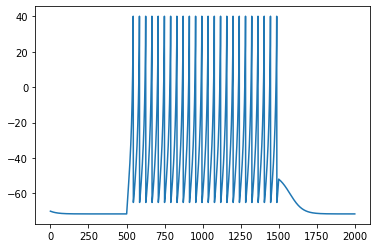

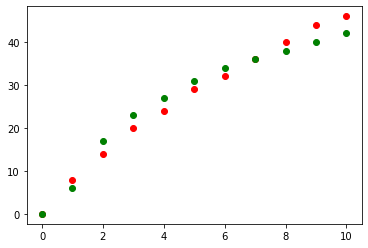

[ 23.37348637 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


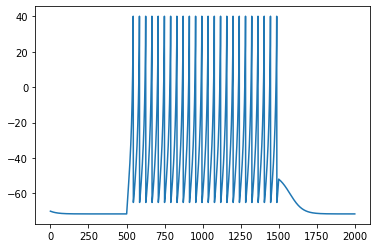

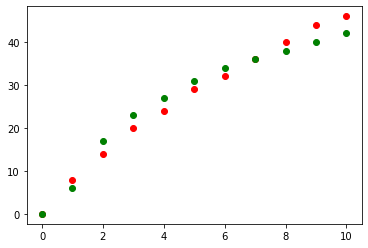

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


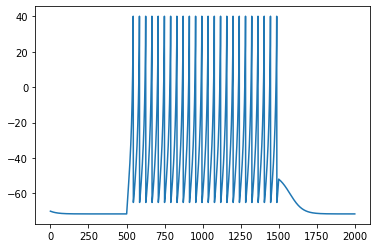

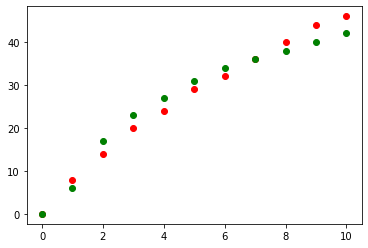

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


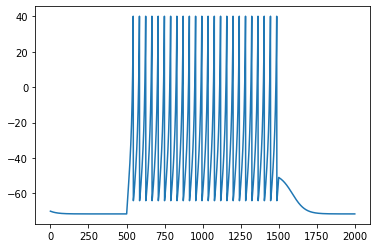

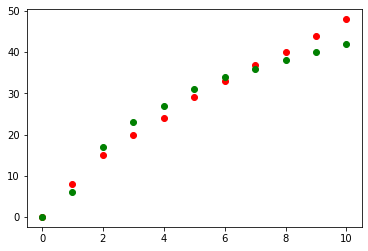

[ 23.37979826 -64.07088399   8.21901442   0.2          5.45873986
  13.87852183] 26.0


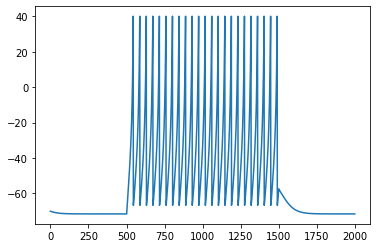

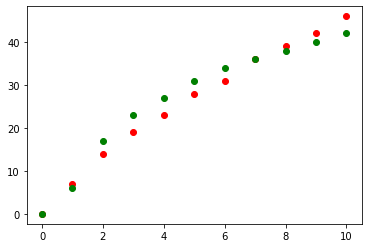

[ 23.37979826 -66.68891799   8.21901442   0.2          5.45873986
  13.87852183] 25.0


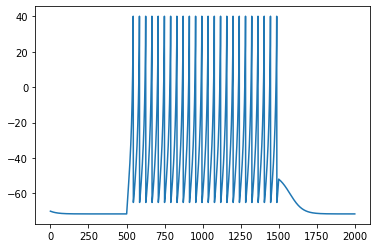

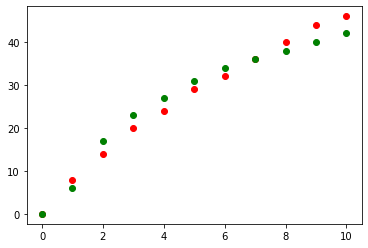

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


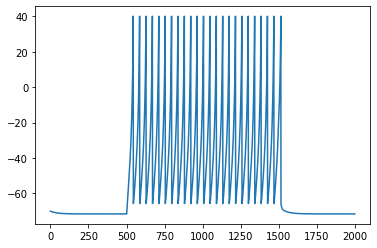

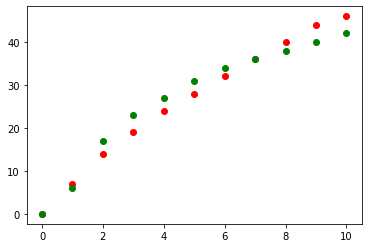

[ 23.37979826 -65.68891797   8.21901442   0.2          5.45873986
  13.87852183] 26.0


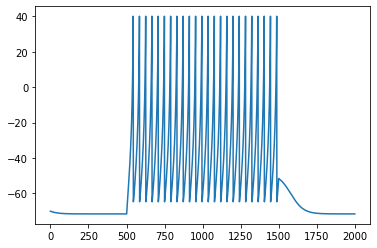

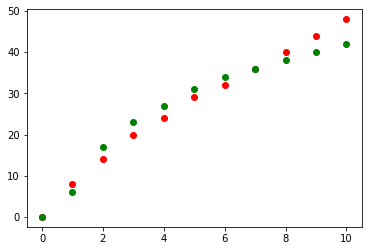

[ 23.37979826 -64.68891799   8.21901442   0.2          5.45873986
  13.87852183] 27.0


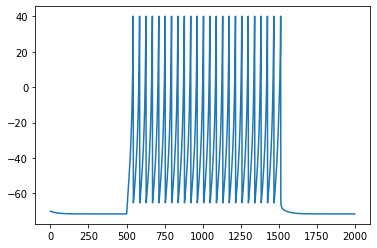

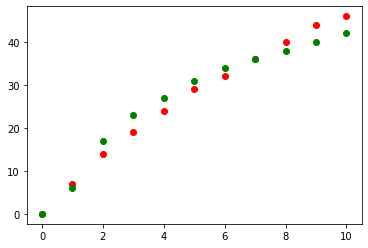

[ 23.37979826 -65.27264532   8.21901442   0.2          5.45873986
  13.87852183] 25.0


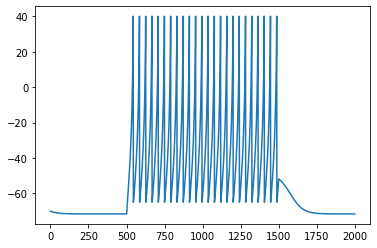

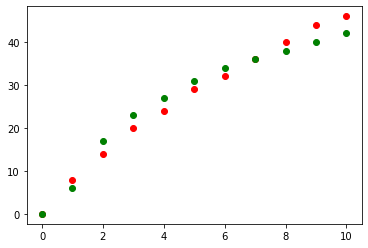

[ 23.37979826 -64.92498597   8.21901442   0.2          5.45873986
  13.87852183] 25.0


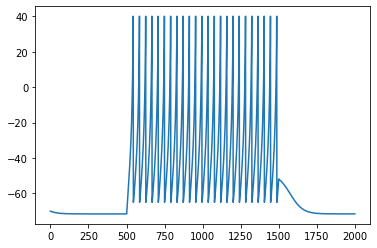

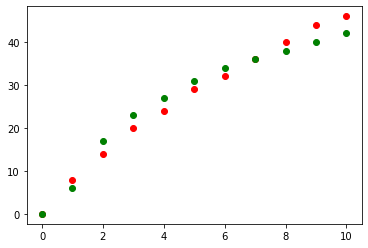

[ 23.37979826 -64.99793498   8.21901442   0.2          5.45873986
  13.87852183] 25.0


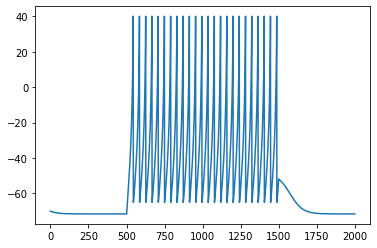

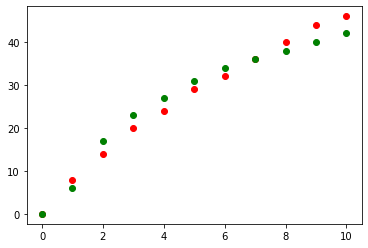

[ 23.37979826 -65.02579902   8.21901442   0.2          5.45873986
  13.87852183] 25.0


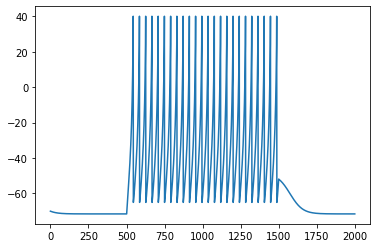

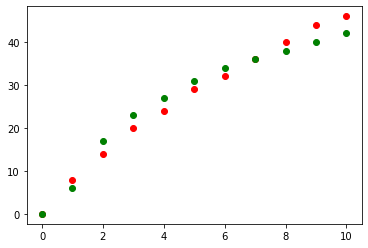

[ 23.37979826 -65.04301995   8.21901442   0.2          5.45873986
  13.87852183] 25.0


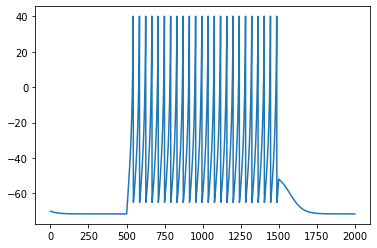

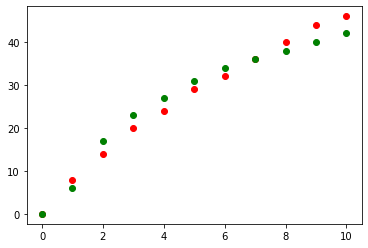

[ 23.37979826 -65.05366307   8.21901442   0.2          5.45873986
  13.87852183] 25.0


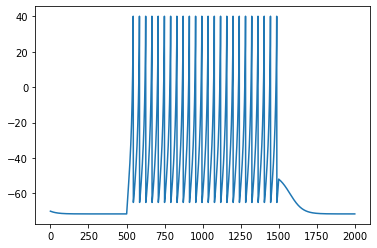

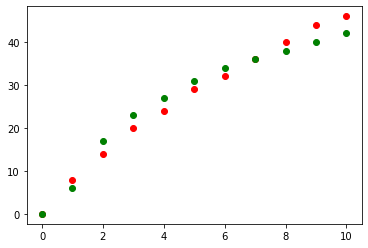

[ 23.37979826 -65.06024088   8.21901442   0.2          5.45873986
  13.87852183] 25.0


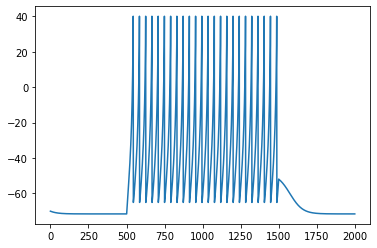

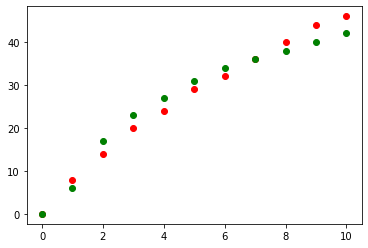

[ 23.37979826 -65.06430619   8.21901442   0.2          5.45873986
  13.87852183] 25.0


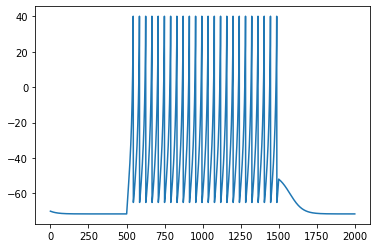

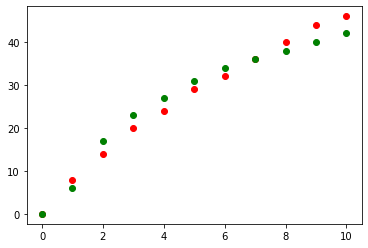

[ 23.37979826 -65.06681868   8.21901442   0.2          5.45873986
  13.87852183] 25.0


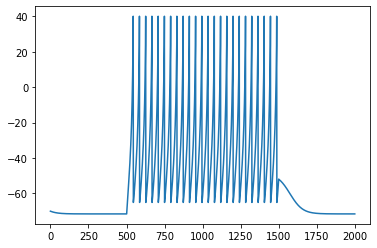

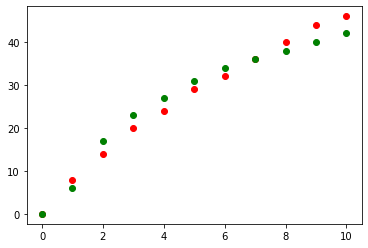

[ 23.37979826 -65.06837149   8.21901442   0.2          5.45873986
  13.87852183] 25.0


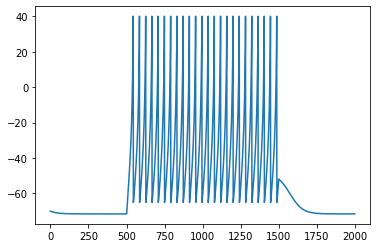

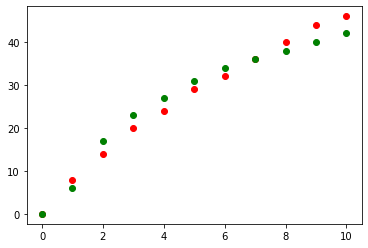

[ 23.37979826 -65.06933118   8.21901442   0.2          5.45873986
  13.87852183] 25.0


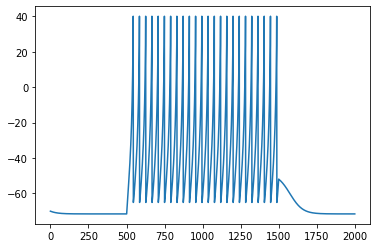

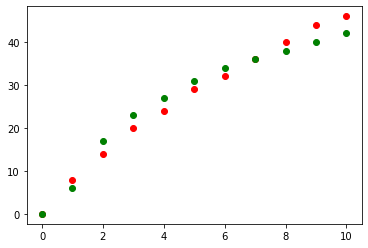

[ 23.37979826 -65.0699243    8.21901442   0.2          5.45873986
  13.87852183] 25.0


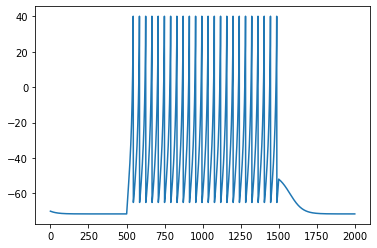

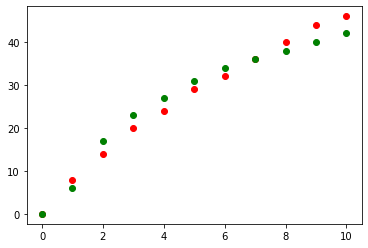

[ 23.37979826 -65.07029087   8.21901442   0.2          5.45873986
  13.87852183] 25.0


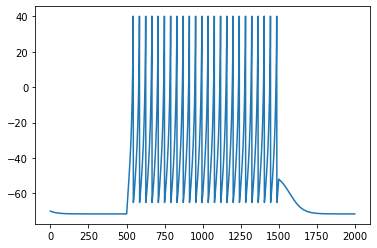

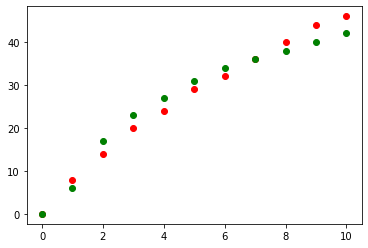

[ 23.37979826 -65.07051743   8.21901442   0.2          5.45873986
  13.87852183] 25.0


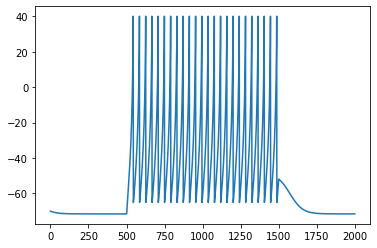

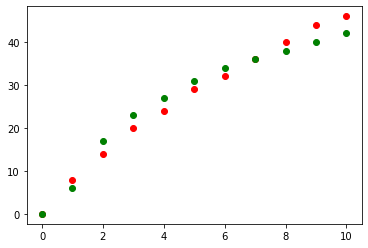

[ 23.37979826 -65.07065744   8.21901442   0.2          5.45873986
  13.87852183] 25.0


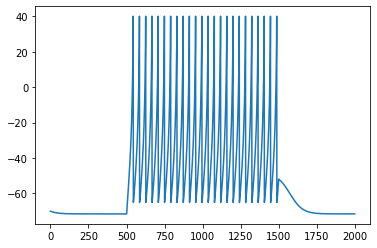

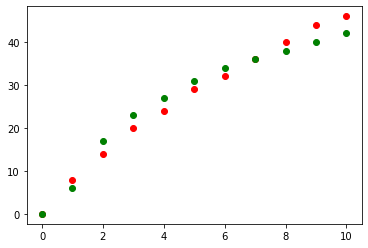

[ 23.37979826 -65.07074398   8.21901442   0.2          5.45873986
  13.87852183] 25.0


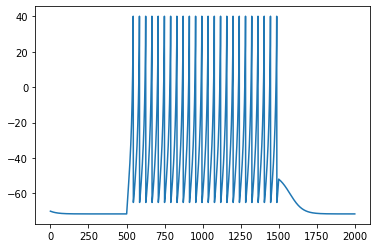

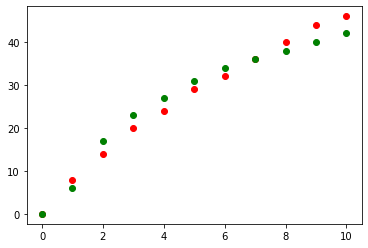

[ 23.37979826 -65.07079746   8.21901442   0.2          5.45873986
  13.87852183] 25.0


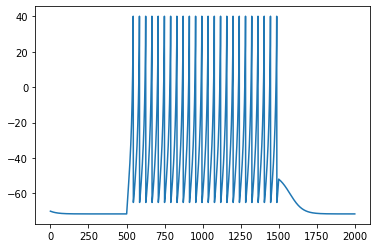

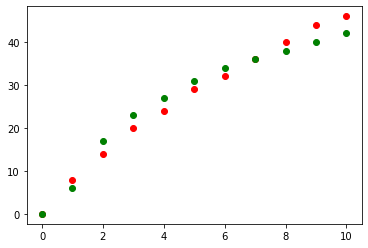

[ 23.37979826 -65.07083051   8.21901442   0.2          5.45873986
  13.87852183] 25.0


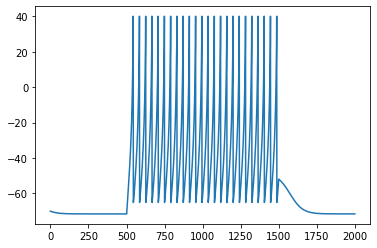

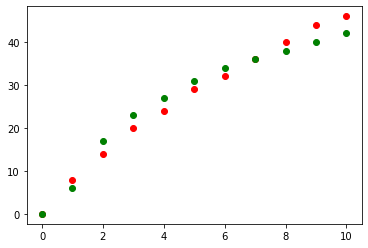

[ 23.37979826 -65.07085094   8.21901442   0.2          5.45873986
  13.87852183] 25.0


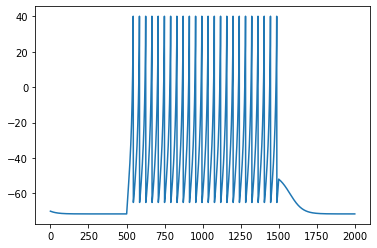

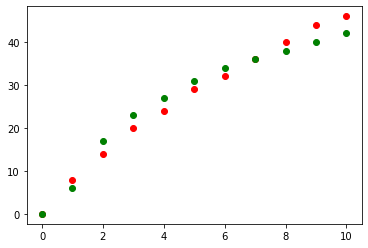

[ 23.37979826 -65.07086357   8.21901442   0.2          5.45873986
  13.87852183] 25.0


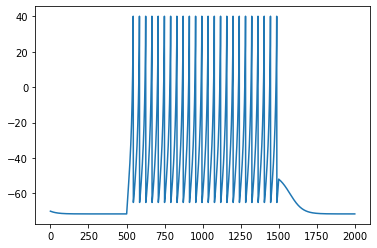

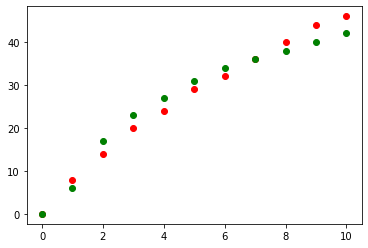

[ 23.37979826 -65.07087137   8.21901442   0.2          5.45873986
  13.87852183] 25.0


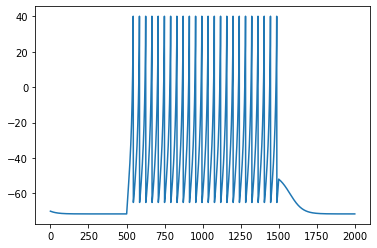

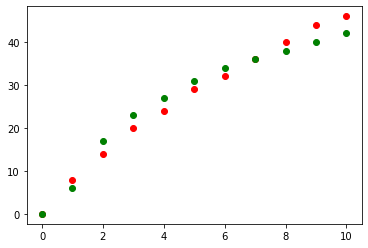

[ 23.37979826 -65.07087619   8.21901442   0.2          5.45873986
  13.87852183] 25.0


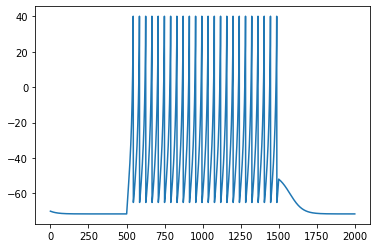

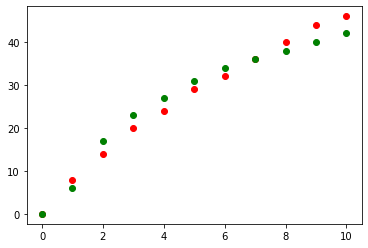

[ 23.37979826 -65.07087917   8.21901442   0.2          5.45873986
  13.87852183] 25.0


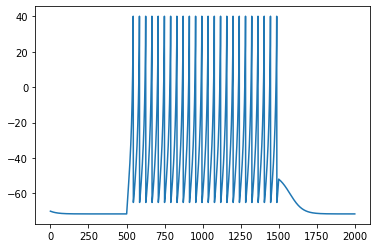

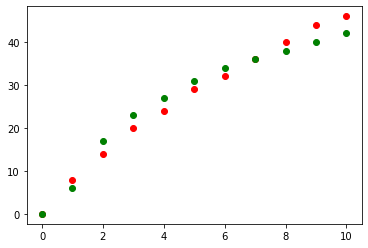

[ 23.37979826 -65.07088101   8.21901442   0.2          5.45873986
  13.87852183] 25.0


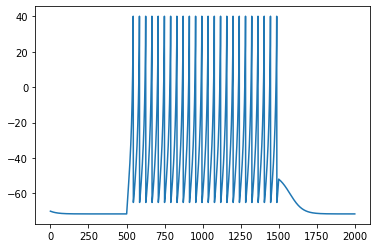

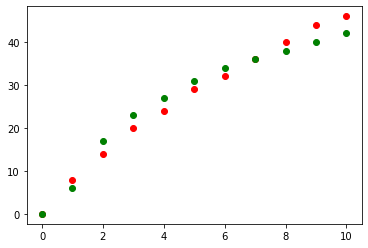

[ 23.37979826 -65.07088215   8.21901442   0.2          5.45873986
  13.87852183] 25.0


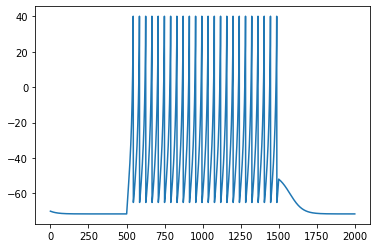

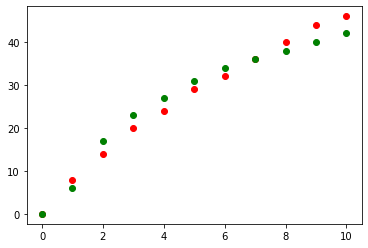

[ 23.37979826 -65.07088286   8.21901442   0.2          5.45873986
  13.87852183] 25.0


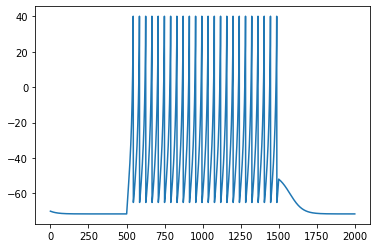

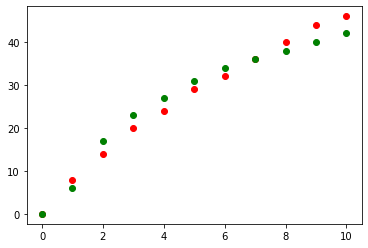

[ 23.37979826 -65.07088329   8.21901442   0.2          5.45873986
  13.87852183] 25.0


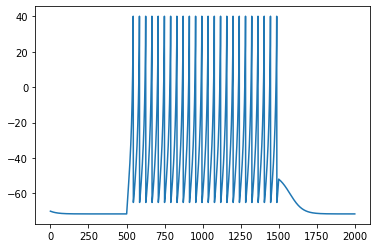

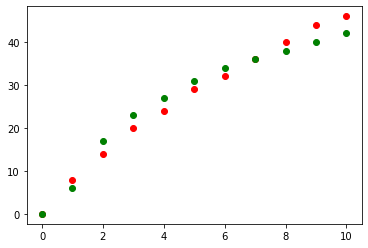

[ 23.37979826 -65.07088356   8.21901442   0.2          5.45873986
  13.87852183] 25.0


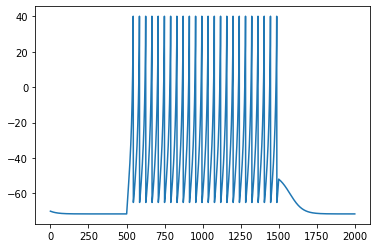

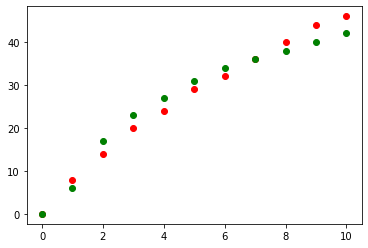

[ 23.37979826 -65.07088373   8.21901442   0.2          5.45873986
  13.87852183] 25.0


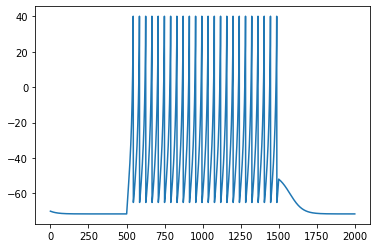

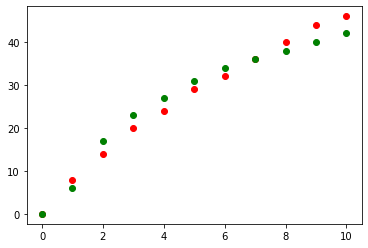

[ 23.37979826 -65.07088383   8.21901442   0.2          5.45873986
  13.87852183] 25.0


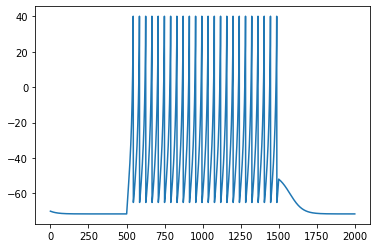

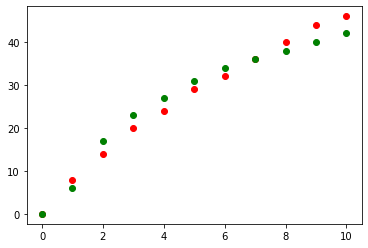

[ 23.37979826 -65.07088389   8.21901442   0.2          5.45873986
  13.87852183] 25.0


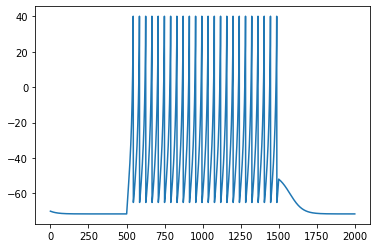

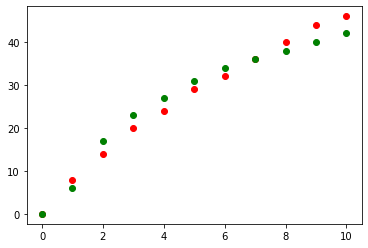

[ 23.37979826 -65.07088393   8.21901442   0.2          5.45873986
  13.87852183] 25.0


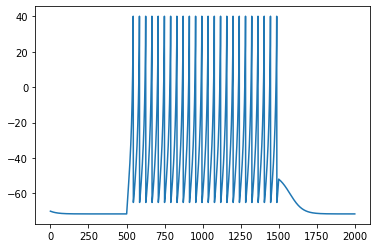

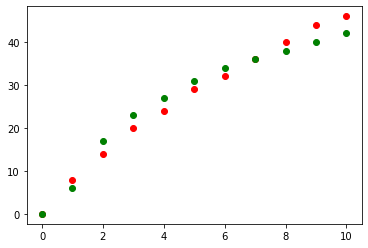

[ 23.37979826 -65.07088396   8.21901442   0.2          5.45873986
  13.87852183] 25.0


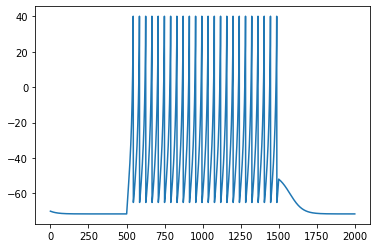

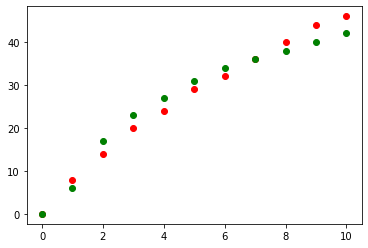

[ 23.37979826 -65.07088397   8.21901442   0.2          5.45873986
  13.87852183] 25.0


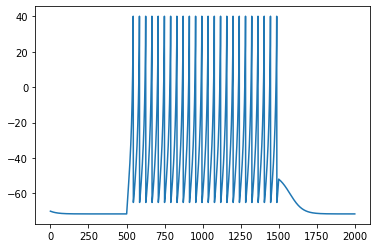

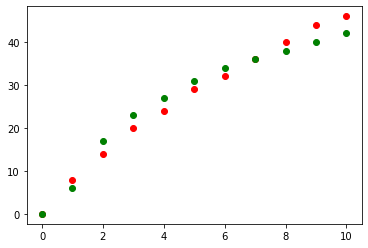

[ 23.37979826 -65.07088398   8.21901442   0.2          5.45873986
  13.87852183] 25.0


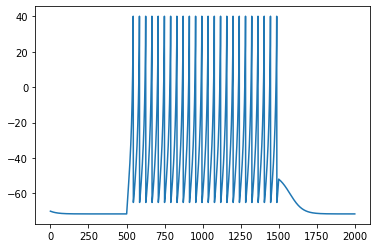

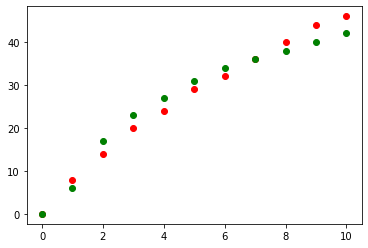

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


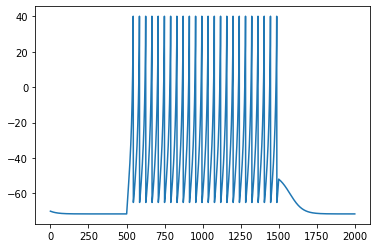

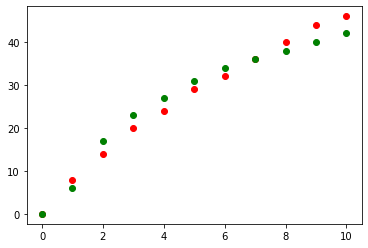

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


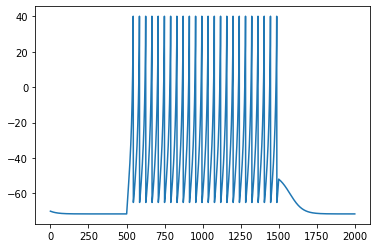

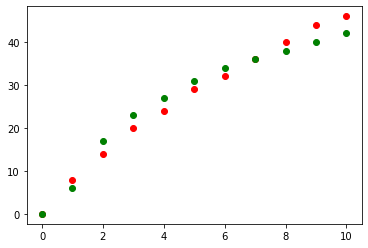

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


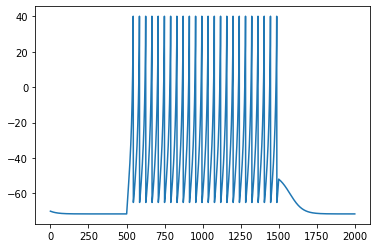

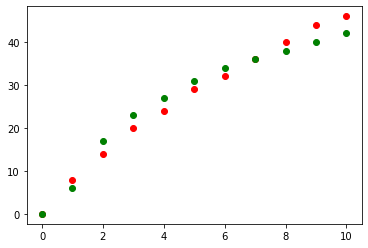

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


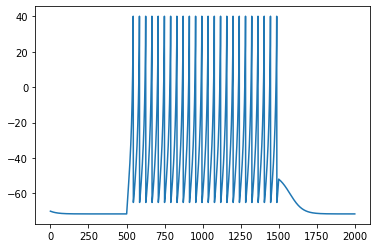

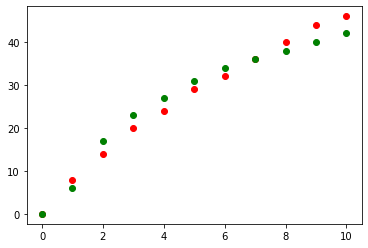

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


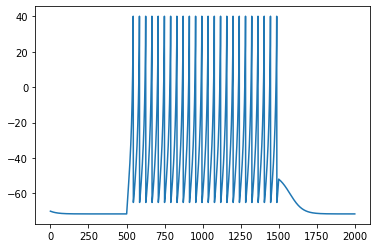

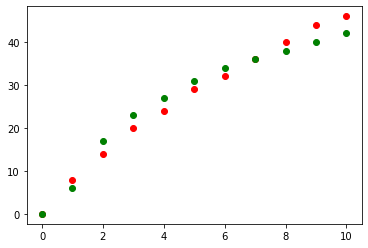

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


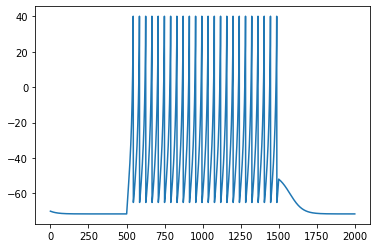

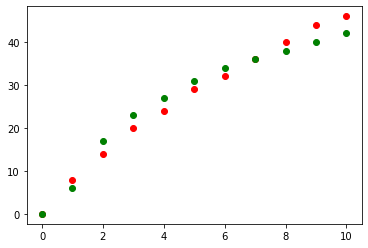

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


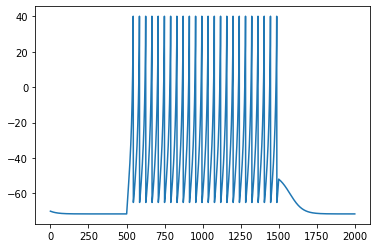

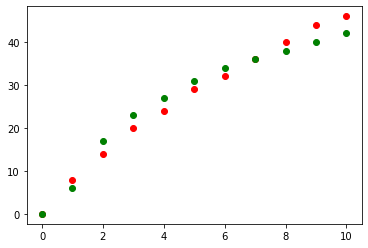

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


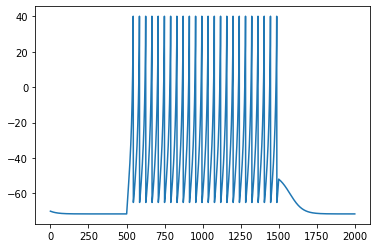

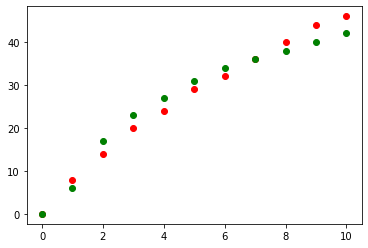

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


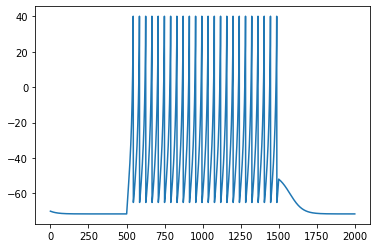

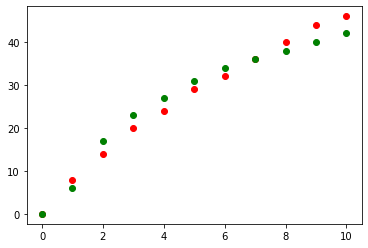

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


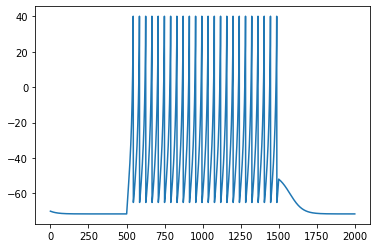

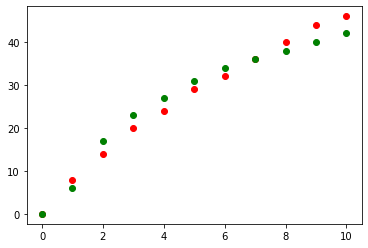

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


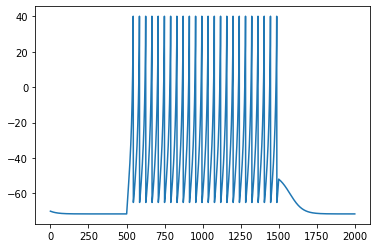

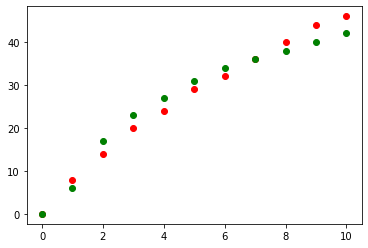

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


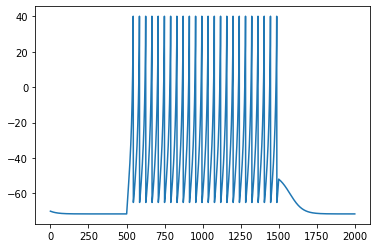

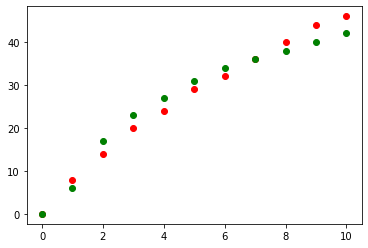

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


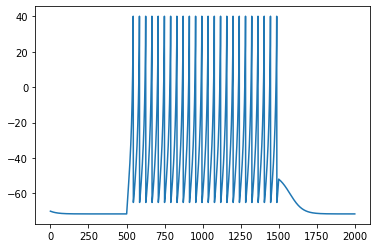

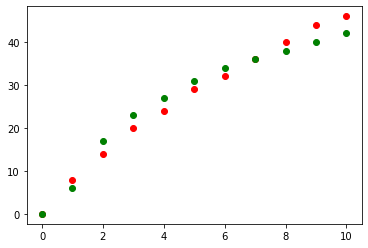

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


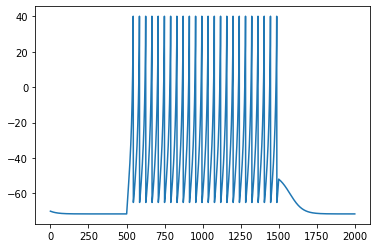

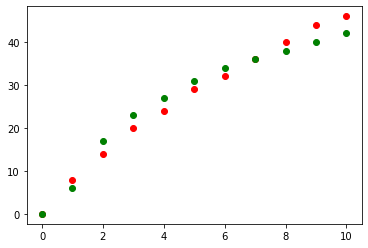

[ 23.37979826 -65.07088399   8.21901442   0.2          5.45873986
  13.87852183] 25.0


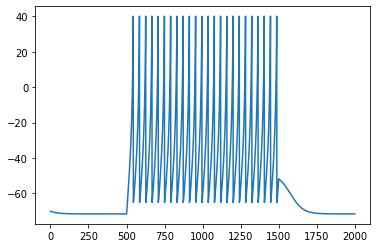

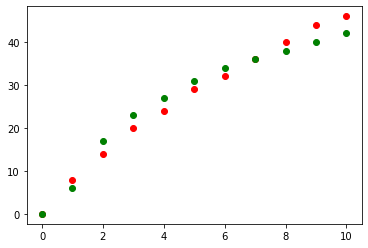

[ 23.37979826 -65.07088399   9.21901442   0.2          5.45873986
  13.87852183] 25.0


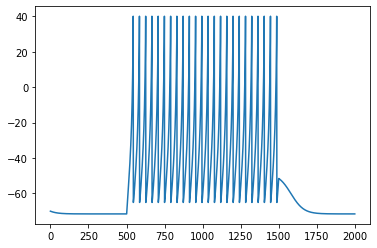

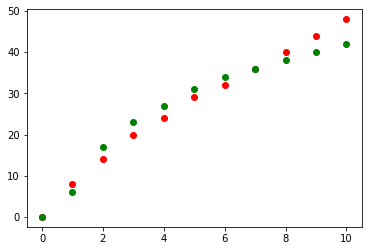

[ 23.37979826 -65.07088399  10.83704842   0.2          5.45873986
  13.87852183] 27.0


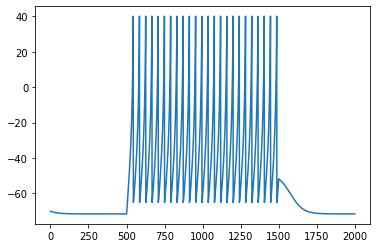

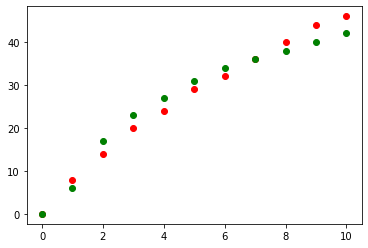

[ 23.37979826 -65.07088399   9.21901442   0.2          5.45873986
  13.87852183] 25.0


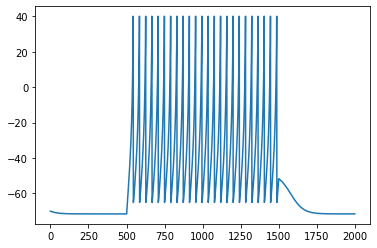

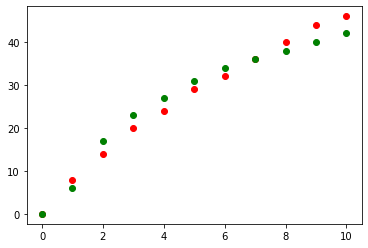

[ 23.37979826 -65.07088399   9.8370484    0.2          5.45873986
  13.87852183] 25.0


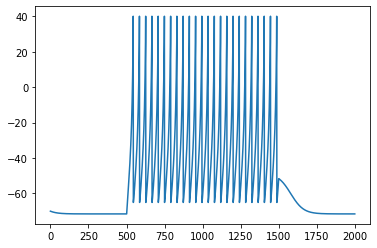

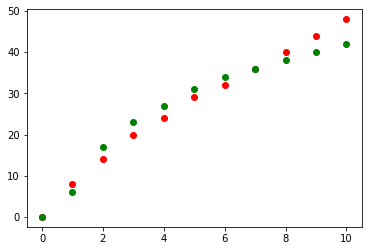

[ 23.37979826 -65.07088399  10.21901441   0.2          5.45873986
  13.87852183] 27.0


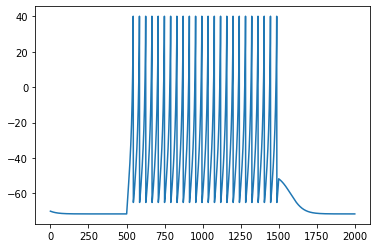

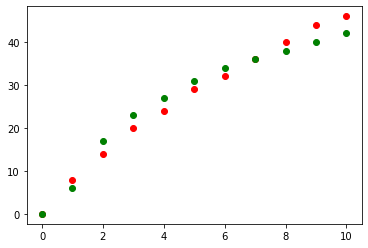

[ 23.37979826 -65.07088399   9.52803141   0.2          5.45873986
  13.87852183] 25.0


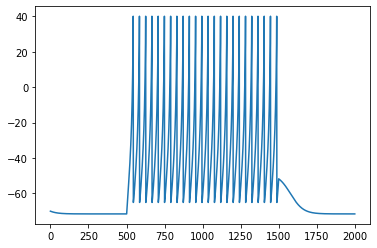

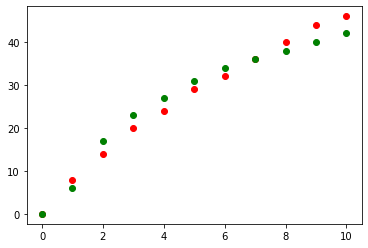

[ 23.37979826 -65.07088399   9.40999743   0.2          5.45873986
  13.87852183] 25.0


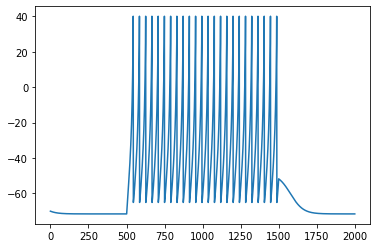

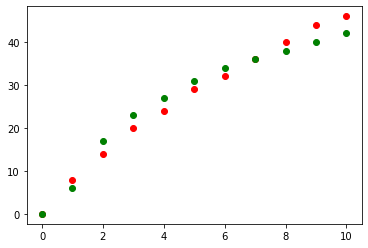

[ 23.37979826 -65.07088399   9.33704841   0.2          5.45873986
  13.87852183] 25.0


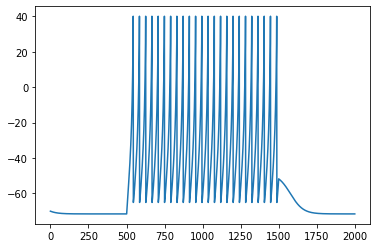

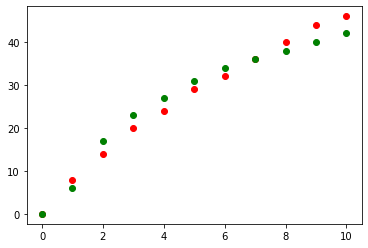

[ 23.37979826 -65.07088399   9.29196344   0.2          5.45873986
  13.87852183] 25.0


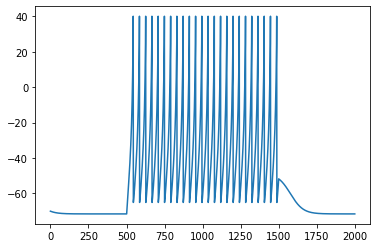

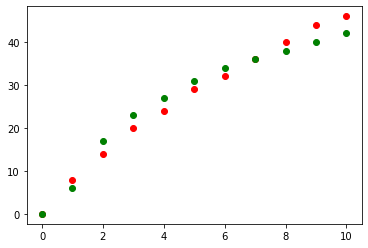

[ 23.37979826 -65.07088399   9.2640994    0.2          5.45873986
  13.87852183] 25.0


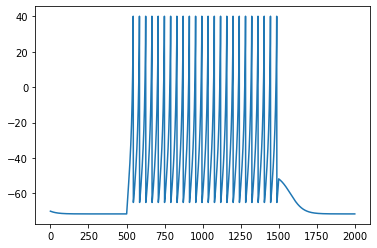

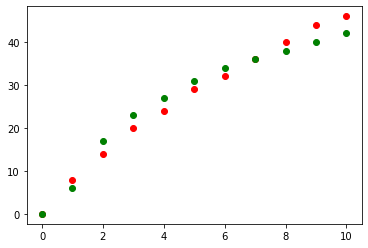

[ 23.37979826 -65.07088399   9.24687847   0.2          5.45873986
  13.87852183] 25.0


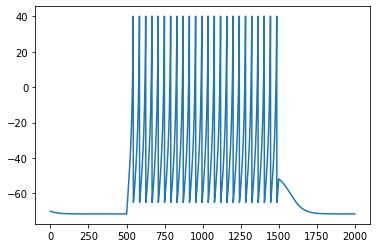

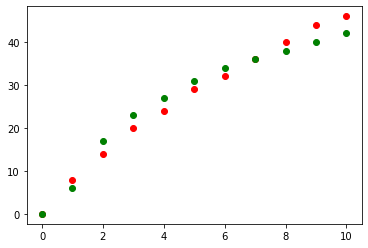

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


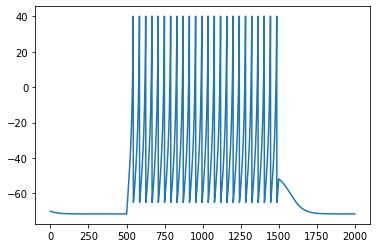

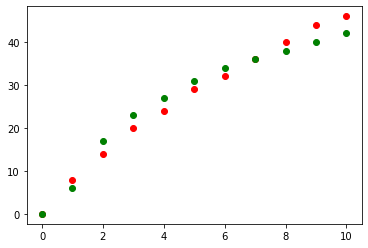

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


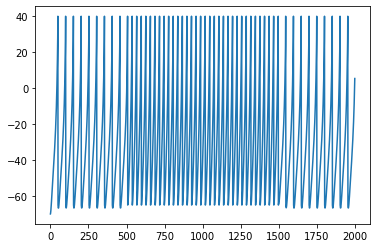

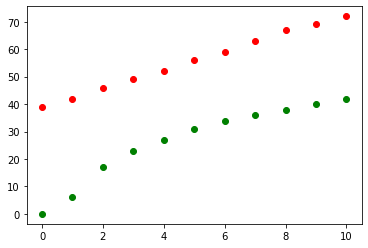

[ 23.37979826 -65.07088399   9.23623535   1.2          5.45873986
  13.87852183] 320.0


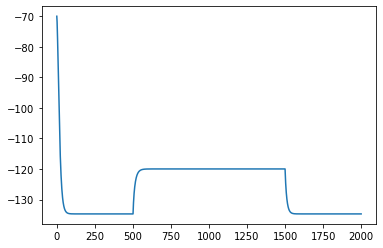

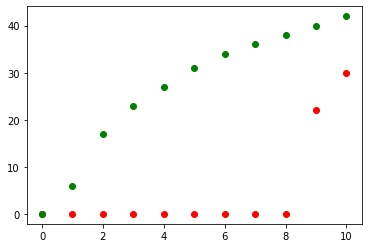

[ 23.37979826 -65.07088399   9.23623535  -1.418034     5.45873986
  13.87852183] 242.0


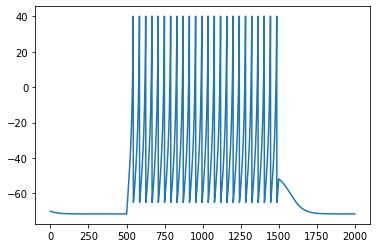

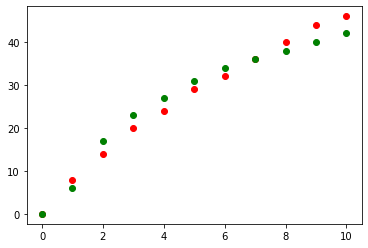

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


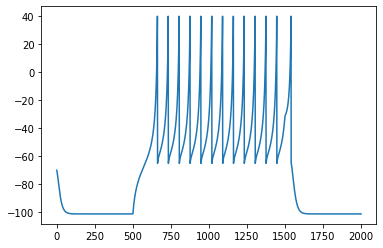

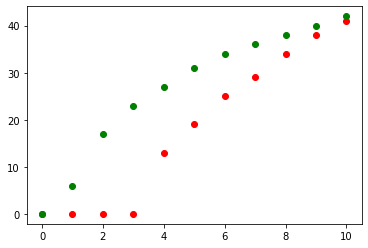

[ 23.37979826 -65.07088399   9.23623535  -0.41803397   5.45873986
  13.87852183] 95.0


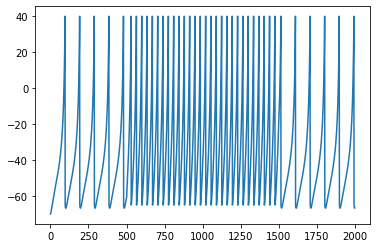

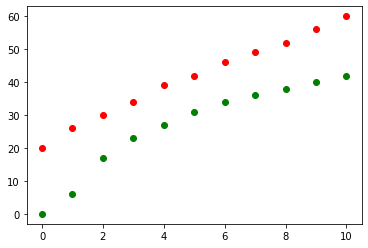

[ 23.37979826 -65.07088399   9.23623535   0.581966     5.45873986
  13.87852183] 160.0


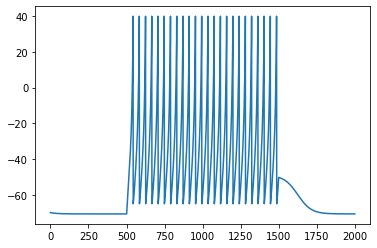

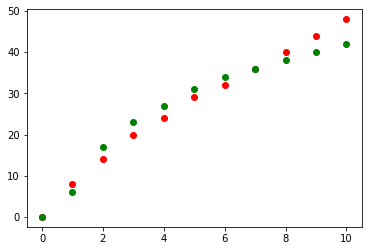

[ 23.37979826 -65.07088399   9.23623535   0.20991442   5.45873986
  13.87852183] 27.0


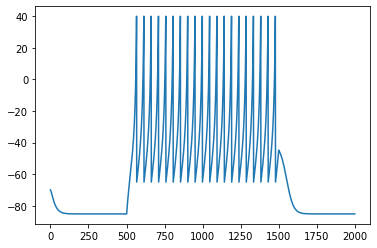

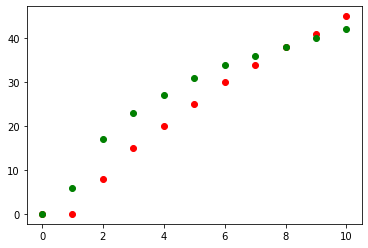

[ 2.33797983e+01 -6.50708840e+01  9.23623535e+00 -3.60679652e-02
  5.45873986e+00  1.38785218e+01] 46.0


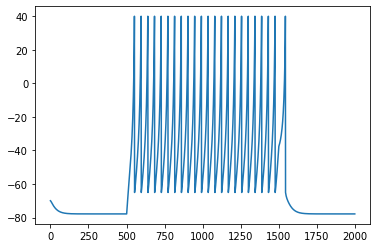

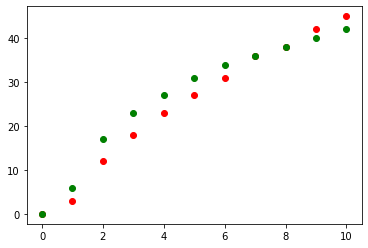

[ 23.37979826 -65.07088399   9.23623535   0.1046997    5.45873986
  13.87852183] 29.0


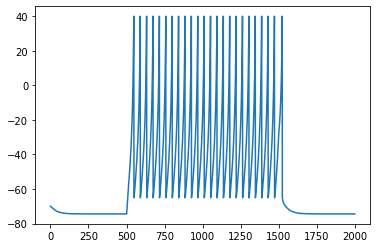

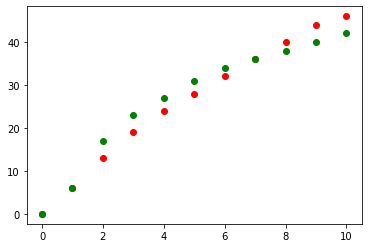

[ 23.37979826 -65.07088399   9.23623535   0.15995965   5.45873986
  13.87852183] 26.0


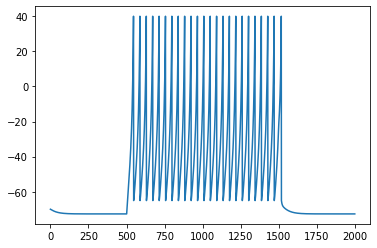

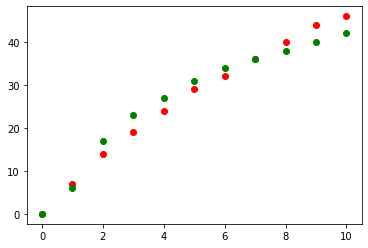

[ 23.37979826 -65.07088399   9.23623535   0.18487524   5.45873986
  13.87852183] 25.0


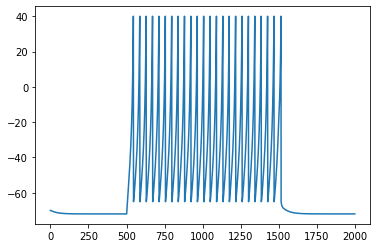

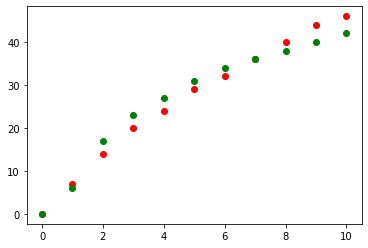

[ 23.37979826 -65.07088399   9.23623535   0.19422286   5.45873986
  13.87852183] 24.0


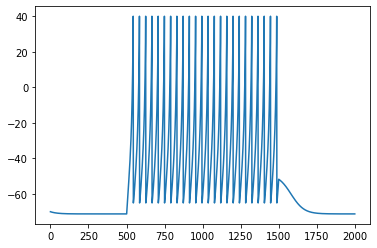

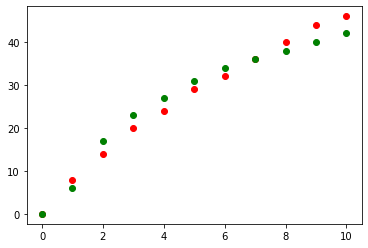

[ 23.37979826 -65.07088399   9.23623535   0.20378697   5.45873986
  13.87852183] 25.0


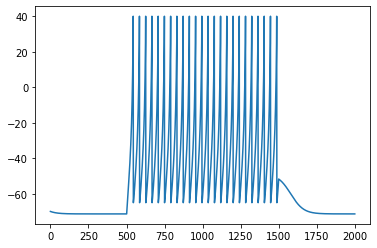

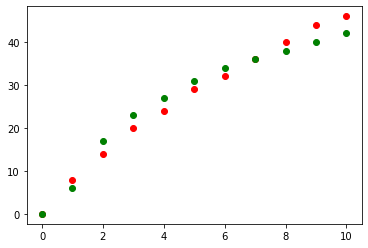

[ 23.37979826 -65.07088399   9.23623535   0.20189349   5.45873986
  13.87852183] 25.0


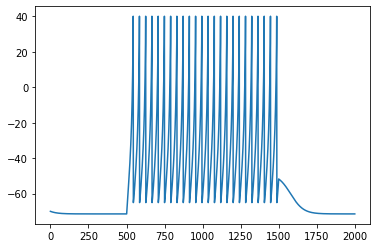

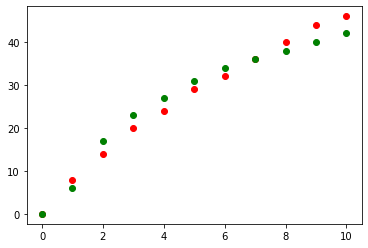

[ 23.37979826 -65.07088399   9.23623535   0.20117024   5.45873986
  13.87852183] 25.0


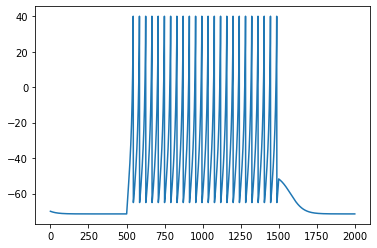

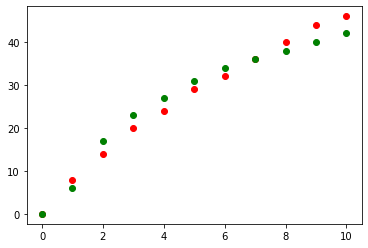

[ 23.37979826 -65.07088399   9.23623535   0.20072325   5.45873986
  13.87852183] 25.0


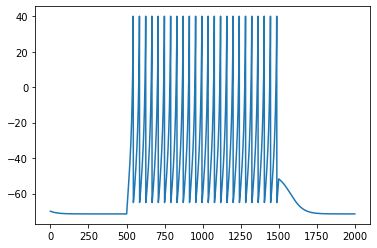

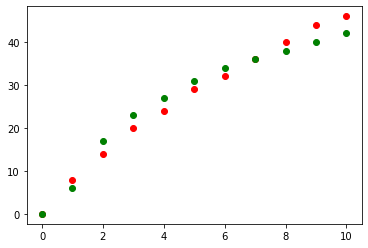

[ 23.37979826 -65.07088399   9.23623535   0.20044699   5.45873986
  13.87852183] 25.0


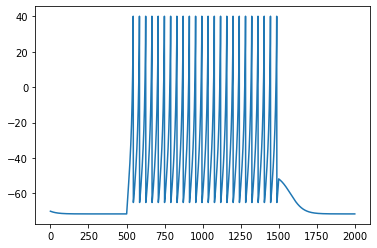

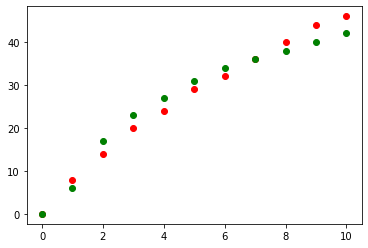

[ 23.37979826 -65.07088399   9.23623535   0.20027626   5.45873986
  13.87852183] 25.0


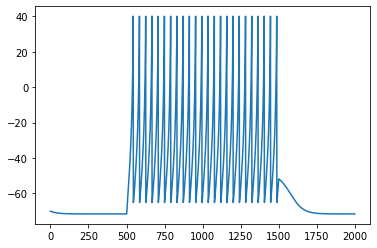

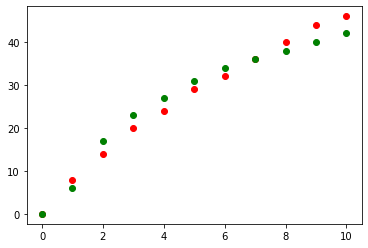

[ 23.37979826 -65.07088399   9.23623535   0.20017074   5.45873986
  13.87852183] 25.0


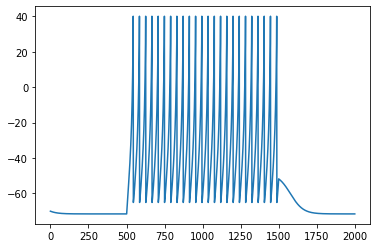

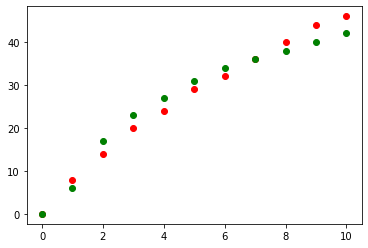

[ 23.37979826 -65.07088399   9.23623535   0.20010552   5.45873986
  13.87852183] 25.0


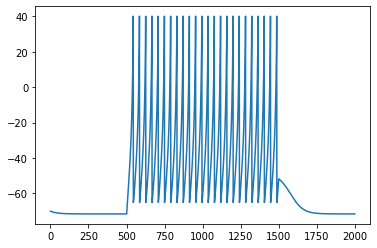

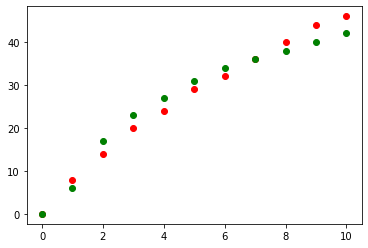

[ 23.37979826 -65.07088399   9.23623535   0.20006522   5.45873986
  13.87852183] 25.0


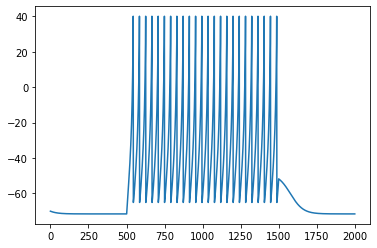

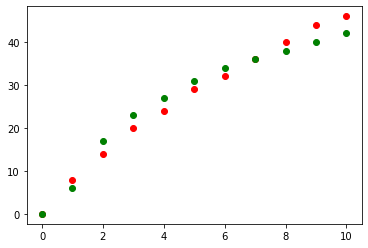

[ 23.37979826 -65.07088399   9.23623535   0.20004031   5.45873986
  13.87852183] 25.0


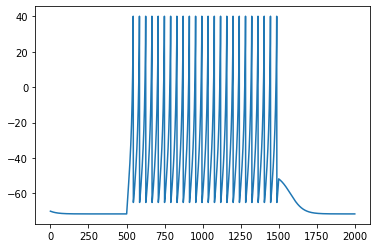

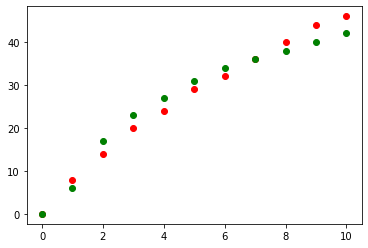

[ 23.37979826 -65.07088399   9.23623535   0.20002491   5.45873986
  13.87852183] 25.0


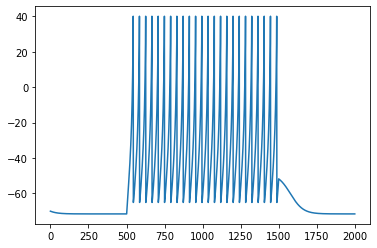

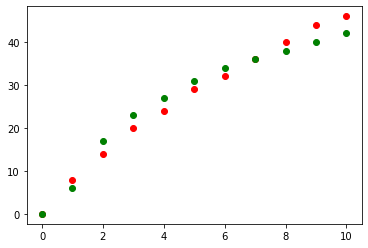

[ 23.37979826 -65.07088399   9.23623535   0.2000154    5.45873986
  13.87852183] 25.0


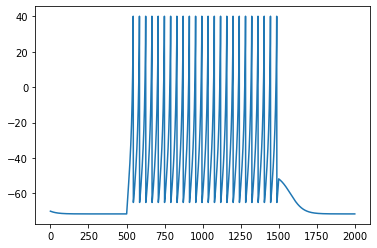

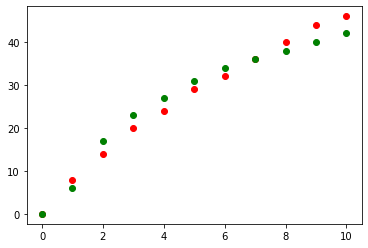

[ 23.37979826 -65.07088399   9.23623535   0.20000951   5.45873986
  13.87852183] 25.0


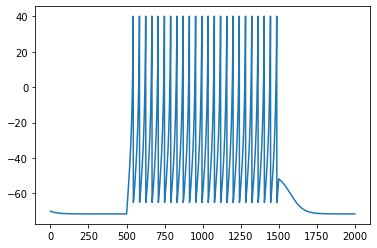

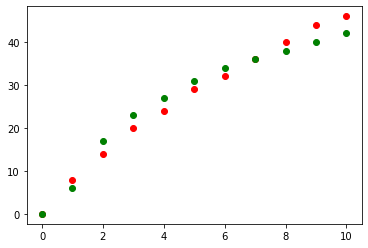

[ 23.37979826 -65.07088399   9.23623535   0.20000588   5.45873986
  13.87852183] 25.0


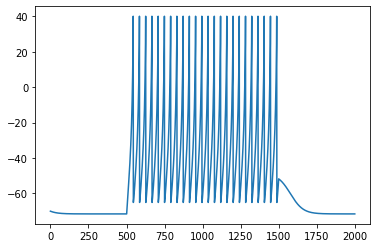

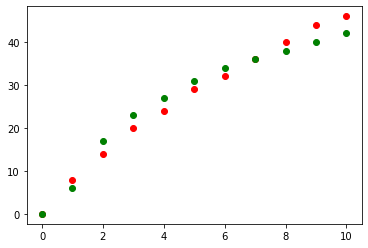

[ 23.37979826 -65.07088399   9.23623535   0.20000363   5.45873986
  13.87852183] 25.0


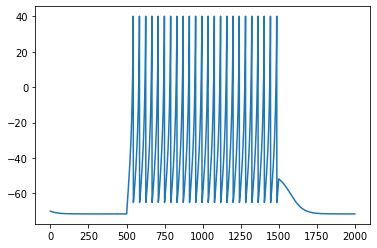

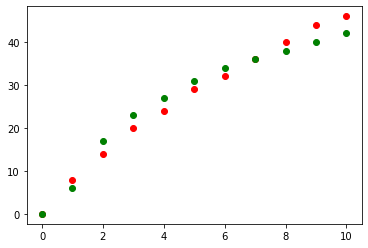

[ 23.37979826 -65.07088399   9.23623535   0.20000225   5.45873986
  13.87852183] 25.0


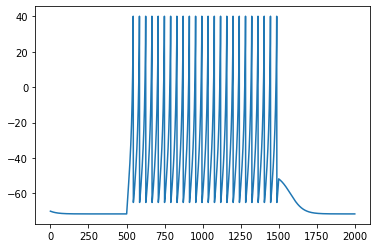

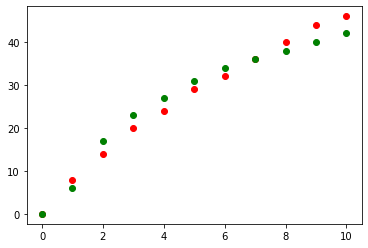

[ 23.37979826 -65.07088399   9.23623535   0.20000139   5.45873986
  13.87852183] 25.0


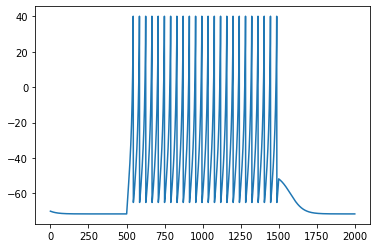

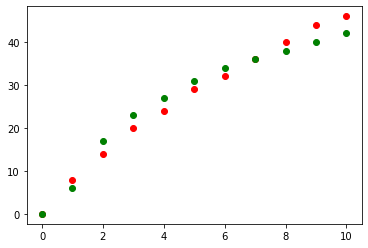

[ 23.37979826 -65.07088399   9.23623535   0.20000086   5.45873986
  13.87852183] 25.0


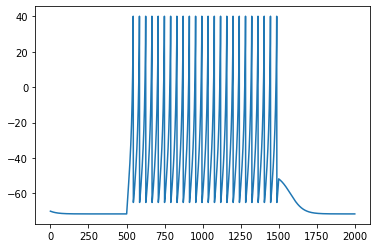

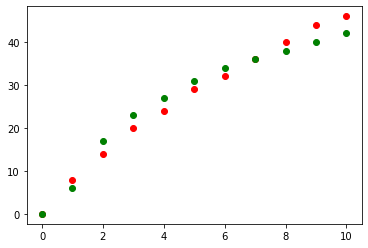

[ 23.37979826 -65.07088399   9.23623535   0.20000053   5.45873986
  13.87852183] 25.0


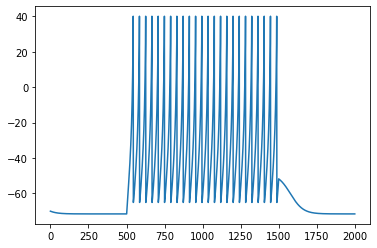

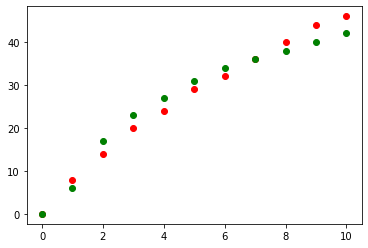

[ 23.37979826 -65.07088399   9.23623535   0.20000033   5.45873986
  13.87852183] 25.0


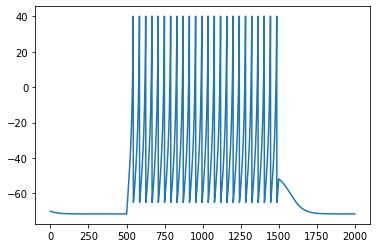

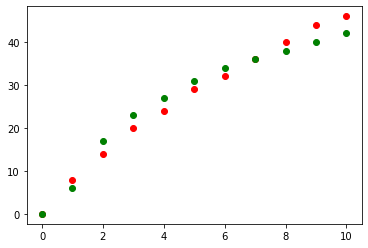

[ 23.37979826 -65.07088399   9.23623535   0.2000002    5.45873986
  13.87852183] 25.0


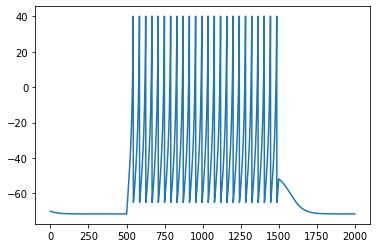

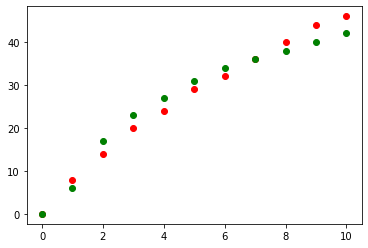

[ 23.37979826 -65.07088399   9.23623535   0.20000013   5.45873986
  13.87852183] 25.0


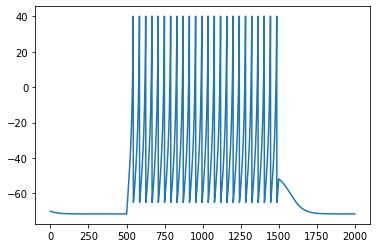

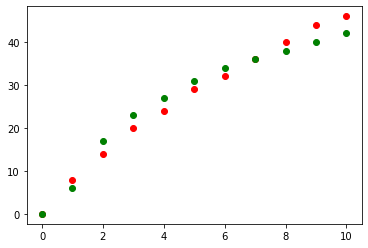

[ 23.37979826 -65.07088399   9.23623535   0.20000008   5.45873986
  13.87852183] 25.0


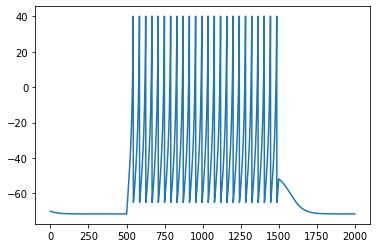

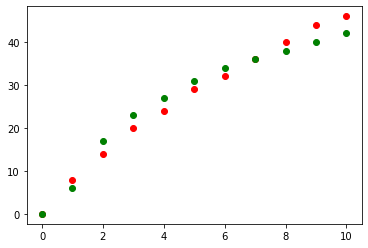

[ 23.37979826 -65.07088399   9.23623535   0.20000005   5.45873986
  13.87852183] 25.0


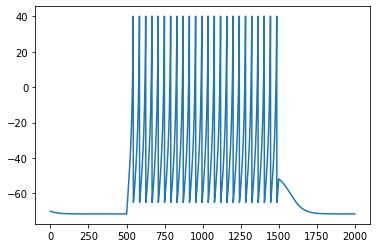

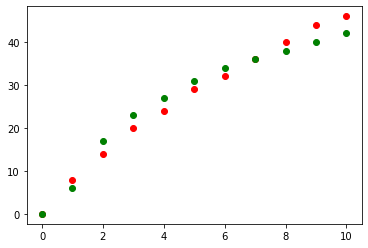

[ 23.37979826 -65.07088399   9.23623535   0.20000003   5.45873986
  13.87852183] 25.0


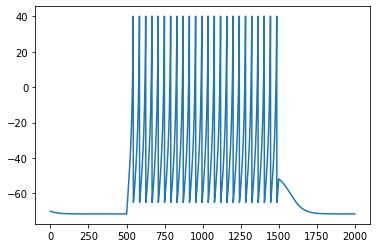

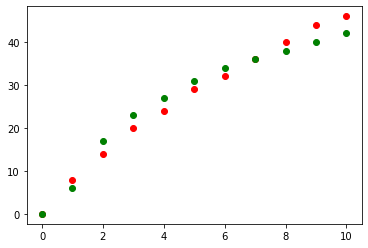

[ 23.37979826 -65.07088399   9.23623535   0.20000002   5.45873986
  13.87852183] 25.0


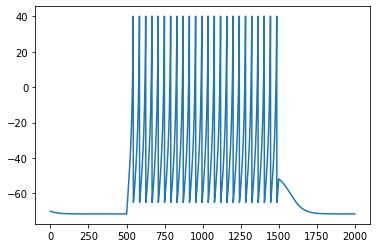

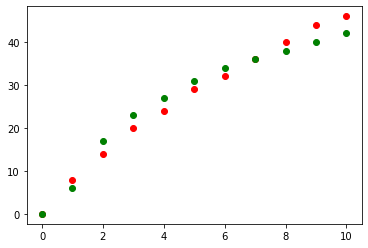

[ 23.37979826 -65.07088399   9.23623535   0.20000001   5.45873986
  13.87852183] 25.0


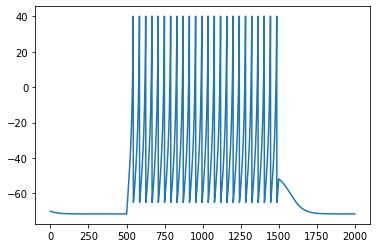

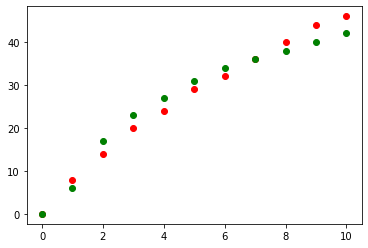

[ 23.37979826 -65.07088399   9.23623535   0.20000001   5.45873986
  13.87852183] 25.0


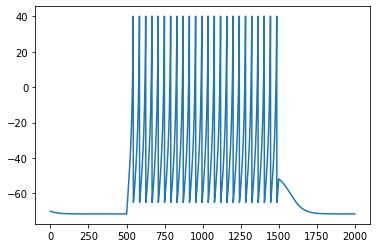

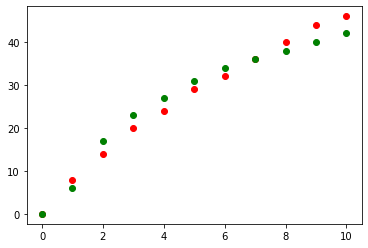

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


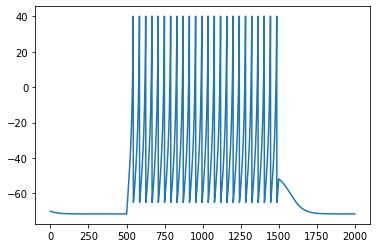

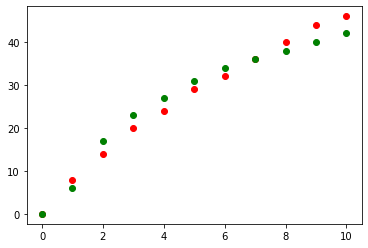

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


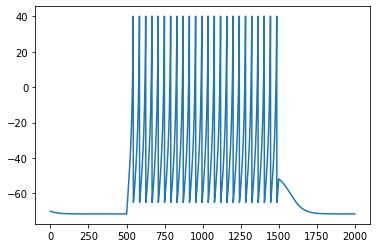

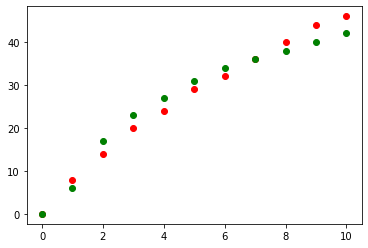

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


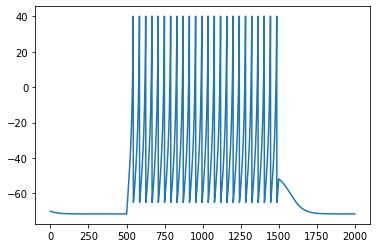

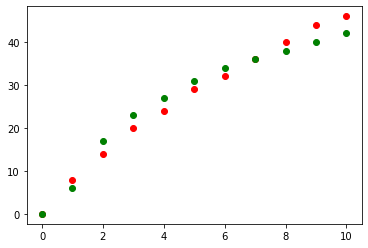

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


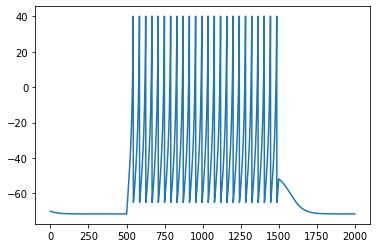

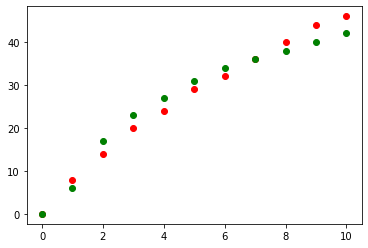

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


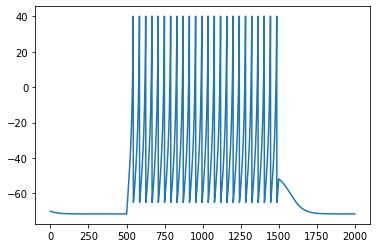

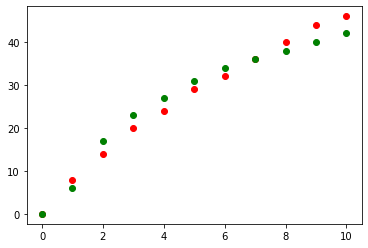

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


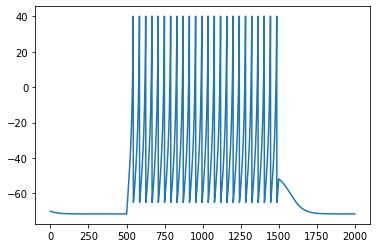

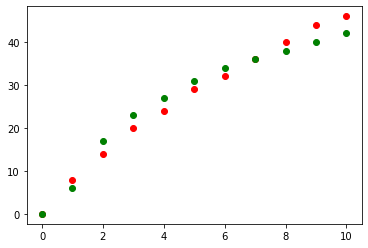

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


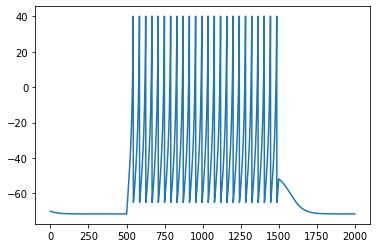

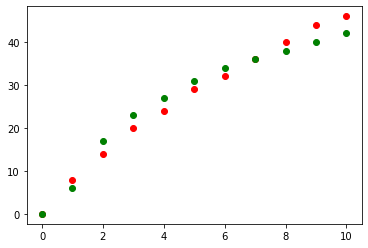

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


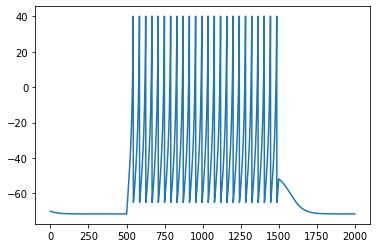

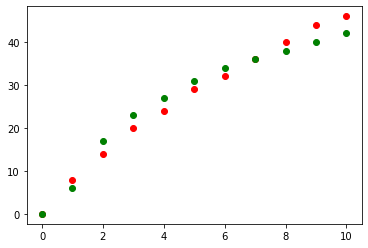

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


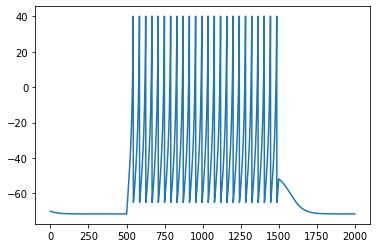

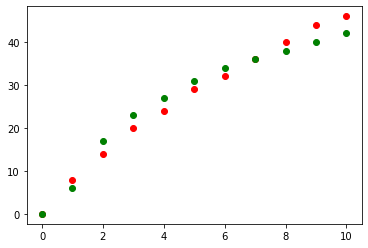

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


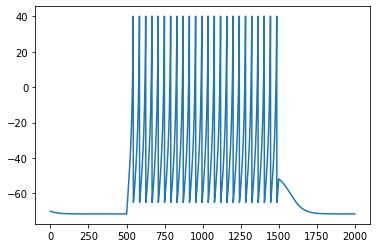

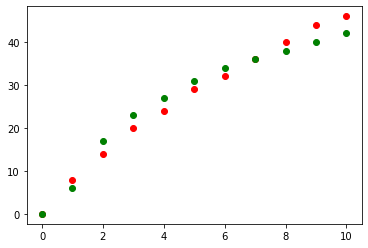

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


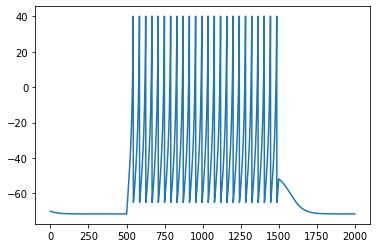

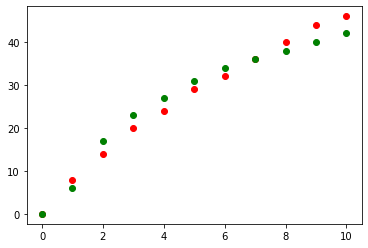

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


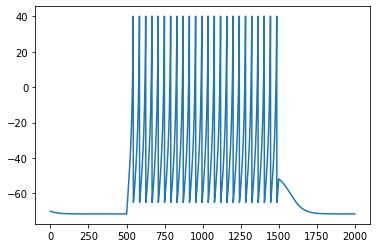

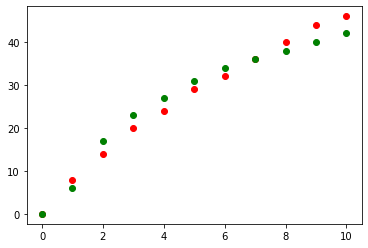

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


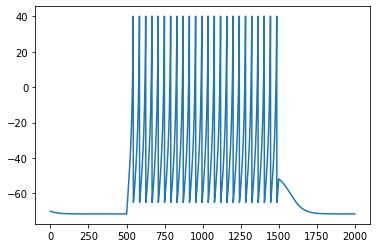

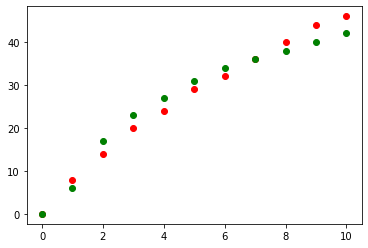

[ 23.37979826 -65.07088399   9.23623535   0.2          5.45873986
  13.87852183] 25.0


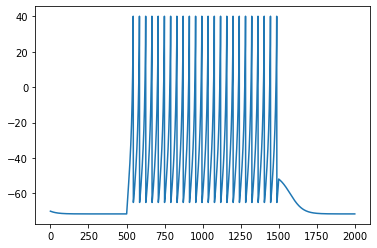

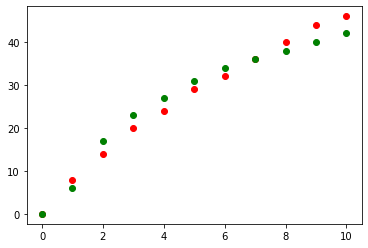

[ 23.37979826 -65.07088399   9.23623535   0.2          6.45873986
  13.87852183] 25.0


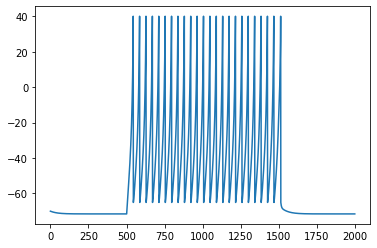

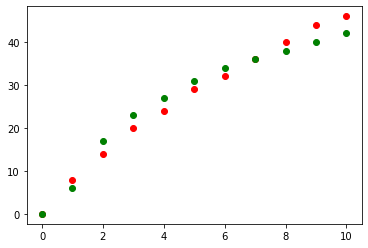

[ 23.37979826 -65.07088399   9.23623535   0.2          8.07677386
  13.87852183] 25.0


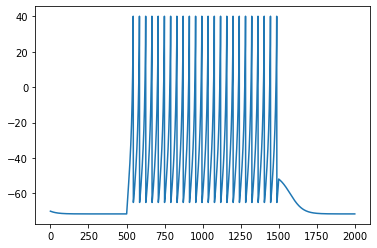

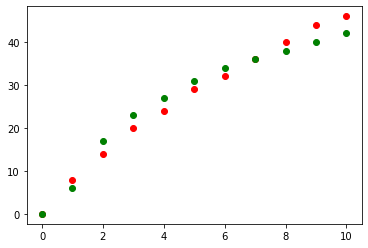

[ 23.37979826 -65.07088399   9.23623535   0.2          6.45873986
  13.87852183] 25.0


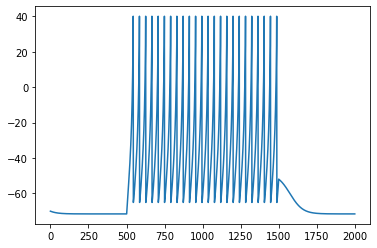

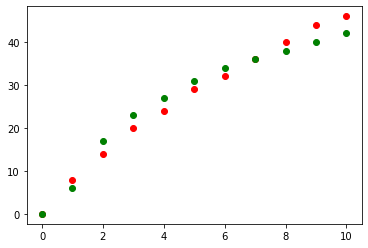

[ 23.37979826 -65.07088399   9.23623535   0.2          7.07677384
  13.87852183] 25.0


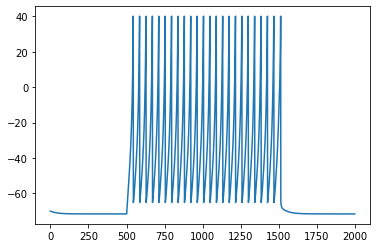

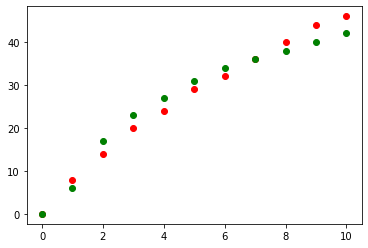

[ 23.37979826 -65.07088399   9.23623535   0.2          7.45873985
  13.87852183] 25.0


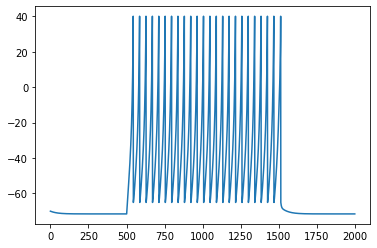

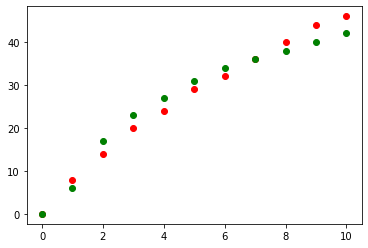

[ 23.37979826 -65.07088399   9.23623535   0.2          7.69480783
  13.87852183] 25.0


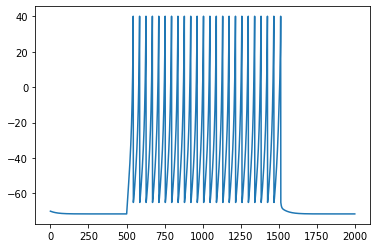

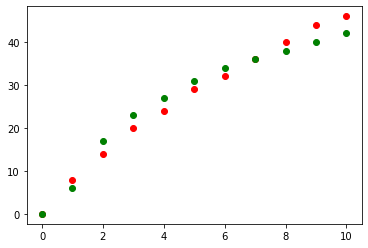

[ 23.37979826 -65.07088399   9.23623535   0.2          7.84070587
  13.87852183] 25.0


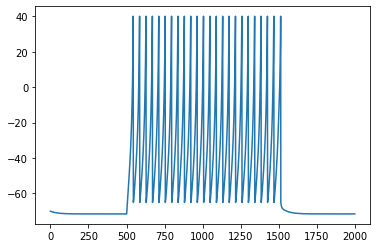

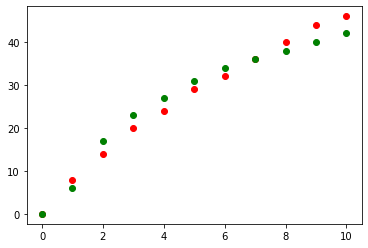

[ 23.37979826 -65.07088399   9.23623535   0.2          7.93087581
  13.87852183] 25.0


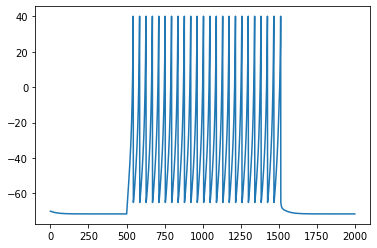

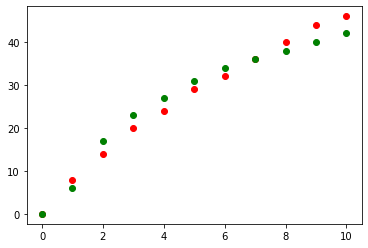

[ 23.37979826 -65.07088399   9.23623535   0.2          7.98660391
  13.87852183] 25.0


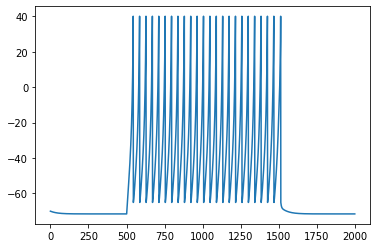

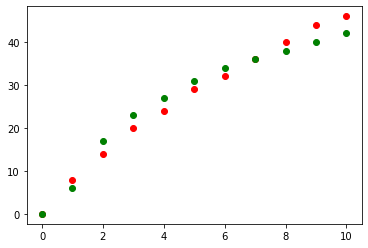

[ 23.37979826 -65.07088399   9.23623535   0.2          8.02104576
  13.87852183] 25.0


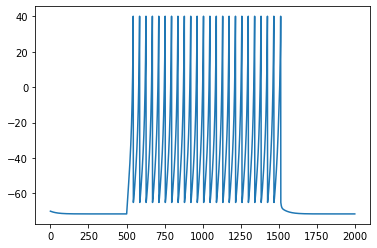

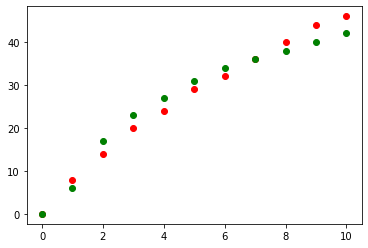

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


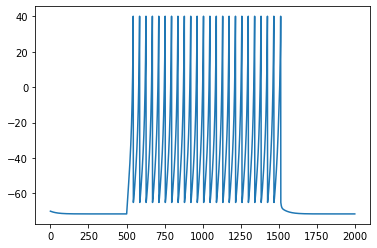

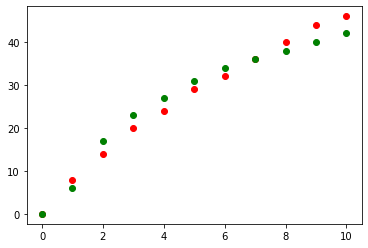

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


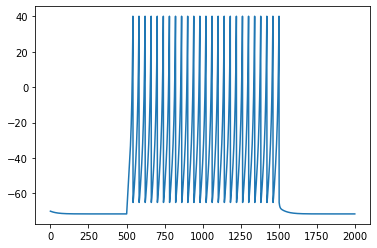

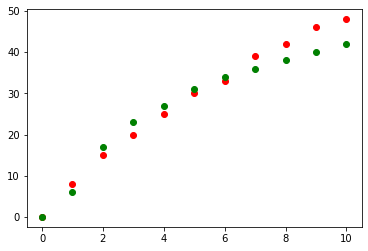

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  14.87852183] 30.0


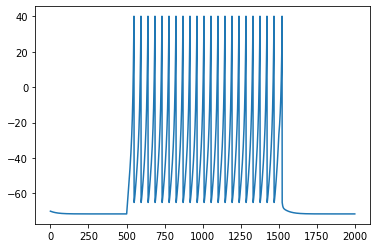

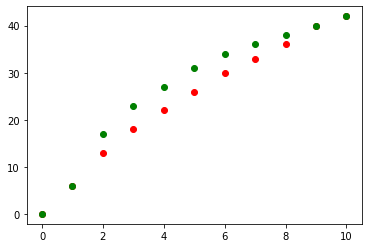

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  12.26048783] 28.0


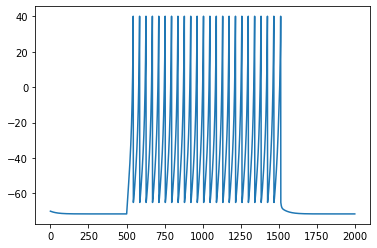

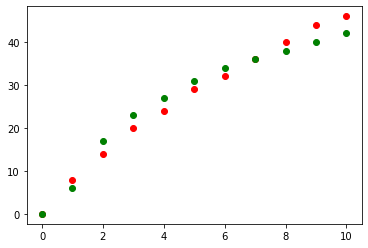

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


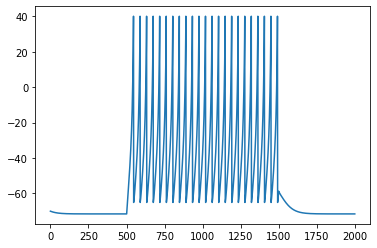

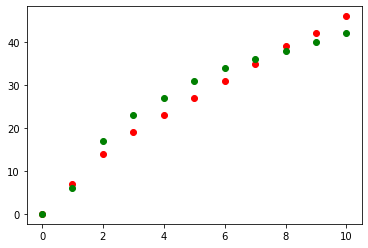

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.26048785] 27.0


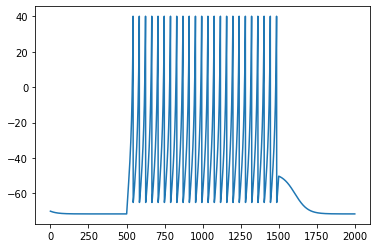

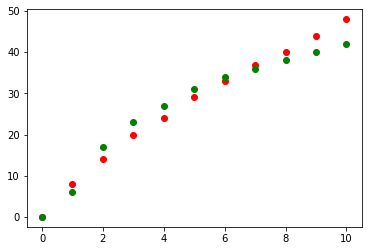

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  14.26048783] 27.0


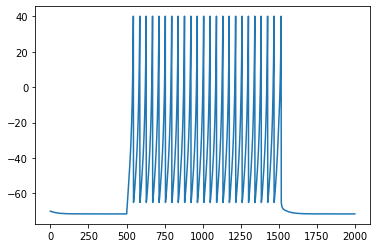

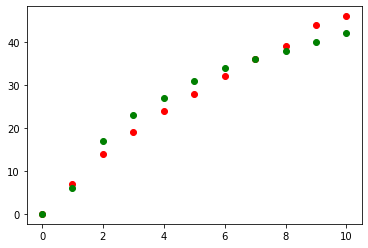

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.6973131 ] 25.0


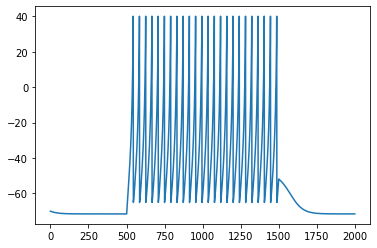

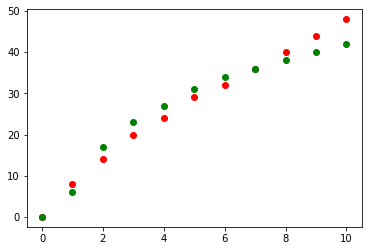

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  14.02441985] 27.0


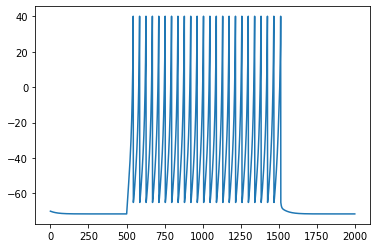

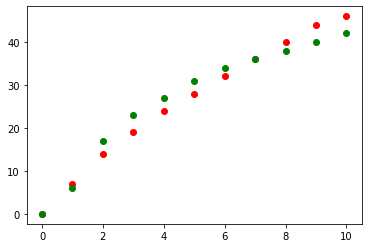

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.80930626] 26.0


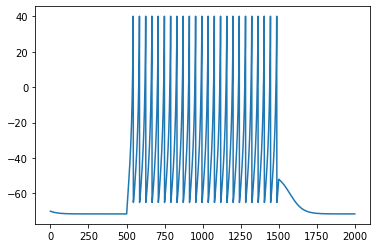

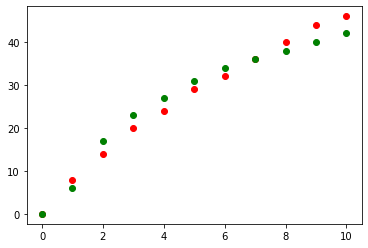

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.93424991] 25.0


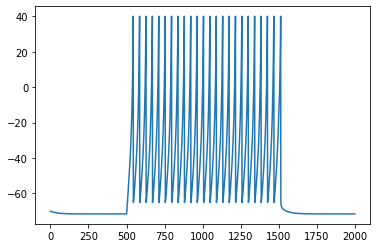

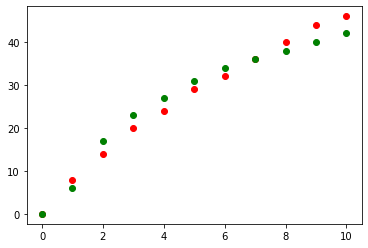

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.90638587] 25.0


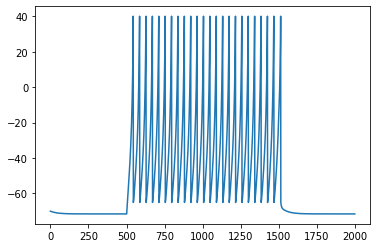

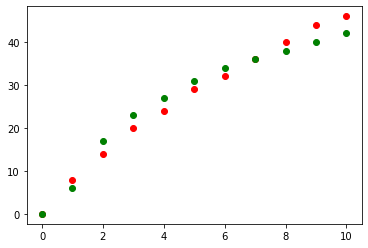

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.89574275] 25.0


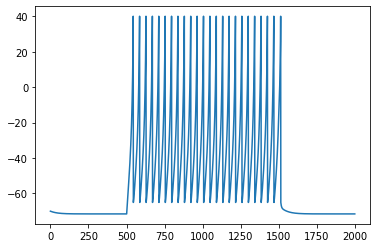

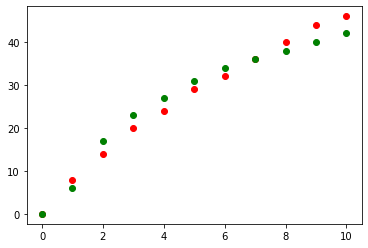

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.88916495] 25.0


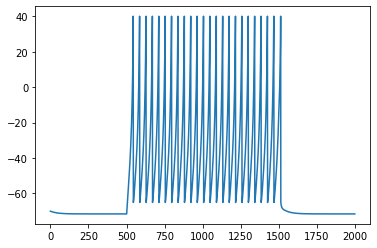

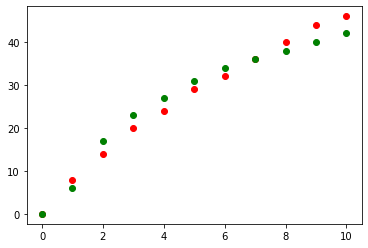

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.88509964] 25.0


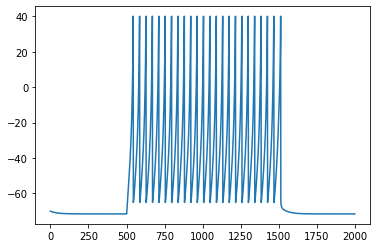

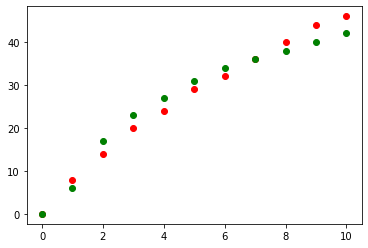

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.88258714] 25.0


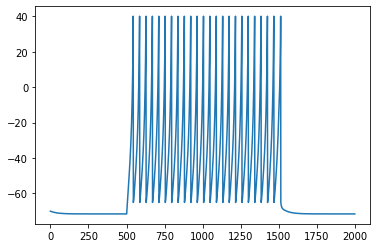

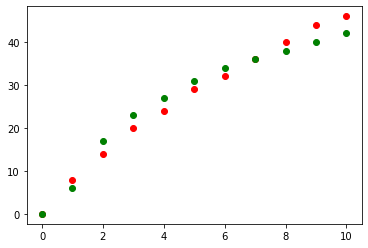

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.88103433] 25.0


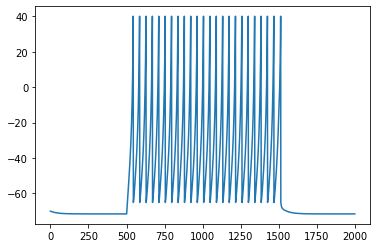

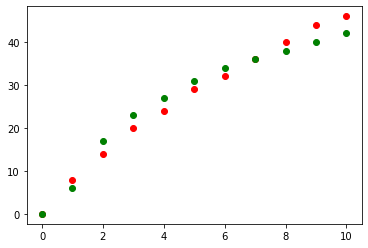

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.88007464] 25.0


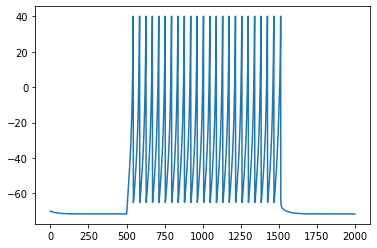

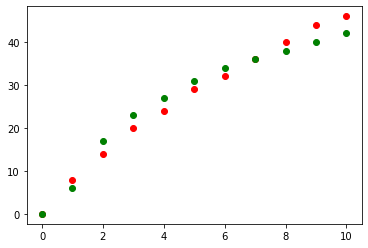

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87948152] 25.0


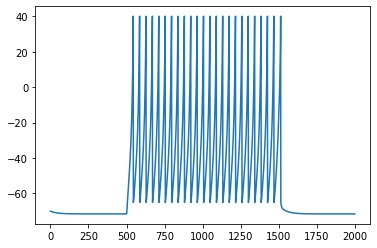

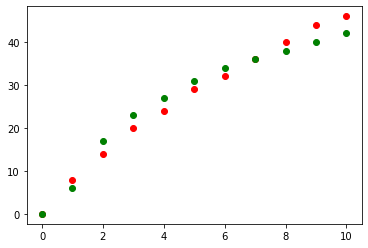

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87911495] 25.0


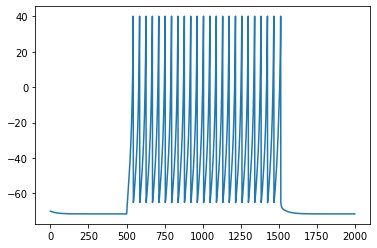

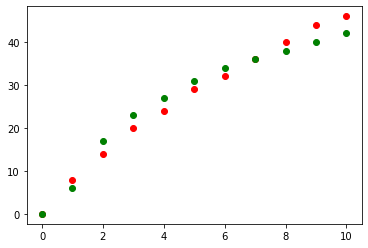

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.8788884 ] 25.0


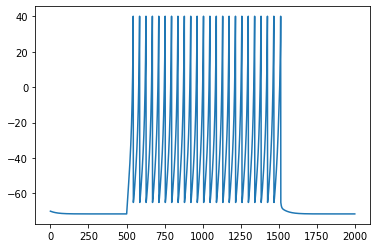

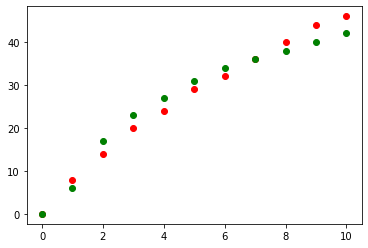

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87874838] 25.0


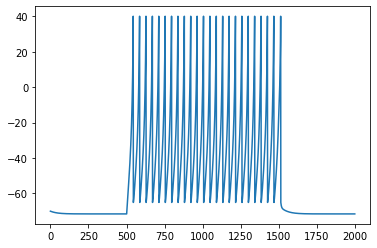

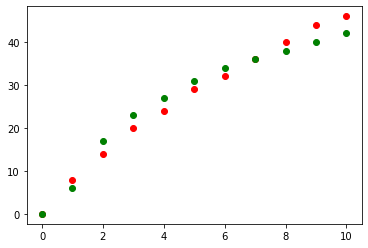

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87866185] 25.0


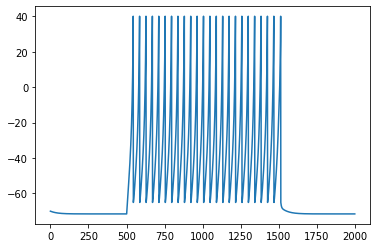

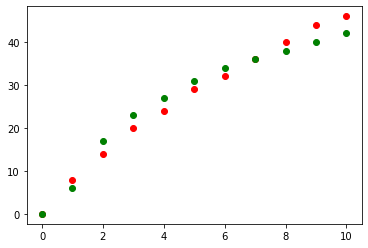

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87860836] 25.0


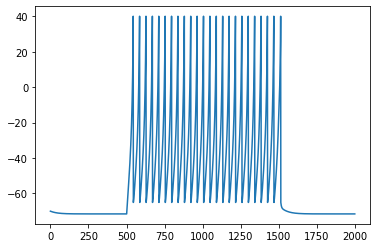

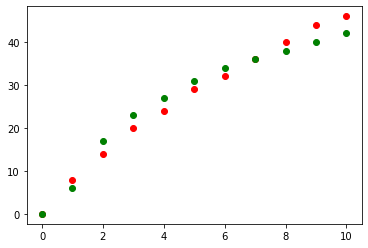

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87857531] 25.0


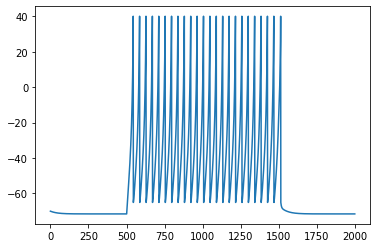

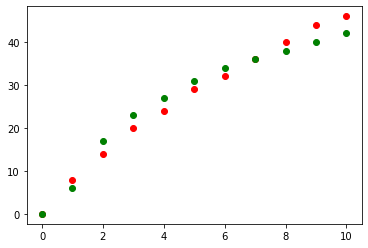

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87855488] 25.0


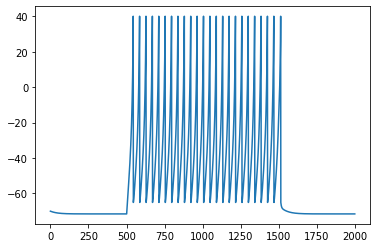

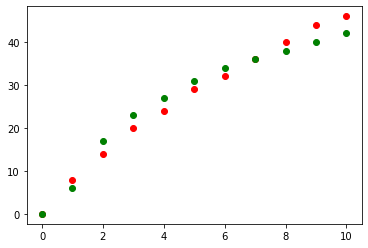

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87854226] 25.0


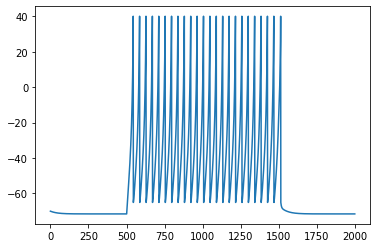

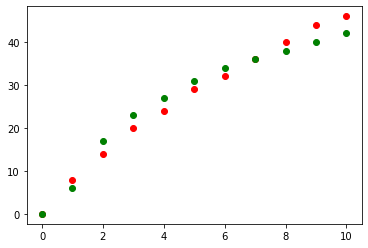

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87853445] 25.0


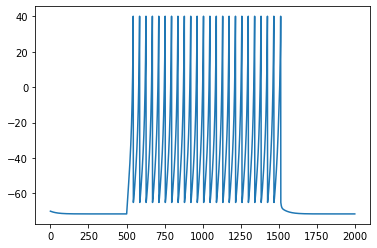

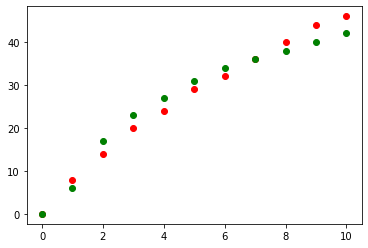

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852963] 25.0


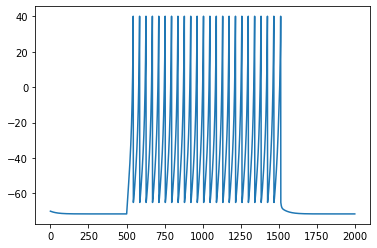

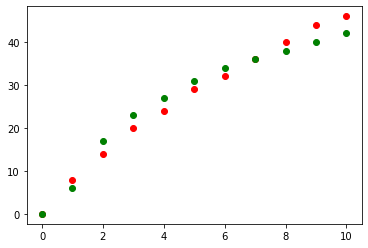

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852665] 25.0


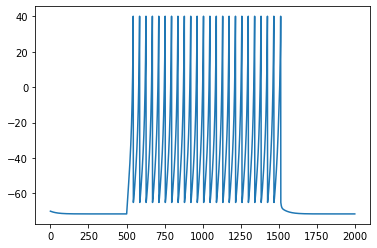

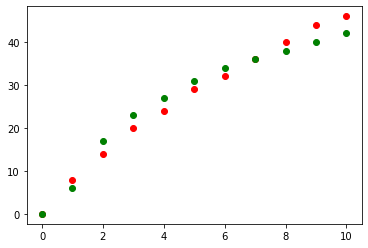

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852481] 25.0


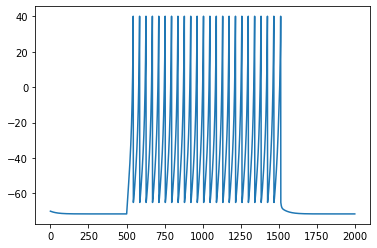

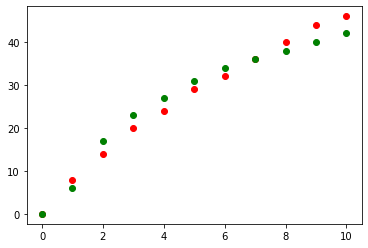

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852367] 25.0


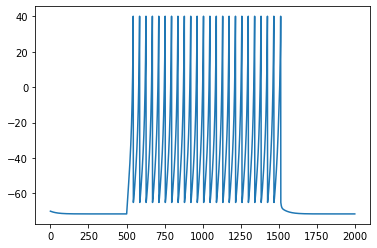

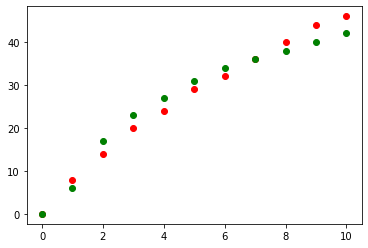

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852297] 25.0


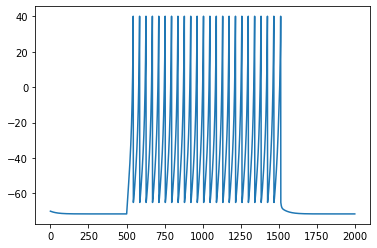

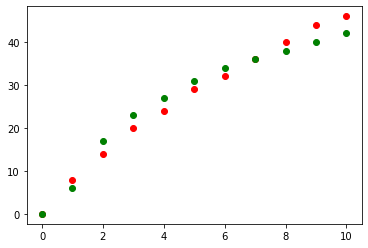

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852253] 25.0


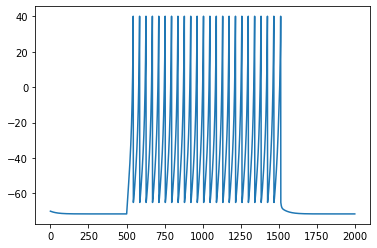

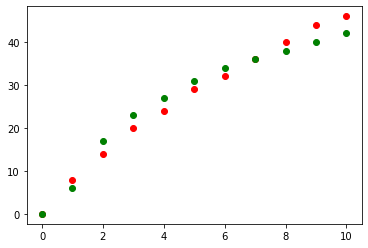

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852226] 25.0


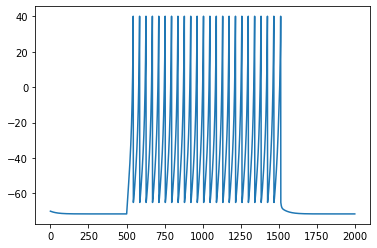

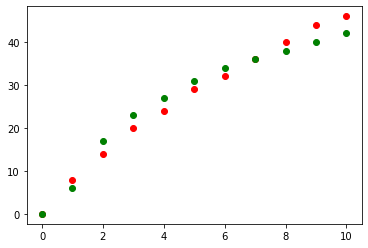

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.8785221 ] 25.0


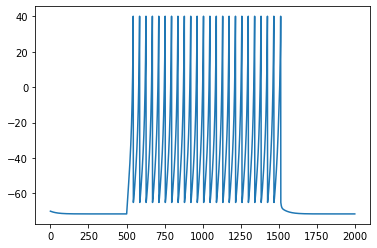

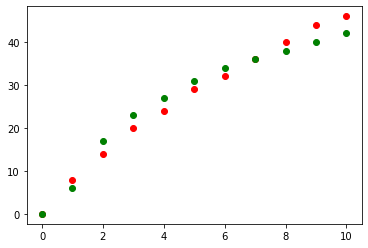

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.878522  ] 25.0


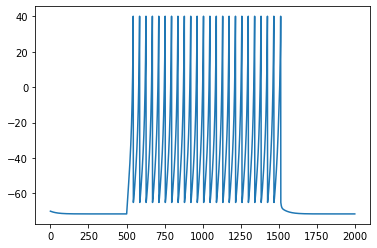

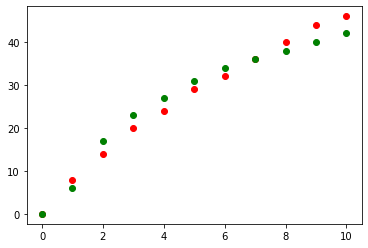

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852193] 25.0


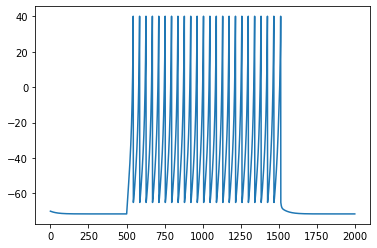

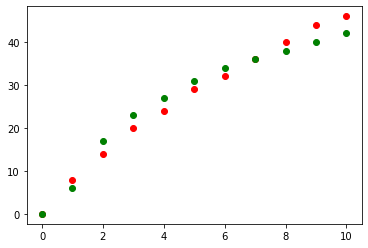

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852189] 25.0


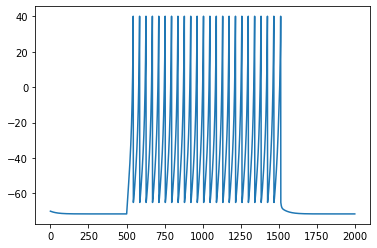

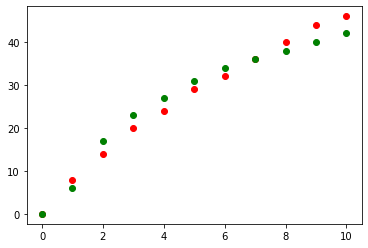

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852187] 25.0


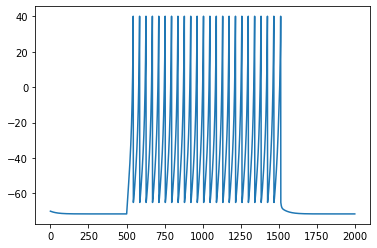

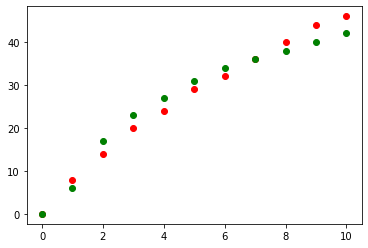

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852185] 25.0


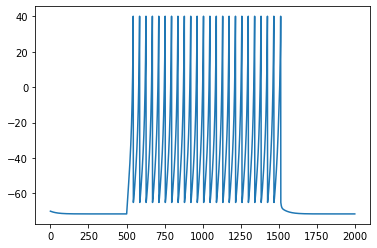

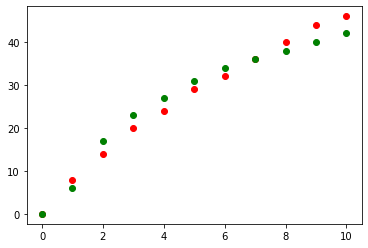

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852184] 25.0


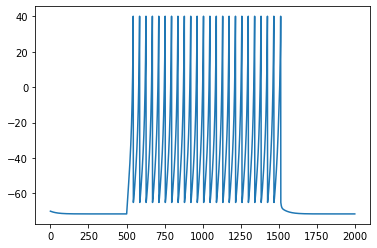

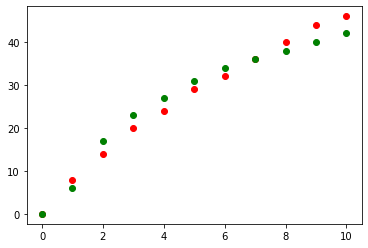

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852184] 25.0


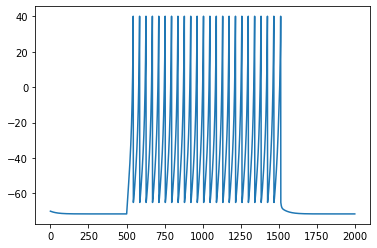

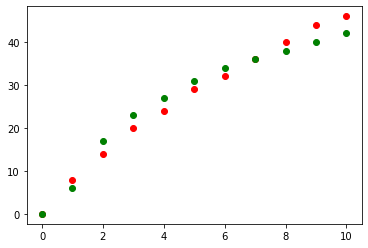

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


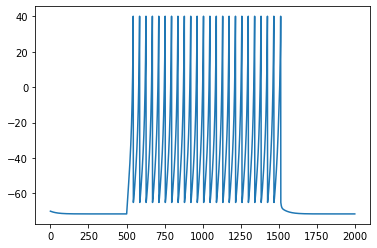

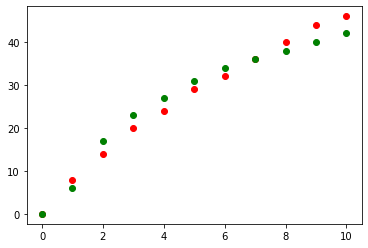

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


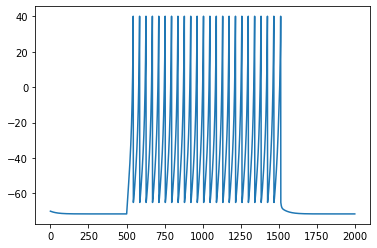

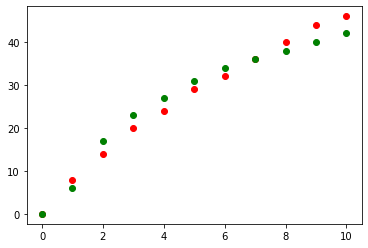

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


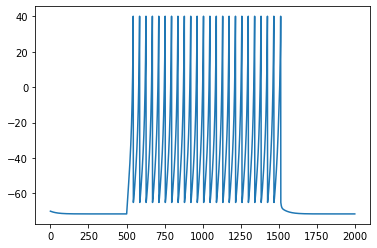

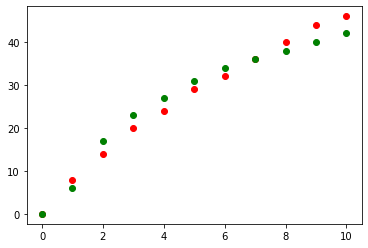

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


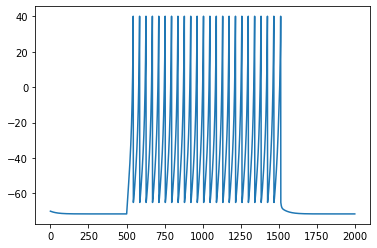

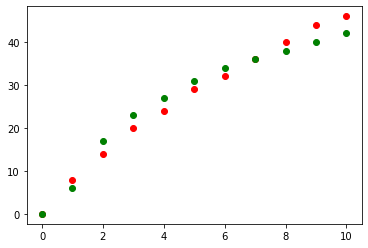

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


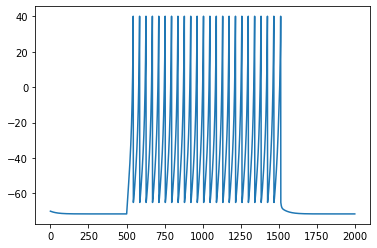

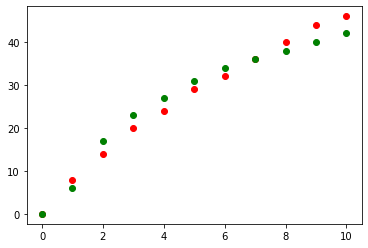

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


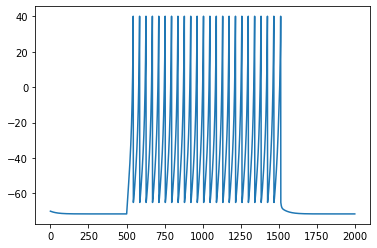

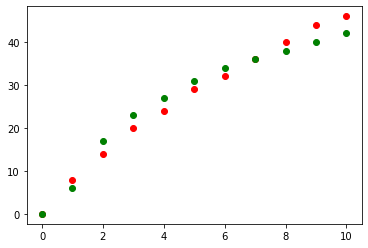

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


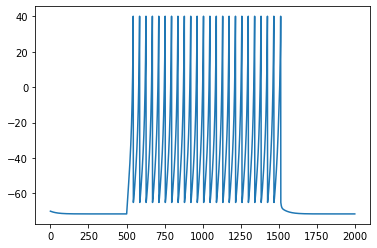

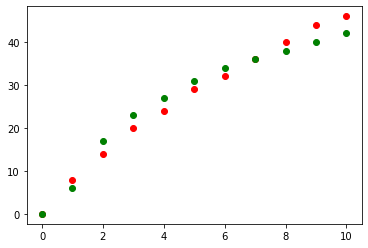

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


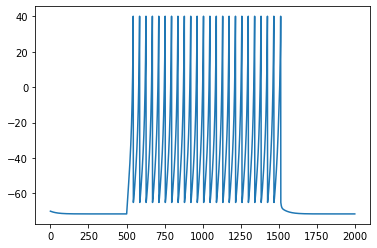

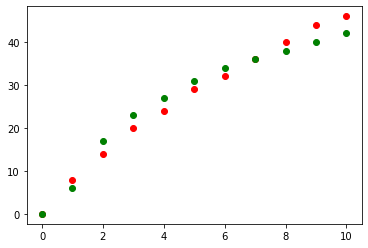

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


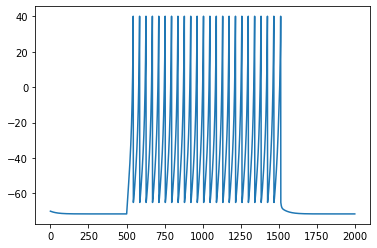

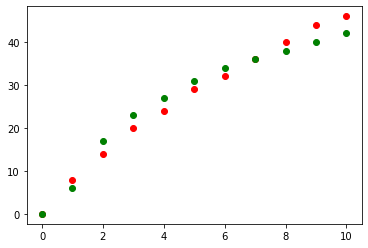

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


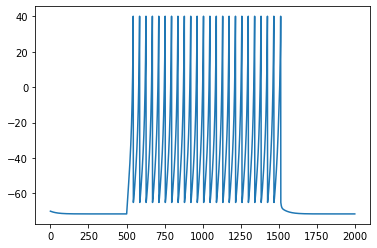

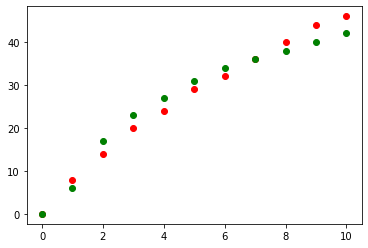

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


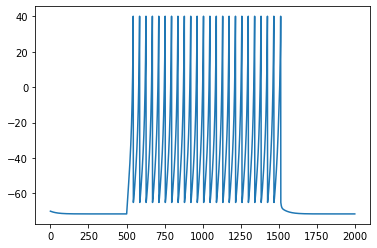

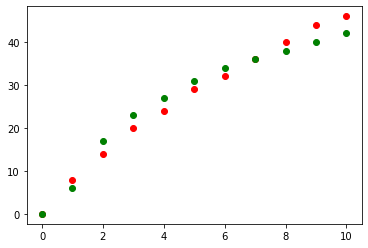

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0


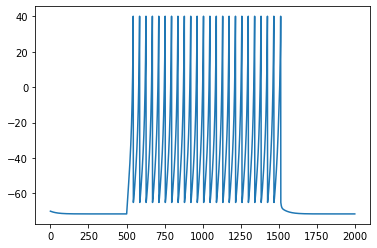

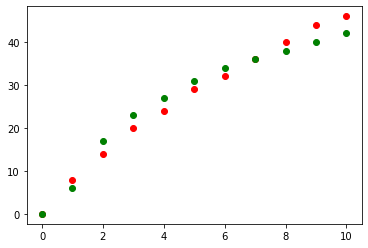

[ 23.37979826 -65.07088399   9.23623535   0.2          8.04666882
  13.87852183] 25.0
Optimization terminated successfully.
         Current function value: 1.285649
         Iterations: 2
         Function evaluations: 359


In [ ]:
from scipy.optimize import minimize
from scipy.optimize import Bounds

x1 = np.array([23.37599884, -67.58236192, 5.63108546, 0.2, 2.8708109, 13.878521829])
res1 = minimize(run_Izhikevich, x1, method='Powell', options={'xatol': 1e-8, 'disp': True})

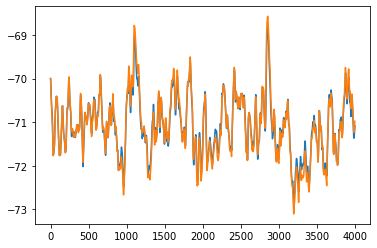

In [ ]:
final_results = [4.78920515e+01,5.68618427e+01,-1.32750075e+00,2.51875883e-02]  #arg0 is excitatory weight, arg1 is inhibitory weight, arg2 is holding current, arg3 is dt

final_firing_results = [23.37599884, -67.58236192, 5.63108546, 0.2, 2.8708109, 13.878521829]   #arg0 is threshold, arg1 is ahp, arg2 is a, arg3 is b, arg4 is d, arg5 is current weight 


class CustomLayer_for_Vu(tf.keras.layers.Layer):
    def __init__(self):
        super(CustomLayer_for_Vu, self).__init__()
        self.ahp_amp = tf.Variable(initial_value=-67.58236192, trainable=True)
        self.threshold_value = tf.Variable(initial_value=23.37599884, trainable=False)
        self.dt = 2.51875883e-02
        self.a = tf.Variable(initial_value=5.63108546, trainable=False)
        self.b = tf.Variable(initial_value=0.2, trainable=False)
        self.d = tf.Variable(initial_value=2.8708109, trainable=False)
        self.spike_amp = tf.Variable(initial_value=40., trainable=False)

    def call(self, input_arr):
        self.V = input_arr[0]       #corresponds to V[t-1]          
        self.u = input_arr[1]       #corresponds to u[t-1]
        self.I = input_arr[2]



        def subthreshold():
            dV = (0.04 * self.V + 5) * self.V + 140 - self.u
            V1 = self.V + (dV + self.I) * self.dt

            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du

            return tf.stack([V1,u1],axis=0)

        def spike():
            return tf.stack([self.ahp_amp,self.u+ self.d],axis=0)

        def threshold():
            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du
            return tf.stack([self.spike_amp,u1],axis=0)

        def threshold_or_spike():       #need to backset spike value automatically during running
            return tf.cond(self.V<40, true_fn=lambda: threshold(), false_fn=lambda: spike())

        return tf.cond(self.V<self.threshold_value, true_fn=lambda: subthreshold(), false_fn=lambda: threshold_or_spike())

batch_size = 1

model1 = tf.keras.models.Sequential([
tf.keras.layers.InputLayer(),
CustomLayer_for_Vu()])
model1.compile(loss=['mse'], optimizer=tf.keras.optimizers.Adam())

model1(vmi1[0])

#ORIG, works with testing


holding_current = -1.32750075e+00
current_weight = 13.878521829
excitatory_g_weight = 4.78920515e+01       
inhibitory_g_weight = 5.68618427e+01

"""
#recreate firing pattern

orig_inputs = np.asarray([-70, -14., 0.])
V_res = []
u_res = []
I_res = []
V_main = []
u_main = []
I_main = []

Vs = np.asarray(model1(orig_inputs))
V_res.append(Vs[0])
spikes = []
for k in range(11):
    orig_inputs = np.asarray([-70, -14., 0.])
    V_res = []
    

    Vs = np.asarray(model1(orig_inputs))
    V_res.append(Vs[0])
    for i in range(2000):
        if i>500 and i<1500:
            I1 = k * current_weight
        else:
            I1 = 0 * current_weight
        orig_inputs = np.asarray([Vs[0], Vs[1], I1])
        Vs = (model1(orig_inputs))
        V_res.append(Vs[0])
        u_res.append(Vs[1])
        I_res.append(I1)
    for i in range(2000):
        V_main.append(V_res[i])
        u_main.append(u_res[i])
        I_main.append(I_res[i])

    #plt.plot(V_res)
    #plt.show()
    spike_count = (np.asarray(V_res) == 40).sum()
    spikes.append(spike_count)
    print(k, spike_count)
plt.plot(np.asarray(spikes), "ro")
plt.plot(vmi2, "go")
plt.show()
"""

#recreate synaptic input pattern

orig_inputs = np.asarray([-70, -14., 0.])
V_res = []
u_res = []
I_res = []
V_main = []
u_main = []
I_main = []
g_exc = vmi1[:,1]
g_inh = vmi1[:,2]

Vs = np.asarray(model1(orig_inputs))
V_res.append(Vs[0])


Vs = np.asarray(model1(orig_inputs))
V_res.append(Vs[0])
for i in range(4000):

    I_exc = g_exc[i] * (Vs[0] - 0) * excitatory_g_weight
    I_inh = g_inh[i] * (Vs[0] + 90) * inhibitory_g_weight
    I1 = - (I_exc+I_inh) + holding_current

    orig_inputs = np.asarray([Vs[0], Vs[1], I1])
    Vs = (model1(orig_inputs))
    V_res.append(Vs[0])
    u_res.append(Vs[1])
    I_res.append(I1)


plt.plot(np.asarray(V_res))
plt.plot(vmi1[:,0])
plt.show()





In [ ]:
vmi1[:,0].shape

(4001,)

In [ ]:
#plt.plot(np.asarray(spikes), "ro")
#plt.plot(vmi2, "go")
vmi21 = np.vstack((np.asarray(V_res)[:-1], vmi1[:,0]))
vmi21.shape
np.savetxt("/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/subthresh_traces.txt", np.transpose(vmi21))

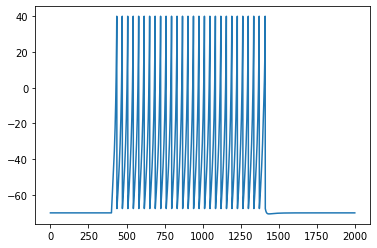

In [ ]:
final_results = [4.78920515e+01,5.68618427e+01,-1.32750075e+00,2.51875883e-02]  #arg0 is excitatory weight, arg1 is inhibitory weight, arg2 is holding current, arg3 is dt

final_firing_results = [23.37599884, -67.58236192, 5.63108546, 0.2, 2.8708109, 13.878521829]   #arg0 is threshold, arg1 is ahp, arg2 is a, arg3 is b, arg4 is d, arg5 is current weight 


class CustomLayer_for_Vu(tf.keras.layers.Layer):
    def __init__(self):
        super(CustomLayer_for_Vu, self).__init__()
        self.ahp_amp = tf.Variable(initial_value=-67.58236192, trainable=True)
        self.threshold_value = tf.Variable(initial_value=23.37599884, trainable=False)
        self.dt = 2.51875883e-02
        self.a = tf.Variable(initial_value=5.63108546, trainable=False)
        self.b = tf.Variable(initial_value=0.2, trainable=False)
        self.d = tf.Variable(initial_value=2.8708109, trainable=False)
        self.spike_amp = tf.Variable(initial_value=40., trainable=False)

    def call(self, input_arr):
        self.V = input_arr[0]       #corresponds to V[t-1]          
        self.u = input_arr[1]       #corresponds to u[t-1]
        self.I = input_arr[2]



        def subthreshold():
            dV = (0.04 * self.V + 5) * self.V + 140 - self.u
            V1 = self.V + (dV + self.I) * self.dt

            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du

            return tf.stack([V1,u1],axis=0)

        def spike():
            return tf.stack([self.ahp_amp,self.u+ self.d],axis=0)

        def threshold():
            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du
            return tf.stack([self.spike_amp,u1],axis=0)

        def threshold_or_spike():       #need to backset spike value automatically during running
            return tf.cond(self.V<40, true_fn=lambda: threshold(), false_fn=lambda: spike())

        return tf.cond(self.V<self.threshold_value, true_fn=lambda: subthreshold(), false_fn=lambda: threshold_or_spike())

batch_size = 1

model1 = tf.keras.models.Sequential([
tf.keras.layers.InputLayer(),
CustomLayer_for_Vu()])
model1.compile(loss=['mse'], optimizer=tf.keras.optimizers.Adam())

model1(vmi1[0])

#ORIG, works with testing


holding_current = -1.32750075e+00
current_weight = 13.878521829
excitatory_g_weight = 4.78920515e+01       
inhibitory_g_weight = 5.68618427e+01


#recreate firing pattern

orig_inputs = np.asarray([-70, -14., 0.])
V_res = []
u_res = []
I_res = []
V_main = []
u_main = []
I_main = []

Vs = np.asarray(model1(orig_inputs))
V_res.append(Vs[0])
spikes = []

orig_inputs = np.asarray([-70, -14., 0.])
V_res = []


Vs = np.asarray(model1(orig_inputs))
V_res.append(Vs[0])
for i in range(2000):
    if i>400 and i<1400:
        I1 = 5 * current_weight
    else:
        I1 = 0
    orig_inputs = np.asarray([Vs[0], Vs[1], I1])
    Vs = (model1(orig_inputs))
    V_res.append(Vs[0])
    u_res.append(Vs[1])
    I_res.append(I1)
#for i in range(2000):
    #V_main.append(V_res[i])
    #u_main.append(u_res[i])
    #I_main.append(I_res[i])



plt.plot(V_res)
plt.show()




In [ ]:
np.savetxt("/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/chattering.txt", V_res)   #2

In [ ]:
np.savetxt("/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/intrinsically_bursting.txt", V_res)   #0.75

In [ ]:
np.savetxt("/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/regular_spiking.txt", V_res)   #0.75

In [ ]:
np.savetxt("/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/fast_spiking.txt", V_res)   #0.75

In [ ]:
np.savetxt("/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/model_fit_firing.txt", V_res)

In [ ]:
import pandas as pd
data = pd.read_csv('/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/conds.txt', sep=" ", header=None, dtype='float32')
data.drop([3], axis = 1, inplace=True)
vmi3 = np.asarray(data)


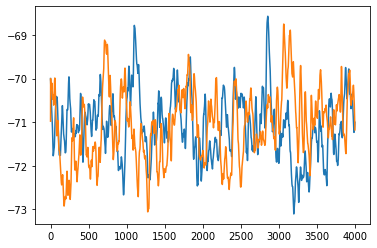

In [ ]:
plt.plot(vmi3[:4000,0])
plt.plot(vmi3[4000:8000,0])

-1228.8817138671875


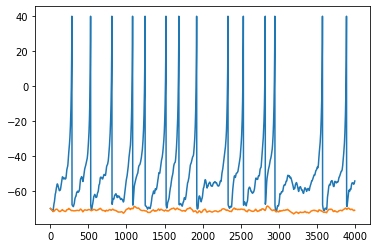

In [ ]:
final_results = [4.78920515e+01,5.68618427e+01,-1.32750075e+00,2.51875883e-02]  #arg0 is excitatory weight, arg1 is inhibitory weight, arg2 is holding current, arg3 is dt

final_firing_results = [23.37599884, -67.58236192, 5.63108546, 0.2, 2.8708109, 13.878521829]   #arg0 is threshold, arg1 is ahp, arg2 is a, arg3 is b, arg4 is d, arg5 is current weight 


class CustomLayer_for_Vu(tf.keras.layers.Layer):
    def __init__(self):
        super(CustomLayer_for_Vu, self).__init__()
        self.ahp_amp = tf.Variable(initial_value=-67.58236192, trainable=True)
        self.threshold_value = tf.Variable(initial_value=23.37599884, trainable=False)
        self.dt = 2.51875883e-02
        self.a = tf.Variable(initial_value=5.63108546, trainable=False)
        self.b = tf.Variable(initial_value=0.2, trainable=False)
        self.d = tf.Variable(initial_value=2.8708109, trainable=False)
        self.spike_amp = tf.Variable(initial_value=40., trainable=False)

    def call(self, input_arr):
        self.V = input_arr[0]       #corresponds to V[t-1]          
        self.u = input_arr[1]       #corresponds to u[t-1]
        self.I = input_arr[2]



        def subthreshold():
            dV = (0.04 * self.V + 5) * self.V + 140 - self.u
            V1 = self.V + (dV + self.I) * self.dt

            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du

            return tf.stack([V1,u1],axis=0)

        def spike():
            return tf.stack([self.ahp_amp,self.u+ self.d],axis=0)

        def threshold():
            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du
            return tf.stack([self.spike_amp,u1],axis=0)

        def threshold_or_spike():       #need to backset spike value automatically during running
            return tf.cond(self.V<40, true_fn=lambda: threshold(), false_fn=lambda: spike())

        return tf.cond(self.V<self.threshold_value, true_fn=lambda: subthreshold(), false_fn=lambda: threshold_or_spike())

batch_size = 1

model1 = tf.keras.models.Sequential([
tf.keras.layers.InputLayer(),
CustomLayer_for_Vu()])
model1.compile(loss=['mse'], optimizer=tf.keras.optimizers.Adam())

model1(vmi1[0])


holding_current = -1.32750075e+00
current_weight = 13.878521829
excitatory_g_weight = 4.78920515e+01 * 7      
inhibitory_g_weight = 5.68618427e+01


#recreate synaptic input pattern

for j1 in range(1):
    
    orig_inputs = np.asarray([-70, -14., 0.])
    V_res = []
    u_res = []
    I_res = []
    V_main = []
    u_main = []
    I_main = []
    from1 = j1*4000
    till1 = (j1+1)*4000
    g_exc = vmi3[from1:till1,1]
    g_inh = vmi3[from1:till1,2]

    Vs = np.asarray(model1(orig_inputs))
    V_res.append(Vs[0])


    Vs = np.asarray(model1(orig_inputs))
    V_res.append(Vs[0])
    for i in range(4000):

        I_exc = g_exc[i] * (Vs[0] - 0) * excitatory_g_weight
        I_inh = g_inh[i] * (Vs[0] + 90) * inhibitory_g_weight
        I1 = - (I_exc+I_inh) + holding_current

        orig_inputs = np.asarray([Vs[0], Vs[1], I1])
        Vs = (model1(orig_inputs))
        V_res.append(Vs[0])
        u_res.append(Vs[1])
        I_res.append(I1)

    mse = np.mean((V_res[2:]-vmi3[from1:till1,0])**2)
    var = np.var(vmi3[from1:till1,0])
    var_explained = 1-(mse/var)
    print(var_explained)


    plt.plot(np.asarray(V_res))
    plt.plot(vmi3[from1:till1,0])
    plt.show()





In [ ]:
#establish goodness of fit

class CustomLayer_for_Vu(tf.keras.layers.Layer):
    def __init__(self):
        super(CustomLayer_for_Vu, self).__init__()
        self.ahp_amp = tf.Variable(initial_value=-67.58236192, trainable=True)
        self.threshold_value = tf.Variable(initial_value=23.37599884, trainable=False)
        self.dt = 2.51875883e-02
        self.a = tf.Variable(initial_value=5.63108546, trainable=False)
        self.b = tf.Variable(initial_value=0.2, trainable=False)
        self.d = tf.Variable(initial_value=2.8708109, trainable=False)
        self.spike_amp = tf.Variable(initial_value=40., trainable=False)

    def call(self, input_arr):
        self.V = input_arr[0]       #corresponds to V[t-1]          
        self.u = input_arr[1]       #corresponds to u[t-1]
        self.I = input_arr[2]



        def subthreshold():
            dV = (0.04 * self.V + 5) * self.V + 140 - self.u
            V1 = self.V + (dV + self.I) * self.dt

            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du

            return tf.stack([V1,u1],axis=0)

        def spike():
            return tf.stack([self.ahp_amp,self.u+ self.d],axis=0)

        def threshold():
            du = self.a * (self.b * self.V - self.u)
            u1 = self.u + self.dt * du
            return tf.stack([self.spike_amp,u1],axis=0)

        def threshold_or_spike():       #need to backset spike value automatically during running
            return tf.cond(self.V<40, true_fn=lambda: threshold(), false_fn=lambda: spike())

        return tf.cond(self.V<self.threshold_value, true_fn=lambda: subthreshold(), false_fn=lambda: threshold_or_spike())

batch_size = 1

model1 = tf.keras.models.Sequential([
tf.keras.layers.InputLayer(),
CustomLayer_for_Vu()])
model1.compile(loss=['mse'], optimizer=tf.keras.optimizers.Adam())

model1(vmi1[0])


holding_current = -1.32750075e+00
current_weight = 13.878521829
excitatory_g_weight = 4.78920515e+01       
inhibitory_g_weight = 5.68618427e+01


#recreate synaptic input pattern

j1 = 0


V_res = []
u_res = []
I_res = []
V_main = []
u_main = []
I_main = []
from1 = j1*4000
till1 = (j1+1)*4000
V_m = vmi3[from1:till1,0]
g_exc = vmi3[from1:till1,1]
g_inh = vmi3[from1:till1,2]
orig_inputs = np.asarray([-70, -14., 0.])

Vs = np.asarray(model1(orig_inputs))
V_res.append(Vs[0])
for i in range(3999):

    I_exc = g_exc[i] * (Vs[0] - 0) * excitatory_g_weight
    I_inh = g_inh[i] * (Vs[0] + 90) * inhibitory_g_weight
    I1 = - (I_exc+I_inh) + holding_current

    orig_inputs = np.asarray([V_m[i+1], Vs[1], I1])
    Vs = (model1(orig_inputs))
    V_res.append(Vs[0])
    u_res.append(Vs[1])
    I_res.append(I1)

mse = np.mean((V_res[1:-1]-vmi3[from1:till1,0])**2)
var = np.var(vmi3[from1:till1,0])
var_explained = 1-(mse/var)
print(var_explained)






ValueError: ignored

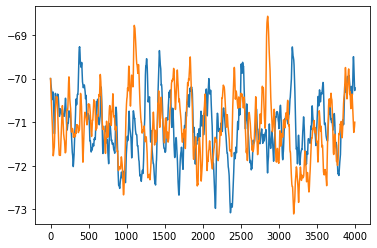

In [ ]:
plt.plot(V_res)
plt.plot(V_m)

In [ ]:
vmi21 = np.vstack((np.asarray(V_res), V_m))
vmi21.shape
np.savetxt("/content/drive/My Drive/DNN/ANN_revision/Izhikevich_model/goodness_of_fit.txt", np.transpose(vmi21))